The purpose of the File is to perform below steps on the Job Description data
<li>POS Tagging Analysis
         <ul>
             <li> Identify the POS of interest
             <li> Chunking for phrases rdf triplets similar use
             <li> NE Dictionary for NER
             <li> Are there any patterns associated with their use, lexical grammatical?
         </ul>

In [1]:
#Generic Libraries
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np 
import pickle

#Visualization Libraries
import matplotlib.pyplot as plt 
import seaborn as sns
from wordcloud import WordCloud
sns.set()


#NLP Libraries
import nltk


#This needs to be executed only once
# nltk.download('tagsets')

In [2]:
#Load the data created and saved at the end of JD Preprocessing & EDA file and print the file info
df=pd.read_csv('data\collected_data\df_description_processed.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5379 entries, 0 to 5378
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Description         5379 non-null   object
 1   lower_description   5379 non-null   object
 2   word_tokenized      5379 non-null   object
 3   sentence_tokenized  5379 non-null   object
 4   word_count          5379 non-null   int64 
 5   sentence_count      5379 non-null   int64 
 6   clean_words         5379 non-null   object
 7   clean_stemmed       5379 non-null   object
 8   clean_lemmed        5379 non-null   object
dtypes: int64(2), object(7)
memory usage: 378.3+ KB


In [3]:
# duplicates reduce the df by 651 observations
df.drop_duplicates(inplace = True)
df.shape

(4728, 9)

In [4]:
df.head()

,Description,lower_description,word_tokenized,sentence_tokenized,word_count,sentence_count,clean_words,clean_stemmed,clean_lemmed
0,"POSITION SUMMARY, The Business Analyst role is...","position summary, the business analyst role is...","['position', 'summary', 'the', 'business', 'an...","['POSITION SUMMARY, The Business Analyst role ...",424,25,"['position', 'summary', 'business', 'analyst',...","['posit', 'summari', 'busi', 'analyst', 'role'...","['position', 'summary', 'business', 'analyst',..."
1,"What do we need?, You to have an amazing perso...","what do we need?, you to have an amazing perso...","['what', 'do', 'we', 'need', 'you', 'to', 'hav...","['What do we need?, You to have an amazing per...",286,10,"['need', 'amazing', 'personality', 'communicat...","['need', 'amaz', 'person', 'commun', 'style', ...","['need', 'amazing', 'personality', 'communicat..."
2,"Validate, analyze, and conduct statistical ana...","validate, analyze, and conduct statistical ana...","['validate', 'analyze', 'and', 'conduct', 'sta...","['Validate, analyze, and conduct statistical a...",314,24,"['validate', 'analyze', 'conduct', 'statistica...","['valid', 'analyz', 'conduct', 'statist', 'ana...","['validate', 'analyze', 'conduct', 'statistica..."
3,"Full time, Washington, DC metro area, Starting...","full time, washington, dc metro area, starting...","['full', 'time', 'washington', 'dc', 'metro', ...","['Full time, Washington, DC metro area, Starti...",297,13,"['full', 'time', 'washington', 'dc', 'metro', ...","['full', 'time', 'washington', 'dc', 'metro', ...","['full', 'time', 'washington', 'dc', 'metro', ..."
4,Assist in consultations with business partners...,assist in consultations with business partners...,"['assist', 'in', 'consultations', 'with', 'bus...",['Assist in consultations with business partne...,316,7,"['assist', 'consultations', 'business', 'partn...","['assist', 'consult', 'busi', 'partner', 'inte...","['assist', 'consultation', 'business', 'partne..."


# Parts of Speech Tagging (POS)

In [5]:
def pos_series(keyword):
    '''categorizes parts of speech after tokenizing words with POS tags'''
    tokens = nltk.word_tokenize(keyword)
    tagged = nltk.pos_tag(tokens)
    print(tagged)
    return tagged

In [6]:
# cell runs slower due to computational exhaustion
pos_tagged_arrs = df.lower_description.apply(pos_series)

[('position', 'NN'), ('summary', 'NN'), (',', ','), ('the', 'DT'), ('business', 'NN'), ('analyst', 'NN'), ('role', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('primary', 'JJ'), ('architect', 'NN'), ('of', 'IN'), ('reporting', 'NN'), ('and', 'CC'), ('dashboard', 'JJ'), ('solutions', 'NNS'), ('for', 'IN'), ('internal', 'JJ'), ('and', 'CC'), ('external', 'JJ'), ('clients', 'NNS'), ('.', '.'), ('utilizing', 'JJ'), ('esi', 'JJ'), ('corporate', 'JJ'), ('standard', 'NN'), ('development', 'NN'), ('tools', 'VBZ'), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('design', 'NN'), (',', ','), ('development', 'NN'), (',', ','), ('implementation', 'NN'), (',', ','), ('analysis', 'NN'), (',', ','), ('interpretation', 'NN'), ('and', 'CC'), ('communication', 'NN'), ('of', 'IN'), ('business', 'NN'), ('information', 'NN'), ('based', 'VBN'), ('on', 'IN'), ('the', 'DT'), ('needs', 'NNS'), ('of', 'IN'), ('individual', 'JJ'), ('clients', 'NNS'), ('.', '.'), 

[('duties', 'NNS'), ('summary', 'JJ'), ('job', 'NN'), ('description', 'NN'), (':', ':'), ('data', 'NN'), ('scientists', 'NNS'), ('develop', 'VBP'), ('and', 'CC'), ('apply', 'VBP'), ('methods', 'NNS'), ('to', 'TO'), ('identify', 'VB'), (',', ','), ('collect', 'VB'), (',', ','), ('process', 'NN'), (',', ','), ('and', 'CC'), ('analyze', 'RB'), ('large', 'JJ'), ('volumes', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('to', 'TO'), ('build', 'VB'), ('and', 'CC'), ('enhance', 'VB'), ('products', 'NNS'), (',', ','), ('processes', 'NNS'), (',', ','), ('and', 'CC'), ('systems', 'NNS'), ('.', '.'), ('they', 'PRP'), ('conduct', 'VBP'), ('data', 'NNS'), ('mining', 'NN'), ('and', 'CC'), ('retrieval', 'NN'), (',', ','), ('and', 'CC'), ('apply', 'VB'), ('statistical', 'JJ'), ('and', 'CC'), ('mathematical', 'JJ'), ('analyses', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('trends', 'NNS'), (',', ','), ('solve', 'VB'), ('analytical', 'JJ'), ('problems', 'NNS'), (',', ','), ('optimize', 'VB'), ('performance', 'N

[('achievement', 'NN'), ('network', 'NN'), ('anet', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('nonprofit', 'JJ'), ('dedicated', 'VBN'), ('to', 'TO'), ('educational', 'JJ'), ('equity', 'NN'), ('.', '.'), ('we', 'PRP'), ('help', 'VBP'), ('schools', 'NNS'), ('boost', 'VB'), ('student', 'NN'), ('learning', 'VBG'), ('with', 'IN'), ('great', 'JJ'), ('teaching', 'VBG'), ('that', 'IN'), ('’', 'NNP'), ('s', 'NN'), ('grounded', 'VBD'), ('in', 'IN'), ('standards', 'NNS'), (',', ','), ('informed', 'VBN'), ('by', 'IN'), ('data', 'NNS'), (',', ','), ('and', 'CC'), ('built', 'VBN'), ('on', 'IN'), ('the', 'DT'), ('successful', 'JJ'), ('practices', 'NNS'), ('of', 'IN'), ('educators', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('country', 'NN'), ('.', '.'), ('founded', 'VBN'), ('in', 'IN'), ('2005', 'CD'), (',', ','), ('anet', 'NN'), ('now', 'RB'), ('serves', 'VBZ'), ('over', 'IN'), ('700', 'CD'), ('schools', 'NNS'), ('educating', 'VBG'), ('over', 'IN'), ('230,000', 'CD'), ('students', 'NNS'), ('in', 'IN'), ('c

[('company', 'NN'), ('description', 'NN'), (':', ':'), (',', ','), ('who', 'WP'), ('is', 'VBZ'), ('intuitive', 'JJ'), ('surgical', 'JJ'), ('?', '.'), ('the', 'DT'), ('numbers', 'NNS'), ('tell', 'VBP'), ('an', 'DT'), ('amazing', 'JJ'), ('story', 'NN'), ('.', '.'), ('learn', 'VB'), ('more', 'JJR'), ('about', 'IN'), ('our', 'PRP$'), ('company', 'NN'), ('.', '.'), ('exploration', 'NN'), ('and', 'CC'), ('development', 'NN'), ('of', 'IN'), ('machine', 'NN'), ('learning', 'NN'), ('algorithms', 'NN'), ('for', 'IN'), ('spatiotemporal', 'JJ'), ('analysis', 'NN'), (',', ','), ('including', 'VBG'), ('multiclass', 'NN'), ('classification', 'NN'), (',', ','), ('clustering', 'VBG'), (',', ','), ('temporal', 'JJ'), ('segmentation', 'NN'), (',', ','), ('sequence', 'NN'), ('labeling', 'NN'), (',', ','), ('and', 'CC'), ('spatial', 'JJ'), ('segmentation', 'NN'), ('.', '.'), ('development', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('technologies', 'NNS'), ('and', 'CC'), ('digital', 'JJ'), ('products', 'NNS'), (

[('track', 'NN'), ('record', 'NN'), ('of', 'IN'), ('coming', 'VBG'), ('up', 'RP'), ('with', 'IN'), ('new', 'JJ'), ('ideas', 'NNS'), ('in', 'IN'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('as', 'IN'), ('demonstrated', 'VBN'), ('by', 'IN'), ('one', 'CD'), ('or', 'CC'), ('more', 'JJR'), ('first', 'JJ'), ('author', 'NN'), ('publications', 'NNS'), ('or', 'CC'), ('projects', 'NNS'), ('past', 'JJ'), ('experience', 'NN'), ('in', 'IN'), ('creating', 'VBG'), ('high-performance', 'JJ'), ('implementations', 'NNS'), ('of', 'IN'), ('deep', 'JJ'), ('learning', 'NN'), ('algorithms', 'JJ'), ('optional', 'JJ'), (',', ','), ('robotics', 'NNS'), (':', ':'), ('while', 'IN'), ('working', 'VBG'), ('towards', 'NNS'), ('breakthroughs', 'NNS'), ('in', 'IN'), ('robotic', 'JJ'), ('manipulation', 'NN'), (',', ','), ('develop', 'VB'), ('novel', 'JJ'), ('techniques', 'NNS'), ('for', 'IN'), ('reinforcement', 'NN'), ('learning', 'NN'), ('and', 'CC'), ('imitation', 'NN'), ('learning', 'NN'), ('.', '.'), ('ba

[('reqid', 'NN'), (':', ':'), ('23104', 'CD'), (',', ','), ('when', 'WRB'), ('you', 'PRP'), ('care', 'VBP'), ('enough', 'IN'), ('you', 'PRP'), ('can', 'MD'), ('change', 'VB'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('do', 'VBP'), ('you', 'PRP'), ('want', 'VB'), ('to', 'TO'), ('work', 'VB'), ('for', 'IN'), ('a', 'DT'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('world', 'NN'), ("'s", 'POS'), ('most', 'RBS'), ('trusted', 'JJ'), ('and', 'CC'), ('recognized', 'VBN'), ('brands', 'NNS'), ('?', '.'), ('hallmark', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('company', 'NN'), ('rooted', 'VBN'), ('in', 'IN'), ('connecting', 'VBG'), ('people', 'NNS'), ('.', '.'), ('we', 'PRP'), ('care', 'VBP'), ('for', 'IN'), ('our', 'PRP$'), ('employees', 'NNS'), (',', ','), ('our', 'PRP$'), ('communities', 'NNS'), (',', ','), ('and', 'CC'), ('our', 'PRP$'), ('world', 'NN'), ('.', '.'), ('a', 'DT'), ('career', 'NN'), ('at', 'IN'), ('hallmark', 'NN'), ('means', 'NNS'), ('you', 'PRP'), ('get', 'VBP'), ('to', 'TO'),

[('where', 'WRB'), ('good', 'JJ'), ('people', 'NNS'), ('build', 'VBP'), ('rewarding', 'VBG'), ('careers', 'NNS'), ('.', '.'), ('think', 'VBP'), ('that', 'IN'), ('working', 'VBG'), ('in', 'IN'), ('the', 'DT'), ('insurance', 'NN'), ('field', 'NN'), ('can', 'MD'), ('’', 'VB'), ('t', 'RB'), ('be', 'VB'), ('exciting', 'VBG'), (',', ','), ('rewarding', 'VBG'), ('and', 'CC'), ('challenging', 'VBG'), ('?', '.'), ('think', 'VB'), ('again', 'RB'), ('.', '.'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'JJR'), ('help', 'NN'), ('us', 'PRP'), ('reinvent', 'JJ'), ('protection', 'NN'), ('and', 'CC'), ('retirement', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('customers', 'NNS'), ('’', 'VBP'), ('lives', 'NNS'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('help', 'NN'), ('you', 'PRP'), ('make', 'VBP'), ('an', 'DT'), ('impact', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('training', 'NN'), ('and', 'CC'), ('mentoring', 'JJ'), ('offerings', 'NNS'), ('.', '.'), ('here', 'RB'), (',', ','), ('you', 'PRP'), (

[('bj', 'NN'), ("'s", 'POS'), ('wholesale', 'JJ'), ('club', 'NN'), ('was', 'VBD'), ('the', 'DT'), ('first', 'JJ'), ('retailer', 'NN'), ('to', 'TO'), ('introduce', 'VB'), ('the', 'DT'), ('warehouse', 'NN'), ('club', 'NN'), ('concept', 'NN'), ('in', 'IN'), ('the', 'DT'), ('northeastern', 'JJ'), ('united', 'JJ'), ('states', 'NNS'), ('.', '.'), ('today', 'NN'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'VB'), ('a', 'DT'), ('multibillion', 'NN'), ('dollar', 'NN'), ('operation', 'NN'), ('with', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('200', 'CD'), ('clubs', 'NNS'), ('in', 'IN'), ('16', 'CD'), ('states', 'NNS'), ('from', 'IN'), ('maine', 'NN'), ('to', 'TO'), ('florida', 'VB'), ('.', '.'), ('while', 'IN'), ('our', 'PRP$'), ('members', 'NNS'), ('know', 'VBP'), ('us', 'PRP'), ('for', 'IN'), ('helping', 'VBG'), ('them', 'PRP'), ('save', 'VB'), ('up', 'RB'), ('to', 'TO'), ('25', 'CD'), ('%', 'NN'), ('off', 'IN'), ('grocery', 'NN'), ('prices', 'NNS'), ('every', 'DT'), ('day', 'NN'), (',', ',

[('since', 'IN'), ('1939', 'CD'), (',', ','), ('growth', 'NN'), ('and', 'CC'), ('change', 'NN'), ('have', 'VBP'), ('been', 'VBN'), ('the', 'DT'), ('two', 'CD'), ('constants', 'NNS'), ('at', 'IN'), ('schnucks', 'NNS'), ('.', '.'), ('as', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('change', 'VBP'), (',', ','), ('we', 'PRP'), ('change', 'VBP'), ('to', 'TO'), ('meet', 'VB'), ('their', 'PRP$'), ('needs', 'NNS'), ('.', '.'), ('as', 'IN'), ('the', 'DT'), ('neighborhoods', 'NNS'), ('we', 'PRP'), ('serve', 'VBP'), ('grow', 'JJ'), (',', ','), ('we', 'PRP'), ('grow', 'VBP'), ('with', 'IN'), ('them', 'PRP'), ('.', '.'), ('schnucks', 'NNS'), ('is', 'VBZ'), ('a', 'DT'), ('progressive', 'JJ'), (',', ','), ('family-owned', 'JJ'), ('supermarket', 'NN'), ('retailer', 'NN'), ('with', 'IN'), ('100', 'CD'), ('stores', 'NNS'), ('in', 'IN'), ('missouri', 'NN'), (',', ','), ('illinois', 'NN'), (',', ','), ('indiana', 'NN'), (',', ','), ('iowa', 'NN'), ('and', 'CC'), ('wisconsin', 'NN'), ('–', 'VBP'), ('al

[('job', 'NN'), ('purpose', 'NN'), (',', ','), ('the', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('part', 'NN'), ('of', 'IN'), ('the', 'DT'), ('applied', 'VBN'), ('research', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('development', 'NN'), ('team', 'NN'), (',', ','), ('supporting', 'VBG'), ('the', 'DT'), ('pricing', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('business', 'NN'), ('.', '.'), ('the', 'DT'), ('primary', 'JJ'), ('responsibility', 'NN'), ('for', 'IN'), ('this', 'DT'), ('role', 'NN'), ('within', 'IN'), ('the', 'DT'), ('organization', 'NN'), ('will', 'MD'), ('be', 'VB'), ('to', 'TO'), ('contribute', 'VB'), ('to', 'TO'), ('r', 'VB'), ('&', 'CC'), ('amp', 'VB'), (';', ':'), ('d', 'JJ'), ('projects', 'NNS'), ('associated', 'VBN'), ('with', 'IN'), ('the', 'DT'), ('creation', 'NN'), ('or', 'CC'), ('validation', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('product', 'NN'), ('development', 'NN'), ('initiatives', 'NNS'), ('and', 'CC'), ('to', 'TO'), ('support', 'VB'), ('the', 'DT'), ('

[('since', 'IN'), ('1851', 'CD'), (',', ','), ('massmutual', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('commitment', 'NN'), ('has', 'VBZ'), ('always', 'RB'), ('been', 'VBN'), ('to', 'TO'), ('help', 'VB'), ('people', 'NNS'), ('protect', 'VBP'), ('their', 'PRP$'), ('families', 'NNS'), (',', ','), ('support', 'VB'), ('their', 'PRP$'), ('communities', 'NNS'), (',', ','), ('and', 'CC'), ('help', 'VB'), ('one', 'CD'), ('another', 'DT'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('why', 'WRB'), ('we', 'PRP'), ('want', 'VBP'), ('to', 'TO'), ('inspire', 'VB'), ('people', 'NNS'), ('to', 'TO'), ('live', 'VB'), ('mutual', 'JJ'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('people', 'NNS'), ('helping', 'VBG'), ('people', 'NNS'), ('.', '.'), ('a', 'DT'), ('career', 'NN'), ('with', 'IN'), ('us', 'PRP'), ('means', 'VBZ'), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('alongside', 'RB'), ('exceptional', 'JJ'), ('people', 'NNS'), ('and', 'CC'), ('be', 'VB'), ('empowered', 'VBN'), ('to', 'TO'), 

[('duties', 'NNS'), ('summary', 'VBP'), ('the', 'DT'), ('directorate', 'NN'), ('of', 'IN'), ('digital', 'JJ'), ('innovation', 'NN'), ('ddi', 'NN'), ('is', 'VBZ'), ('at', 'IN'), ('the', 'DT'), ('forefront', 'NN'), ('of', 'IN'), ('defining', 'VBG'), ('the', 'DT'), ('future', 'NN'), ('of', 'IN'), ('digital', 'JJ'), ('expertise', 'NN'), ('within', 'IN'), ('the', 'DT'), ('cia', 'NN'), ('.', '.'), ('ddi', 'NN'), ('focuses', 'VBZ'), ('on', 'IN'), ('developing', 'VBG'), ('the', 'DT'), ('workforce', 'NN'), ('with', 'IN'), ('cutting-edge', 'NN'), ('skills', 'NNS'), (',', ','), ('investing', 'VBG'), ('in', 'IN'), ('it', 'PRP'), ('infrastructure', 'NN'), (',', ','), ('and', 'CC'), ('modernizing', 'VBG'), ('the', 'DT'), ('way', 'NN'), ('the', 'DT'), ('agency', 'NN'), ('does', 'VBZ'), ('business', 'NN'), ('.', '.'), ('ddi', 'NN'), ('officers', 'NNS'), ('help', 'VBP'), ('accelerate', 'VB'), ('the', 'DT'), ('integration', 'NN'), ('of', 'IN'), ('innovative', 'JJ'), ('methods', 'NNS'), ('and', 'CC'), ('

[('overview', 'NN'), (':', ':'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('help', 'VB'), ('the', 'DT'), ('company', 'NN'), ('discover', 'NN'), ('information', 'NN'), ('hidden', 'NN'), ('in', 'IN'), ('vast', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('published', 'VBN'), ('by', 'IN'), ('the', 'DT'), ('electric', 'JJ'), ('system', 'NN'), ('operators', 'NNS'), ('and', 'CC'), ('integrate', 'VB'), ('it', 'PRP'), ('with', 'IN'), ('the', 'DT'), ('internal', 'JJ'), ('data', 'NNS'), ('collected', 'VBN'), ('from', 'IN'), ('various', 'JJ'), ('sensors', 'NNS'), ('into', 'IN'), ('the', 'DT'), ('a', 'DT'), ('decision', 'NN'), ('making', 'NN'), ('system', 'NN'), ('.', '.'), ('the', 'DT'), ('primary', 'JJ'), ('focus', 'NN'), ('will', 'MD'), ('be', 'VB'), ('in', 'IN'), ('applying', 'VBG'), ('data', 'NNS'), ('mining', 'NN'), ('techniques', 'NNS'), (',', ','), ('featur

[('background', 'NN'), (':', ':'), (',', ','), ('nippon', 'RB'), ('dynawave', 'VBP'), ('packaging', 'NN'), ('located', 'VBN'), ('in', 'IN'), ('longview', 'NN'), (',', ','), ('wa', 'NN'), ('has', 'VBZ'), ('an', 'DT'), ('opening', 'NN'), ('for', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), ('.', '.'), ('principal', 'JJ'), ('job', 'NN'), ('responsibilities/duties', 'NNS'), (',', ','), ('data', 'NNS'), ('analysis', 'NN'), ('and', 'CC'), ('problem', 'NN'), ('solving', 'NN'), ('in', 'IN'), ('the', 'DT'), ('manufacturing', 'NN'), ('process', 'NN'), ('for', 'IN'), ('the', 'DT'), ('production', 'NN'), ('and', 'CC'), ('optimization', 'NN'), ('of', 'IN'), ('pulp', 'NN'), ('and', 'CC'), ('packaging', 'NN'), ('products', 'NNS'), ('.', '.'), ('continuously', 'RB'), ('improves', 'VBZ'), ('data', 'NNS'), ('bases', 'NNS'), ('and', 'CC'), ('manufacturing', 'VBG'), ('information', 'NN'), ('into', 'IN'), ('decision', 'NN'), ('support', 'NN'), ('material', 'NN'), (',', ','), ('develop', 'VB'), 

[('now', 'RB'), ('we', 'PRP'), ('have', 'VBP'), ('our', 'PRP$'), ('sights', 'NNS'), ('set', 'VBN'), ('on', 'IN'), ('upending', 'VBG'), ('the', 'DT'), ('wireless', 'NN'), ('industry', 'NN'), ('and', 'CC'), ('unseating', 'VBG'), ('the', 'DT'), ('entrenched', 'JJ'), ('incumbent', 'NN'), ('carriers', 'NNS'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('driven', 'VBN'), ('by', 'IN'), ('curiosity', 'NN'), (',', ','), ('pride', 'NN'), (',', ','), ('adventure', 'NN'), (',', ','), ('and', 'CC'), ('a', 'DT'), ('desire', 'NN'), ('to', 'TO'), ('win', 'VB'), ('–', 'VB'), ('it', 'PRP'), ('’', 'JJ'), ('s', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('dna', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('looking', 'VBG'), ('for', 'IN'), ('people', 'NNS'), ('with', 'IN'), ('boundless', 'JJ'), ('energy', 'NN'), (',', ','), ('intelligence', 'NN'), (',', ','), ('and', 'CC'), ('an', 'DT'), ('overwhelming', 'JJ'), ('need', 'NN'), ('to', 'TO'), ('achieve', 'VB'), ('to', 'TO'), ('join', 'VB'), ('ou

[('requisition', 'NN'), ('id', 'NN'), (':', ':'), ('27797', 'CD'), (',', ','), ('our', 'PRP$'), ('reliability', 'NN'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('best', 'JJS'), ('in', 'IN'), ('the', 'DT'), ('nation', 'NN'), (',', ','), ('and', 'CC'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('working', 'VBG'), ('to', 'TO'), ('make', 'VB'), ('it', 'PRP'), ('even', 'RB'), ('better', 'RBR'), ('.', '.'), ('we', 'PRP'), ('live', 'VBP'), ('here', 'RB'), ('too', 'RB'), ('.', '.'), ('that', 'IN'), ('’', 'JJ'), ('s', 'JJ'), ('why', 'WRB'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'RB'), ('committed', 'VBN'), ('to', 'TO'), ('making', 'VBG'), ('florida', 'VB'), ('a', 'DT'), ('better', 'JJR'), ('place', 'NN'), ('.', '.'), ('join', 'VB'), ('our', 'PRP$'), ('team', 'NN'), ('today', 'NN'), ('learn', 'VBP'), ('more', 'JJR'), (',', ','), ('position', 'NN'), ('specific', 'JJ'), ('description', 'NN'), (',', ','), ('smile', 'NN'), ('you', 'PRP'), ('’', 'VBP'), ('ve', 'JJ'), ('found', 'VBD')

[('drives', 'VBZ'), ('the', 'DT'), ('process', 'NN'), ('of', 'IN'), ('designing', 'VBG'), ('and', 'CC'), ('building', 'NN'), ('big', 'JJ'), ('data', 'NNS'), ('solutions', 'NNS'), ('that', 'IN'), ('achieve', 'VBP'), ('dynamic', 'JJ'), ('adaptive', 'JJ'), ('learning', 'NN'), (';', ':'), ('leads', 'VBZ'), ('the', 'DT'), ('product', 'NN'), ('engineering', 'NN'), ('team', 'NN'), ('in', 'IN'), ('the', 'DT'), ('process', 'NN'), ('of', 'IN'), ('analyzing', 'VBG'), ('big', 'JJ'), ('data', 'NNS'), (',', ','), ('identifying', 'VBG'), ('patterns', 'NNS'), (',', ','), ('finding', 'VBG'), ('and', 'CC'), ('answering', 'VBG'), ('important', 'JJ'), ('product', 'NN'), ('questions', 'NNS'), (';', ':'), ('answers', 'NNS'), ('product', 'NN'), ('questions', 'NNS'), ('with', 'IN'), ('available', 'JJ'), ('data', 'NNS'), ('by', 'IN'), ('using', 'VBG'), ('appropriate', 'JJ'), ('statistical', 'JJ'), ('techniques', 'NNS'), (',', ','), ('algorithm', 'JJ'), ('design', 'NN'), (',', ','), ('modeling', 'NN'), ('and', 

[('job', 'NN'), ('title', 'NN'), (':', ':'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('location', 'NN'), (':', ':'), ('milwaukee', 'NN'), (',', ','), ('wi', 'NN'), (',', ','), ('travel', 'NN'), ('required', 'VBN'), (':', ':'), ('approximately', 'RB'), ('15', 'CD'), ('%', 'NN'), ('including', 'VBG'), ('international', 'JJ'), ('travel', 'NN'), (',', ','), ('#', '#'), ('of', 'IN'), ('openings', 'NNS'), (':', ':'), ('8', 'CD'), (',', ','), ('team', 'NN'), (':', ':'), ('fg', 'NN'), (',', ','), ('hiring', 'VBG'), ('at', 'IN'), ('all', 'DT'), ('levels', 'NNS'), ('!', '.'), ('are', 'VBP'), ('you', 'PRP'), ('interested', 'JJ'), ('in', 'IN'), ('joining', 'VBG'), ('a', 'DT'), ('multi-billion', 'JJ'), ('dollar', 'NN'), (',', ','), ('cutting-edge', 'JJ'), ('organization', 'NN'), ('?', '.'), ('be', 'VB'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('first', 'JJ'), ('engineers', 'NNS'), ('on', 'IN'), ('foxconn', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('server', 'NN'), ('design', 'NN'), ('team',

[('why', 'WRB'), ('catalina', 'NN'), (',', ','), ('catalina', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('personalized', 'VBN'), ('digital', 'JJ'), ('media', 'NNS'), ('connects', 'VBZ'), ('shoppers', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('brands', 'NNS'), ('we', 'PRP'), ('know', 'VBP'), ('they', 'PRP'), ('want', 'VBP'), ('.', '.'), ('we', 'PRP'), ('do', 'VBP'), ('this', 'DT'), ('by', 'IN'), ('delivering', 'VBG'), ('only', 'RB'), ('the', 'DT'), ('most', 'RBS'), ('relevant', 'JJ'), ('ads', 'NNS'), ('and', 'CC'), ('offers', 'NNS'), ('from', 'IN'), ('their', 'PRP$'), ('home', 'NN'), ('to', 'TO'), ('the', 'DT'), ('aisle', 'NN'), ('.', '.'), ('and', 'CC'), ('only', 'RB'), ('catalina', 'NN'), ('knows', 'VBZ'), ('the', 'DT'), ('evolving', 'JJ'), ('purchase', 'NN'), ('history', 'NN'), ('and', 'CC'), ('individual', 'JJ'), ('needs', 'NNS'), ('of', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('three-quarters', 'NNS'), ('of', 'IN'), ('280', 'CD'), ('million', 'CD'), ('american', 'JJ'), ('shoppers', 'NNS'), ('

[('do', 'VBP'), ('you', 'PRP'), ('have', 'VB'), ('a', 'DT'), ('desire', 'NN'), ('to', 'TO'), ('make', 'VB'), ('a', 'DT'), ('difference', 'NN'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('interested', 'JJ'), ('in', 'IN'), ('creating', 'VBG'), ('forward-thinking', 'JJ'), ('solutions', 'NNS'), ('?', '.'), ('at', 'IN'), ('ucs', 'JJ'), (',', ','), ('we', 'PRP'), ('welcome', 'VBP'), ('diversity', 'NN'), ('of', 'IN'), ('thought', 'NN'), (',', ','), ('intellect', 'NN'), (',', ','), ('and', 'CC'), ('thinking', 'VBG'), ('outside', 'IN'), ('the', 'DT'), ('box', 'NN'), ('.', '.'), ('we', 'PRP'), ('do', 'VBP'), ("n't", 'RB'), ('just', 'RB'), ('accept', 'VB'), ('difference', 'NN'), ('-', ':'), ('we', 'PRP'), ('celebrate', 'VBP'), ('it', 'PRP'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('a', 'DT'), ('pioneering', 'JJ'), ('health', 'NN'), ('and', 'CC'), ('information', 'NN'), ('technology', 'NN'), ('firm', 'NN'), ('that', 'WDT'), ('prides', 'VBZ'), ('ourselves', 'NNS'), ('on', 'IN'), ('our', 'PRP

[('the', 'DT'), ('universities', 'JJ'), ('space', 'NN'), ('research', 'NN'), ('association', 'NN'), ('usra', 'NN'), ('has', 'VBZ'), ('a', 'DT'), ('mission', 'NN'), ('to', 'TO'), ('advance', 'VB'), ('space-related', 'JJ'), ('sciences', 'NNS'), ('and', 'CC'), ('exploration', 'NN'), ('through', 'IN'), ('innovative', 'JJ'), ('research', 'NN'), (',', ','), ('technology', 'NN'), (',', ','), ('and', 'CC'), ('education', 'NN'), ('programs', 'NNS'), ('that', 'WDT'), ('involve', 'VBP'), ('universities', 'NNS'), (',', ','), ('governments', 'NNS'), (',', ','), ('and', 'CC'), ('the', 'DT'), ('private', 'JJ'), ('sector', 'NN'), ('for', 'IN'), ('the', 'DT'), ('benefit', 'NN'), ('of', 'IN'), ('humanity', 'NN'), ('.', '.'), ('supporting', 'VBG'), ('that', 'DT'), ('mission', 'NN'), (',', ','), ('the', 'DT'), ('usra', 'JJ'), ('research', 'NN'), ('institute', 'NN'), ('for', 'IN'), ('advanced', 'JJ'), ('computer', 'NN'), ('science', 'NN'), ('riacs', 'NN'), ('collaborates', 'VBZ'), ('with', 'IN'), ('the', '

[('position', 'NN'), ('summary', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('develops', 'VBZ'), ('and', 'CC'), ('deploys', 'VBZ'), ('analytic', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('equip', 'VB'), ('stakeholders', 'NNS'), ('with', 'IN'), ('data-based', 'JJ'), ('insights', 'NNS'), ('empowering', 'VBG'), ('them', 'PRP'), ('to', 'TO'), ('effectively', 'RB'), ('measure', 'VB'), ('performance', 'NN'), (',', ','), ('establish', 'VB'), ('improvement', 'NN'), ('goals', 'NNS'), (',', ','), ('comprehend', 'VBP'), ('relationships', 'NNS'), ('between', 'IN'), ('variables', 'NNS'), (',', ','), ('predict', 'VBP'), ('outcomes', 'NNS'), ('and', 'CC'), ('make', 'VB'), ('strategic', 'JJ'), ('decisions', 'NNS'), ('.', '.'), ('the', 'DT'), ('data', 'NN'), ('scientist', 'NN'), ('will', 'MD'), ('be', 'VB'), ('involved', 'VBN'), ('in', 'IN'), ('all', 'DT'), ('steps', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('process', 'NN'), ('including', 'VBG'), ('

[('description', 'NN'), (',', ','), ('cummins', 'VBZ'), ('is', 'VBZ'), ('a', 'DT'), ('place', 'NN'), ('big', 'JJ'), ('enough', 'RB'), ('to', 'TO'), ('coach', 'VB'), ('and', 'CC'), ('develop', 'VB'), ('a', 'DT'), ('global', 'JJ'), ('workforce', 'NN'), ('and', 'CC'), ('create', 'VB'), ('the', 'DT'), ('world', 'NN'), ('’', 'NN'), ('s', 'NN'), ('leading', 'VBG'), ('clean', 'JJ'), (',', ','), ('engine', 'NN'), ('technology', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'NNS'), ('also', 'RB'), ('small', 'JJ'), ('enough', 'RB'), ('for', 'IN'), ('you', 'PRP'), ('to', 'TO'), ('find', 'VB'), ('your', 'PRP$'), ('fit', 'NN'), ('and', 'CC'), ('personal', 'JJ'), ('passion', 'NN'), ('with', 'IN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('dependable', 'JJ'), (',', ','), ('innovative', 'JJ'), ('thinkers', 'NNS'), ('who', 'WP'), ('are', 'VBP'), ('developing', 'VBG'), ('their', 'PRP$'), ('careers', 'NNS'), ('within', 'IN'), ('a', 'DT'), ('diverse', 'NN'), (',', ','), ('inclusive', 'JJ'), ('

[('description', 'NN'), (',', ','), ('the', 'DT'), ('harvard', 'NN'), ('review', 'NN'), ('describes', 'VBZ'), ('the', 'DT'), ('analytics', 'NNS'), ('translator', 'NN'), ('as', 'IN'), ('the', 'DT'), ('new', 'JJ'), ('must-have', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('an', 'DT'), ('organization', 'NN'), ('.', '.'), ('mit', 'NN'), ('sloan', 'JJ'), ('management', 'NN'), ('review', 'NN'), ('says', 'VBZ'), ('that', 'IN'), ('in', 'IN'), ('many', 'JJ'), ('organizations', 'NNS'), (',', ','), ('there', 'EX'), ('is', 'VBZ'), ('a', 'DT'), ('consistent', 'JJ'), ('disconnect', 'NN'), ('between', 'IN'), ('data', 'NNS'), ('scientists', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('executive', 'JJ'), ('decision', 'NN'), ('makers', 'NNS'), ('–', 'VBP'), ('that', 'IN'), ('’', 'NNP'), ('s', 'VBD'), ('why', 'WRB'), ('it', 'PRP'), ('’', 'VBZ'), ('s', 'JJ'), ('time', 'NN'), ('for', 'IN'), ('a', 'DT'), ('new', 'JJ'), ('role', 'NN'), ('–', 'VBP'), ('the', 'DT'), ('data', 'NNS'), ('translator', 'NN'), ('.', '.'), ('hi

[('are', 'VBP'), ('you', 'PRP'), ('passionate', 'VBP'), ('about', 'IN'), ('data', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('science', 'NN'), ('of', 'IN'), ('the', 'DT'), ('sample', 'NN'), ('?', '.'), ('do', 'VBP'), ('you', 'PRP'), ('enjoy', 'VB'), ('working', 'VBG'), ('even', 'RB'), ('harder', 'RBR'), ('to', 'TO'), ('find', 'VB'), ('a', 'DT'), ('solution', 'NN'), ('when', 'WRB'), ('it', 'PRP'), ('is', 'VBZ'), ('just', 'RB'), ('within', 'IN'), ('your', 'PRP$'), ('grasp', 'NN'), ('?', '.'), ('do', 'VBP'), ('you', 'PRP'), ('enjoy', 'VB'), ('balancing', 'VBG'), ('innovation', 'NN'), ('and', 'CC'), ('applied', 'VBD'), ('project', 'NN'), ('work', 'NN'), ('for', 'IN'), ('clients', 'NNS'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('naturally', 'RB'), ('curious', 'VB'), ('?', '.'), ('do', 'VB'), ('you', 'PRP'), ('love', 'VB'), ('puzzles', 'NNS'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('intrigued', 'VBN'), ('with', 'IN'), ('becoming', 'VBG'), ('a', 'DT'), ('``', '``'), ('student', 'NN'), 

[('build', 'JJ'), ('custom', 'NN'), ('code', 'NN'), ('to', 'TO'), ('manipulate', 'VB'), ('existing', 'VBG'), ('data', 'NNS'), ('into', 'IN'), ('consolidate', 'JJ'), ('exports', 'NNS'), ('for', 'IN'), ('analysis', 'NN'), (',', ','), ('typically', 'RB'), ('in', 'IN'), ('java', 'NN'), ('or', 'CC'), ('c++', 'NN'), ('work', 'NN'), ('with', 'IN'), ('and', 'CC'), ('analyze', 'VB'), ('large', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('.', '.'), ('interact', 'NN'), ('with', 'IN'), ('functional', 'JJ'), ('experts', 'NNS'), (',', ','), ('at', 'IN'), ('all', 'DT'), ('levels', 'NNS'), (',', ','), ('to', 'TO'), ('understand', 'VB'), ('challenges', 'NNS'), ('and', 'CC'), ('identify', 'VB'), ('new', 'JJ'), ('opportunities', 'NNS'), ('.', '.'), ('collaborate', 'NN'), ('with', 'IN'), ('users', 'NNS'), ('and', 'CC'), ('team', 'NN'), ('members', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('accurate', 'NN'), ('estimates', 'NNS'), ('for', 'IN'), ('assigned', 'JJ'), ('tasks', 'NNS'), ('.', '.'

[('all', 'DT'), ('locations', 'NNS'), (':', ':'), ('el', 'NN'), ('segundo', 'NN'), (',', ','), ('ca', 'MD'), ('california', 'VB'), (',', ','), ('a', 'DT'), ('trusted', 'JJ'), ('partner', 'NN'), ('.', '.'), ('a', 'DT'), ('national', 'JJ'), ('resource', 'NN'), ('.', '.'), ('a', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('national', 'JJ'), ('security', 'NN'), ('space', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('the', 'DT'), ('aerospace', 'JJ'), ('corporation', 'NN'), ('.', '.'), ('a', 'DT'), ('team', 'NN'), ('that', 'WDT'), ('takes', 'VBZ'), ('pride', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('readiness', 'NN'), ('to', 'TO'), ('solve', 'VB'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('complex', 'JJ'), ('technical', 'JJ'), ('challenges', 'NNS'), ('in', 'IN'), ('existence', 'NN'), ('.', '.'), ('with', 'IN'), ('challenges', 'NNS'), ('spanning', 'VBG'), ('government', 'NN'), ('to', 'TO'), ('commercial', 'JJ'), (',', ','), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'NNS'), ('

[('all', 'DT'), ('locations', 'NNS'), (':', ':'), ('el', 'NN'), ('segundo', 'NN'), (',', ','), ('ca', 'MD'), ('california', 'VB'), (',', ','), ('a', 'DT'), ('trusted', 'JJ'), ('partner', 'NN'), ('.', '.'), ('a', 'DT'), ('national', 'JJ'), ('resource', 'NN'), ('.', '.'), ('a', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('national', 'JJ'), ('security', 'NN'), ('space', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('the', 'DT'), ('aerospace', 'JJ'), ('corporation', 'NN'), ('.', '.'), ('a', 'DT'), ('team', 'NN'), ('that', 'WDT'), ('takes', 'VBZ'), ('pride', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('readiness', 'NN'), ('to', 'TO'), ('solve', 'VB'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('complex', 'JJ'), ('technical', 'JJ'), ('challenges', 'NNS'), ('in', 'IN'), ('existence', 'NN'), ('.', '.'), ('with', 'IN'), ('challenges', 'NNS'), ('spanning', 'VBG'), ('government', 'NN'), ('to', 'TO'), ('commercial', 'JJ'), (',', ','), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'NNS'), ('

[('innovate', 'NN'), ('.', '.'), ('collaborate', 'NN'), ('.', '.'), ('shine', 'NN'), ('.', '.'), ('lighthouse', 'NN'), ('–', 'VBD'), ('kpmg', 'NNP'), ("'s", 'POS'), ('center', 'NN'), ('of', 'IN'), ('excellence', 'NN'), ('for', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('–', 'NN'), ('has', 'VBZ'), ('both', 'DT'), ('applied', 'VBN'), ('data', 'NN'), ('science', 'NN'), (',', ','), ('ai', 'NN'), (',', ','), ('and', 'CC'), ('big', 'JJ'), ('data', 'NNS'), ('architecture', 'NN'), ('capabilities', 'NNS'), ('.', '.'), ('here', 'RB'), (',', ','), ('you', 'PRP'), ("'ll", 'MD'), ('work', 'VB'), ('with', 'IN'), ('a', 'DT'), ('diverse', 'JJ'), ('team', 'NN'), ('of', 'IN'), ('sophisticated', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('professionals', 'NNS'), ('to', 'TO'), ('explore', 'VB'), ('the', 'DT'), ('solutions', 'NNS'), ('for', 'IN'), ('clients', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('platform-diverse', 'JJ'), ('environment', 'NN'), ('.', '.'), ('this', 'DT'), ('means',

[('all', 'DT'), ('locations', 'NNS'), (':', ':'), ('el', 'NN'), ('segundo', 'NN'), (',', ','), ('ca', 'MD'), ('california', 'VB'), (',', ','), ('a', 'DT'), ('trusted', 'JJ'), ('partner', 'NN'), ('.', '.'), ('a', 'DT'), ('national', 'JJ'), ('resource', 'NN'), ('.', '.'), ('a', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('national', 'JJ'), ('security', 'NN'), ('space', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('the', 'DT'), ('aerospace', 'JJ'), ('corporation', 'NN'), ('.', '.'), ('a', 'DT'), ('team', 'NN'), ('that', 'WDT'), ('takes', 'VBZ'), ('pride', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('readiness', 'NN'), ('to', 'TO'), ('solve', 'VB'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('complex', 'JJ'), ('technical', 'JJ'), ('challenges', 'NNS'), ('in', 'IN'), ('existence', 'NN'), ('.', '.'), ('with', 'IN'), ('challenges', 'NNS'), ('spanning', 'VBG'), ('government', 'NN'), ('to', 'TO'), ('commercial', 'JJ'), (',', ','), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'NNS'), ('

[('work', 'NN'), ('closely', 'RB'), ('with', 'IN'), ('various', 'JJ'), ('organizational', 'JJ'), ('entities/key', 'NN'), ('business', 'NN'), ('stakeholders', 'NNS'), ('to', 'TO'), ('understand', 'VB'), ('our', 'PRP$'), ('fans', 'NNS'), ('and', 'CC'), ('customers', 'NNS'), ('to', 'TO'), ('ensure', 'VB'), ('that', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('projects', 'NNS'), ('fulfill', 'VBP'), ('the', 'DT'), ('evolving', 'VBG'), ('needs', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('organization', 'NN'), ('.', '.'), ('manipulate', 'VB'), ('data', 'NNS'), ('from', 'IN'), ('various', 'JJ'), ('sources', 'NNS'), ('using', 'VBG'), ('advanced', 'JJ'), ('data', 'NNS'), ('engineering', 'NN'), ('techniques', 'NNS'), ('.', '.'), ('apply', 'VB'), ('advanced', 'JJ'), ('analytic', 'JJ'), ('techniques', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('recommendation', 'NN'), ('systems', 'NNS'), (',', ','), ('statistics', 'NNS'), (',', ','), ('deep', 'JJ'), ('lear

[('our', 'PRP$'), ('data', 'NNS'), ('science', 'NN'), ('department', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('an', 'DT'), ('associate', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('growing', 'VBG'), ('team', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('worcester', 'NN'), (',', ','), ('ma', 'JJ'), ('office', 'NN'), ('.', '.')]
[('if', 'IN'), ('you', 'PRP'), ('’', 'VBP'), ('re', 'VB'), ('ready', 'JJ'), ('to', 'TO'), ('innovate', 'VB'), ('and', 'CC'), ('help', 'VB'), ('lead', 'VB'), ('the', 'DT'), ('development', 'NN'), ('for', 'IN'), ('hewlett', 'NN'), ('packard', 'NN'), ('enterprise', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('hpe', 'NN'), ('analytics', 'NNS'), ('platform', 'NN'), (',', ','), ('come', 'VB'), ('join', 'NNS'), ('us', 'PRP'), ('now', 'RB'), ('!', '.'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('an', 'DT'), ('organization', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('revolutionizing', 'VBG'), ('reportin

[('did', 'VBD'), ('you', 'PRP'), ('know', 'VBP'), ('that', 'IN'), ('over', 'IN'), ('half', 'NN'), ('of', 'IN'), ('the', 'DT'), ('team', 'NN'), ('members', 'NNS'), ('at', 'IN'), ('the', 'DT'), ('domino', 'NN'), ("'s", 'POS'), ('headquarters', 'NN'), ('in', 'IN'), ('ann', 'JJ'), ('arbor', 'NN'), (',', ','), ('mi', 'NN'), (',', ','), ('work', 'NN'), ('in', 'IN'), ('technology', 'NN'), ('and/or', 'NN'), ('analytics', 'NNS'), ('?', '.'), (',', ','), ('to', 'TO'), ('continue', 'VB'), ('building', 'VBG'), ('on', 'IN'), ('our', 'PRP$'), ('success', 'NN'), ('in', 'IN'), ('the', 'DT'), ('food', 'NN'), (',', ','), ('digital', 'JJ'), ('and', 'CC'), ('delivery', 'NN'), ('space', 'NN'), (',', ','), ('domino', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('is', 'VBZ'), ('growing', 'VBG'), ('their', 'PRP$'), ('team', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('scientists', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('machine', 'NN'), ('learning', 'NN'), ('and', 'CC'), ('ai', 'NN'), ('applications', 'NNS'), ('to', 'TO'

[('zillow', 'NN'), ('group', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('economic', 'JJ'), ('research', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('bright', 'JJ'), ('and', 'CC'), ('curious', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('who', 'WP'), ('has', 'VBZ'), ('a', 'DT'), ('passion', 'NN'), ('for', 'IN'), ('ensuring', 'VBG'), ('high', 'JJ'), ('data', 'NNS'), ('quality', 'NN'), ('and', 'CC'), ('operational', 'JJ'), ('excellence', 'NN'), ('through', 'IN'), ('precise', 'JJ'), ('measurement', 'NN'), ('and', 'CC'), ('data-driven', 'JJ'), ('recommendations', 'NNS'), ('.', '.'), ('as', 'IN'), ('part', 'NN'), ('of', 'IN'), ('this', 'DT'), ('role', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), (':', ':'), (',', ','), ('dive', 'VB'), ('into', 'IN'), ('zillow', 'NN'), ("'s", 'POS'), ('internal', 'JJ'), ('and', 'CC'), ('third', 'JJ'), ('party', 'NN'), ('data', 'NNS'), ('think', 'VBP'), ('hive', 'JJ'), (',', ','), ('presto', 'NN'), (',', ','), ('sql'

[('position', 'NN'), ('description', 'NN'), (',', ','), ('demonstrates', 'VBZ'), ('up-to-date', 'JJ'), ('expertise', 'NN'), ('and', 'CC'), ('applies', 'VBZ'), ('this', 'DT'), ('to', 'TO'), ('the', 'DT'), ('development', 'NN'), (',', ','), ('execution', 'NN'), (',', ','), ('and', 'CC'), ('improvement', 'NN'), ('of', 'IN'), ('action', 'NN'), ('plans', 'NNS'), ('develops', 'VBZ'), ('analytical', 'JJ'), ('models', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('analytics', 'NNS'), ('insights', 'NNS'), ('leads', 'VBZ'), ('small', 'JJ'), ('and', 'CC'), ('participates', 'NNS'), ('in', 'IN'), ('large', 'JJ'), ('data', 'NNS'), ('analytics', 'NNS'), ('project', 'NN'), ('teams', 'NNS'), ('models', 'NNS'), ('compliance', 'NN'), ('with', 'IN'), ('company', 'NN'), ('policies', 'NNS'), ('and', 'CC'), ('procedures', 'NNS'), ('and', 'CC'), ('supports', 'NNS'), ('company', 'NN'), ('mission', 'NN'), (',', ','), ('values', 'NNS'), (',', ','), ('and', 'CC'), ('standards', 'NNS'), ('of', 'IN'), ('ethics', 'NNS'), 

[('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('23258', 'CD'), (',', ','), ('data', 'NNS'), ('science', 'NN'), ('-', ':'), ('usa', 'JJ'), ('tampa', 'NN'), (',', ','), ('florida', 'NN'), (',', ','), ('the', 'DT'), ('nielsen', 'JJ'), ('company', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('largest', 'JJS'), ('global', 'JJ'), ('measurement', 'NN'), ('company', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('with', 'IN'), ('unique', 'JJ'), ('measurement', 'NN'), ('technologies', 'NNS'), (',', ','), ('assets', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('that', 'WDT'), ('make', 'VBP'), ('it', 'PRP'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('interesting', 'JJ'), ('and', 'CC'), ('challenging', 'JJ'), ('places', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('measurement', 'NN'), ('or', 'CC'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('work', 'VB'), ('.', '.'), ('we', 'PRP'), ('focus', 'VBP'), ('on', 'IN'), ('what', 'WP'), ('consumers', 'NNS'), ('watch', '

[('ecolab', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('qsr', 'NN'), ('division', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('business', 'NN'), ('focused', 'VBD'), ('rd', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('e', 'CC'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('unlock', 'VB'), ('the', 'DT'), ('value', 'NN'), ('in', 'IN'), ('data', 'NNS'), ('assets', 'NNS'), ('while', 'IN'), ('creating', 'VBG'), ('new', 'JJ'), ('and', 'CC'), ('unique', 'JJ'), ('offerings', 'NNS'), ('for', 'IN'), ('customers', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('quick', 'JJ'), ('serve', 'NN'), ('market', 'NN'), ('.', '.'), ('in', 'IN'), ('this', 'DT'), ('role', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('the', 'DT'), ('business', 'NN'), ('innovation', 'NN'), ('teams', 'NNS'), (',', ','), ('marketing', 'NN'), (',', ','), ('sales', 'NNS'), ('and', 'CC'), ('customer', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('along', 'IN'), ('with', 'IN'), ('expertise', 'NN'

[('the', 'DT'), ('company', 'NN'), (',', ','), ('worldpay', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('payments', 'NNS'), ('leader', 'NN'), ('powering', 'VBG'), ('international', 'JJ'), ('commerce', 'NN'), ('with', 'IN'), ('deep', 'JJ'), ('fintech', 'NN'), ('expertise', 'NN'), ('and', 'CC'), ('a', 'DT'), ('shared', 'VBN'), ('passion', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('.', '.'), ('whether', 'IN'), ('in-store', 'NN'), (',', ','), ('online', 'NN'), (',', ','), ('or', 'CC'), ('on', 'IN'), ('a', 'DT'), ('mobile', 'JJ'), ('device', 'NN'), (',', ','), ('we', 'PRP'), ('process', 'VBP'), ('over', 'IN'), ('40', 'CD'), ('billion', 'CD'), ('transactions', 'NNS'), ('annually', 'RB'), ('and', 'CC'), ('offer', 'VB'), ('more', 'JJR'), ('than', 'IN'), ('300', 'CD'), ('payment', 'NN'), ('methods', 'NNS'), ('supporting', 'VBG'), ('126', 'CD'), ('currencies', 'NNS'), ('across', 'IN'), ('146', 'CD'), ('countries', 'NNS'), ('.', '.'), ('it', 'PRP'), ("'s", 'VBZ'), ('

[('analyze', 'NN'), (',', ','), ('report', 'NN'), (',', ','), ('and', 'CC'), ('present', 'JJ'), ('on', 'IN'), ('findings', 'NNS'), ('and', 'CC'), ('behavioral', 'JJ'), ('trends', 'NNS'), ('manipulate', 'NN'), ('and', 'CC'), ('analyze', 'NN'), ('complex', 'NN'), (',', ','), ('high-volume', 'JJ'), (',', ','), ('high-dimensionality', 'JJ'), ('data', 'NNS'), ('from', 'IN'), ('varying', 'VBG'), ('sources', 'NNS'), ('drive', 'VBP'), ('the', 'DT'), ('collection', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('refinement', 'NN'), ('of', 'IN'), ('existing', 'VBG'), ('data', 'NNS'), ('sources', 'NNS'), ('develop', 'VBP'), ('product', 'NN'), ('offerings', 'NNS'), ('through', 'IN'), ('careful', 'JJ'), ('consideration', 'NN'), ('of', 'IN'), ('business', 'NN'), ('value', 'NN'), ('and', 'CC'), ('data', 'NN'), ('analyses', 'NNS'), ('explore', 'RBR'), ('high-level', 'JJ'), (',', ','), ('undefined', 'JJ'), ('ideas', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('probl

[('under', 'IN'), ('general', 'JJ'), ('direction', 'NN'), ('and', 'CC'), ('minimal', 'JJ'), ('supervision', 'NN'), ('perform', 'NN'), ('data', 'NNS'), ('extraction', 'NN'), ('and', 'CC'), ('query', 'NN'), ('data', 'NNS'), ('for', 'IN'), ('ad', 'NN'), ('hoc', 'NN'), ('analyses', 'NNS'), ('and', 'CC'), ('reports', 'NNS'), ('.', '.'), ('present', 'JJ'), ('concise', 'NN'), ('reports', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('visualizations', 'NNS'), ('for', 'IN'), ('diverse', 'JJ'), ('audiences', 'NNS'), ('.', '.'), ('proficient', 'NN'), ('in', 'IN'), ('technical', 'JJ'), ('writing', 'NN'), ('skills', 'NNS'), ('.', '.'), ('create', 'NN'), ('and', 'CC'), ('update', 'JJ'), ('automated', 'VBN'), ('processes', 'NNS'), ('.', '.'), ('triage', 'NN'), ('coding', 'VBG'), ('problems', 'NNS'), ('and', 'CC'), ('data-related', 'JJ'), ('issues', 'NNS'), ('.', '.'), ('identify', 'VB'), ('patterns', 'NNS'), (',', ','), ('trends', 'NNS'), (',', ','), ('and', 'CC'), ('relationships', 'NNS'), ('within', 'IN

[('you', 'PRP'), ('work', 'VBP'), ('together', 'RB'), ('with', 'IN'), ('other', 'JJ'), ('scientists', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('and', 'CC'), ('expand', 'VB'), ('cutting-edge', 'NN'), ('bioinformatics', 'NNS'), ('and', 'CC'), ('computational', 'JJ'), ('tools', 'NNS'), ('and', 'CC'), ('capabilities', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('genmab', 'NN'), ('global', 'JJ'), ('organization', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('utilize', 'VB'), ('these', 'DT'), ('computational', 'JJ'), ('tools', 'NNS'), ('and', 'CC'), ('capabilities', 'NNS'), ('to', 'TO'), ('gain', 'VB'), ('insights', 'NNS'), ('that', 'WDT'), ('enable', 'VBP'), ('the', 'DT'), ('identification', 'NN'), ('and', 'CC'), ('development', 'NN'), ('of', 'IN'), ('appropriate', 'JJ'), ('biomarkers', 'NNS'), ('in', 'IN'), ('clinical', 'JJ'), ('development', 'NN'), ('pharmacodynamic', 'NN'), (',', ','), ('predictive', 'JJ'), (',', ','), ('stratification', 'NN'), (',', ','), ('surrogate', 'NN'), ('bi

[('press', 'NN'), ('ganey', 'NN'), ('-', ':'), ('a', 'DT'), ('mission', 'NN'), ('driven', 'VBN'), ('healthcare', 'NN'), ('data', 'NNS'), ('and', 'CC'), ('services', 'NNS'), ('company', 'NN'), ('-', ':'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('energetic', 'JJ'), (',', ','), ('creative', 'JJ'), ('and', 'CC'), ('curious', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('join', 'VB'), ('its', 'PRP$'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('!', '.'), ('we', 'PRP'), ('have', 'VBP'), ('an', 'DT'), ('opening', 'NN'), ('for', 'IN'), ('a', 'DT'), ('data', 'NN'), ('geek', 'NN'), ('statistician', 'NN'), (',', ','), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('economist', 'NN'), (',', ','), ('etc', 'FW'), ('.', '.'), ('interested', 'JJ'), ('in', 'IN'), ('producing', 'VBG'), ('novel', 'JJ'), ('–', 'NN'), ('and', 'CC'), ('impactful', 'JJ'), ('-', ':'), ('data-driven', 'JJ'), ('insights', 'NNS'), (',', ','), ('and', 'CC'), ('developing', 'VB

[('a', 'DT'), ('little', 'JJ'), ('about', 'IN'), ('us', 'PRP'), (':', ':'), (',', ','), ('lendingtree', 'NN'), ('was', 'VBD'), ('founded', 'VBN'), ('in', 'IN'), ('1996', 'CD'), ('by', 'IN'), ('ceo', 'NN'), ('doug', 'NN'), ('lebda', 'NN'), ('to', 'TO'), ('help', 'VB'), ('people', 'NNS'), ('comparison', 'VB'), ('shop', 'NN'), ('and', 'CC'), ('get', 'VB'), ('a', 'DT'), ('great', 'JJ'), ('deal', 'NN'), ('on', 'IN'), ('the', 'DT'), ('single', 'JJ'), ('biggest', 'JJS'), ('transaction', 'NN'), ('of', 'IN'), ('their', 'PRP$'), ('lives', 'NNS'), (':', ':'), ('their', 'PRP$'), ('mortgage', 'NN'), ('.', '.'), ('since', 'IN'), ('then', 'RB'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('ve', 'RB'), ('facilitated', 'VBN'), ('over', 'IN'), ('65', 'CD'), ('million', 'CD'), ('loan', 'NN'), ('requests', 'NNS'), (',', ','), ('while', 'IN'), ('becoming', 'VBG'), ('a', 'DT'), ('household', 'NN'), ('name', 'NN'), ('and', 'CC'), ('today', 'NN'), ('we', 'PRP'), ('do', 'VBP'), ('much', 'RB'), ('more', 'JJR'), (

[('requisition', 'NN'), ('summary', 'NN'), (',', ','), ('paccar', 'RB'), ('technical', 'JJ'), ('center', 'NN'), ('advanced', 'VBD'), ('analytics', 'NNS'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('interested', 'JJ'), ('in', 'IN'), ('all', 'DT'), ('aspects', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('science', 'NN'), ('cycle', 'NN'), ('.', '.'), ('a', 'DT'), ('successful', 'JJ'), ('candidate', 'NN'), ('will', 'MD'), ('be', 'VB'), ('curious', 'JJ'), (',', ','), ('self-driven', 'JJ'), (',', ','), ('analytical', 'JJ'), ('and', 'CC'), ('excited', 'VBN'), ('to', 'TO'), ('play', 'VB'), ('with', 'IN'), ('data', 'NNS'), ('.', '.'), ('company', 'NN'), ('information', 'NN'), (',', ','), ('paccar', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('fortune', 'JJ'), ('500', 'CD'), ('company', 'NN'), ('established', 'VBN'), ('in', 'IN'), ('1905.', 'CD'), ('paccar', 'NN'), ('inc', 'NN'), ('is', 'VBZ'), ('recognized', 'VBN'), ('as', 'IN'), ('

[('leverage', 'NN'), ('a', 'DT'), ('wide', 'JJ'), ('range', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('analysis', 'NN'), (',', ','), ('machine', 'NN'), ('learning', 'NN'), ('and', 'CC'), ('statistical', 'JJ'), ('modeling', 'NN'), ('algorithms', 'NN'), ('and', 'CC'), ('methods', 'NNS'), ('to', 'TO'), ('solve', 'VB'), ('business', 'NN'), ('problems', 'NNS'), ('.', '.'), ('evaluate', 'VB'), ('the', 'DT'), ('current', 'JJ'), ('operational', 'JJ'), ('environment', 'NN'), ('and', 'CC'), ('identify', 'VB'), ('opportunities', 'NNS'), ('to', 'TO'), ('leverage', 'VB'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('.', '.'), ('apply', 'VB'), ('critical', 'JJ'), ('thinking', 'NN'), ('skills', 'NNS'), ('and', 'CC'), ('perform', 'VB'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('with', 'IN'), ('the', 'DT'), ('goal', 'NN'), ('of', 'IN'), ('solving', 'VBG'), ('complex', 'JJ'), ('and', 'CC'), ('multi-faceted', 'JJ'), ('business', 'NN'), ('problems', 'NNS'), ('.', '.'), ('generate', 'VB'), ('deep', 'JJ'), ('

[('qualification', 'NN'), (':', ':'), ('postgrad', 'NN'), ('in', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('following', 'JJ'), ('fields', 'NNS'), ('with', 'IN'), ('strong', 'JJ'), ('academic', 'JJ'), ('credentials', 'NNS'), (':', ':'), ('.', '.'), ('computer', 'NN'), ('science/it', 'NN'), ('.', '.'), ('operations', 'NNS'), ('research/applied', 'VBD'), ('math', 'NN'), ('.', '.'), ('engineering', 'NN'), ('.', '.'), ('statistics', 'NNS'), ('.', '.'), ("'works", 'NNS'), ('with', 'IN'), ('the', 'DT'), ('business', 'NN'), ('team', 'NN'), ('to', 'TO'), ('identify', 'VB'), ('the', 'DT'), ('right', 'NN'), ('business', 'NN'), ('objective', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('required', 'VBN'), ('to', 'TO'), ('answer', 'VB'), ('the', 'DT'), ('same', 'JJ'), ('.', '.'), ('executes', 'VBZ'), ('a', 'DT'), ('data', 'NN'), ('collection', 'NN'), ('plan', 'NN'), ('from', 'IN'), ('both', 'DT'), ('structured', 'VBN'), ('and', 'CC'), ('unstructured', 'JJ'), ('sources', 'NNS'), ('that', 'WDT')

[('ke', 'NN'), ('`', '``'), ('aki', 'JJ'), ('technologies', 'NNS'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('qualified', 'VBN'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('support', 'VB'), ('an', 'DT'), ('air', 'NN'), ('force', 'NN'), ('medical', 'JJ'), ('services', 'NNS'), ('afms', 'VBN'), ('contract', 'NN'), ('by', 'IN'), ('providing', 'VBG'), ('expertise', 'NN'), ('in', 'IN'), ('the', 'DT'), ('areas', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('and', 'CC'), ('decision', 'NN'), ('support', 'NN'), ('analysis', 'NN'), ('.', '.'), ('duties', 'NNS'), ('include', 'VBP'), (':', ':'), (',', ','), ('provide', 'VB'), ('analytical', 'JJ'), ('tools', 'NNS'), ('and', 'CC'), ('resources', 'NNS'), ('to', 'TO'), ('assess', 'VB'), ('the', 'DT'), ('health', 'NN'), ('of', 'IN'), ('the', 'DT'), ('af', 'JJ'), ('beneficiary', 'JJ'), ('population', 'NN'), ('.', '.'), ('provide', 'VB'), ('technical', 'JJ'), ('expertise', 'NN'), ('in', 'IN'), ('the', 'DT'), ('areas', 'N

[('job', 'NN'), ('description', 'NN'), (',', ','), ('caci', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('insight', 'NN'), ('enabler', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('support', 'VB'), ('our', 'PRP$'), ('program', 'NN'), ('in', 'IN'), ('portsmouth', 'NN'), (',', ','), ('va.', 'VB'), ('what', 'WP'), ('you', 'PRP'), ("'ll", 'MD'), ('get', 'VB'), ('to', 'TO'), ('do', 'VB'), (':', ':'), (',', ','), ('assess', 'JJ'), ('potential', 'JJ'), ('data', 'NNS'), ('sources', 'NNS'), ('internal', 'JJ'), ('and', 'CC'), ('external', 'JJ'), (',', ','), ('design', 'VB'), ('a', 'DT'), ('plan', 'NN'), ('to', 'TO'), ('integrate', 'VB'), (',', ','), ('centralize', 'VB'), (',', ','), ('and', 'CC'), ('maintain', 'VB'), ('them', 'PRP'), ('to', 'TO'), ('ensure', 'VB'), ('users', 'NNS'), ('have', 'VBP'), ('access', 'NN'), ('to', 'TO'), ('critical', 'JJ'), ('information', 'NN'), ('in', 'IN'), ('the', 'DT'), ('right', 'JJ'), ('place', 'NN'), (',', ','), ('at', 

[('requisition', 'NN'), ('id', 'NN'), (':', ':'), ('198752', 'CD'), ('work', 'NN'), ('area', 'NN'), (':', ':'), ('customer', 'NN'), ('service', 'NN'), ('and', 'CC'), ('support', 'NN'), ('expected', 'VBN'), ('travel', 'NN'), (':', ':'), ('0', 'CD'), ('-', ':'), ('10', 'CD'), ('%', 'NN'), ('career', 'NN'), ('status', 'NN'), (':', ':'), ('professional', 'JJ'), ('employment', 'NN'), ('type', 'NN'), (':', ':'), ('regular', 'JJ'), ('full', 'JJ'), ('time', 'NN'), ('original', 'JJ'), ('posting', 'NN'), ('date', 'NN'), (':', ':'), ('10/18/2018', 'CD'), (',', ','), ('company', 'NN'), ('description', 'NN'), (',', ','), ('sap', 'NN'), ('started', 'VBD'), ('in', 'IN'), ('1972', 'CD'), ('as', 'IN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('five', 'CD'), ('colleagues', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('desire', 'NN'), ('to', 'TO'), ('do', 'VB'), ('something', 'NN'), ('new', 'JJ'), ('.', '.'), ('together', 'RB'), (',', ','), ('they', 'PRP'), ('changed', 'VBD'), ('enterprise', 'NN'), ('softwar

[('organization', 'NN'), ('and', 'CC'), ('job', 'NN'), ('id', 'NN'), (',', ','), ('job', 'NN'), ('id', 'NNS'), (':', ':'), ('308494', 'CD'), (',', ','), ('directorate', 'NN'), (':', ':'), ('national', 'JJ'), ('security', 'NN'), (',', ','), ('division', 'NN'), (':', ':'), ('computing', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('analytics', 'NNS'), (',', ','), ('group', 'NN'), (':', ':'), ('applied', 'VBN'), ('statistics', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('computational', 'JJ'), ('modeling', 'NN'), (',', ','), ('job', 'NN'), ('description', 'NN'), (',', ','), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('for', 'IN'), ('a', 'DT'), ('scientist', 'NN'), ('in', 'IN'), ('applied', 'JJ'), ('statistics', 'NNS'), ('and', 'CC'), ('computational', 'JJ'), ('modeling', 'NN'), ('who', 'WP'), ('will', 'MD'), ('provide', 'VB'), ('scientific', 'JJ'), ('and', 'CC'), ('technical', 'JJ'), ('research', 'NN'), ('supporting', 'VBG'), ('the', 'DT'), ('data', 'NN'), ('analytics', 'N

[('ericsson', 'NN'), ('overview', 'NN'), (':', ':'), (',', ','), ('ericsson', 'NN'), ('is', 'VBZ'), ('world', 'NN'), ('’', 'NN'), ('s', 'NN'), ('leading', 'VBG'), ('provider', 'NN'), ('of', 'IN'), ('communications', 'NNS'), ('technology', 'NN'), ('and', 'CC'), ('services', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('offerings', 'NNS'), ('include', 'VBP'), ('services', 'NNS'), (',', ','), ('consulting', 'VBG'), (',', ','), ('software', 'NN'), ('and', 'CC'), ('infrastructure', 'NN'), ('within', 'IN'), ('information', 'NN'), ('and', 'CC'), ('communications', 'NN'), ('technology', 'NN'), ('.', '.'), ('using', 'VBG'), ('innovation', 'NN'), ('to', 'TO'), ('empower', 'VB'), ('people', 'NNS'), (',', ','), ('business', 'NN'), ('and', 'CC'), ('society', 'NN'), (',', ','), ('ericsson', 'NN'), ('is', 'VBZ'), ('working', 'VBG'), ('towards', 'IN'), ('the', 'DT'), ('networked', 'JJ'), ('society', 'NN'), (':', ':'), ('a', 'DT'), ('world', 'NN'), ('connected', 'VBN'), ('in', 'IN'), ('real', 'JJ'), ('time', 

[('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('associate', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('growing', 'VBG'), ('enterprise', 'NN'), ('analytics', 'NNS'), ('area', 'NN'), ('to', 'TO'), ('develop', 'VB'), ('new', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('products', 'NNS'), ('using', 'VBG'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('natural', 'JJ'), ('language', 'NN'), ('processing', 'NN'), (',', ','), ('data', 'NNS'), ('visualization', 'NN'), ('techniques', 'NNS'), (',', ','), ('and', 'CC'), ('other', 'JJ'), ('forms', 'NNS'), ('of', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('.', '.'), ('the', 'DT'), ('enterprise', 'NN'), ('analytics', 'NNS'), ('team', 'NN'), ('is', 'VBZ'), ('also', 'RB'), ('a', 'DT'), ('center', 'NN'), ('of', 'IN'), ('excellence', 'NN'), ('for', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('at', 'IN'), ('blue', 'JJ'), ('cross', 'NN'), ('and', 'CC'), ('blue', 

[('requisition', 'NN'), ('id', 'NN'), (':', ':'), ('191683', 'CD'), ('work', 'NN'), ('area', 'NN'), (':', ':'), ('software-design', 'JJ'), ('and', 'CC'), ('development', 'NN'), ('expected', 'VBN'), ('travel', 'NN'), (':', ':'), ('0', 'CD'), ('%', 'NN'), ('career', 'NN'), ('status', 'NN'), (':', ':'), ('professional', 'JJ'), ('employment', 'NN'), ('type', 'NN'), (':', ':'), ('regular', 'JJ'), ('full', 'JJ'), ('time', 'NN'), ('original', 'JJ'), ('posting', 'NN'), ('date', 'NN'), (':', ':'), ('july', 'NN'), ('31', 'CD'), (',', ','), ('2018', 'CD'), (',', ','), ('company', 'NN'), ('description', 'NN'), (',', ','), ('sap', 'NN'), ('started', 'VBD'), ('in', 'IN'), ('1972', 'CD'), ('as', 'IN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('five', 'CD'), ('colleagues', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('desire', 'NN'), ('to', 'TO'), ('do', 'VB'), ('something', 'NN'), ('new', 'JJ'), ('.', '.'), ('together', 'RB'), (',', ','), ('they', 'PRP'), ('changed', 'VBD'), ('enterprise', 'NN'), ('softw

[('req', 'NN'), ('.', '.'), ('id', 'NN'), (':', ':'), ('124501', 'CD'), (',', ','), ('micron', 'NNP'), ('technology', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('vision', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('transform', 'VB'), ('how', 'WRB'), ('the', 'DT'), ('world', 'NN'), ('uses', 'VBZ'), ('information', 'NN'), ('to', 'TO'), ('enrich', 'VB'), ('life', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('commitment', 'NN'), ('to', 'TO'), ('people', 'NNS'), (',', ','), ('innovation', 'NN'), (',', ','), ('tenacity', 'NN'), (',', ','), ('collaboration', 'NN'), (',', ','), ('and', 'CC'), ('customer', 'NN'), ('focus', 'NN'), ('allows', 'VBZ'), ('us', 'PRP'), ('to', 'TO'), ('fulfill', 'VB'), ('our', 'PRP$'), ('mission', 'NN'), ('to', 'TO'), ('be', 'VB'), ('a', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('memory', 'NN'), ('and', 'CC'), ('storage', 'NN'), ('solutions', 'NNS'), ('.', '.'), ('this', 'DT'), ('means', 'VBZ'), ('conducting', 'VBG'), ('business', 'NN'), ('with', 'IN'), ('integrity', 'NN

[('nyse', 'NN'), (':', ':'), ('wrk', 'JJ'), ('partners', 'NNS'), ('with', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('differentiated', 'JJ'), ('paper', 'NN'), ('and', 'CC'), ('packaging', 'NN'), ('solutions', 'NNS'), ('that', 'WDT'), ('help', 'VBP'), ('them', 'PRP'), ('win', 'VB'), ('in', 'IN'), ('the', 'DT'), ('marketplace', 'NN'), ('.', '.'), ('westrock', 'NN'), ('’', 'VBD'), ('s', 'JJ'), ('45,000', 'CD'), ('team', 'NN'), ('members', 'NNS'), ('support', 'NN'), ('customers', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), ('from', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('300', 'CD'), ('operating', 'NN'), ('and', 'CC'), ('business', 'NN'), ('locations', 'NNS'), ('spanning', 'VBG'), ('north', 'NN'), ('america', 'NN'), (',', ','), ('south', 'NN'), ('america', 'NN'), (',', ','), ('europe', 'NN'), (',', ','), ('asia', 'NN'), ('and', 'CC'), ('australia', 'NN'), ('.', '.'), ('learn', 'VB'), ('more', 'JJR'), ('at', 'IN'), ('www.westrock.com', 'N

[('relocation', 'NN'), ('assistance', 'NN'), ('is', 'VBZ'), ('not', 'RB'), ('available', 'JJ'), ('for', 'IN'), ('this', 'DT'), ('opportunity', 'NN'), ('.', '.'), ('level', 'NN'), (':', ':'), ('p3', 'JJ'), ('requisition', 'NN'), ('#', '#'), ('57686', 'CD'), ('about', 'IN'), ('the', 'DT'), ('company', 'NN'), ('led', 'VBN'), ('by', 'IN'), ('over', 'IN'), ('12,000', 'CD'), ('employees', 'NNS'), ('–', 'VBP'), ('including', 'VBG'), ('you', 'PRP'), ('–', 'VBP'), ('lincoln', 'JJ'), ('financial', 'JJ'), ('group', 'NN'), ('provides', 'VBZ'), ('advice', 'NN'), ('and', 'CC'), ('solutions', 'NNS'), ('that', 'WDT'), ('help', 'VBP'), ('empower', 'VB'), ('people', 'NNS'), ('to', 'TO'), ('take', 'VB'), ('charge', 'NN'), ('of', 'IN'), ('their', 'PRP$'), ('financial', 'JJ'), ('lives', 'NNS'), ('with', 'IN'), ('confidence', 'NN'), ('and', 'CC'), ('optimism', 'NN'), ('.', '.'), ('today', 'NN'), (',', ','), ('more', 'JJR'), ('than', 'IN'), ('17', 'CD'), ('million', 'CD'), ('customers', 'NNS'), ('trust', 'VB

[('milliman', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), ('to', 'TO'), ('carry', 'VB'), ('out', 'RP'), ('mortgage', 'NN'), ('statistical', 'JJ'), ('modeling', 'NN'), ('activities', 'NNS'), ('.', '.'), ('milliman', 'NN'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('leading', 'VBG'), ('experts', 'NNS'), ('in', 'IN'), ('evaluating', 'VBG'), ('mortgage', 'NN'), ('collateral', 'NN'), ('for', 'IN'), ('government', 'NN'), ('agencies', 'NNS'), (',', ','), ('mortgage', 'NN'), ('lenders', 'NNS'), (',', ','), ('insurers', 'NNS'), (',', ','), ('reinsurers', 'NNS'), (',', ','), ('and', 'CC'), ('investors', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('consulting', 'VBG'), ('work', 'NN'), ('is', 'VBZ'), ('supported', 'VBN'), ('by', 'IN'), ('a', 'DT'), ('powerful', 'JJ'), ('toolkit', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('analytics', 'NNS'), ('solutions', 'NNS'), ('informed', 'VBN'), ('by', 'IN'), ('years', 'NNS'), ('of', 'IN'), ('in', 'IN')

[('the', 'DT'), ('translational', 'JJ'), ('informatics', 'NNS'), ('ti', 'VBP'), ('department', 'NN'), ('in', 'IN'), ('the', 'DT'), ('translational', 'JJ'), ('medicine', 'NN'), ('early', 'JJ'), ('development', 'NN'), ('ti-tmed', 'JJ'), ('platform', 'NN'), ('at', 'IN'), ('sanofi', 'NN'), ('is', 'VBZ'), ('searching', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('/', 'NNP'), ('programmer', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('global', 'JJ'), ('clinical', 'JJ'), ('trial', 'NN'), ('simulation', 'NN'), ('team', 'NN'), ('cts', 'NNS'), ('.', '.'), ('about', 'IN'), ('the', 'DT'), ('company', 'NN'), (':', ':'), (',', ','), ('sanofi', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('life', 'NN'), ('sciences', 'NNS'), ('company', 'NN'), ('committed', 'VBD'), ('to', 'TO'), ('improving', 'VBG'), ('access', 'NN'), ('to', 'TO'), ('healthcare', 'VB'), ('and', 'CC'), ('supporting', 'VBG'), ('the', 'DT'), ('people', 'NNS'), ('we', 'PRP'), ('serve', 'V

[('work', 'NN'), ('collaboratively', 'RB'), ('with', 'IN'), ('business', 'NN'), ('stakeholders', 'NNS'), ('and', 'CC'), ('team', 'NN'), ('members', 'NNS'), ('to', 'TO'), ('deliver', 'VB'), ('value', 'NN'), ('through', 'IN'), ('advanced', 'JJ'), ('analytic', 'JJ'), ('and', 'CC'), ('modeling', 'VBG'), ('techniques', 'NNS'), ('analyze', 'VBP'), (',', ','), ('visualize', 'FW'), (',', ','), ('and', 'CC'), ('model', 'NN'), ('data', 'NNS'), ('using', 'VBG'), ('advanced', 'JJ'), ('statistical', 'JJ'), ('techniques', 'NNS'), ('and', 'CC'), ('tools', 'NNS'), ('against', 'IN'), ('structured', 'VBN'), ('and', 'CC'), ('unstructured', 'JJ'), ('data', 'NNS'), ('perform', 'NN'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('natural', 'JJ'), ('language', 'NN'), (',', ','), ('and', 'CC'), ('statistical', 'JJ'), ('analysis', 'NN'), (',', ','), ('such', 'JJ'), ('as', 'IN'), ('classification', 'NN'), (',', ','), ('regression', 'NN'), (',', ','), ('recommendation', 'NN'), (',', ','), ('sentiment', 'N

[('what', 'WP'), ('advanced', 'VBD'), ('analytics', 'NNS'), ('contributes', 'NNS'), ('to', 'TO'), ('cardinal', 'JJ'), ('health', 'NN'), (',', ','), ('advanced', 'JJ'), ('analytics', 'NNS'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('applying', 'VBG'), ('quantitative', 'JJ'), ('methodologies', 'NNS'), (',', ','), ('techniques', 'NNS'), ('and', 'CC'), ('tools', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('best', 'JJS'), ('in', 'IN'), ('class', 'NN'), ('analytic', 'JJ'), ('solutions', 'NNS'), ('that', 'WDT'), ('solve', 'VBP'), ('complex', 'JJ'), ('business', 'NN'), ('problems', 'NNS'), ('.', '.'), ('works', 'NNS'), ('with', 'IN'), ('stakeholders', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('business', 'NN'), ('opportunities', 'NNS'), (',', ','), ('goals', 'NNS'), (',', ','), ('or', 'CC'), ('objectives', 'NNS'), ('determines', 'NNS'), ('if', 'IN'), ('objectives', 'NNS'), ('can', 'MD'), ('be', 'VB'), ('met', 'VBN'), ('using', 'VBG'), ('an', 'DT'), ('analytical', 'JJ'), ('approach'

[('the', 'DT'), ('temporary', 'JJ'), ('location', 'NN'), ('of', 'IN'), ('the', 'DT'), ('job', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('magnolia', 'JJ'), ('site', 'NN'), ('at', 'IN'), ('1600', 'CD'), ('perdido', 'NN'), ('street', 'NN'), (',', ','), ('new', 'JJ'), ('orleans', 'NNS'), (',', ','), ('la', 'NN'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('be', 'VB'), ('relocated', 'VBN'), ('at', 'IN'), ('a', 'DT'), ('later', 'JJ'), ('date', 'NN'), ('once', 'IN'), ('the', 'DT'), ('advance', 'NN'), ('meter', 'NN'), ('ops', 'NNS'), ('center', 'NN'), ('amoc', 'VBP'), ('facility', 'NN'), ('location', 'NN'), ('is', 'VBZ'), ('selected', 'VBN'), ('and', 'CC'), ('constructed', 'VBN'), ('.', '.'), ('the', 'DT'), ('relocation', 'NN'), ('date', 'NN'), ('and', 'CC'), ('final', 'JJ'), ('location', 'NN'), ('have', 'VBP'), ('not', 'RB'), ('yet', 'RB'), ('been', 'VBN'), ('determined', 'VBN'), ('.', '.'), ('job', 'NN'), ('summary/purpose', 'JJ'), (',', ','), ('the', 'DT'), ('data', 'NNS')

[('create', 'NN'), ('and', 'CC'), ('deploy', 'JJ'), ('predictive', 'JJ'), ('models', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('business', 'NN'), ('knowledge', 'NN'), ('of', 'IN'), ('customer', 'NN'), ('marketing', 'NN'), ('interactions', 'NNS'), ('and', 'CC'), ('shopping', 'NN'), ('behaviors', 'NNS'), ('.', '.'), ('improve', 'VB'), ('affinity', 'NN'), ('cross', 'NN'), ('basket', 'NN'), ('analysis', 'NN'), ('purchases', 'NNS'), ('utilizing', 'VBG'), ('lift', 'NN'), ('and', 'CC'), ('market', 'NN'), ('basket', 'NN'), ('analysis', 'NN'), ('modeling', 'NN'), ('.', '.'), ('utilize', 'VB'), ('advanced', 'JJ'), ('statistical', 'JJ'), ('modeling', 'VBG'), ('techniques', 'NNS'), ('to', 'TO'), ('measure', 'VB'), ('customer', 'NN'), ('churn', 'NN'), ('and', 'CC'), ('engagement', 'NN'), ('.', '.'), ('conduct', 'VB'), ('hands-on', 'JJ'), ('analysis', 'NN'), ('of', 'IN'), ('customer', 'NN'), ('and', 'CC'), ('campaign', 'NN'), ('data', 'NNS'), ('using', 'VBG'), ('analytical', 'JJ'), ('and', 'CC'), ('

[('description', 'NN'), (',', ','), ('here', 'RB'), ('at', 'IN'), ('ultimate', 'JJ'), ('software', 'NN'), (',', ','), ('we', 'PRP'), ('truly', 'RB'), ('put', 'VBD'), ('our', 'PRP$'), ('people', 'NNS'), ('first', 'RB'), ('.', '.'), ('we', 'PRP'), ('strongly', 'RB'), ('believe', 'VBP'), ('in', 'IN'), ('teamwork', 'NN'), (',', ','), ('and', 'CC'), ('we', 'PRP'), ('encourage', 'VBP'), ('and', 'CC'), ('trust', 'VB'), ('our', 'PRP$'), ('people', 'NNS'), ('to', 'TO'), ('reach', 'VB'), ('higher', 'JJR'), (',', ','), ('learn', 'RBR'), ('more', 'JJR'), (',', ','), ('and', 'CC'), ('live', 'VBP'), ('up', 'RB'), ('to', 'TO'), ('their', 'PRP$'), ('potential', 'JJ'), ('.', '.'), ('ultimate', 'JJ'), ('is', 'VBZ'), ('ranked', 'VBN'), ('#', '#'), ('1', 'CD'), ('on', 'IN'), ('fortune', 'NN'), ("'s", 'POS'), ('“', 'JJ'), ('best', 'RBS'), ('places', 'NNS'), ('to', 'TO'), ('work', 'VB'), ('in', 'IN'), ('technology', 'NN'), ('”', 'NN'), ('for', 'IN'), ('2018', 'CD'), ('and', 'CC'), ('#', '#'), ('3', 'CD'), (

[('about', 'IN'), ('us', 'PRP'), (',', ','), ('support', 'NN'), ('rapid', 'NNS'), ('and', 'CC'), ('effective', 'JJ'), ('clinical', 'JJ'), ('decision', 'NN'), ('making', 'VBG'), ('improve', 'JJ'), ('efficiency', 'NN'), ('and', 'CC'), ('care', 'NN'), ('transitions', 'NNS'), ('foster', 'VBP'), ('information', 'NN'), ('sharing', 'NN'), ('across', 'IN'), ('the', 'DT'), ('continuum', 'NN'), ('of', 'IN'), ('care', 'NN'), ('make', 'VBP'), ('knowledge', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('actionable', 'NN'), (',', ','), ('leading', 'VBG'), ('to', 'TO'), ('improved', 'VBN'), ('patient', 'JJ'), ('outcomes', 'NNS'), (',', ','), ('job', 'NN'), ('description', 'NN'), (',', ','), ('the', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('ensures', 'VBZ'), ('that', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('assets', 'NNS'), ('of', 'IN'), ('an', 'DT'), ('organization', 'NN'), ('are', 'VBP'), ('supported', 'VBN'), ('by', 'IN'), ('its', 'PRP$'), ('information', 'NN'), ('technology', 'NN'

[('create', 'NN'), ('quantitative', 'JJ'), ('models', 'NNS'), ('reporting', 'VBG'), ('business', 'NN'), ('trends', 'NNS'), ('across', 'IN'), ('the', 'DT'), ('data', 'NN'), ('center', 'NN'), ('space', 'NN'), (',', ','), ('automate', 'VB'), ('data', 'NNS'), ('collection', 'NN'), (',', ','), ('develop', 'VB'), ('and', 'CC'), ('maintain', 'VB'), ('analytical', 'JJ'), ('models', 'NNS'), (',', ','), ('and', 'CC'), ('generate', 'VB'), ('reports', 'NNS'), ('and', 'CC'), ('dashboards', 'NNS'), ('that', 'WDT'), ('measure', 'VBP'), ('the', 'DT'), ('performance', 'NN'), ('of', 'IN'), ('facebook', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('data', 'NN'), ('centers', 'NNS'), (',', ','), ('work', 'NN'), ('with', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('center', 'NN'), ('teams', 'NNS'), ('and', 'CC'), ('various', 'JJ'), ('stakeholders', 'NNS'), ('to', 'TO'), ('do', 'VB'), ('deeper', 'JJR'), ('dives', 'NNS'), ('in', 'IN'), ('new', 'JJ'), ('optimization', 'NN'), ('fronts', 'NNS'), ('that', 'WDT'), ('touches', 

[('description', 'NN'), (',', ','), ('general', 'JJ'), ('overview', 'NN'), (':', ':'), ('the', 'DT'), ('job', 'NN'), ('builds', 'VBZ'), ('new', 'JJ'), ('analytical', 'JJ'), ('solutions', 'NNS'), ('which', 'WDT'), ('inform', 'VBP'), ('business', 'NN'), ('processes', 'NNS'), ('and', 'CC'), ('operations', 'NNS'), ('at', 'IN'), ('the', 'DT'), ('heart', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('capability', 'NN'), ('.', '.'), ('the', 'DT'), ('incumbent', 'JJ'), ('designs', 'NNS'), (',', ','), ('executes', 'NNS'), ('and', 'CC'), ('synthesizes', 'NNS'), ('point', 'VBP'), ('analytics', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('specific', 'JJ'), ('business', 'NN'), ('questions', 'NNS'), (',', ','), ('programs', 'NNS'), ('or', 'CC'), ('initiatives', 'NNS'), ('.', '.'), ('the', 'DT'), ('incumbent', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('data-driven', 'JJ'), ('problem', 'NN'), ('solver', 'NN'), ('who', 'WP'), ('understands', 'VBZ'), ('and', 'CC'), ('utilizes'

[('business', 'NN'), ('.', '.'), ('build', 'VB'), ('data-driven', 'JJ'), ('insights', 'NNS'), ('to', 'TO'), ('fuel', 'VB'), ('the', 'DT'), ('future', 'NN'), ('.', '.'), ('find', 'VB'), ('opportunities', 'NNS'), ('for', 'IN'), ('innovation', 'NN'), ('and', 'CC'), ('assess', 'JJ'), ('performance', 'NN'), ('of', 'IN'), ('current', 'JJ'), ('initiatives', 'NNS'), ('.', '.'), ('sales', 'NNS'), ('.', '.'), ('analyze', 'VB'), ('the', 'DT'), ('intersection', 'NN'), ('of', 'IN'), ('human', 'JJ'), ('behavior', 'NN'), (',', ','), ('incentive', 'JJ'), ('structures', 'NNS'), (',', ','), ('and', 'CC'), ('sales', 'NNS'), ('process', 'NN'), ('to', 'TO'), ('build', 'VB'), ('a', 'DT'), ('more', 'RBR'), ('efficient', 'JJ'), ('sales', 'NNS'), ('force', 'NN'), ('.', '.'), ('tools.create', 'VB'), ('data-focused', 'JJ'), ('information', 'NN'), ('products', 'NNS'), ('from', 'IN'), ('billions', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('points', 'NNS'), ('we', 'PRP'), ('collect', 'VBP'), ('every', 'DT'), ('single

[('3q', 'CD'), ('digital', 'NN'), ('is', 'VBZ'), ('silicon', 'JJ'), ('valley', 'NN'), ("'s", 'POS'), ('agency', 'NN'), ('of', 'IN'), ('record', 'NN'), (',', ','), ('and', 'CC'), ('the', 'DT'), ('way', 'NN'), ('we', 'PRP'), ('work', 'VBP'), ('reflects', 'VBZ'), ('our', 'PRP$'), ('roots', 'NNS'), (':', ':'), ('we', 'PRP'), ("'re", 'VBP'), ('relentless', 'JJ'), (',', ','), ('restless', 'NN'), (',', ','), ('and', 'CC'), ('constantly', 'RB'), ('striving', 'VBG'), ('to', 'TO'), ('innovate', 'VB'), ('and', 'CC'), ('drive', 'VB'), ('growth', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('we', 'PRP'), ('offer', 'VBP'), ('full', 'JJ'), ('marketing', 'NN'), ('services', 'NNS'), ('including', 'VBG'), ('sem', 'NN'), (',', ','), ('seo', 'NN'), (',', ','), ('social', 'JJ'), ('advertising', 'NN'), (',', ','), ('display', 'NN'), (',', ','), ('mobile', 'JJ'), ('advertising', 'NN'), (',', ','), ('analytics', 'NNS'), (',', ','), ('and', 'CC'), ('business', 'NN'), ('strategy', 'NN

[('location', 'NN'), (':', ':'), ('toronto', 'NN'), ('/', 'NN'), ('chicago', 'NN'), (',', ','), ('about', 'IN'), ('the', 'DT'), ('role', 'NN'), ('...', ':'), ('the', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('will', 'MD'), ('provide', 'VB'), ('process', 'NN'), ('execution', 'NN'), ('support', 'NN'), ('for', 'IN'), ('client', 'NN'), ('projects', 'NNS'), ('.', '.'), ('the', 'DT'), ('person', 'NN'), ('will', 'MD'), ('be', 'VB'), ('accessing', 'VBG'), (',', ','), ('analyzing', 'VBG'), ('and', 'CC'), ('interpreting', 'VBG'), ('point-of-sale', 'JJ'), (',', ','), ('merchandising', 'NN'), ('and', 'CC'), ('marketing', 'NN'), ('data', 'NNS'), ('on', 'IN'), ('behalf', 'NN'), ('of', 'IN'), ('precima', 'JJ'), ('clients', 'NNS'), ('to', 'TO'), ('implement', 'VB'), ('advanced', 'JJ'), ('predictive', 'JJ'), ('models', 'NNS'), ('leveraging', 'VBG'), ('statistics', 'NNS'), (',', ','), ('mathematics', 'NNS'), ('and', 'CC'), ('econometrics', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('business', 'NN'),

[('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('proudly', 'RB'), ('embody', 'VB'), ('“', 'IN'), ('the', 'DT'), ('sexiest', 'JJS'), ('job', 'NN'), ('of', 'IN'), ('the', 'DT'), ('21st', 'JJ'), ('century', 'NN'), ('”', 'NN'), ('.', '.'), ('you', 'PRP'), ('are', 'VBP'), ('fearless', 'JJ'), ('in', 'IN'), ('the', 'DT'), ('face', 'NN'), ('of', 'IN'), ('big', 'JJ'), ('data', 'NNS'), (',', ','), ('knowing', 'VBG'), ('how', 'WRB'), ('to', 'TO'), ('harness', 'VB'), ('the', 'DT'), ('power', 'NN'), ('of', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), (',', ','), ('data', 'NNS'), ('mining', 'NN'), (',', ','), ('and', 'CC'), ('statistics', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('actionable', 'JJ'), ('customer', 'NN'), ('insights', 'NNS'), ('that', 'WDT'), ('help', 'VBP'), ('our', 'PRP$'), ('clients', 'NNS'), ('develop', 'VB'), ('transformative', 'JJ'), ('customer-centric', 'JJ'), ('strategies', 'NNS'), ('.', '.'), ('undaunted', 'VBN

[('conagra', 'NN'), ('brands', 'NNS'), ('has', 'VBZ'), ('the', 'DT'), ('most', 'RBS'), ('energized', 'JJ'), (',', ','), ('highest-impact', 'JJ'), ('culture', 'NN'), ('in', 'IN'), ('food', 'NN'), ('.', '.'), ('our', 'PRP$'), ('people', 'NNS'), ('persistently', 'RB'), ('challenge', 'VBP'), ('and', 'CC'), ('disrupt', 'JJ'), ('marketplace/business', 'NN'), ('conventions', 'NNS'), ('and', 'CC'), ('we', 'PRP'), ('are', 'VBP'), ('respected', 'VBN'), ('for', 'IN'), ('our', 'PRP$'), ('great', 'JJ'), ('brands', 'NNS'), (',', ','), ('great', 'JJ'), ('food', 'NN'), (',', ','), ('great', 'JJ'), ('margins', 'NNS'), ('and', 'CC'), ('consistent', 'JJ'), ('results', 'NNS'), ('.', '.'), ('conagra', 'JJ'), ('brands', 'NNS'), (',', ','), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('building', 'NN'), ('something', 'NN'), ('big', 'JJ'), ('.', '.'), ('the', 'DT'), ('incumbent', 'NN'), ('will', 'MD'), ('develop', 'VB'), (',', ','), ('refine', 'VB'), (',', ','), ('and', 'CC'), ('maintain', 'NN'), ('advanced',

[('position', 'NN'), ('overview', 'NN'), (':', ':'), (',', ','), ('hawaiian', 'JJ'), ('airlines', 'NNS'), ('marketing', 'VBG'), ('analytics', 'NNS'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('high-performing', 'JJ'), ('individual', 'NN'), ('and', 'CC'), ('team', 'NN'), ('player', 'NN'), ('to', 'TO'), ('lead', 'VB'), ('mathematical', 'JJ'), ('modeling', 'NN'), ('and', 'CC'), ('optimization', 'NN'), ('projects', 'NNS'), ('across', 'IN'), ('teams', 'NNS'), ('department-wide', 'RB'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('provides', 'VBZ'), ('advanced', 'JJ'), ('analytical', 'JJ'), ('products', 'NNS'), ('and', 'CC'), ('services', 'NNS'), (',', ','), ('specializing', 'VBG'), ('in', 'IN'), ('creating', 'VBG'), ('innovative', 'JJ'), ('data-driven', 'JJ'), ('decision-support', 'NN'), ('tools', 'NNS'), ('to', 'TO'), ('optimize', 'VB'), ('business', 'NN'), ('decisions', 'NNS'), (',', ','), ('through', 'IN'), ('application', 'NN'), ('of', 'IN'), ('statistical', 'JJ'), ('and', '

[('do', 'VBP'), ('you', 'PRP'), ('want', 'VB'), ('to', 'TO'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('advanced', 'JJ'), ('global', 'JJ'), ('it', 'PRP'), ('and', 'CC'), ('shared', 'VBD'), ('services', 'NNS'), ('organizations', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), (',', ','), ('transforming', 'VBG'), ('every', 'DT'), ('single', 'JJ'), ('day', 'NN'), ('the', 'DT'), ('way', 'NN'), ('business', 'NN'), ('is', 'VBZ'), ('done', 'VBN'), ('through', 'IN'), ('technology', 'NN'), ('and', 'CC'), ('innovation', 'NN'), ('?', '.'), ('do', 'VBP'), ('you', 'PRP'), ('have', 'VB'), ('passion', 'NN'), ('for', 'IN'), ('technology', 'NN'), ('and', 'CC'), ('dream', 'NN'), ('to', 'TO'), ('learn', 'VB'), ('and', 'CC'), ('grow', 'VB'), ('continuously', 'RB'), ('?', '.'), (',', ','), ('it', 'PRP'), ('is', 'VBZ'), ('where', 'WRB'), ('business', 'NN'), (',', ','), ('innovation', 'NN'), ('and', 'CC'), ('technology', 'NN'), ('integrat

[('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), ('at', 'IN'), ('zestfinance', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('develop', 'VB'), ('radically', 'RB'), ('new', 'JJ'), ('methods', 'NNS'), ('for', 'IN'), ('manipulation', 'NN'), ('and', 'CC'), ('prediction', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('enable', 'VB'), ('us', 'PRP'), ('to', 'TO'), ('provide', 'VB'), ('fair', 'JJ'), (',', ','), ('transparent', 'JJ'), ('credit', 'NN'), ('.', '.'), ('using', 'VBG'), ('a', 'DT'), ('combination', 'NN'), ('of', 'IN'), ('machine', 'NN'), ('learning', 'VBG'), ('technology', 'NN'), ('and', 'CC'), ('vast', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('data', 'NN'), ('sources', 'NNS'), (',', ','), ('we', 'PRP'), ('seek', 'VBP'), ('to', 'TO'), ('transform', 'VB'), ('the', 'DT'), ('credit', 'NN'), ('market', 'NN'), ('while', 'IN'), ('expanding', 'VBG'), ('our', 'PRP$'), ('team', 'NN'), ('into', 'IN'), ('interesting', 'JJ'), ('and', 'CC'), ('revolutionary', 'JJ'), ('frontiers

[('clearly', 'RB'), ('communicate', 'JJ'), ('methods', 'NNS'), ('and', 'CC'), ('conclusions', 'NNS'), ('with', 'IN'), ('simple', 'JJ'), ('language', 'NN'), ('and', 'CC'), ('innovative', 'JJ'), ('visualizations', 'NNS'), ('to', 'TO'), ('management', 'NN'), ('and', 'CC'), ('executives', 'NNS'), ('.', '.'), ('work', 'NN'), ('effectively', 'RB'), ('on', 'IN'), ('a', 'DT'), ('team', 'NN'), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('a', 'DT'), ('self-driven', 'JJ'), ('individual', 'NN'), ('to', 'TO'), ('do', 'VB'), ('research', 'NN'), ('and', 'CC'), ('develop', 'VB'), ('cutting', 'VBG'), ('edge', 'NN'), ('and', 'CC'), ('effective', 'JJ'), ('solutions', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('business', 'NN'), ('.', '.'), ('provide', 'VB'), ('expertise', 'NN'), ('in', 'IN'), ('analyzing', 'VBG'), ('and', 'CC'), ('visualizing', 'VBG'), ('large', 'JJ'), (',', ','), ('complex', 'JJ'), (',', ','), ('and', 'CC'), ('unique', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('create', 'VB'), 

[('milliman', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), ('to', 'TO'), ('carry', 'VB'), ('out', 'RP'), ('statistical', 'JJ'), ('modeling', 'NN'), ('on', 'IN'), ('medical', 'JJ'), ('and', 'CC'), ('health', 'NN'), ('insurance', 'NN'), ('data', 'NNS'), ('.', '.'), ('join', 'VB'), ('our', 'PRP$'), ('team-based', 'JJ'), ('environment', 'NN'), ('that', 'WDT'), ('recognizes', 'VBZ'), ('individual', 'JJ'), ('efforts', 'NNS'), ('and', 'CC'), ('contributions', 'NNS'), ('.', '.'), ('take', 'VB'), ('the', 'DT'), ('next', 'JJ'), ('step', 'NN'), ('in', 'IN'), ('your', 'PRP$'), ('career', 'NN'), ('at', 'IN'), ('a', 'DT'), ('fast-paced', 'JJ'), (',', ','), ('collaborative', 'JJ'), (',', ','), ('and', 'CC'), ('innovative', 'JJ'), ('firm', 'NN'), ('that', 'IN'), ('encourages', 'NNS'), ('and', 'CC'), ('supports', 'NNS'), ('every', 'DT'), ('employee', 'NN'), ('.', '.'), ('role', 'NN'), ('description', 'NN'), ('and', 'CC'), ('responsibilities', 'NNS'), (',',

[('position', 'NN'), ('description', 'NN'), (',', ','), ('create', 'NN'), (',', ','), ('maintain', 'VBP'), ('business', 'NN'), ('intelligence', 'NN'), ('solutions', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('operations', 'NNS'), (',', ','), ('online', 'NN'), ('and', 'CC'), ('physical', 'JJ'), ('auctions', 'NNS'), ('.', '.'), ('work', 'NN'), ('closely', 'RB'), ('with', 'IN'), ('business', 'NN'), ('leaders', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('and', 'CC'), ('analyze', 'VB'), ('emerging', 'VBG'), ('trends', 'NNS'), ('and', 'CC'), ('make', 'VB'), ('recommendations', 'NNS'), ('for', 'IN'), ('future', 'JJ'), ('.', '.'), ('job', 'NN'), ('responsibilities', 'NNS'), (',', ','), ('perform', 'VB'), ('data', 'NNS'), ('analysis', 'NN'), ('monitoring', 'NN'), ('to', 'TO'), ('provide', 'VB'), ('proactive', 'JJ'), ('business', 'NN'), ('strategy', 'NN'), ('analyze', 'VBZ'), ('online', 'JJ'), ('auction', 'NN'), ('sales', 'NNS'), ('performance', 'NN'), ('perform', 'VBD'), ('ad-hoc', 'JJ'), ('anal

[('creating', 'VBG'), ('narrative', 'JJ'), (',', ','), ('editorially-guided', 'JJ'), ('products', 'NNS'), ('including', 'VBG'), (',', ','), ('but', 'CC'), ('not', 'RB'), ('limited', 'JJ'), ('to', 'TO'), ('reports', 'NNS'), (',', ','), ('whitepapers', 'NNS'), (',', ','), ('blog', 'NN'), ('posts', 'NNS'), (',', ','), ('web', 'NN'), ('pages', 'NNS'), (',', ','), ('and', 'CC'), ('interactive', 'JJ'), ('products', 'NNS'), ('that', 'WDT'), ('engage', 'VBP'), ('diverse', 'JJ'), ('audiences', 'NNS'), ('with', 'IN'), ('human', 'JJ'), ('capital', 'NN'), ('research', 'NN'), ('.', '.'), ('designing', 'NN'), (',', ','), ('managing', 'NN'), (',', ','), ('coaching', 'VBG'), ('and/or', 'RP'), ('conducting', 'VBG'), ('research', 'NN'), ('using', 'VBG'), ('multiple', 'JJ'), ('methods', 'NNS'), ('and', 'CC'), ('analytical', 'JJ'), ('techniques', 'NNS'), ('statistics', 'NNS'), (',', ','), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('natural', 'JJ'), ('language', 'NN'), ('processing', 'NN'), (',', 

[('designs', 'NNS'), (',', ','), ('develops', 'NNS'), ('and', 'CC'), ('oversees', 'VBZ'), ('program', 'NN'), ('processes', 'NNS'), (',', ','), ('and', 'CC'), ('systems', 'NNS'), ('necessary', 'JJ'), ('to', 'TO'), ('consolidate', 'VB'), ('and', 'CC'), ('analyze', 'VB'), ('diverse', 'JJ'), ('data', 'NNS'), ('sources', 'NNS'), ('to', 'TO'), ('generate', 'VB'), ('actionable', 'JJ'), ('transformation', 'NN'), ('initiatives', 'NNS'), ('.', '.'), ('interacts', 'NNS'), ('within', 'IN'), ('pd', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('t', 'NN'), ('and', 'CC'), ('across', 'IN'), ('the', 'DT'), ('assigned', 'JJ'), ('business', 'NN'), ('units', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('meaningful', 'JJ'), ('insights', 'NNS'), ('from', 'IN'), ('large', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('metadata', 'NN'), ('sources', 'NNS'), ('interprets', 'NNS'), ('and', 'CC'), ('communicates', 'NNS'), ('findings', 'NNS'), ('from', 'IN'), ('analysis', 'NN'), ('and', 'CC'), ('experiments', 'NNS'), ('

[('description', 'NN'), (',', ','), ('general', 'JJ'), ('overview', 'NN'), (':', ':'), ('the', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'VB'), ('contributes', 'NNS'), ('to', 'TO'), ('scientific', 'JJ'), ('research', 'NN'), ('projects', 'NNS'), (',', ','), ('peer-reviewed', 'JJ'), ('publications', 'NNS'), ('and', 'CC'), ('internal', 'JJ'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'JJ'), ('projects', 'NNS'), ('at', 'IN'), ('the', 'DT'), ('heart', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('science/ai', 'NN'), ('capabilities', 'NNS'), ('.', '.'), ('the', 'DT'), ('incumbent', 'JJ'), ('designs', 'NNS'), (',', ','), ('executes', 'NNS'), ('and', 'CC'), ('synthesizes', 'VBZ'), ('analytic', 'JJ'), ('projects', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('scientific', 'JJ'), ('research', 'NN'), ('questions', 'NNS'), (',', ','), ('business', 'NN'), ('programs', 'NNS'), ('and', 'CC'), ('in

[('slack', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('mission', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('make', 'VB'), ('people', 'NNS'), ('’', 'NNP'), ('s', 'JJ'), ('work', 'NN'), ('lives', 'VBZ'), ('simpler', 'JJR'), (',', ','), ('more', 'RBR'), ('pleasant', 'JJ'), (',', ','), ('and', 'CC'), ('more', 'RBR'), ('productive', 'JJ'), ('.', '.'), ('we', 'PRP'), ('do', 'VBP'), ('this', 'DT'), ('by', 'IN'), ('incorporating', 'VBG'), ('customer', 'NN'), ('insights', 'NNS'), ('from', 'IN'), ('slack', 'NN'), ('research', 'NN'), ('into', 'IN'), ('all', 'DT'), ('stages', 'NNS'), ('of', 'IN'), ('product', 'NN'), ('development', 'NN'), (',', ','), ('growth', 'NN'), ('strategy', 'NN'), (',', ','), ('sales', 'NNS'), ('and', 'CC'), ('customer', 'NN'), ('success', 'NN'), ('programs', 'NNS'), ('.', '.'), ('slack', 'NN'), ('research', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('experienced', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('quantitative', 'JJ'), ('researcher'

[('cummins', 'NNS'), ('is', 'VBZ'), ('a', 'DT'), ('place', 'NN'), ('big', 'JJ'), ('enough', 'RB'), ('to', 'TO'), ('coach', 'VB'), ('and', 'CC'), ('develop', 'VB'), ('a', 'DT'), ('global', 'JJ'), ('workforce', 'NN'), ('and', 'CC'), ('create', 'VB'), ('the', 'DT'), ('world', 'NN'), ('’', 'NN'), ('s', 'NN'), ('leading', 'VBG'), ('clean', 'JJ'), (',', ','), ('engine', 'NN'), ('technology', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'NNS'), ('also', 'RB'), ('small', 'JJ'), ('enough', 'RB'), ('for', 'IN'), ('you', 'PRP'), ('to', 'TO'), ('find', 'VB'), ('your', 'PRP$'), ('fit', 'NN'), ('and', 'CC'), ('personal', 'JJ'), ('passion', 'NN'), ('with', 'IN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('dependable', 'JJ'), (',', ','), ('innovative', 'JJ'), ('thinkers', 'NNS'), ('who', 'WP'), ('are', 'VBP'), ('developing', 'VBG'), ('their', 'PRP$'), ('careers', 'NNS'), ('within', 'IN'), ('a', 'DT'), ('diverse', 'NN'), (',', ','), ('inclusive', 'JJ'), (',', ','), ('empowering', 'VBG'), ('

[('title', 'NN'), (':', ':'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('job', 'NN'), ('location', 'NN'), (':', ':'), ('columbia', 'NN'), ('md', 'NN'), ('sf1', 'NN'), (',', ','), ('flsa', 'JJ'), ('status', 'NN'), (':', ':'), ('exempt', 'NN'), (',', ','), ('date', 'NN'), (':', ':'), ('october', 'NN'), ('2018', 'CD'), (',', ','), ('position', 'NN'), ('purpose', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('right', 'JJ'), ('candidate', 'NN'), ('will', 'MD'), ('have', 'VB'), ('a', 'DT'), ('chance', 'NN'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('define', 'VB'), ('world-class', 'NN'), ('data', 'NNS'), ('architecture', 'NN'), (',', ','), ('with', 'IN'), ('open', 'JJ'), ('source', 'NN'), ('software', 'NN'), (',', ','), ('and', 'CC'), ('bleeding-edge', 'NN'), ('data', 'NNS'), ('trends', 'NNS'), ('and', 'CC'), ('technologies', 'NNS'), ('.', '.'), ('apply', 'VB'), ('technical', 'JJ'), ('and', 'CC'), ('advanced', 'JJ'), ('analytical', 'JJ'), ('expertise', 'NN'), ('to', 'TO'), ('e

[('the', 'DT'), ('data', 'NN'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('visualization', 'NN'), ('group', 'NN'), ('in', 'IN'), ('the', 'DT'), ('nrel', 'JJ'), ('computational', 'JJ'), ('science', 'NN'), ('center', 'NN'), ('has', 'VBZ'), ('an', 'DT'), ('opening', 'NN'), ('for', 'IN'), ('a', 'DT'), ('full-time', 'JJ'), ('data', 'NN'), ('science', 'NN'), ('researcher', 'NN'), ('for', 'IN'), ('energy', 'NN'), ('systems', 'NNS'), (',', ','), ('with', 'IN'), ('an', 'DT'), ('emphasis', 'NN'), ('in', 'IN'), ('machine', 'NN'), ('learning', 'NN'), ('techniques', 'NNS'), ('for', 'IN'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('.', '.'), ('real', 'JJ'), ('time', 'NN'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('problems', 'NNS'), ('in', 'IN'), ('transportation', 'NN'), ('systems', 'NNS'), ('focus', 'VBP'), ('on', 'IN'), ('highly', 'RB'), ('distributed', 'VBN'), (',', ','), ('scalable', 'JJ'), ('approaches', 'NNS'), ('that', 'WDT'), ('can', 'MD'), ('make', 'VB'), ('use', 'NN'), ('of',

[('note', 'NN'), (':', ':'), ('by', 'IN'), ('applying', 'VBG'), ('to', 'TO'), ('this', 'DT'), ('position', 'NN'), ('your', 'PRP$'), ('application', 'NN'), ('is', 'VBZ'), ('automatically', 'RB'), ('submitted', 'VBN'), ('to', 'TO'), ('the', 'DT'), ('following', 'JJ'), ('locations', 'NNS'), (':', ':'), ('new', 'JJ'), ('york', 'NN'), (',', ','), ('ny', 'RB'), (',', ','), ('usa', 'JJ'), (';', ':'), ('mountain', 'NN'), ('view', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('usa', 'RB'), (';', ':'), ('seattle', 'VB'), (',', ','), ('wa', 'NN'), (',', ','), ('usa', 'JJ'), (',', ','), ('the', 'DT'), ('geo', 'NN'), ('team', 'NN'), ('builds', 'VBZ'), ('the', 'DT'), ('most', 'RBS'), ('accurate', 'JJ'), (',', ','), ('comprehensive', 'JJ'), (',', ','), ('and', 'CC'), ('useful', 'JJ'), ('maps', 'NNS'), ('for', 'IN'), ('our', 'PRP$'), ('users', 'NNS'), ('.', '.'), ('more', 'JJR'), ('than', 'IN'), ('a', 'DT'), ('billion', 'CD'), ('people', 'NNS'), ('rely', 'RB'), ('on', 'IN'), ('google', 'NN'), ('maps',

[('forcepoint', 'NN'), ('is', 'VBZ'), ('transforming', 'VBG'), ('cybersecurity', 'NN'), ('by', 'IN'), ('focusing', 'VBG'), ('on', 'IN'), ('what', 'WP'), ('matters', 'VBZ'), ('most', 'RBS'), (':', ':'), ('understanding', 'JJ'), ('people', 'NNS'), ('’', 'VBP'), ('s', 'JJ'), ('intent', 'NN'), ('as', 'IN'), ('they', 'PRP'), ('interact', 'VBP'), ('with', 'IN'), ('critical', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('intellectual', 'JJ'), ('property', 'NN'), ('wherever', 'NN'), ('it', 'PRP'), ('resides', 'VBZ'), ('.', '.'), ('our', 'PRP$'), ('uncompromising', 'JJ'), ('systems', 'NNS'), ('enable', 'JJ'), ('companies', 'NNS'), ('to', 'TO'), ('empower', 'VB'), ('employees', 'NNS'), ('with', 'IN'), ('unobstructed', 'JJ'), ('access', 'NN'), ('to', 'TO'), ('confidential', 'VB'), ('data', 'NNS'), ('while', 'IN'), ('protecting', 'VBG'), ('intellectual', 'JJ'), ('property', 'NN'), ('and', 'CC'), ('simplifying', 'VBG'), ('compliance', 'NN'), ('.', '.'), ('based', 'VBN'), ('in', 'IN'), ('austin', 'NN'), 

[('data', 'NNS'), ('munging', 'VBG'), ('collect', 'JJ'), ('data', 'NNS'), ('from', 'IN'), ('a', 'DT'), ('wide', 'JJ'), ('variety', 'NN'), ('of', 'IN'), ('corporate', 'JJ'), ('databases', 'NNS'), ('and', 'CC'), ('excel', 'JJ'), ('files', 'NNS'), ('.', '.'), ('utilize', 'VB'), ('your', 'PRP$'), ('toolset', 'NN'), ('in', 'IN'), ('regular', 'JJ'), ('expressions', 'NNS'), ('to', 'TO'), ('extract', 'VB'), ('information', 'NN'), ('from', 'IN'), ('un-structured', 'JJ'), ('text', 'NN'), ('documents', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('web', 'NN'), ('.', '.'), ('handle', 'VB'), ('missing', 'VBG'), ('data', 'NNS'), ('through', 'IN'), ('an', 'DT'), ('algorithmic', 'JJ'), ('approach', 'NN'), ('such', 'JJ'), ('as', 'IN'), ('multiple', 'JJ'), ('imputations', 'NNS'), ('to', 'TO'), ('enable', 'VB'), ('insights', 'NNS'), ('in', 'IN'), ('sparse', 'NN'), ('and', 'CC'), ('messy', 'NN'), ('data', 'NNS'), ('.', '.'), ('use', 'VB'), ('your', 'PRP$'), ('inner', 'JJ'), ('whiz-kid', 'JJ'), ('to', 'TO'), ('f

[('as', 'IN'), ('the', 'DT'), ('subject', 'NN'), ('matter', 'NN'), ('expert', 'NN'), (',', ','), ('the', 'DT'), ('principal', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('designs', 'NNS'), (',', ','), ('develops', 'NNS'), ('and', 'CC'), ('programs', 'NNS'), ('methods', 'NNS'), (',', ','), ('processes', 'NNS'), (',', ','), ('and', 'CC'), ('systems', 'NNS'), ('to', 'TO'), ('consolidate', 'VB'), ('and', 'CC'), ('analyze', 'VB'), ('unstructured', 'JJ'), (',', ','), ('diverse', 'JJ'), ('``', '``'), ('big', 'JJ'), ('data', 'NN'), ("''", "''"), ('sources', 'NNS'), ('to', 'TO'), ('generate', 'VB'), ('actionable', 'JJ'), ('insights', 'NNS'), ('and', 'CC'), ('solutions', 'NNS'), ('for', 'IN'), ('client', 'NN'), ('services', 'NNS'), ('and', 'CC'), ('product', 'NN'), ('enhancement', 'NN'), ('.', '.'), ('provides', 'VBZ'), ('technical', 'JJ'), ('expertise', 'NN'), ('toward', 'IN'), ('pre-determined', 'JJ'), ('long-range', 'JJ'), ('goals', 'NNS'), (',', ','), ('plans', 'VBZ'), ('the', 

[('brief', 'JJ'), ('description', 'NN'), (',', ','), ('are', 'VBP'), ('you', 'PRP'), ('passionate', 'VBP'), ('about', 'IN'), ('solving', 'VBG'), ('interesting', 'JJ'), ('and', 'CC'), ('challenging', 'VBG'), ('big', 'JJ'), ('data', 'NNS'), ('problems', 'NNS'), ('using', 'VBG'), ('large-scale', 'JJ'), ('analytics', 'NNS'), ('and', 'CC'), ('algorithms', 'VB'), ('?', '.'), ('if', 'IN'), ('yes', 'UH'), (',', ','), ('you', 'PRP'), ('could', 'MD'), ('be', 'VB'), ('a', 'DT'), ('great', 'JJ'), ('fit', 'NN'), ('for', 'IN'), ('this', 'DT'), ('role', 'NN'), ('with', 'IN'), ('the', 'DT'), ('customer', 'NN'), ('insights', 'NNS'), ('team', 'NN'), ('at', 'IN'), ('groupon', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('creative', 'JJ'), ('and', 'CC'), ('innovative', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('drive', 'VB'), ('strategic', 'JJ'), ('initiatives', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('propel', 'VB'), ('the', 'DT'),

[('what', 'WP'), ('is', 'VBZ'), ('the', 'DT'), ('opportunity', 'NN'), ('?', '.'), (',', ','), ('research', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('on', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('research', 'NN'), ('team', 'NN'), ('responsible', 'JJ'), ('for', 'IN'), ('providing', 'VBG'), ('ai/data', 'JJ'), ('driven', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('our', 'PRP$'), ('institutional', 'JJ'), ('research', 'NN'), ('analysts', 'NNS'), ('and', 'CC'), ('clients', 'NNS'), (',', ','), ('what', 'WP'), ('will', 'MD'), ('you', 'PRP'), ('do', 'VB'), ('?', '.'), (',', ','), ('implement', 'JJ'), ('new', 'JJ'), ('statistical', 'JJ'), ('or', 'CC'), ('other', 'JJ'), ('mathematical', 'JJ'), ('methodologies', 'NNS'), ('as', 'IN'), ('needed', 'VBN'), ('for', 'IN'), ('specific', 'JJ'), ('models', 'NNS'), ('or', 'CC'), ('data', 'NNS'), ('analysis', 'NN'), ('by', 'IN'), ('leveraging', 'VBG'), ('alternative', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('identify', 'VB'), ('potential'

[('clearly', 'RB'), ('communicate', 'JJ'), ('methods', 'NNS'), ('and', 'CC'), ('conclusions', 'NNS'), ('with', 'IN'), ('simple', 'JJ'), ('language', 'NN'), ('and', 'CC'), ('innovative', 'JJ'), ('visualizations', 'NNS'), ('to', 'TO'), ('management', 'NN'), ('and', 'CC'), ('executives', 'NNS'), ('.', '.'), ('work', 'NN'), ('effectively', 'RB'), ('on', 'IN'), ('a', 'DT'), ('team', 'NN'), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('a', 'DT'), ('self-driven', 'JJ'), ('individual', 'NN'), ('to', 'TO'), ('do', 'VB'), ('research', 'NN'), ('and', 'CC'), ('develop', 'VB'), ('cutting', 'VBG'), ('edge', 'NN'), ('and', 'CC'), ('effective', 'JJ'), ('solutions', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('business', 'NN'), ('.', '.'), ('provide', 'VB'), ('expertise', 'NN'), ('in', 'IN'), ('analyzing', 'VBG'), ('and', 'CC'), ('visualizing', 'VBG'), ('large', 'JJ'), (',', ','), ('complex', 'JJ'), (',', ','), ('and', 'CC'), ('unique', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('create', 'VB'), 

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('staff', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('support', 'VB'), ('our', 'PRP$'), ('data', 'NNS'), ('science', 'NN'), ('efforts', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('analytic', 'JJ'), ('and', 'CC'), ('application', 'NN'), ('engineering', 'NN'), ('group', 'NN'), ('in', 'IN'), ('high', 'JJ'), ('performance', 'NN'), ('computing', 'VBG'), ('hpc', 'NN'), (',', ','), ('machine', 'NN'), ('learning', 'NN'), ('ml', 'NN'), (',', ','), ('and', 'CC'), ('software', 'NN'), ('development', 'NN'), ('.', '.'), ('the', 'DT'), ('candidate', 'NN'), ('must', 'MD'), ('initially', 'RB'), ('assist', 'VB'), ('in', 'IN'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('infrastructure', 'NN'), ('and', 'CC'), ('processes', 'NNS'), (',', ','), ('and', 'CC'), ('have', 'VBP'), ('the', 'DT'), ('ability', 'NN'), ('to', 'TO'), ('transform', 'VB'), ('data', 'NNS')

[('do', 'VB'), ('you', 'PRP'), ('enjoy', 'VB'), ('design', 'JJ'), ('research', 'NN'), ('and', 'CC'), ('analytic', 'JJ'), ('frameworks', 'NNS'), ('?', '.'), ('how', 'WRB'), ('would', 'MD'), ('you', 'PRP'), ('like', 'IN'), ('to', 'TO'), ('turn', 'VB'), ('on', 'IN'), ('your', 'PRP$'), ('creative', 'JJ'), ('genius', 'NN'), ('and', 'CC'), ('problem-solving', 'JJ'), ('alongside', 'NN'), ('business', 'NN'), ('leadership', 'NN'), ('?', '.'), ('if', 'IN'), ('this', 'DT'), ('sounds', 'VBZ'), ('like', 'IN'), ('fun', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('someone', 'NN'), ('with', 'IN'), ('your', 'PRP$'), ('skills', 'NNS'), ('and', 'CC'), ('abilities', 'NNS'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ("'ll", 'MD'), ('be', 'VB'), ('using', 'VBG'), ('big', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('to', 'TO'), ('direct', 'VB'), ('th

[('lead', 'NN'), ('data', 'NNS'), ('scientist', 'VBP'), ('-', ':'), ('29279', 'CD'), (',', ','), ('data', 'NNS'), ('science', 'NN'), ('-', ':'), ('usa', 'JJ'), ('oldsmar', 'NN'), (',', ','), ('florida', 'NN'), (',', ','), ('nielsen', 'CC'), ('is', 'VBZ'), ('the', 'DT'), ('largest', 'JJS'), ('market', 'NN'), ('research', 'NN'), ('company', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('with', 'IN'), ('unique', 'JJ'), ('measurement', 'NN'), ('technologies', 'NNS'), (',', ','), ('assets', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('that', 'WDT'), ('make', 'VBP'), ('it', 'PRP'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('interesting', 'JJ'), ('and', 'CC'), ('challenging', 'JJ'), ('places', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('work', 'VB'), ('.', '.'), ('we', 'PRP'), ('focus', 'VBP'), ('on', 'IN'), ('what', 'WP'), ('consumers', 'NNS'), ('watch', 'VBP'), (',', ','), ('listen', 'VBP'), ('to', 'TO'), (',

[('perform', 'NN'), ('data', 'NNS'), ('engineering', 'NN'), ('to', 'TO'), ('include', 'VB'), ('data', 'NNS'), ('transformation', 'NN'), ('xslts', 'NNS'), (',', ','), ('etl', 'NN'), (',', ','), ('etc', 'FW'), ('.', '.'), ('and', 'CC'), ('data', 'NNS'), ('ingest', 'RB'), ('perform', 'VBP'), ('investigations', 'NNS'), ('to', 'TO'), ('document', 'VB'), ('as-is', 'JJ'), ('data', 'NNS'), ('flow', 'NN'), ('in', 'IN'), ('existing', 'VBG'), ('systems', 'NNS'), ('provide', 'VBP'), ('software', 'NN'), ('coding', 'VBG'), ('in', 'IN'), ('languages', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('python', 'NN'), (',', ','), ('groovy', 'JJ'), ('support', 'NN'), ('the', 'DT'), ('government', 'NN'), ('in', 'IN'), ('creating', 'VBG'), ('and', 'CC'), ('delivering', 'NN'), (':', ':'), ('data', 'NNS'), ('source', 'NN'), ('analysis', 'NN'), ('.', '.'), ('to', 'TO'), ('include', 'VB'), (',', ','), ('an', 'DT'), ('assessment', 'NN'), ('of', 'IN'), ('the', 'DT'), ('accessibility', 'NN'), ('of', 'IN'), ('the', 'DT'), 

[('job', 'NN'), ('description', 'NN'), (',', ','), ('ticom', 'NN'), ('geomatics', 'NNS'), (',', ','), ('a', 'DT'), ('caci', 'NN'), ('company', 'NN'), (',', ','), ('delivers', 'NNS'), ('industry', 'NN'), ('leading', 'VBG'), ('signals', 'NNS'), ('intelligence', 'NN'), ('and', 'CC'), ('electronic', 'JJ'), ('warfare', 'NN'), ('sigint/ew', 'NN'), ('products', 'NNS'), ('that', 'WDT'), ('enable', 'VBP'), ('our', 'PRP$'), ('nation', 'NN'), ('’', 'NNP'), ('s', 'RB'), ('tactical', 'JJ'), ('warfighters', 'NNS'), ('to', 'TO'), ('effectively', 'RB'), ('utilize', 'VB'), ('distributed', 'JJ'), ('grids', 'NNS'), ('of', 'IN'), ('networked', 'JJ'), ('sensors', 'NNS'), (',', ','), ('assets', 'NNS'), (',', ','), ('and', 'CC'), ('platforms', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('critical', 'JJ'), ('national', 'JJ'), ('security', 'NN'), ('driven', 'VBN'), ('missions', 'NNS'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('talented', 'VBN'), (

[('established', 'VBN'), ('computational', 'JJ'), ('biology', 'NN'), ('or', 'CC'), ('data', 'NNS'), ('science', 'NN'), ('experience', 'NN'), ('in', 'IN'), ('the', 'DT'), ('life', 'NN'), ('sciences', 'NNS'), ('domain', 'VBP'), ('.', '.'), ('you', 'PRP'), ('are', 'VBP'), ('intrinsically', 'RB'), ('curious…you', 'JJ'), ('’', 'NNP'), ('re', 'NN'), ('not', 'RB'), ('afraid', 'JJ'), ('to', 'TO'), ('brainstorm', 'VB'), ('new', 'JJ'), ('ideas', 'NNS'), ('that', 'WDT'), ('challenge', 'VBP'), ('the', 'DT'), ('status', 'NN'), ('quo…you', 'NN'), ('value', 'NN'), ('working', 'VBG'), ('and', 'CC'), ('collaborating', 'VBG'), ('with', 'IN'), ('sincere', 'JJ'), ('scientific', 'JJ'), ('colleagues', 'NNS'), ('you', 'PRP'), ('know', 'VBP'), ('how', 'WRB'), ('to', 'TO'), ('move', 'VB'), ('data', 'NNS'), ('around', 'IN'), ('and', 'CC'), ('integrate', 'VB'), ('and', 'CC'), ('visualize', 'VB'), ('it', 'PRP'), (';', ':'), ('strong', 'JJ'), ('background/experience', 'NN'), ('with', 'IN'), ('etl', 'NN'), (',', ',

[('help', 'NN'), ('design', 'NN'), ('and', 'CC'), ('implement', 'JJ'), ('marketing', 'NN'), ('stack', 'NN'), ('architecture', 'NN'), ('to', 'TO'), ('get', 'VB'), ('the', 'DT'), ('right', 'NN'), ('data', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('right', 'JJ'), ('teams', 'NNS'), ('.', '.'), ('build', 'VB'), ('api', 'JJ'), ('connections', 'NNS'), ('from', 'IN'), ('data', 'NNS'), ('sources', 'NNS'), ('api', 'RB'), ('etc', 'VBP'), ('.', '.'), ('and', 'CC'), ('etl', 'JJ'), ('processes', 'NNS'), ('to', 'TO'), ('our', 'PRP$'), ('data', 'NNS'), ('warehouse', 'NN'), ('mine', 'NN'), ('data', 'NNS'), ('and', 'CC'), ('build', 'JJ'), ('models', 'NNS'), ('to', 'TO'), ('assist', 'VB'), ('with', 'IN'), ('complex', 'JJ'), ('challenges', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('marketing', 'VBG'), ('attribution', 'NN'), ('and', 'CC'), ('customer', 'NN'), ('segmentation', 'NN'), ('perform', 'NN'), ('data', 'NNS'), ('and', 'CC'), ('reporting', 'VBG'), ('maintenance', 'NN'), ('such', 'JJ'), ('as', 'IN'), ('runn

[('areté', 'NN'), ('associates', 'NNS'), (',', ','), ('an', 'DT'), ('employee-owned', 'JJ'), ('company', 'NN'), (',', ','), ('is', 'VBZ'), ('a', 'DT'), ('growing', 'VBG'), ('research', 'NN'), ('and', 'CC'), ('development', 'NN'), ('firm', 'NN'), ('recognized', 'VBD'), ('for', 'IN'), ('contributing', 'VBG'), ('to', 'TO'), ('national', 'JJ'), ('security', 'NN'), ('objectives', 'NNS'), ('by', 'IN'), ('supplying', 'VBG'), ('innovative', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('challenging', 'VBG'), ('technical', 'JJ'), ('problems', 'NNS'), ('faced', 'VBN'), ('by', 'IN'), ('the', 'DT'), ('united', 'JJ'), ('states', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('huntsville', 'NN'), (',', ','), ('al', 'JJ'), ('office', 'NN'), ('has', 'VBZ'), ('an', 'DT'), ('immediate', 'JJ'), ('opening', 'NN'), ('for', 'IN'), ('an', 'DT'), ('algorithm/data', 'JJ'), ('scientist', 'NN'), ('reporting', 'NN'), ('to', 'TO'), ('the', 'DT'), ('principal', 'JJ'), ('scientist', 'NN'), (',', ','), ('detection', 'NN'), ('&'

[('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('$', '$'), ('100,000-', 'JJ'), ('$', '$'), ('120,000', 'CD'), (',', ','), ('santa', 'NN'), ('monica', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('the', 'DT'), ('company', 'NN'), (',', ','), ('a', 'DT'), ('very', 'RB'), ('well-funded', 'JJ'), ('ecommerce', 'NN'), ('and', 'CC'), ('lifestyle', 'JJ'), ('start', 'NN'), ('up', 'RP'), ('in', 'IN'), ('santa', 'NN'), ('monica', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('to', 'TO'), ('bring', 'VB'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('their', 'PRP$'), ('team', 'NN'), ('.', '.'), ('the', 'DT'), ('culture', 'NN'), ('here', 'RB'), ('is', 'VBZ'), ('all', 'DT'), ('about', 'IN'), ('collaboration', 'NN'), ('and', 'CC'), ('innovation', 'NN'), ('.', '.'), ('the', 'DT'), ('best', 'JJS'), ('idea', 'NN'), ('always', 'RB'), ('wins', 'VBZ'), (',', ','), ('and', 'CC'), ('the', 'DT'), ('team', 'NN'), ('is', 'VBZ'), ('passionate', 'JJ'), ('about', 'IN'), ('what', 'WP'), ('they

[('motorola', 'NN'), ('mobility', 'NN'), (',', ','), ('a', 'DT'), ('lenovo', 'JJ'), ('company', 'NN'), (',', ','), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('fastest', 'JJS'), ('growing', 'VBG'), ('smart', 'JJ'), ('phone', 'NN'), ('providers', 'NNS'), (',', ','), ('creating', 'VBG'), ('groundbreaking', 'NN'), (',', ','), ('affordable', 'JJ'), (',', ','), ('high-quality', 'JJ'), ('products', 'NNS'), ('designed', 'VBN'), ('and', 'CC'), ('built', 'VBN'), ('with', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('customer', 'NN'), ('in', 'IN'), ('mind', 'NN'), ('.', '.'), ('and', 'CC'), ('it', 'PRP'), ('’', 'VBZ'), ('s', 'JJ'), ('our', 'PRP$'), ('people', 'NNS'), ('who', 'WP'), ('make', 'VBP'), ('this', 'DT'), ('all', 'DT'), ('happen', 'VB'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('thinkers', 'NNS'), (',', ','), ('risk-takers', 'NNS'), ('and', 'CC'), ('problem', 'NN'), ('solvers', 'NNS'), (',', ','), ('working', 'VBG'), ('together'

[('sr.', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('26710', 'CD'), (',', ','), ('data', 'NNS'), ('science', 'NN'), ('-', ':'), ('usa', 'JJ'), ('columbia', 'NN'), (',', ','), ('maryland', 'NN'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('primary', 'JJ'), ('responsibility', 'NN'), ('in', 'IN'), ('the', 'DT'), ('audio', 'NN'), (',', ','), ('analytics', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('insight', 'JJ'), ('team', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('develop', 'VB'), ('creative', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('measure', 'NN'), ('and', 'CC'), ('improve', 'VB'), ('the', 'DT'), ('survey', 'NN'), ('quality', 'NN'), ('for', 'IN'), ('all', 'DT'), ('nielsen', 'JJ'), ('audio', 'JJ'), ('survey', 'NN'), ('products', 'NNS'), ('.', '.'), ('in', 'IN'), ('order', 'NN'), ('to', 'TO'), ('deliver', 'VB'), ('high', 'JJ'), ('quality', 'NN'), ('standards', 'NNS'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('scie

[('global', 'JJ'), ('digital', 'JJ'), ('promise', 'NN'), ('global', 'JJ'), ('is', 'VBZ'), ('an', 'DT'), ('independent', 'JJ'), (',', ','), ('bipartisan', 'JJ'), ('501c3', 'CD'), ('nonprofit', 'NN'), ('that', 'WDT'), ('aims', 'VBZ'), ('to', 'TO'), ('spur', 'VB'), ('innovation', 'NN'), ('in', 'IN'), ('education', 'NN'), ('for', 'IN'), ('all', 'DT'), ('levels', 'NNS'), ('of', 'IN'), ('learners', 'NNS'), ('.', '.'), ('positioned', 'VBN'), ('at', 'IN'), ('the', 'DT'), ('intersection', 'NN'), ('of', 'IN'), ('educators', 'NNS'), (',', ','), ('entrepreneurs', 'NNS'), (',', ','), ('and', 'CC'), ('researchers', 'NNS'), (',', ','), ('digital', 'JJ'), ('promise', 'NN'), ('global', 'JJ'), ('identifies', 'NNS'), (',', ','), ('develops', 'NNS'), (',', ','), ('and', 'CC'), ('promotes', 'VBZ'), ('strategies', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('all', 'DT'), ('levels', 'NNS'), ('of', 'IN'), ('education', 'NN'), ('and', 'CC'), ('provide', 'VB'), ('americans', 'NNS'), ('with', 'IN'), ('the', 'DT'),

[('intelligent', 'JJ'), ('automation', 'NN'), (',', ','), ('inc.', 'JJ'), ('iai', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('team', 'NN'), ('members', 'NNS'), ('who', 'WP'), ('are', 'VBP'), ('outstanding', 'JJ'), ('candidates', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('background', 'NN'), ('in', 'IN'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('deep', 'JJ'), ('learning', 'NN'), (',', ','), ('and', 'CC'), ('big', 'JJ'), ('data', 'NNS'), ('technology', 'NN'), ('.', '.'), ('iai', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('self-motivated', 'JJ'), (',', ','), ('computer', 'NN'), ('scientists', 'NNS'), ('/', 'VBP'), ('engineers', 'NNS'), ('/', 'VBP'), ('developers', 'NNS'), ('at', 'IN'), ('all', 'DT'), ('levels', 'NNS'), ('entry', 'NN'), (',', ','), ('mid', 'NN'), ('and', 'CC'), ('senior', 'JJ'), ('.', '.'), ('candidates', 'NNS'), ('will', 'MD'), ('work', 'VB'), ('in', 'IN'), ('a', 'DT'), ('highly', 'RB'), ('agile', 'JJ'), ('and', 'CC'), ('dynamic', 'JJ'), ('r', 'NN')

[('data', 'NNS'), ('scientist', 'NN'), ('journeyman', 'NN'), (',', ','), ('primary', 'JJ'), ('location', 'NN'), (':', ':'), ('springfield', 'NN'), (',', ','), ('va', 'NN'), (',', ','), ('usa', 'JJ'), (',', ','), ('citizenship', 'NN'), (':', ':'), ('must', 'MD'), ('be', 'VB'), ('a', 'DT'), ('us', 'PRP'), ('citizen', 'JJ'), (',', ','), ('security', 'NN'), ('clearance', 'NN'), (':', ':'), ('top', 'JJ'), ('secret/sci', 'NN'), ('with', 'IN'), ('ci', 'NN'), ('polygraph', 'NN'), (',', ','), ('job', 'NN'), ('summary', 'NN'), (',', ','), ('the', 'DT'), ('role', 'NN'), ('of', 'IN'), ('the', 'DT'), ('mission', 'NN'), ('integration', 'NN'), ('office', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('execute', 'VB'), ('the', 'DT'), ('source', 'NN'), ('operations', 'NNS'), ('s3', 'VBP'), ('responsibilities', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('areas', 'NNS'), ('of', 'IN'), (':', ':'), ('integrating', 'VBG'), ('new', 'JJ'), ('geoint', 'NN'), ('sources', 'NNS'), (',', ','), ('performance', 'NN'), ('management

[('we', 'PRP'), ('’', 'VBP'), ('ve', 'JJ'), ('built', 'VBN'), ('a', 'DT'), ('strong', 'JJ'), ('research', 'NN'), ('group', 'NN'), ('and', 'CC'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('talented', 'VBN'), ('research', 'NN'), ('scientists', 'NNS'), ('with', 'IN'), ('applied', 'JJ'), ('experience', 'NN'), ('in', 'IN'), ('the', 'DT'), ('fields', 'NNS'), ('of', 'IN'), ('computer', 'NN'), ('vision', 'NN'), ('and', 'CC'), ('machine', 'NN'), ('learning', 'NN'), ('to', 'TO'), ('join', 'VB'), ('us', 'PRP'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('is', 'VBZ'), ('best', 'RB'), ('suited', 'VBN'), ('for', 'IN'), ('scientists', 'NNS'), ('interested', 'JJ'), ('in', 'IN'), ('continuing', 'VBG'), ('to', 'TO'), ('develop', 'VB'), ('new', 'JJ'), ('machine', 'NN'), ('learning', 'VBG'), ('algorithms', 'NNS'), ('while', 'IN'), ('also', 'RB'), ('having', 'VBG'), ('a', 'DT'), ('direct', 'JJ'), ('and', 'CC'), ('immense', 'JJ'), (',', ','), ('real-world', 'JJ'), ('impact', 'NN'), ('.', '.'), (

[('overall', 'JJ'), ('purpose', 'NN'), (',', ','), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('top', 'JJ'), ('technical', 'JJ'), ('role', 'NN'), ('within', 'IN'), ('data', 'NNS'), ('sciences', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('concentration', 'NN'), ('of', 'IN'), ('machine', 'NN'), ('learning', 'VBG'), ('/', 'JJ'), ('artificial', 'JJ'), ('intelligence', 'NN'), ('application', 'NN'), ('.', '.'), ('in', 'IN'), ('addition', 'NN'), ('to', 'TO'), ('assume', 'VB'), ('analytic', 'JJ'), ('project', 'NN'), ('ownership', 'NN'), ('and', 'CC'), ('providing', 'VBG'), ('technical', 'JJ'), ('and', 'CC'), ('design', 'NN'), ('guidance', 'NN'), ('for', 'IN'), ('the', 'DT'), ('data', 'NN'), ('sciences', 'NNS'), ('team', 'NN'), (',', ','), ('this', 'DT'), ('role', 'NN'), ('requires', 'VBZ'), ('deep', 'JJ'), ('understanding', 'NN'), ('and', 'CC'), ('clear', 'JJ'), ('vision', 'NN'), ('of', 'IN'), ('the', 'DT'), ('ml/ai', 'NN'), ('technology', 'NN'), (',', ','), ('how', 'WRB'), (

[('we', 'PRP'), ('are', 'VBP'), ('an', 'DT'), ('equal', 'JJ'), ('opportunity', 'NN'), ('employer', 'NN'), ('and', 'CC'), ('all', 'DT'), ('qualified', 'JJ'), ('applicants', 'NNS'), ('will', 'MD'), ('receive', 'VB'), ('consideration', 'NN'), ('for', 'IN'), ('employment', 'NN'), ('without', 'IN'), ('regard', 'NN'), ('to', 'TO'), ('race', 'NN'), (',', ','), ('age', 'NN'), (',', ','), ('citizenship', 'NN'), (',', ','), ('color', 'NN'), (',', ','), ('religion', 'NN'), (',', ','), ('sex', 'NN'), (',', ','), ('marital', 'JJ'), ('status', 'NN'), (',', ','), ('national', 'JJ'), ('origin', 'NN'), (',', ','), ('disability', 'NN'), ('status', 'NN'), (',', ','), ('gender', 'NN'), ('identity', 'NN'), ('or', 'CC'), ('expression', 'NN'), (',', ','), ('protected', 'VBD'), ('veteran', 'NN'), ('status', 'NN'), (',', ','), ('or', 'CC'), ('any', 'DT'), ('other', 'JJ'), ('characteristic', 'JJ'), ('protected', 'VBN'), ('by', 'IN'), ('law', 'NN'), ('.', '.'), ('description', 'NN'), (',', ','), ('at', 'IN'), ('

[('wells', 'NNS'), ('fargo', 'VBP'), ('technology', 'NN'), ('teams', 'NNS'), ('drive', 'VBP'), ('innovation', 'NN'), ('to', 'TO'), ('create', 'VB'), ('a', 'DT'), ('more', 'RBR'), ('powerful', 'JJ'), ('and', 'CC'), ('fulfilling', 'JJ'), ('financial', 'JJ'), ('experience', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('and', 'CC'), ('team', 'NN'), ('members', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('join', 'VB'), ('more', 'JJR'), ('than', 'IN'), ('24,000', 'CD'), ('team', 'NN'), ('members', 'NNS'), ('supporting', 'VBG'), ('95', 'CD'), ('billion', 'CD'), ('transactions', 'NNS'), ('annually', 'RB'), ('in', 'IN'), ('10', 'CD'), ('countries', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('career', 'NN'), ('opportunities', 'NNS'), ('span', 'VBP'), ('the', 'DT'), ('technology', 'NN'), ('spectrum', 'NN'), (':', ':'), ('advanced', 'JJ'), ('analytics', 'NNS'), (',', ','), ('big', 'JJ'), ('data', 'NNS'), (',', ','), ('information', 'NN'), ('security', 'NN'), (',', ','), ('appl

[('innovate', 'NN'), ('.', '.'), ('collaborate', 'NN'), ('.', '.'), ('shine', 'NN'), ('.', '.'), ('lighthouse', 'NN'), ('–', 'VBD'), ('kpmg', 'NNP'), ("'s", 'POS'), ('center', 'NN'), ('of', 'IN'), ('excellence', 'NN'), ('for', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('–', 'NN'), ('has', 'VBZ'), ('both', 'DT'), ('applied', 'VBN'), ('data', 'NN'), ('science', 'NN'), (',', ','), ('ai', 'NN'), (',', ','), ('and', 'CC'), ('big', 'JJ'), ('data', 'NNS'), ('architecture', 'NN'), ('capabilities', 'NNS'), ('.', '.'), ('here', 'RB'), (',', ','), ('you', 'PRP'), ("'ll", 'MD'), ('work', 'VB'), ('with', 'IN'), ('a', 'DT'), ('diverse', 'JJ'), ('team', 'NN'), ('of', 'IN'), ('sophisticated', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('professionals', 'NNS'), ('to', 'TO'), ('explore', 'VB'), ('the', 'DT'), ('solutions', 'NNS'), ('for', 'IN'), ('clients', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('platform-diverse', 'JJ'), ('environment', 'NN'), ('.', '.'), ('this', 'DT'), ('means',

[('5+', 'CD'), ('years', 'NNS'), ('experience', 'NN'), ('in', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('and', 'CC'), ('machine', 'NN'), ('learning', 'VBG'), ('model', 'NN'), ('development', 'NN'), ('and', 'CC'), ('validation', 'NN'), ('.', '.'), ('3+', 'CD'), ('years', 'NNS'), ('experience', 'RB'), ('working', 'VBG'), ('in', 'IN'), ('industry', 'NN'), (',', ','), ('leading', 'VBG'), ('analytic-based', 'JJ'), ('projects', 'NNS'), (',', ','), ('and', 'CC'), ('delivering', 'VBG'), ('results', 'NNS'), ('within', 'IN'), ('scope', 'NN'), (',', ','), ('funding', 'NN'), (',', ','), ('and', 'CC'), ('duration', 'NN'), ('.', '.'), ('excellent', 'JJ'), ('written', 'VBN'), ('and', 'CC'), ('verbal', 'JJ'), ('communication', 'NN'), ('skills', 'NNS'), ('are', 'VBP'), ('required', 'VBN'), ('to', 'TO'), ('convey', 'VB'), ('advanced', 'JJ'), ('statistical', 'JJ'), ('concepts', 'NNS'), ('to', 'TO'), ('all', 'DT'), ('levels', 'NNS'), ('of', 'IN'), ('employees', 'NNS'), ('.', '.'), ('data', 'NNS'),

[('web', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('mobile', 'JJ'), ('application', 'NN'), ('engineering', 'NN'), ('data', 'NNS'), ('analytics', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('cloud', 'JJ'), ('application', 'NN'), ('engineering', 'NN'), ('distributed', 'VBN'), ('enterprise', 'NN'), ('software', 'NN'), ('applications', 'NNS'), ('system', 'NN'), ('infrastructure', 'NN'), ('development', 'NN'), (';', ':'), ('scripting', 'NN'), (',', ','), ('automation', 'NN'), (',', ','), ('data', 'NNS'), ('visualization', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('dashboarding', 'VBG'), ('cybersecurity', 'NN'), ('software', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('systems', 'NNS'), ('engineering', 'NN'), (',', ','), ('bachelor', 'NN'), ("'s", 'POS'), ('degree', 'NN'), ('or', 'CC'), ('higher', 'JJR'), ('in', 'IN'), ('applied', 'JJ'), ('math', 'NN'), ('engineering', 'NN'), ('in', 'IN'), ('physics', 'NNS'), (',', ','), ('computer', 'NN'), ('engineering', 'NN'), (',', '

[('our', 'PRP$'), ('mission', 'NN'), ('build', 'VB'), ('brands', 'NNS'), ('consumers', 'NNS'), ('love', 'VBP'), ('build', 'NN'), ('platforms', 'NNS'), ('customers', 'NNS'), ('love', 'VBP'), ('build', 'VB'), ('a', 'DT'), ('company', 'NN'), ('talent', 'NN'), ('loves', 'VBZ'), ('a', 'DT'), ('little', 'JJ'), ('about', 'IN'), ('us', 'PRP'), ('our', 'PRP$'), ('analytics', 'NNS'), ('team', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('use', 'NN'), ('case', 'NN'), ('and', 'CC'), ('experimental', 'JJ'), ('analysis', 'NN'), ('for', 'IN'), ('yahoo', 'JJ'), ('search', 'NN'), (',', ','), ('phone', 'NN'), ('top', 'NN'), ('and', 'CC'), ('mail', 'NN'), ('assistance', 'NN'), ('products', 'NNS'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('passionate', 'JJ'), ('about', 'IN'), ('data', 'NNS'), ('driven', 'RB'), ('product', 'NN'), ('development', 'NN'), ('and', 'CC'), ('deep', 'JJ'), ('dive', 'NN'), ('into', 'IN'), ('large', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('to', 'TO'), ('gather'

[('6+', 'CD'), ('years', 'NNS'), ("'", 'POS'), ('experience', 'NN'), ('in', 'IN'), ('similar', 'JJ'), ('projects', 'NNS'), ('.', '.'), ('worked', 'VBN'), ('on', 'IN'), ('cosmos', 'NN'), (',', ','), ('spark', 'NN'), (',', ','), ('hadoop', 'NN'), (',', ','), ('and', 'CC'), ('dms', 'NN'), (',', ','), ('relevant', 'JJ'), ('certification', 'NN'), ('bachelor', 'NN'), ("'s", 'POS'), ('degree', 'NN')]
[('at', 'IN'), ('toptal', 'JJ'), (',', ','), ('we', 'PRP'), ('measure', 'VBP'), ('everything', 'NN'), ('and', 'CC'), ('always', 'RB'), ('rely', 'RB'), ('on', 'IN'), ('data', 'NNS'), ('to', 'TO'), ('guide', 'VB'), ('all', 'DT'), ('of', 'IN'), ('our', 'PRP$'), ('initiatives', 'NNS'), (',', ','), ('including', 'VBG'), ('both', 'DT'), ('our', 'PRP$'), ('long-term', 'JJ'), ('strategy', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('day-to-day', 'JJ'), ('operations', 'NNS'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('on', 'IN'), ('our', 'PRP$'), ('analytics', 'NNS'), ('tea

[('s', 'NN'), ('and', 'CC'), ('assign', 'VB'), ('them', 'PRP'), ('to', 'TO'), ('descriptive', 'VB'), (',', ','), ('dynamically-generated', 'JJ'), ('item', 'NN'), ('categories', 'NNS'), ('write', 'VBP'), ('heuristics', 'NNS'), ('to', 'TO'), ('figure', 'VB'), ('out', 'RP'), ('when', 'WRB'), ('two', 'CD'), ('or', 'CC'), ('more', 'JJR'), ('listings', 'NNS'), ('are', 'VBP'), ('talking', 'VBG'), ('about', 'IN'), ('the', 'DT'), ('same', 'JJ'), ('item', 'NN'), ('.', '.'), ('analyze', 'NN'), ('browsing', 'NN'), ('and', 'CC'), ('purchase', 'NN'), ('data', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('item', 'NN'), ('recommendations', 'NNS'), ('that', 'WDT'), ('reflect', 'VBP'), ('the', 'DT'), ('styles', 'NNS'), ('and', 'CC'), ('items', 'NNS'), ('that', 'IN'), ('each', 'DT'), ('user', 'NN'), ('might', 'MD'), ('like', 'VB'), ('.', '.'), ('use', 'VB'), ('historical', 'JJ'), ('data', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('market', 'NN'), ('trends', 'NNS'), (',', ','), ('predict', 'VBP'), ('supply'

[('as', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('on', 'IN'), ('the', 'DT'), ('healthgrades', 'NNS'), ("'", 'POS'), ('team', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('support', 'VB'), ('various', 'JJ'), ('groups', 'NNS'), ('within', 'IN'), ('our', 'PRP$'), ('company', 'NN'), ('and', 'CC'), ('have', 'VBP'), ('a', 'DT'), ('wealth', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('at', 'IN'), ('your', 'PRP$'), ('fingertips', 'NNS'), ('think', 'VBP'), ('45', 'CD'), ('million', 'CD'), ('records', 'NNS'), ('in', 'IN'), ('some', 'DT'), ('cases', 'NNS'), ('.', '.'), ('with', 'IN'), ('this', 'DT'), ('exciting', 'JJ'), ('opportunity', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('serve', 'VB'), ('as', 'IN'), ('a', 'DT'), ('crucial', 'JJ'), ('member', 'NN'), ('of', 'IN'), ('the', 'DT'), ('expanding', 'VBG'), ('data', 'NNS'), ('science', 'NN'), ('department', 'NN'), ('with', 'IN'), ('the', 'DT'), ('goals', 'NNS'), ('of', 'IN'), ('enhancing', 'VBG'), ('healthgrades', 'NNS

[('tripadvisor', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('experienced', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('join', 'VB'), ('a', 'DT'), ('growing', 'VBG'), ('team', 'NN'), ('within', 'IN'), ('its', 'PRP$'), ('experiences', 'NNS'), ('and', 'CC'), ('rentals', 'NNS'), ('division', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('process', 'VB'), ('massive', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('user', 'NN'), ('data', 'NNS'), ('and', 'CC'), ('build', 'VB'), ('advanced', 'JJ'), ('machine', 'NN'), ('learning', 'VBG'), ('models', 'NNS'), ('to', 'TO'), ('solve', 'VB'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('complex', 'JJ'), ('business', 'NN'), ('problems', 'NNS'), (',', ','), ('such', 'JJ'), ('as', 'IN'), ('recommender', 'NN'), ('systems', 'NNS'), (',', ','), ('fraud-detection', 'NN'), (',', ','), ('text/image', 'NN'), ('processing', 'NN'), (',',

[('design', 'NN'), ('and', 'CC'), ('supervise', 'VB'), ('historical', 'JJ'), ('and', 'CC'), ('predictive', 'JJ'), ('analytical', 'JJ'), ('data', 'NN'), ('models', 'NNS'), (',', ','), ('analytics', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('science', 'NN'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('analytics', 'NNS'), ('division', 'NN'), ('to', 'TO'), ('create', 'VB'), ('new', 'JJ'), ('models', 'NNS'), ('and', 'CC'), ('validate', 'JJ'), ('concepts', 'NNS'), ('and', 'CC'), ('models', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('current', 'JJ'), ('analytics', 'NNS'), ('pipeline', 'NN'), ('.', '.'), ('monitor', 'VB'), ('data', 'NN'), ('activity', 'NN'), (',', ','), ('utilization', 'NN'), (',', ','), ('and', 'CC'), ('model', 'NN'), ('efficacy', 'NN'), ('.', '.'), ('take', 'VB'), ('the', 'DT'), ('lead', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('working', 'VBG'), ('with', 'IN'), ('various', 'JJ'), ('project', 'NN'), ('teams', 'NNS'), ('including', 'VBG'), ('analysts', 'NNS'), ('and', 'C

[('requisition', 'NN'), ('#', '#'), (',', ','), ('industry', 'NN'), (',', ','), ('position', 'NN'), ('type', 'NN'), (',', ','), ('posting', 'VBG'), ('job', 'NN'), ('description', 'NN'), (',', ','), ('lead', 'VBP'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('solutions', 'NNS'), ('that', 'WDT'), ('help', 'VBP'), ('hbo', 'VB'), ('make', 'VB'), ('smarter', 'JJ'), ('content', 'NN'), ('decisions', 'NNS'), ('across', 'IN'), ('development', 'NN'), (',', ','), ('scheduling', 'NN'), (',', ','), ('marketing', 'NN'), (',', ','), ('and', 'CC'), ('digital', 'JJ'), ('platforms', 'NNS'), ('including', 'VBG'), ('hbo', 'NN'), ('now', 'RB'), (',', ','), ('hbo', 'NN'), ('go', 'NN'), ('and', 'CC'), ('hbo.com', 'NN'), ('mine', 'NN'), ('hbo', 'NN'), ('and', 'CC'), ('other', 'JJ'), ('third', 'JJ'), ('party', 'NN'), ('data', 'NNS'), ('to', 'TO'), ('better', 'JJR'), ('understand', 'VB'), ('how', 'WRB'), ('consumers', 'NNS'), ('make', 'VBP'), ('their', 'PRP$'), ('en

[('qualifications', 'NNS'), (':', ':'), ('3-9', 'JJ'), ('years', 'NNS'), ('experience', 'NN'), (',', ','), ('bachelor', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('degree', 'NN'), ('.', '.'), ('should', 'MD'), ('be', 'VB'), ('proficient', 'VBN'), ('in', 'IN'), ('software', 'NN'), ('engineering', 'NN'), ('techniques', 'NNS'), (',', ','), ('software', 'NN'), ('engineering', 'NN'), ('architecture', 'NN'), (',', ','), ('software', 'NN'), ('engineering', 'NN'), ('lifecycle', 'NN'), ('and', 'CC'), ('data', 'NN'), ('management', 'NN'), ('.', '.'), ('should', 'MD'), ('have', 'VB'), ('progressing', 'VBG'), ('skills', 'NNS'), ('in', 'IN'), ('business', 'NN'), ('analysis', 'NN'), (',', ','), ('business', 'NN'), ('knowledge', 'NN'), (',', ','), ('software', 'NN'), ('engineering', 'NN'), ('leadership', 'NN'), (',', ','), ('architecture', 'NN'), ('knowledge', 'NN'), ('and', 'CC'), ('technical', 'JJ'), ('solution', 'NN'), ('design', 'NN'), ('.', '.')]
[('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('sel

[('present', 'JJ'), ('intelligible', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('analysis', 'NN'), ('reports', 'NNS'), ('to', 'TO'), ('cross-functional', 'JJ'), ('stakeholders', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('organization', 'NN'), ('.', '.'), ('gather', 'CC'), ('insights', 'NNS'), ('about', 'IN'), ('workflows', 'NNS'), ('and', 'CC'), ('behavior', 'NN'), ('patterns', 'NNS'), ('from', 'IN'), ('qualitative', 'JJ'), ('research', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('better', 'VB'), ('inform', 'NN'), ('usability', 'NN'), ('data', 'NNS'), ('models', 'NNS'), ('.', '.'), ('determine', 'VB'), ('user', 'JJ'), ('needs', 'NNS'), ('by', 'IN'), ('conducting', 'VBG'), ('quantitative', 'JJ'), (',', ','), ('task-focused', 'JJ'), ('analyses', 'NNS'), ('design', 'NN'), ('and', 'CC'), ('develop', 'VB'), ('relational', 'JJ'), ('databases', 'NNS'), ('for', 'IN'), ('collecting', 'VBG'), ('data', 'NNS'), ('collaborate', 'NN'), ('with', 'IN'), ('ui|ux|uer', 'JJ'), ('designers', 'NNS'), ('to', 'TO'

[('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('highly', 'RB'), ('talented', 'VBN'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('fast', 'JJ'), ('growing', 'VBG'), ('dynamic', 'JJ'), ('team', 'NN'), ('at', 'IN'), ('q2', 'NN'), ('and', 'CC'), ('accelerate', 'VB'), ('customer', 'NN'), ('insights', 'NNS'), ('.', '.'), ('named', 'VBN'), ('as', 'IN'), ('one', 'CD'), ('of', 'IN'), ('austin', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('fastest', 'JJS'), ('growing', 'VBG'), ('companies', 'NNS'), ('and', 'CC'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('best', 'JJS'), ('places', 'NNS'), ('to', 'TO'), ('work', 'VB'), (',', ','), ('q2', 'FW'), ('offers', 'VBZ'), ('our', 'PRP$'), ('employees', 'NNS'), ('a', 'DT'), ('culture', 'NN'), ('fueled', 'VBN'), ('by', 'IN'), ('engaged', 'VBN'), (',', ','), ('motivated', 'VBN'), ('and', 'CC'), ('dedicated', 'VBN'), ('team', 'NN'), ('member

[('the', 'DT'), ('role', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('seeking', 'VBG'), ('machine', 'NN'), ('learning', 'VBG'), ('developers', 'NNS'), ('with', 'IN'), ('natural', 'JJ'), ('language', 'NN'), ('processing', 'NN'), ('experience', 'NN'), ('.', '.'), ('in', 'IN'), ('general', 'JJ'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('people', 'NNS'), ('who', 'WP'), ('are', 'VBP'), ('self-motivated', 'JJ'), ('and', 'CC'), ('passionate', 'VB'), ('about', 'IN'), ('the', 'DT'), ('field', 'NN'), ('of', 'IN'), ('machine', 'NN'), ('learning', 'NN'), ('and', 'CC'), ('the', 'DT'), ('vast', 'JJ'), ('applications', 'NNS'), ('of', 'IN'), ('it', 'PRP'), ('.', '.'), ('these', 'DT'), ('folks', 'NNS'), ('will', 'MD'), ('have', 'VB'), ('the', 'DT'), ('ability', 'NN'), ('to', 'TO'), ('work', 'VB'), ('with', 'IN'), ('/', 'JJ'), ('understand', 'NN'), ('/', 'NN'), ('and', 'CC'), ('build', 'VB'), ('on', 'IN'), ('top', 'NN'), ('of', 'IN'), ('an', 'DT'), ('existin

[('science', 'NN'), ('and', 'CC'), ('technology', 'NN'), ('on', 'IN'), ('a', 'DT'), ('mission', 'NN'), ('!', '.'), (',', ','), ('for', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('60', 'CD'), ('years', 'NNS'), (',', ','), ('the', 'DT'), ('lawrence', 'NN'), ('livermore', 'VBD'), ('national', 'JJ'), ('laboratory', 'NN'), ('llnl', 'NN'), ('has', 'VBZ'), ('applied', 'VBN'), ('science', 'NN'), ('and', 'CC'), ('technology', 'NN'), ('to', 'TO'), ('make', 'VB'), ('the', 'DT'), ('world', 'NN'), ('a', 'DT'), ('safer', 'JJR'), ('place', 'NN'), ('.', '.'), ('research', 'NN'), (',', ','), ('design', 'NN'), (',', ','), ('implement', 'NN'), ('and', 'CC'), ('apply', 'VB'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('advanced', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('methods', 'NNS'), ('in', 'IN'), ('multiple', 'JJ'), ('application', 'NN'), ('areas', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('material', 'NN'), ('science', 'NN'), (',', ','), ('high', 'JJ'), ('energy', 'NN'), ('physics', 'NNS'), (',',

[('the', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('will', 'MD'), ('be', 'VB'), ('instrumental', 'JJ'), ('in', 'IN'), ('helping', 'VBG'), ('wwe', 'JJ'), ('continue', 'VB'), ('its', 'PRP$'), ('evolution', 'NN'), ('into', 'IN'), ('a', 'DT'), ('data', 'NN'), ('driven', 'NN'), (',', ','), ('analytical', 'JJ'), ('culture', 'NN'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('support', 'VB'), ('internal', 'JJ'), ('stakeholders', 'NNS'), ('through', 'IN'), ('hands-on', 'JJ'), ('quantitative', 'JJ'), ('analytics', 'NNS'), (',', ','), ('including', 'VBG'), (',', ','), ('but', 'CC'), ('not', 'RB'), ('limited', 'JJ'), ('to', 'TO'), (',', ','), ('video', 'NN'), ('streaming', 'VBG'), ('data', 'NNS'), (';', ':'), ('applying', 'VBG'), ('appropriate', 'NN'), ('advanced', 'VBD'), ('analytics', 'NNS'), ('for', 'IN'), ('key', 'JJ'), ('business', 'NN'), ('initiatives', 'NNS'), (';', ':'), ('and', 'CC'), ('automating', 'VBG'), ('the', 'DT'), ('reports', 'NNS'), ('that', 'WDT'), ('are', 

[('meeting', 'NN'), ('and', 'CC'), ('consulting', 'NN'), ('scientists', 'NNS'), ('requiring', 'VBG'), ('data', 'NNS'), ('science', 'NN'), ('support', 'NN'), ('and', 'CC'), ('designing', 'NN'), ('plans', 'NNS'), ('and', 'CC'), ('solutions', 'NNS'), ('delivery', 'NN'), ('of', 'IN'), ('results', 'NNS'), ('for', 'IN'), ('projects', 'NNS'), ('working', 'VBG'), ('as', 'IN'), ('part', 'NN'), ('of', 'IN'), ('the', 'DT'), ('broader', 'JJR'), ('team', 'NN'), ('to', 'TO'), ('identify', 'VB'), ('longer-term', 'JJ'), ('solutions', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('improve', 'VB'), ('quality', 'NN'), (',', ','), ('speed', 'NN'), ('and', 'CC'), ('efficacy', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('current', 'JJ'), ('projects', 'NNS'), ('and', 'CC'), ('programs', 'NNS'), ('evaluating', 'VBG'), ('and', 'CC'), ('benchmarking', 'VBG'), ('new', 'JJ'), ('libraries', 'NNS'), (';', ':'), ('prototype', 'NN'), ('and', 'CC'), ('pipeline', 'NN'), ('development', 'NN'), ('.', '.'), ('excellent', 'JJ'), ('

[('we', 'PRP'), ('’', 'VBP'), ('re', 'RB'), ('here', 'RB'), ('to', 'TO'), ('ensure', 'VB'), ('the', 'DT'), ('advertising', 'NN'), ('industry', 'NN'), ('and', 'CC'), ('the', 'DT'), ('people', 'NNS'), ('in', 'IN'), ('it', 'PRP'), ('are', 'VBP'), ('healthy', 'JJ'), ('and', 'CC'), ('engaging', 'VBG'), ('positively', 'RB'), ('and', 'CC'), ('effectively', 'RB'), ('with', 'IN'), ('those', 'DT'), ('around', 'IN'), ('them', 'PRP'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'RB'), ('here', 'RB'), (',', ','), ('ultimately', 'RB'), (',', ','), ('to', 'TO'), ('improve', 'VB'), ('the', 'DT'), ('lives', 'NNS'), ('of', 'IN'), ('people', 'NNS'), ('working', 'VBG'), ('in', 'IN'), ('the', 'DT'), ('media', 'NNS'), ('industry', 'NN'), ('.', '.'), ('and', 'CC'), ('we', 'PRP'), ('take', 'VBP'), ('our', 'PRP$'), ('responsibility', 'NN'), ('seriously', 'RB'), ('.', '.'), ('about', 'IN'), ('the', 'DT'), ('team', 'NN'), (',', ','), ('centro', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('technology', 'NN'), ('focuse

[('the', 'DT'), ('challenge', 'NN'), (',', ','), ('adobe', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('who', 'WP'), ('will', 'MD'), ('be', 'VB'), ('building', 'VBG'), ('the', 'DT'), ('next', 'JJ'), ('generation', 'NN'), ('of', 'IN'), ('marketing', 'VBG'), ('cloud', 'NN'), ('products', 'NNS'), ('by', 'IN'), ('leveraging', 'VBG'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('predictive', 'JJ'), ('modeling', 'NN'), ('and', 'CC'), ('optimization', 'NN'), ('techniques', 'NNS'), ('.', '.'), ('these', 'DT'), ('products', 'NNS'), ('would', 'MD'), ('help', 'VB'), ('businesses', 'NNS'), ('understand', 'VB'), (',', ','), ('manage', 'NN'), (',', ','), ('and', 'CC'), ('optimize', 'VB'), ('the', 'DT'), ('experience', 'NN'), ('throughout', 'IN'), ('the', 'DT'), ('customer', 'NN'), ('journey', 'NN'), ('.', '.'), ('example', 'NN'), ('applications', 'NNS'), ('include', 'VBP'), ('real-time', 'JJ'), ('online', 'JJ'), ('media', 'NNS'

[('at', 'IN'), ('american', 'JJ'), ('family', 'NN'), ('insurance', 'NN'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('driven', 'VBN'), ('by', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('and', 'CC'), ('employees', 'NNS'), ('.', '.'), ('that', 'IN'), ('’', 'JJ'), ('s', 'JJ'), ('why', 'WRB'), ('we', 'PRP'), ('provide', 'VBP'), ('more', 'JJR'), ('than', 'IN'), ('just', 'RB'), ('a', 'DT'), ('job', 'NN'), ('–', 'IN'), ('we', 'PRP'), ('provide', 'VBP'), ('opportunity', 'NN'), ('.', '.'), ('whether', 'IN'), ('you', 'PRP'), ('’', 'VBP'), ('re', 'VB'), ('already', 'RB'), ('part', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('team', 'NN'), ('in', 'IN'), ('search', 'NN'), ('of', 'IN'), ('a', 'DT'), ('new', 'JJ'), ('challenge', 'NN'), ('or', 'CC'), ('new', 'JJ'), ('to', 'TO'), ('our', 'PRP$'), ('company', 'NN'), ('and', 'CC'), ('ready', 'NN'), ('for', 'IN'), ('what', 'WP'), ('’', 'NNP'), ('s', 'VBD'), ('next', 'JJ'), (',', ','), ('you', 'PRP'), ('’', 'VBP'), ('re', 'VB'), ('in', 'IN'), (

[('having', 'VBG'), ('a', 'DT'), ('direct', 'JJ'), ('impact', 'NN'), ('on', 'IN'), ('the', 'DT'), ('company', 'NN'), ("'s", 'POS'), ('success', 'NN'), ('collaborative', 'NN'), (',', ','), ('intelligent', 'NN'), (',', ','), ('and', 'CC'), ('open', 'JJ'), ('team', 'NN'), ('mentorship', 'NN'), (',', ','), ('growth', 'NN'), (',', ','), ('and', 'CC'), ('friendship', 'JJ'), ('leader', 'NN'), ('committed', 'VBN'), ('to', 'TO'), ('challenging', 'VBG'), ('and', 'CC'), ('growing', 'VBG'), ('team', 'NN'), ('members', 'NNS'), ('feeling', 'VBG'), ('safe', 'JJ'), ('asking', 'VBG'), ('for', 'IN'), ('help', 'NN'), ('when', 'WRB'), ('it', 'PRP'), ("'s", 'VBZ'), ('necessary', 'JJ'), (';', ':'), ('feeling', 'VBG'), ('trusted', 'VBD'), ('to', 'TO'), ('get', 'VB'), ('the', 'DT'), ('job', 'NN'), ('done', 'VBN'), ('when', 'WRB'), ('it', 'PRP'), ("'s", 'VBZ'), ('not', 'RB'), (',', ','), ('strong', 'JJ'), ('academic', 'JJ'), ('credentials', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('m.s', 'NN'), ('.', '.'), ('in',

[('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('28318', 'CD'), (',', ','), ('data', 'NNS'), ('science', 'NN'), ('-', ':'), ('usa', 'JJ'), ('oldsmar', 'NN'), (',', ','), ('florida', 'NN'), (',', ','), ('nielsen', 'CC'), ('is', 'VBZ'), ('the', 'DT'), ('largest', 'JJS'), ('measurement', 'NN'), ('company', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('with', 'IN'), ('unique', 'JJ'), ('measurement', 'NN'), ('technologies', 'NNS'), (',', ','), ('assets', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('that', 'WDT'), ('make', 'VBP'), ('it', 'PRP'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('interesting', 'JJ'), ('and', 'CC'), ('challenging', 'JJ'), ('places', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('work', 'VB'), ('.', '.'), ('we', 'PRP'), ('focus', 'VBP'), ('on', 'IN'), ('what', 'WP'), ('consumers', 'NNS'), ('watch', 'VBP'), (',', ','), ('listen', 'VBP'), ('to', 'TO'), (',', ','), ('and', 'CC'), ('buy', 

[('data', 'NNS'), ('scientist', 'NN'), ('–', 'NNP'), ('security', 'NN'), ('the', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('in', 'IN'), ('security', 'NN'), ('will', 'MD'), ('deliver', 'VB'), ('industry-leading', 'JJ'), ('analytics', 'NNS'), ('solutions', 'NNS'), ('that', 'WDT'), ('protect', 'VBP'), ('pepsico', 'JJ'), ('information', 'NN'), ('and', 'CC'), ('assets', 'NNS'), ('globally', 'RB'), ('against', 'IN'), ('unauthorized', 'JJ'), ('access', 'NN'), (',', ','), ('security', 'NN'), ('risks', 'NNS'), (',', ','), ('data', 'NNS'), ('loss', 'NN'), (',', ','), ('and', 'CC'), ('cyber', 'NN'), ('attacks', 'NNS'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('design', 'VB'), ('and', 'CC'), ('develop', 'VB'), ('data', 'NNS'), ('models', 'NNS'), ('using', 'VBG'), ('machine', 'NN'), ('learning', 'VBG'), ('to', 'TO'), ('solve', 'VB'), ('key', 'JJ'), ('security', 'NN'), ('problems', 'NNS'), (',', ','), ('and', 'CC'), ('help', 'VB'), ('mature', 'VB'), ('pepsico', 'NN'), ("'s", 

[('help', 'NN'), ('define', 'NN'), ('and', 'CC'), ('scope', 'NN'), ('work', 'NN'), ('required', 'VBN'), ('to', 'TO'), ('build', 'VB'), ('and', 'CC'), ('maintain', 'VB'), ('ml', 'JJ'), ('systems', 'NNS'), ('and', 'CC'), ('models', 'NNS'), ('ensure', 'VB'), ('the', 'DT'), ('quality', 'NN'), ('and', 'CC'), ('robustness', 'NN'), ('of', 'IN'), ('such', 'JJ'), ('models', 'NNS'), ('oversee', 'VBP'), ('any', 'DT'), ('and', 'CC'), ('all', 'DT'), ('data', 'NNS'), ('science', 'NN'), ('platform', 'NN'), ('changes', 'NNS'), ('and', 'CC'), ('feature', 'NN'), ('development', 'NN'), ('work', 'NN'), ('with', 'IN'), ('other', 'JJ'), ('technology', 'NN'), ('and', 'CC'), ('business', 'NN'), ('stakeholders', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('areas', 'NNS'), ('where', 'WRB'), ('data', 'NNS'), ('science', 'NN'), ('features', 'NNS'), ('are', 'VBP'), ('required', 'VBN'), ('work', 'NN'), ('with', 'IN'), ('other', 'JJ'), ('technology', 'NN'), ('stakeholders', 'NNS'), ('to', 'TO'), ('identify', 'VB'), (

[('job', 'NN'), ('summary', 'NN'), (':', ':'), (',', ','), ('who', 'WP'), ('we', 'PRP'), ('are', 'VBP'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('fans', 'NNS'), ('who', 'WP'), ('help', 'VBP'), ('fans', 'NNS'), ('everywhere', 'RB'), ('get', 'VBP'), ('in', 'IN'), ('to', 'TO'), ('the', 'DT'), ('live', 'JJ'), ('events', 'NNS'), ('they', 'PRP'), ('love', 'VBP'), ('.', '.'), ('a', 'DT'), ('proud', 'JJ'), ('division', 'NN'), ('of', 'IN'), ('live', 'JJ'), ('nation', 'NN'), ('entertainment', 'NN'), (',', ','), ('ticketmaster', 'NN'), ('has', 'VBZ'), ('changed', 'VBN'), ('the', 'DT'), ('way', 'NN'), ('the', 'DT'), ('world', 'NN'), ('connects', 'VBZ'), ('with', 'IN'), ('their', 'PRP$'), ('favorite', 'JJ'), ('artists', 'NNS'), (',', ','), ('teams', 'NNS'), (',', ','), ('and', 'CC'), ('shows', 'NNS'), (',', ','), ('and', 'CC'), ('we', 'PRP'), ('continue', 'VBP'), ('to', 'TO'), ('shape', 'VB'), ('innovation', 'NN'), ('every', 'DT'), ('day', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VB

[('protective', 'JJ'), ('life', 'NN'), ('corporation', 'NN'), (',', ','), ('which', 'WDT'), ('today', 'NN'), ('offers', 'VBZ'), ('a', 'DT'), ('broad', 'JJ'), ('portfolio', 'NN'), ('of', 'IN'), ('life', 'NN'), (',', ','), ('specialty', 'NN'), ('insurance', 'NN'), ('and', 'CC'), ('investment', 'NN'), ('products', 'NNS'), (',', ','), ('traces', 'VBZ'), ('its', 'PRP$'), ('roots', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('corporation', 'NN'), ("'s", 'POS'), ('flagship', 'NN'), ('company', 'NN'), (',', ','), ('protective', 'JJ'), ('life', 'NN'), ('insurance', 'NN'), ('company', 'NN'), ('.', '.'), ('throughout', 'IN'), ('our', 'PRP$'), ('more', 'JJR'), ('than', 'IN'), ('100-year', 'JJ'), ('history', 'NN'), (',', ','), ('we', 'PRP'), ('have', 'VBP'), ('been', 'VBN'), ('a', 'DT'), ('values-driven', 'JJ'), ('company', 'NN'), (',', ','), ('with', 'IN'), ('strong', 'JJ'), ('financials', 'NNS'), ('.', '.'), ('in', 'IN'), ('2015', 'CD'), (',', ','), ('protective', 'JJ'), ('life', 'NN'), ('became', 'VBD

[('position', 'NN'), ('summary', 'NN'), ('and', 'CC'), ('essential', 'JJ'), ('duties', 'NNS'), (':', ':'), ('duties', 'NNS'), ('for', 'IN'), ('this', 'DT'), ('role', 'NN'), ('include', 'VBP'), ('but', 'CC'), ('not', 'RB'), ('limited', 'JJ'), ('to', 'TO'), (':', ':'), ('provide', 'VB'), ('enterprise', 'NN'), ('level', 'NN'), ('analytics', 'NNS'), ('related', 'VBN'), ('to', 'TO'), ('vast', 'JJ'), ('quantities', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('including', 'VBG'), ('disparate', 'NN'), ('data', 'NNS'), (',', ','), ('enterprise', 'NN'), ('analytics', 'NNS'), (',', ','), ('statistical', 'JJ'), ('modeling', 'NN'), (',', ','), ('and', 'CC'), ('initiatives', 'NNS'), ('.', '.'), ('responsible', 'JJ'), ('for', 'IN'), ('descriptive', 'JJ'), (',', ','), ('predictive', 'JJ'), (',', ','), ('prescriptive', 'JJ'), ('and', 'CC'), ('ensemble', 'JJ'), ('modeling', 'NN'), (',', ','), ('advanced', 'VBD'), ('statistical', 'JJ'), ('techniques', 'NNS'), (',', ','), ('use', 'NN'), ('of', 'IN'), ('databa

[('provide', 'VB'), ('expert', 'JJ'), ('leadership', 'NN'), ('at', 'IN'), ('the', 'DT'), ('enterprise', 'NN'), ('level', 'NN'), ('related', 'VBN'), ('to', 'TO'), ('vast', 'JJ'), ('quantities', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('including', 'VBG'), ('disparate', 'NN'), ('data', 'NNS'), (',', ','), ('enterprise', 'NN'), ('analytics', 'NNS'), (',', ','), ('statistical', 'JJ'), ('modeling', 'NN'), (',', ','), ('and', 'CC'), ('initiatives', 'NNS'), ('.', '.'), ('leads', 'VBZ'), ('staff', 'NN'), ('in', 'IN'), ('advanced', 'JJ'), ('in', 'IN'), ('descriptive', 'JJ'), (',', ','), ('diagnostic', 'JJ'), (',', ','), ('predictive', 'JJ'), (',', ','), ('prescriptive', 'JJ'), ('and', 'CC'), ('ensemble', 'JJ'), ('modeling', 'NN'), (',', ','), ('advanced', 'VBD'), ('statistical', 'JJ'), ('techniques', 'NNS'), (',', ','), ('use', 'NN'), ('of', 'IN'), ('database', 'NN'), ('tools', 'NNS'), ('and/or', 'VBP'), ('other', 'JJ'), ('approaches', 'NNS'), ('in', 'IN'), ('quantitative', 'JJ'), ('analysis', '

[('location', 'NN'), (':', ':'), ('granville', 'NN'), (',', ','), ('ohio', 'SYM'), ('-', ':'), ('united', 'JJ'), ('states', 'NNS'), (',', ','), ('description', 'NN'), (',', ','), ('the', 'DT'), ('manufacturing', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('key', 'JJ'), ('leadership', 'NN'), ('and', 'CC'), ('execution', 'NN'), ('role', 'NN'), ('within', 'IN'), ('manufacturing', 'VBG'), ('science', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('technology', 'NN'), ('team', 'NN'), (',', ','), ('responsible', 'JJ'), ('for', 'IN'), ('delivering', 'VBG'), ('manufacturing', 'NN'), ('productivity', 'NN'), ('and', 'CC'), ('quality', 'NN'), ('improvements', 'NNS'), ('through', 'IN'), ('the', 'DT'), ('application', 'NN'), ('of', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('.', '.'), ('join', 'VB'), ('an', 'DT'), ('organization', 'NN'), ('that', 'WDT'), ('believes', 'VBZ'), ('that', 'IN'), ('every', 'DT'), ('employee', 'NN'), ('owns', 'VBZ'), ('a', 'DT'), ('pi

[('design', 'NN'), ('and', 'CC'), ('implement', 'JJ'), ('statistical', 'JJ'), (',', ','), ('optimization', 'NN'), ('and', 'CC'), ('machine', 'NN'), ('learning', 'NN'), ('algorithms', 'NN'), ('at', 'IN'), ('scale', 'NN'), ('using', 'VBG'), ('pyspark', 'NN'), (',', ','), ('apache', 'NN'), ('pig', 'NN'), (',', ','), ('and', 'CC'), ('sql', 'NNS'), ('based', 'VBN'), ('languages', 'NNS'), ('.', '.'), ('validate', 'NN'), (',', ','), ('analyze', 'NN'), ('and', 'CC'), ('visualize', 'JJ'), ('results', 'NNS'), ('.', '.'), ('interpret', 'JJ'), ('and', 'CC'), ('present', 'JJ'), ('findings', 'NNS'), ('to', 'TO'), ('management', 'NN'), ('and', 'CC'), ('business', 'NN'), ('decision', 'NN'), ('makers', 'NNS'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('enormous', 'JJ'), ('datasets', 'NNS'), (',', ','), ('including', 'VBG'), ('graph', 'NN'), ('structured', 'VBD'), ('data', 'NNS'), ('with', 'IN'), ('billions', 'NNS'), ('of', 'IN'), ('nodes', 'NNS'), ('and', 'CC'), ('unstructured', 'JJ'), ('data', 'NNS

[('interpret', 'JJ'), ('data', 'NNS'), (',', ','), ('analyze', 'JJ'), ('results', 'NNS'), ('using', 'VBG'), ('statistical', 'JJ'), ('techniques', 'NNS'), ('and', 'CC'), ('provide', 'VB'), ('ongoing', 'JJ'), ('reports', 'NNS'), ('.', '.'), ('identify', 'VB'), (',', ','), ('analyze', 'VB'), (',', ','), ('and', 'CC'), ('interpret', 'VB'), ('trends', 'NNS'), ('or', 'CC'), ('patterns', 'NNS'), ('in', 'IN'), ('complex', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('apply', 'VB'), ('statistical', 'JJ'), ('techniques', 'NNS'), ('to', 'TO'), ('understand', 'VB'), ('users', 'NNS'), ('and', 'CC'), ('their', 'PRP$'), ('engagement', 'NN'), ('with', 'IN'), ('the', 'DT'), ('platform', 'NN'), ('.', '.'), ('make', 'VB'), ('recommendations', 'NNS'), ('to', 'TO'), ('business', 'NN'), ('partners', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('data', 'NNS'), ('trends', 'NNS'), ('and', 'CC'), ('analysis', 'NN'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('business', 'NN'), ('partners', 'NNS'), ('to',

[('maxim', 'NN'), ('integrated', 'VBN'), ('is', 'VBZ'), ('a', 'DT'), ('highly', 'RB'), ('successful', 'JJ'), (',', ','), ('$', '$'), ('2.31', 'CD'), ('billion', 'CD'), ('company', 'NN'), ('.', '.'), ('with', 'IN'), ('offices', 'NNS'), ('and', 'CC'), ('manufacturing', 'VBG'), ('sites', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), (',', ','), ('we', 'PRP'), ('design', 'VBP'), ('award-winning', 'JJ'), ('semiconductors', 'NNS'), ('that', 'WDT'), ('make', 'VBP'), ('the', 'DT'), ('world', 'NN'), ('more', 'RBR'), ('integrated', 'JJ'), ('.', '.'), ('we', 'PRP'), ('also', 'RB'), ('know', 'VBP'), ('that', 'IN'), ('it', 'PRP'), ('’', 'VBZ'), ('s', 'JJ'), ('our', 'PRP$'), ('people', 'NNS'), ('who', 'WP'), ('make', 'VBP'), ('us', 'PRP'), ('a', 'DT'), ('great', 'JJ'), ('company', 'NN'), ('.', '.'), ('so', 'IN'), ('we', 'PRP'), ('reward', 'VBP'), ('bold', 'JJ'), ('thinking', 'NN'), (',', ','), ('teamwork', 'NN'), (',', ','), ('personal', 'JJ'), ('growth', 'NN'), (',', ','), ('and', 'CC')

[('auto', 'NN'), ('req', 'NN'), ('id', 'NN'), (':', ':'), ('566', 'CD'), ('title', 'NN'), (':', ':'), ('data', 'NNS'), ('scientist', 'NN'), ('job', 'NN'), ('function', 'NN'), (':', ':'), ('strategy', 'NN'), ('and', 'CC'), ('business', 'NN'), ('planning', 'NN'), ('location', 'NN'), (':', ':'), ('juneau', 'NN'), ('company', 'NN'), (':', ':'), ('harley-davidson', 'JJ'), ('motor', 'NN'), ('company', 'NN'), ('full', 'JJ'), ('or', 'CC'), ('part-time', 'JJ'), (':', ':'), ('full', 'JJ'), ('time', 'NN'), ('shift', 'NN'), (':', ':'), ('shift1', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('paving', 'VBG'), ('more', 'JJR'), ('roads', 'NNS'), ('to', 'TO'), ('harley-davidson', 'JJ'), ('by', 'IN'), ('developing', 'VBG'), ('exhilarating', 'VBG'), ('new', 'JJ'), ('products', 'NNS'), (',', ','), ('creating', 'VBG'), ('broader', 'JJR'), ('access', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('iconic', 'JJ'), ('brand', 'NN'), (',', ','), ('and', 'CC'), ('building', 'VBG'), ('a', 'DT'), ('stronger', 'JJR'

[('job', 'NN'), ('purpose', 'NN'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('will', 'MD'), ('join', 'VB'), ('the', 'DT'), ('strategic', 'JJ'), ('analytics', 'NNS'), ('team', 'NN'), ('within', 'IN'), ('intercontinental', 'JJ'), ('exchange', 'NN'), ('ice', 'NN'), ('.', '.'), ('the', 'DT'), ('strategic', 'JJ'), ('analytics', 'NNS'), ('team', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('product', 'NN'), ('and', 'CC'), ('customer', 'NN'), ('analytics', 'NNS'), (',', ','), ('company-wide', 'JJ'), ('data', 'NNS'), ('uniformity', 'NN'), (',', ','), ('data', 'NNS'), ('consolidation', 'NN'), ('and', 'CC'), ('senior', 'JJ'), ('executive', 'NN'), ('requested', 'VBD'), ('analyses', 'NNS'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('identifying', 'VBG'), ('and', 'CC'), ('developing', 'VBG'), ('comprehensive', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('for', 'IN'), ('new', 'JJ'), ('and

[('5+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('with', 'IN'), ('programming', 'NN'), (',', ','), ('including', 'VBG'), ('one', 'CD'), ('or', 'CC'), ('more', 'JJR'), ('of', 'IN'), ('the', 'DT'), ('following', 'NN'), (':', ':'), ('database', 'NN'), (',', ','), ('scripting', 'VBG'), (',', ','), ('oop', 'NN'), (',', ','), ('or', 'CC'), ('hpc', 'PRP$'), ('experience', 'NN'), ('with', 'IN'), ('computer', 'NN'), ('vision', 'NN'), (',', ','), ('deep', 'JJ'), ('learning', 'NN'), (',', ','), ('and', 'CC'), ('image', 'NN'), ('processing', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('computer', 'NN'), ('vision', 'NN'), ('tools', 'NNS'), (',', ','), ('techniques', 'NNS'), (',', ','), ('and', 'CC'), ('implementations', 'NNS'), ('experience', 'NN'), ('with', 'IN'), ('developing', 'VBG'), ('software', 'NN'), ('to', 'TO'), ('train', 'VB'), ('leaning', 'VBG'), ('algorithms', 'NN'), ('on', 'IN'), ('large', 'JJ'), ('and', 'CC'), ('intricate', 'JJ'), ('datasets', 'NNS'), ('ability'

[('when', 'WRB'), ('you', 'PRP'), ('care', 'VBP'), ('enough', 'IN'), ('you', 'PRP'), ('can', 'MD'), ('change', 'VB'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('do', 'VBP'), ('you', 'PRP'), ('want', 'VB'), ('to', 'TO'), ('work', 'VB'), ('for', 'IN'), ('a', 'DT'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('world', 'NN'), ("'s", 'POS'), ('most', 'RBS'), ('trusted', 'JJ'), ('and', 'CC'), ('recognized', 'VBN'), ('brands', 'NNS'), ('?', '.'), ('hallmark', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('company', 'NN'), ('rooted', 'VBN'), ('in', 'IN'), ('connecting', 'VBG'), ('people', 'NNS'), ('.', '.'), ('we', 'PRP'), ('care', 'VBP'), ('for', 'IN'), ('our', 'PRP$'), ('employees', 'NNS'), (',', ','), ('our', 'PRP$'), ('communities', 'NNS'), (',', ','), ('and', 'CC'), ('our', 'PRP$'), ('world', 'NN'), ('.', '.'), ('a', 'DT'), ('career', 'NN'), ('at', 'IN'), ('hallmark', 'NN'), ('means', 'NNS'), ('you', 'PRP'), ('get', 'VBP'), ('to', 'TO'), ('make', 'VB'), ('a', 'DT'), ('big', 'JJ'), ('impact', 'N

[('purpose', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('overall', 'JJ'), ('relevance', 'NN'), ('for', 'IN'), ('the', 'DT'), ('organization', 'NN'), (':', ':'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('researching', 'VBG'), (',', ','), ('designing', 'VBG'), (',', ','), ('engineering', 'NN'), (',', ','), ('and', 'CC'), ('scaling', 'VBG'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('models', 'NNS'), ('statistical', 'JJ'), (',', ','), ('neural', 'JJ'), ('networks', 'NNS'), (',', ','), ('genetic', 'JJ'), ('algorithms', 'NN'), (',', ','), ('and', 'CC'), ('others', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('designated', 'JJ'), ('area', 'NN'), ('such', 'JJ'), ('as', 'IN'), ('“', 'JJ'), ('customer', 'NN'), ('”', 'NN'), (',', ','), ('“', 'NNP'), ('quality', 'NN'), ('”', 'NNP'), (',', ','), ('“', 'NNP'), ('plant', 'NN'), ('”', 'NNP'), ('etc', 'NN'), ('.', '.'), ('the', 'DT'), ('role', 'NN'), ('will', 'MD'), ('be', 'VB'), ('tightly', 'RB

[('the', 'DT'), ('team', 'NN'), (':', ':'), ('the', 'DT'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('newly', 'RB'), ('formed', 'VBN'), ('applied', 'VBN'), ('research', 'NN'), ('team', 'NN'), ('within', 'IN'), ('s', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('p', 'CC'), ('global', 'JJ'), ('ratings', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('building', 'NN'), ('and', 'CC'), ('executing', 'VBG'), ('a', 'DT'), ('bold', 'JJ'), ('vision', 'NN'), ('around', 'IN'), ('using', 'VBG'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('natural', 'JJ'), ('language', 'NN'), ('processing', 'NN'), (',', ','), ('data', 'NNS'), ('science', 'NN'), (',', ','), ('knowledge', 'NN'), ('engineering', 'NN'), (',', ','), ('and', 'CC'), ('human', 'JJ'), ('computer', 'NN'), ('interfaces', 'NNS'), ('for', 'IN'), ('augmenting', 'VBG'), ('various', 'JJ'), ('business', 'NN'), ('processes', 'NNS'), ('.', '.'), ('the', 

[('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('28523', 'CD'), (',', ','), ('data', 'NNS'), ('science', 'NN'), ('-', ':'), ('usa', 'JJ'), ('new', 'JJ'), ('york', 'NN'), (',', ','), ('new', 'JJ'), ('york', 'NN'), (',', ','), ('the', 'DT'), ('nielsen', 'JJ'), ('marketing', 'NN'), ('cloud', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('leading', 'VBG'), ('provider', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('technology', 'NN'), ('powering', 'VBG'), ('the', 'DT'), ('digital', 'JJ'), ('marketing', 'NN'), ('ecosystem', 'NN'), ('.', '.'), ('our', 'PRP$'), ('customer', 'NN'), ('data', 'NNS'), ('cloud™', 'NN'), ('provides', 'VBZ'), ('the', 'DT'), ('industry', 'NN'), ('’', 'VBZ'), ('s', 'VBZ'), ('only', 'RB'), ('unified', 'JJ'), ('customer', 'NN'), ('profiles', 'NNS'), (',', ','), ('which', 'WDT'), ('connect', 'VBP'), ('identities', 'NNS'), ('across', 'IN'), ('all', 'DT'), ('channels', 'NNS'), ('and', 'CC'), ('devices', 'NNS'), ('–', 'VBP'), ('including', 'VBG'), ('display', 'NN'), (',', ','), ('vide

[('works', 'NNS'), ('in', 'IN'), ('project', 'NN'), ('teams', 'NNS'), ('as', 'IN'), ('subject', 'JJ'), ('matter', 'NN'), ('expert', 'NN'), ('to', 'TO'), ('design', 'VB'), ('and', 'CC'), ('develop', 'VB'), ('program', 'NN'), ('methods', 'NNS'), ('to', 'TO'), ('consolidate', 'VB'), ('and', 'CC'), ('analyze', 'VB'), ('structured', 'VBN'), ('and', 'CC'), ('unstructured', 'JJ'), (',', ','), ('diverse', 'JJ'), ("'big", 'POS'), ('data', 'NNS'), ("'", 'POS'), ('sources', 'NNS'), ('performs', 'VBP'), ('ad-hoc', 'JJ'), ('statistical', 'JJ'), ('and', 'CC'), ('data-mining', 'JJ'), ('analysis', 'NN'), (',', ','), ('using', 'VBG'), ('statistical', 'JJ'), ('tools', 'NNS'), ('like', 'IN'), ('r', 'NN'), (',', ','), ('sas', 'NN'), ('and', 'CC'), ('matlab', 'NN'), (';', ':'), ('input', 'NN'), ('and', 'CC'), ('design', 'NN'), ('of', 'IN'), ('data', 'JJ'), ('acquisition', 'NN'), ('systems', 'NNS'), (',', ','), ('data', 'NNS'), ('structure', 'NN'), ('and', 'CC'), ('database', 'NN'), ('design', 'NN'), ('.', 

[('development', 'NN'), ('of', 'IN'), ('web', 'NNS'), ('based', 'VBN'), ('applications', 'NNS'), ('for', 'IN'), ('medical', 'JJ'), ('data', 'NNS'), ('analytics', 'NNS'), (',', ','), ('data', 'NNS'), ('management', 'NN'), ('and', 'CC'), ('annotations', 'NNS'), ('implementation', 'NN'), ('and', 'CC'), ('maintenance', 'NN'), ('of', 'IN'), ('algorithm', 'NN'), ('development', 'NN'), ('workflows', 'NNS'), ('and', 'CC'), ('environments', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('best', 'JJS'), ('practices', 'NNS'), ('in', 'IN'), ('deep', 'JJ'), ('learning', 'NN'), ('implementation', 'NN'), ('and', 'CC'), ('maintenance', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('storage', 'NN'), ('and', 'CC'), ('computing', 'VBG'), ('infrastructure', 'NN'), ('workflows', 'NNS'), ('used', 'VBN'), ('for', 'IN'), ('algorithm', 'NN'), ('development', 'NN'), ('design', 'NN'), ('and', 'CC'), ('development', 'NN'), ('of', 'IN'), ('robust', 'JJ'), ('algorithms', 'NN'), ('and', 'CC'), ('techniques', 'NNS'), ('using', 'V

[('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('28620', 'CD'), (',', ','), ('data', 'NNS'), ('science', 'NN'), ('-', ':'), ('usa', 'JJ'), ('chicago', 'NN'), (',', ','), ('illinois', 'NN'), (',', ','), ('the', 'DT'), ('nielsen', 'JJ'), ('company', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('largest', 'JJS'), ('global', 'JJ'), ('measurement', 'NN'), ('company', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('with', 'IN'), ('unique', 'JJ'), ('measurement', 'NN'), ('technologies', 'NNS'), (',', ','), ('assets', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('that', 'WDT'), ('make', 'VBP'), ('it', 'PRP'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('interesting', 'JJ'), ('and', 'CC'), ('challenging', 'JJ'), ('places', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('measurement', 'NN'), ('or', 'CC'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('work', 'VB'), ('.', '.'), ('we', 'PRP'), ('focus', 'VBP'), ('on', 'IN'), ('what', 'WP'), ('consumers', 'NNS'), ('watch'

[('you', 'PRP'), ('grok', 'VBP'), ('data', 'NNS'), ('and', 'CC'), ('revel', 'NN'), ('in', 'IN'), ('analyzing', 'VBG'), ('it', 'PRP'), ('very', 'RB'), ('hardworking', 'VBG'), ('excited', 'VBN'), ('to', 'TO'), ('disrupt', 'VB'), ('online', 'JJ'), ('advertising', 'NN'), ('fascinated', 'VBN'), ('to', 'TO'), ('learn', 'VB'), ('more', 'JJR'), ('analysis', 'NN'), ('techniques', 'NNS'), ('detail', 'VBP'), ('oriented', 'VBN'), ('self-motivator', 'NN'), ('who', 'WP'), ('contribute', 'VBZ'), ('effectively', 'RB'), ('with', 'IN'), ('limited', 'JJ'), ('supervision', 'NN'), ('enjoy', 'NN'), ('sifting', 'VBG'), ('through', 'IN'), ('large', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('data', 'NNS'), (',', ','), ('retrieve', 'NN'), ('and', 'CC'), ('analyze', 'NN'), ('data', 'NNS'), ('from', 'IN'), ('cloud', 'JJ'), ('storage', 'NN'), ('identify', 'VB'), ('key', 'JJ'), ('questions', 'NNS'), (',', ','), ('problems', 'NNS'), (',', ','), ('and', 'CC'), ('kpis', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('the', 

[('a', 'DT'), ('total', 'JJ'), ('rewards', 'NNS'), ('package', 'NN'), ('with', 'IN'), ('competitive', 'JJ'), ('salaries', 'NNS'), ('and', 'CC'), ('benefits', 'NNS'), ('with', 'IN'), ('incentive', 'JJ'), ('opportunities', 'NNS'), ('for', 'IN'), ('all', 'DT'), ('employees', 'NNS'), ('.', '.'), ('a', 'DT'), ('focus', 'NN'), ('on', 'IN'), ('career', 'NN'), ('growth', 'NN'), ('and', 'CC'), ('employee', 'NN'), ('development', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('establish', 'VB'), ('not', 'RB'), ('just', 'RB'), ('a', 'DT'), ('job', 'NN'), (',', ','), ('but', 'CC'), ('a', 'DT'), ('career', 'NN'), ('.', '.'), ('ongoing', 'VBG'), ('training', 'NN'), ('and', 'CC'), ('education', 'NN'), ('to', 'TO'), ('enhance', 'VB'), ('your', 'PRP$'), ('career', 'NN'), ('opportunities', 'NNS'), ('.', '.'), ('build', 'VB'), ('upon', 'JJ'), ('statistical', 'JJ'), ('models', 'NNS'), ('for', 'IN'), ('data', 'NNS'), ('analysis', 'NN'), ('of', 'IN'), ('complex', 'JJ'), ('manufacturing', 'NN'), ('processes', 'NNS

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('want', 'NN'), ('to', 'TO'), ('make', 'VB'), ('a', 'DT'), ('difference', 'NN'), ('in', 'IN'), ('the', 'DT'), ('healthcare', 'NN'), ('domain', 'NN'), ('?', '.'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('highly', 'RB'), ('motivated', 'VBN'), ('individual', 'NN'), (',', ','), ('passionate', 'VBP'), ('about', 'IN'), ('deep', 'JJ'), ('learning', 'NN'), ('and', 'CC'), ('ai', 'NN'), ('to', 'TO'), ('join', 'VB'), ('the', 'DT'), ('ge', 'NN'), ('healthcare', 'NN'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('.', '.'), ('as', 'IN'), ('the', 'DT'), ('sr.', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('focus', 'VB'), ('on', 'IN'), ('developing', 'VBG'), ('impactful', 'JJ'), ('and', 'CC'), ('innovative', 'JJ'), ('deep', 'NN'), ('learning', 'NN'), ('based', 'VBN'), ('products', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('healthcare', 'NN'), ('industry', 'NN'), ('

[('about', 'IN'), ('the', 'DT'), ('team', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('the', 'DT'), ('marketing', 'NN'), ('strategy', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('team', 'NN'), ('responsible', 'JJ'), ('for', 'IN'), ('providing', 'VBG'), ('business', 'NN'), ('and', 'CC'), ('customer', 'NN'), ('insights', 'NNS'), (',', ','), ('building', 'VBG'), ('customer', 'NN'), ('and', 'CC'), ('product', 'NN'), ('level', 'NN'), ('models', 'NNS'), (',', ','), ('creating', 'VBG'), ('direct', 'JJ'), ('marketing', 'NN'), ('audiences', 'NNS'), (',', ','), ('and', 'CC'), ('enhancing', 'VBG'), ('data', 'NNS'), ('quality', 'NN'), ('.', '.'), ('about', 'IN'), ('the', 'DT'), ('role', 'NN'), (',', ','), ('in', 'IN'), ('this', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('role', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('independently', 'RB'), ('designing', 'VBG'),

[('overview', 'NN'), (',', ','), ('as', 'IN'), ('a', 'DT'), ('member', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'JJ'), ('organization', 'NN'), (',', ','), ('your', 'PRP$'), ('work', 'NN'), ('will', 'MD'), ('directly', 'RB'), ('and', 'CC'), ('rapidly', 'RB'), ('impact', 'VB'), ('our', 'PRP$'), ('award', 'NN'), ('winning', 'VBG'), ('conversant', 'JJ'), ('one-to-one', 'JJ'), ('relationship', 'NN'), ('engine', 'NN'), ('.', '.'), ('conversant', 'JJ'), ('analyzes', 'VBZ'), ('anonymized', 'VBN'), (',', ','), ('privacy-safe', 'JJ'), ('data', 'NNS'), ('at', 'IN'), ('internet', 'JJ'), ('scale', 'NN'), (':', ':'), ('we', 'PRP'), ('handle', 'VBP'), ('trillions', 'NNS'), ('of', 'IN'), ('online', 'JJ'), ('interactions', 'NNS'), ('a', 'DT'), ('month', 'NN'), ('in', 'IN'), ('real-time', 'NN'), ('and', 'CC'), ('have', 'VBP'), ('$', '$'), ('1.9', 'CD'), ('trillion', 'CD'), ('in', 'IN'), ('multichannel', 'NN'), ('purchases', 'NNS'), ('in', 'IN'), ('

[('looking', 'VBG'), ('for', 'IN'), ('candidates', 'NNS'), ('with', 'IN'), ('the', 'DT'), ('following', 'VBG'), ('skills', 'NNS'), ('in', 'IN'), ('priority', 'NN'), ('order', 'NN'), (',', ','), ('also', 'RB'), ('we', 'PRP'), ('are', 'VBP'), ('expecting', 'VBG'), ('the', 'DT'), ('person', 'NN'), ('to', 'TO'), ('do', 'VB'), ('both', 'DT'), ('development', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('science', 'NN'), ('analytics', 'NNS'), ('work', 'VBP'), (',', ','), ('most', 'RBS'), ('likely', 'JJ'), ('50', 'CD'), ('%', 'NN'), ('development', 'NN'), ('and', 'CC'), ('50', 'CD'), ('%', 'NN'), ('data', 'NNS'), ('science', 'NN'), ('work', 'NN'), (':', ':'), (',', ','), ('http', 'VBZ'), ('elastic', 'JJ'), ('search', 'NN'), ('apache', 'NN'), ('zeppelin', 'NNP'), ('data', 'NN'), ('science', 'NN'), (',', ','), ('responsibilities', 'NNS'), (',', ','), ('selecting', 'VBG'), ('features', 'NNS'), (',', ','), ('building', 'NN'), ('and', 'CC'), ('optimizing', 'VBG'), ('classifiers', 'NNS'), ('using', 'VBG

[('who', 'WP'), ('believes', 'VBZ'), ('challenges', 'NNS'), ('are', 'VBP'), ('best', 'JJS'), ('overcome', 'JJ'), ('by', 'IN'), ('thinking', 'VBG'), ('differently', 'RB'), ('.', '.'), ('who', 'WP'), ('knows', 'VBZ'), ('his', 'PRP$'), ('or', 'CC'), ('her', 'PRP$'), ('role', 'NN'), (',', ','), ('but', 'CC'), ('is', 'VBZ'), ("n't", 'RB'), ('confined', 'VBN'), ('by', 'IN'), ('it', 'PRP'), ('.', '.'), ('who', 'WP'), ("'s", 'VBZ'), ('greatest', 'JJS'), ('satisfaction', 'NN'), ('comes', 'VBZ'), ('from', 'IN'), ('helping', 'VBG'), ('customers', 'NNS'), ('succeed', 'VB'), ('and', 'CC'), ('achieve', 'VB'), ('their', 'PRP$'), ('dreams', 'NNS'), ('.', '.'), ('who', 'WP'), ('is', 'VBZ'), ("n't", 'RB'), ('afraid', 'JJ'), ('to', 'TO'), ('disagree', 'VB'), (',', ','), ('convincingly', 'RB'), (',', ','), ('civilly', 'RB'), ('and', 'CC'), ('honestly', 'RB'), ('.', '.'), ('who', 'WP'), ('will', 'MD'), ('stop', 'VB'), ('and', 'CC'), ('hold', 'VB'), ('the', 'DT'), ('door', 'NN'), ('for', 'IN'), ('a', 'DT'),

[('spun', 'NN'), ('out', 'IN'), ('of', 'IN'), ('dell', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('digital', 'JJ'), ('innovation', 'NN'), ('lab', 'NN'), ('in', 'IN'), ('2013', 'CD'), (',', ','), ('predictive', 'JJ'), ('science', 'NN'), ('has', 'VBZ'), ('benefited', 'VBN'), ('from', 'IN'), ('$', '$'), ('40m', 'CD'), ('in', 'IN'), ('total', 'JJ'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'CC'), ('investment', 'NN'), ('to', 'TO'), ('become', 'VB'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('fastest', 'JJS'), ('growing', 'VBG'), ('tech', 'JJ'), ('startups', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('united', 'JJ'), ('states', 'NNS'), ('.', '.'), ('predictive', 'JJ'), ('science', 'NN'), ('is', 'VBZ'), ('helping', 'VBG'), ('companies', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('verizon', 'NN'), (',', ','), ('nfl', 'RB'), (',', ','), ('neiman', 'JJ'), ('marcus', 'NN'), (',', ','), ('dell', 'NN'), (',', ','), ('vmware', 'NN'), ('and', 'CC'), ('many', 'JJ'), ('others', 'NNS'), ('unlock', 

[('about', 'IN'), ('godaddy', 'NN'), (',', ','), ('godaddy', 'JJ'), ('powers', 'NNS'), ('the', 'DT'), ('world', 'NN'), ("'s", 'POS'), ('largest', 'JJS'), ('cloud', 'NN'), ('platform', 'NN'), ('dedicated', 'VBN'), ('to', 'TO'), ('small', 'JJ'), (',', ','), ('independent', 'JJ'), ('ventures', 'NNS'), ('.', '.'), ('with', 'IN'), ('nearly', 'RB'), ('17', 'CD'), ('million', 'CD'), ('customers', 'NNS'), ('worldwide', 'JJ'), ('and', 'CC'), ('over', 'IN'), ('75', 'CD'), ('million', 'CD'), ('domain', 'NN'), ('names', 'NNS'), ('under', 'IN'), ('management', 'NN'), (',', ','), ('godaddy', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('place', 'NN'), ('people', 'NNS'), ('come', 'VBP'), ('to', 'TO'), ('name', 'VB'), ('their', 'PRP$'), ('idea', 'NN'), (',', ','), ('build', 'VB'), ('a', 'DT'), ('professional', 'JJ'), ('website', 'NN'), (',', ','), ('attract', 'NN'), ('customers', 'NNS'), ('and', 'CC'), ('manage', 'VB'), ('their', 'PRP$'), ('work', 'NN'), ('.', '.'), ('our', 'PRP$'), ('mission', 'NN'), ('is',

[('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('growing', 'VBG'), ('enterprise', 'NN'), ('analytics', 'NNS'), ('area', 'NN'), ('to', 'TO'), ('develop', 'VB'), ('new', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('products', 'NNS'), ('using', 'VBG'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('natural', 'JJ'), ('language', 'NN'), ('processing', 'NN'), (',', ','), ('data', 'NNS'), ('visualization', 'NN'), ('techniques', 'NNS'), (',', ','), ('and', 'CC'), ('other', 'JJ'), ('forms', 'NNS'), ('of', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('.', '.'), ('they', 'PRP'), ('will', 'MD'), ('provide', 'VB'), ('technical', 'JJ'), ('leadership', 'NN'), ('and', 'CC'), ('oversight', 'NN'), ('on', 'IN'), ('one', 'CD'), ('or', 'CC'), ('more', 'JJR'), ('data', 'NNS'), ('science', 'NN'), ('initiatives', 'NNS'), ('and', 'CC'), ('mentor', 'NN'), ('junior', 'JJ'

[('working', 'VBG'), ('directly', 'RB'), ('with', 'IN'), ('clients', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('analytic', 'JJ'), ('questions', 'NNS'), ('and', 'CC'), ('define', 'VB'), ('data', 'NNS'), ('and', 'CC'), ('technology', 'NN'), ('opportunities', 'NNS'), ('driving', 'VBG'), ('the', 'DT'), ('exploration', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('sources', 'NNS'), ('and', 'CC'), ('analytic', 'JJ'), ('techniques', 'NNS'), ('to', 'TO'), ('create', 'VB'), ('new', 'JJ'), ('variables', 'NNS'), ('and', 'CC'), ('modeling', 'VBG'), ('capabilities', 'NNS'), ('working', 'VBG'), ('with', 'IN'), ('large', 'JJ'), ('and', 'CC'), ('complex', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('to', 'TO'), ('solve', 'VB'), ('difficult', 'JJ'), ('and', 'CC'), ('non-routine', 'JJ'), ('problems', 'NNS'), ('applying', 'VBG'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('statistical', 'JJ'), ('methods/approaches', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('analytic', 'JJ'), ('models', 'NNS'), (',', ','), (

[('join', 'NN'), ('us', 'PRP'), ('on', 'IN'), ('our', 'PRP$'), ('exciting', 'VBG'), ('journey', 'NN'), ('!', '.'), (',', ','), ('iqvia™', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('human', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('company™', 'NN'), (',', ','), ('focused', 'VBN'), ('on', 'IN'), ('using', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('science', 'NN'), ('to', 'TO'), ('help', 'VB'), ('healthcare', 'VB'), ('clients', 'NNS'), ('find', 'VB'), ('better', 'JJR'), ('solutions', 'NNS'), ('for', 'IN'), ('their', 'PRP$'), ('patients', 'NNS'), ('.', '.'), ('formed', 'VBN'), ('through', 'IN'), ('the', 'DT'), ('merger', 'NN'), ('of', 'IN'), ('ims', 'NNS'), ('health', 'NN'), ('and', 'CC'), ('quintiles', 'NNS'), (',', ','), ('iqvia', 'NN'), ('offers', 'VBZ'), ('a', 'DT'), ('broad', 'JJ'), ('range', 'NN'), ('of', 'IN'), ('solutions', 'NNS'), ('that', 'WDT'), ('harness', 'NN'), ('advances', 'NNS'), ('in', 'IN'), ('healthcare', 'JJ'), ('information', 'NN'), (',', ','), ('technology', 'NN'), (','

[('lead', 'JJ'), ('strategy', 'NN'), ('discussions', 'NNS'), ('and', 'CC'), ('help', 'NN'), ('to', 'TO'), ('design', 'VB'), ('and', 'CC'), ('develop', 'VB'), ('a', 'DT'), ('solution', 'NN'), ('that', 'WDT'), ('meets', 'VBZ'), ('clients', 'NNS'), ('goals', 'NNS'), ('and', 'CC'), ('outcomes', 'NNS'), ('conduct', 'VBP'), ('data', 'NNS'), ('analysis', 'NN'), ('and', 'CC'), ('predictive', 'JJ'), ('analysis', 'NN'), ('to', 'TO'), ('meet', 'VB'), ('client', 'NN'), ('needs', 'NNS'), ('reverse-engineer', 'JJ'), ('implemented', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('understand', 'VB'), ('the', 'DT'), ('client', 'NN'), ('problem', 'NN'), ('and', 'CC'), ('resolve', 'VB'), ('client', 'NN'), ('challenges', 'NNS'), ('identifying', 'VBG'), ('innovative', 'JJ'), ('ideas', 'NNS'), ('and', 'CC'), ('proof', 'NN'), ('of', 'IN'), ('concepts', 'NNS'), ('to', 'TO'), ('deliver', 'VB'), ('against', 'IN'), ('the', 'DT'), ('existing', 'VBG'), ('and', 'CC'), ('future', 'JJ'), ('needs', 'NNS'), ('of', 'IN'), 

[('join', 'VB'), ('our', 'PRP$'), ('team', 'NN'), ('!', '.'), ('as', 'IN'), ('a', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('providing', 'VBG'), ('title', 'NN'), ('insurance', 'NN'), (',', ','), ('settlement', 'NN'), ('services', 'NNS'), ('and', 'CC'), ('risk', 'NN'), ('solutions', 'NNS'), ('for', 'IN'), ('real', 'JJ'), ('estate', 'NN'), ('transactions', 'NNS'), (',', ','), ('first', 'JJ'), ('american', 'JJ'), ('financial', 'JJ'), ('corporation', 'NN'), ('nyse', 'NN'), (':', ':'), ('faf', 'NN'), ('is', 'VBZ'), ('an', 'DT'), ('ideal', 'JJ'), ('place', 'NN'), ('to', 'TO'), ('build', 'VB'), ('your', 'PRP$'), ('career', 'NN'), ('.', '.'), ('we', 'PRP'), ('have', 'VBP'), ('been', 'VBN'), ('entrusted', 'VBN'), ('with', 'IN'), ('helping', 'VBG'), ('our', 'PRP$'), ('customers', 'NNS'), ('achieve', 'VBP'), ('and', 'CC'), ('protect', 'VBP'), ('their', 'PRP$'), ('dream', 'NN'), ('of', 'IN'), ('homeownership', 'NN'), ('since', 'IN'), ('1889.we', 'CD'), ('believe', 'VBP'), ('that', 

[('identify', 'VB'), ('the', 'DT'), ('best', 'JJS'), ('analytical', 'JJ'), ('techniques', 'NNS'), ('that', 'WDT'), ('can', 'MD'), ('be', 'VB'), ('effectively', 'RB'), ('applied', 'VBN'), ('to', 'TO'), ('achieve', 'VB'), ('business', 'NN'), ('objectives', 'NNS'), ('and', 'CC'), ('interpret', 'VB'), ('next', 'JJ'), ('best', 'JJS'), ('action', 'NN'), ('through', 'IN'), ('data', 'NNS'), ('driven', 'VBN'), ('insights', 'NNS'), ('building', 'VBG'), ('end-to-end', 'NN'), ('automated', 'VBD'), ('analytic', 'JJ'), ('solutions', 'NNS'), ('that', 'WDT'), ('are', 'VBP'), ('intuitive', 'JJ'), (',', ','), ('simple', 'JJ'), ('to', 'TO'), ('maintain', 'VB'), (',', ','), ('and', 'CC'), ('drive', 'JJ'), ('real', 'JJ'), ('business', 'NN'), ('outcomes', 'NNS'), ('work', 'VBP'), ('closely', 'RB'), ('with', 'IN'), ('other', 'JJ'), ('lines', 'NNS'), ('of', 'IN'), ('business', 'NN'), (',', ','), ('such', 'JJ'), ('as', 'IN'), (';', ':'), ('finance', 'NN'), (',', ','), ('sales', 'NNS'), ('effectiveness', 'NN'),

[('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('16008', 'CD'), (',', ','), ('technology', 'NN'), ('and', 'CC'), ('engineering', 'NN'), ('-', ':'), ('usa', 'JJ'), ('needham', 'NN'), (',', ','), ('massachusetts', 'NN'), (',', ','), ('understanding', 'VBG'), ('marketing', 'NN'), ('effectiveness', 'NN'), ('is', 'VBZ'), ('critical', 'JJ'), ('to', 'TO'), ('the', 'DT'), ('success', 'NN'), ('of', 'IN'), ('businesses', 'NNS'), ('across', 'IN'), ('all', 'DT'), ('verticals', 'NNS'), ('.', '.'), ('as', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'RB'), ('largest', 'JJS'), ('research', 'NN'), ('organization', 'NN'), (',', ','), ('nielsen', 'FW'), ('is', 'VBZ'), ('powered', 'VBN'), ('by', 'IN'), ('talented', 'JJ'), (',', ','), ('creative', 'JJ'), ('scientists', 'NNS'), ('and', 'CC'), ('researchers', 'NNS'), ('.', '.'), ('visual', 'JJ'), ('iq/nielsen', 'NN'), ('associates', 'NNS'), ('come', 'VBP'), ('from', 'IN'), ('diverse', 'JJ'), ('disciplines', 'NNS'), ('that', 'WDT'), ('inclu

[('zillow', 'NN'), ('is', 'VBZ'), ('currently', 'RB'), ('seeking', 'VBG'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('lead', 'VB'), ('user', 'JJ'), ('acquisition', 'NN'), ('efforts', 'NNS'), ('within', 'IN'), ('zillow', 'NN'), ('offers', 'NNS'), ('team', 'VBP'), ('formerly', 'RB'), ('instant', 'JJ'), ('offers', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('team', 'NN'), ('is', 'VBZ'), ('tasked', 'VBN'), ('with', 'IN'), ('absorbing', 'VBG'), ('billions', 'NNS'), ('of', 'IN'), ('rows', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('from', 'IN'), ('dozens', 'NNS'), ('of', 'IN'), ('sources', 'NNS'), (',', ','), ('organizing', 'VBG'), ('them', 'PRP'), (',', ','), ('visualizing', 'VBG'), ('them', 'PRP'), (',', ','), ('and', 'CC'), ('analyzing', 'VBG'), ('them', 'PRP'), ('to', 'TO'), ('help', 'VB'), ('inform', 'VB'), ('both', 'DT'), ('short-', 'JJ'), ('and', 'CC'), ('long-term', 'JJ'), ('decision-making', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('data', 'NNS

[('about', 'IN'), ('sanofi', 'JJ'), ('sanofi', 'NN'), (',', ','), ('a', 'DT'), ('global', 'JJ'), ('healthcare', 'NN'), ('leader', 'NN'), (',', ','), ('discovers', 'NNS'), (',', ','), ('develops', 'NNS'), ('and', 'CC'), ('distributes', 'VBZ'), ('therapeutic', 'JJ'), ('solutions', 'NNS'), ('focused', 'VBD'), ('on', 'IN'), ('patients', 'NNS'), ("'", 'POS'), ('needs', 'NNS'), ('.', '.'), ('sanofi', 'NN'), ('is', 'VBZ'), ('organized', 'VBN'), ('into', 'IN'), ('five', 'CD'), ('global', 'JJ'), ('business', 'NN'), ('units', 'NNS'), (':', ':'), ('diabetes', 'NNS'), ('and', 'CC'), ('cardiovascular', 'NN'), (',', ','), ('general', 'JJ'), ('medicines', 'NNS'), ('and', 'CC'), ('emerging', 'VBG'), ('markets', 'NNS'), (',', ','), ('sanofi', 'JJ'), ('genzyme', 'NN'), (',', ','), ('sanofi', 'JJ'), ('pasteur', 'NN'), ('and', 'CC'), ('consumer', 'NN'), ('healthcare', 'NN'), ('.', '.'), ('sanofi', 'VB'), ('us', 'PRP'), (',', ','), ('at', 'IN'), ('sanofi', 'JJ'), ('us', 'PRP'), (',', ','), ('we', 'PRP'), (

[('design', 'NN'), (',', ','), ('develop', 'VB'), ('and', 'CC'), ('deliver', 'VB'), ('actionable', 'JJ'), ('insights', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('growth', 'NN'), (',', ','), ('improve', 'VB'), ('retention', 'NN'), (',', ','), ('develop', 'VB'), ('products', 'NNS'), ('and', 'CC'), ('increase', 'VB'), ('profitability', 'NN'), ('.', '.'), ('use', 'VB'), ('statistical', 'JJ'), ('analysis', 'NN'), (',', ','), ('data', 'NNS'), ('mining', 'NN'), ('and', 'CC'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('techniques', 'NNS'), ('to', 'TO'), ('understand', 'VB'), ('business', 'NN'), ('behavior', 'NN'), ('and', 'CC'), ('identify', 'VB'), ('trends', 'NNS'), ('in', 'IN'), ('digital', 'JJ'), ('procurement', 'NN'), ('.', '.'), ('essential', 'JJ'), ('duties', 'NNS'), ('and', 'CC'), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('identify', 'VB'), ('appropriate', 'JJ'), ('analytical', 'JJ'), ('tools', 'NNS'), ('and', 'CC'), ('methods', 'NNS'), ('.', '.'), ('use', 'NN'), ('advanced

[('provide', 'VB'), ('thought', 'JJ'), ('leadership', 'NN'), ('for', 'IN'), ('analytics', 'NNS'), ('and', 'CC'), ('big', 'JJ'), ('data', 'NNS'), ('projects', 'NNS'), ('on', 'IN'), ('best', 'JJS'), ('practices', 'NNS'), (',', ','), ('methods', 'NNS'), ('and', 'CC'), ('tools', 'NNS'), ('develop', 'VBP'), (',', ','), ('plan', 'NN'), (',', ','), ('and', 'CC'), ('execute', 'VB'), ('analytical', 'JJ'), ('projects', 'NNS'), ('as', 'IN'), ('an', 'DT'), ('individual', 'JJ'), ('contributor', 'NN'), ('and', 'CC'), ('in', 'IN'), ('teams', 'NNS'), ('synthesize', 'VBP'), ('analytical', 'JJ'), ('findings', 'NNS'), ('for', 'IN'), ('consumption', 'NN'), ('by', 'IN'), ('senior', 'JJ'), ('business', 'NN'), ('executives', 'NNS'), ('become', 'VBP'), ('trusted', 'JJ'), ('advisor', 'NN'), ('and', 'CC'), ('thought', 'JJ'), ('leader', 'NN'), ('on', 'IN'), ('business', 'NN'), ('data', 'NNS'), ('and', 'CC'), ('analytical', 'JJ'), ('techniques', 'NNS'), ('establish', 'VB'), ('and', 'CC'), ('manage', 'VB'), ('rela

[('we', 'PRP'), ("'re", 'VBP'), ('on', 'IN'), ('a', 'DT'), ('mission', 'NN'), ('to', 'TO'), ('disrupt', 'VB'), ('the', 'DT'), ('logistics', 'NNS'), ('industry', 'NN'), ('and', 'CC'), ('take', 'VB'), ('our', 'PRP$'), ('technology', 'NN'), ('to', 'TO'), ('new', 'JJ'), ('heights', 'NNS'), ('with', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('.', '.'), ('we', 'PRP'), ("'re", 'VBP'), ('seeking', 'VBG'), ('data', 'NN'), ('scientists', 'NNS'), ('that', 'WDT'), ('are', 'VBP'), ('driven', 'VBN'), ('to', 'TO'), ('deliver', 'VB'), ('and', 'CC'), ('optimize', 'VB'), ('machine', 'NN'), ('learning', 'VBG'), ('algorithms', 'JJ'), ('running', 'VBG'), ('on', 'IN'), ('highly', 'RB'), ('performant', 'JJ'), ('and', 'CC'), ('well-engineered', 'JJ'), ('tech', 'NN'), ('stacks', 'NNS'), ('.', '.'), ('the', 'DT'), ('ideal', 'JJ'), ('candidate', 'NN'), ('has', 'VBZ'), ('passion', 'NN'), ('to', 'TO'), ('understand', 'VB'), ('the', 'DT'), ('details', 'NNS'), ('of', 'IN'), ('our', 'PRP$'), ('business', 'NN'), ('an

[('working', 'VBG'), ('at', 'IN'), ('mit', 'NN'), ('offers', 'NNS'), ('opportunities', 'NNS'), (',', ','), ('an', 'DT'), ('environment', 'NN'), (',', ','), ('a', 'DT'), ('culture', 'NN'), ('–', 'NN'), ('and', 'CC'), ('benefits', 'NNS'), ('–', 'VBP'), ('that', 'DT'), ('just', 'RB'), ('aren', 'JJ'), ('’', 'JJ'), ('t', 'NN'), ('found', 'VBD'), ('together', 'RB'), ('anywhere', 'RB'), ('else', 'RB'), ('.', '.'), ('if', 'IN'), ('you', 'PRP'), ('’', 'VBP'), ('re', 'RB'), ('curious', 'JJ'), (',', ','), ('motivated', 'VBN'), (',', ','), ('want', 'VBP'), ('to', 'TO'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('unique', 'JJ'), ('community', 'NN'), (',', ','), ('and', 'CC'), ('help', 'VB'), ('shape', 'VB'), ('the', 'DT'), ('future', 'NN'), ('–', 'VBZ'), ('then', 'RB'), ('take', 'VB'), ('a', 'DT'), ('look', 'NN'), ('at', 'IN'), ('this', 'DT'), ('opportunity', 'NN'), ('.', '.'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('edx', 'NN'), (',', ','), ('to', 'TO'

[('this', 'DT'), ('is', 'VBZ'), ('your', 'PRP$'), ('opportunity', 'NN'), ('to', 'TO'), ('join', 'VB'), ('axis', 'JJ'), ('capital', 'NN'), ('–', 'VBD'), ('a', 'DT'), ('trusted', 'JJ'), ('global', 'JJ'), ('provider', 'NN'), ('of', 'IN'), ('specialty', 'NN'), ('lines', 'NNS'), ('insurance', 'NN'), ('and', 'CC'), ('reinsurance', 'NN'), ('.', '.'), ('we', 'PRP'), ('stand', 'VBP'), ('apart', 'RB'), ('for', 'IN'), ('our', 'PRP$'), ('outstanding', 'JJ'), ('client', 'NN'), ('service', 'NN'), (',', ','), ('intelligent', 'JJ'), ('risk', 'NN'), ('taking', 'NN'), ('and', 'CC'), ('superior', 'JJ'), ('risk', 'NN'), ('adjusted', 'VBD'), ('returns', 'NNS'), ('for', 'IN'), ('our', 'PRP$'), ('shareholders', 'NNS'), ('.', '.'), ('we', 'PRP'), ('also', 'RB'), ('proudly', 'RB'), ('maintain', 'VBP'), ('an', 'DT'), ('entrepreneurial', 'JJ'), (',', ','), ('disciplined', 'JJ'), ('and', 'CC'), ('ethical', 'JJ'), ('corporate', 'JJ'), ('culture', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('member', 'NN'), ('of

[('as', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('within', 'IN'), ('our', 'PRP$'), ('personalized', 'JJ'), ('healthcare', 'NN'), ('function', 'NN'), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('meaningful', 'JJ'), ('data', 'NNS'), ('to', 'TO'), ('generate', 'VB'), ('impactful', 'JJ'), ('evidence', 'NN'), ('and', 'CC'), ('insights', 'NNS'), ('on', 'IN'), ('our', 'PRP$'), ('molecules/', 'NN'), ('medicines', 'NNS'), ('and', 'CC'), ('patients', 'NNS'), (',', ','), ('that', 'IN'), ('support', 'NN'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'NN'), (',', ','), ('advance', 'NN'), ('scientific', 'JJ'), ('and', 'CC'), ('medical', 'JJ'), ('knowledge', 'NN'), (',', ','), ('and', 'CC'), ('enable', 'JJ'), ('personalized', 'VBN'), ('patient', 'NN'), ('care', 'NN'), ('and', 'CC'), ('access', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('collaborate', 'VB'), ('with', 'IN'), ('peers', 'NNS'), ('within', 'IN'), ('the', 'DT'

[('msc', 'NN'), ('or', 'CC'), ('phd', 'NN'), ('in', 'IN'), ('the', 'DT'), ('field', 'NN'), ('of', 'IN'), ('computer', 'NN'), ('science', 'NN'), (',', ','), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('applied', 'JJ'), ('statistics', 'NNS'), (',', ','), ('mathematics', 'NNS'), ('experience', 'NN'), ('in', 'IN'), ('statistical', 'JJ'), ('modeling', 'NN'), ('and/or', 'NN'), ('machine', 'NN'), ('learning', 'VBG'), ('experience', 'NN'), ('in', 'IN'), ('applying', 'VBG'), ('data', 'NNS'), ('science', 'NN'), ('methods', 'NNS'), ('to', 'TO'), ('business', 'NN'), ('problems', 'NNS'), ('programming', 'VBG'), ('experience', 'NN'), ('in', 'IN'), ('at', 'IN'), ('least', 'JJS'), ('2', 'CD'), ('of', 'IN'), ('the', 'DT'), ('following', 'JJ'), ('languages', 'NNS'), (':', ':'), ('r', 'NN'), (',', ','), ('python', 'NN'), (',', ','), ('scala', 'NN'), (',', ','), ('sql', 'NN'), ('strong', 'JJ'), ('presentation', 'NN'), ('and', 'CC'), ('communication', 'NN'), ('skills', 'NNS'), (',', ','), ('with', 

[('position', 'NN'), ('description', 'NN'), (',', ','), ('manage', 'NN'), ('and', 'CC'), ('execute', 'NN'), ('entire', 'JJ'), ('projects', 'NNS'), ('from', 'IN'), ('start', 'NN'), ('to', 'TO'), ('finish', 'VB'), ('including', 'VBG'), ('cross-functional', 'JJ'), ('project', 'NN'), ('management', 'NN'), (',', ','), ('data', 'NNS'), ('gathering', 'NN'), ('and', 'CC'), ('manipulation', 'NN'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('modeling', 'NN'), (',', ','), ('and', 'CC'), ('communication', 'NN'), ('of', 'IN'), ('insights', 'NNS'), ('and', 'CC'), ('recommendations', 'NNS'), ('.', '.'), ('demonstrate', 'VB'), ('a', 'DT'), ('high', 'JJ'), ('degree', 'NN'), ('of', 'IN'), ('originality', 'NN'), ('and', 'CC'), ('creativity', 'NN'), ('when', 'WRB'), ('developing', 'VBG'), ('solutions', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('existing', 'VBG'), ('business', 'NN'), ('processes', 'NNS'), ('within', 'IN'), ('supply', 'NN'), ('chain', 'NN'), ('utilizing', 'VBG'), ('methods', 'NNS'), ('

[('job', 'NN'), ('overview', 'NN'), (':', ':'), (',', ','), ('advanced', 'VBD'), ('analytics', 'NNS'), ('-', ':'), ('sr.', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('will', 'MD'), ('execute', 'VB'), ('advanced', 'JJ'), ('computational', 'JJ'), ('approaches', 'NNS'), ('to', 'TO'), ('aid', 'VB'), ('in', 'IN'), ('evidence-based', 'JJ'), ('pharmaceutical', 'JJ'), ('product', 'NN'), ('development', 'NN'), ('.', '.'), ('he/she', 'NN'), ('will', 'MD'), ('leverage', 'VB'), ('high-dimensional', 'JJ'), ('population', 'NN'), ('health', 'NN'), ('data', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'NN'), (',', ','), ('medical', 'JJ'), (',', ','), ('heva', 'NN'), (',', ','), ('commercial', 'JJ'), ('product', 'NN'), ('development', 'NN'), (',', ','), ('access', 'NN'), ('and', 'CC'), ('business', 'NN'), ('strategy', 'NN'), ('.', '.'), ('the', 'DT'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('role', 'NN'), ('will', 'MD'), ('generate', 'VB'), (

[('job', 'NN'), ('number', 'NN'), (':', ':'), ('16844', 'CD'), (',', ','), ('position', 'NN'), ('title', 'NN'), (':', ':'), (',', ','), ('external', 'JJ'), ('description', 'NN'), (':', ':'), ('equifax', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('data', 'NN'), ('and', 'CC'), ('information', 'NN'), ('solutions', 'NNS'), ('company', 'NN'), ('that', 'WDT'), ('leverages', 'VBZ'), ('unique', 'JJ'), ('data', 'NNS'), (',', ','), ('advanced', 'JJ'), ('analytics', 'NNS'), (',', ','), ('and', 'CC'), ('state-of-the-art', 'JJ'), ('technology', 'NN'), ('to', 'TO'), ('power', 'NN'), ('organizations', 'NNS'), ('with', 'IN'), ('knowledge', 'NN'), ('and', 'CC'), ('actionable', 'JJ'), ('insights', 'NNS'), ('that', 'WDT'), ('drive', 'VBP'), ('informed', 'VBN'), ('business', 'NN'), ('decisions', 'NNS'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('an', 'DT'), ('exceptional', 'JJ'), ('opportunity', 'NN'), ('for', 'IN'), ('a', 'DT'), ('passionate', 'NN'), ('and', 'CC'), ('out-of-box', 'JJ'), ('th

[('milliman', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('carry', 'VB'), ('out', 'RP'), ('advanced', 'JJ'), ('mortgage', 'NN'), ('statistical', 'JJ'), ('modeling', 'NN'), ('activities', 'NNS'), ('.', '.'), ('milliman', 'NN'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('leading', 'VBG'), ('experts', 'NNS'), ('in', 'IN'), ('evaluating', 'VBG'), ('mortgage', 'NN'), ('collateral', 'NN'), ('for', 'IN'), ('government', 'NN'), ('agencies', 'NNS'), (',', ','), ('mortgage', 'NN'), ('lenders', 'NNS'), (',', ','), ('insurers', 'NNS'), (',', ','), ('reinsurers', 'NNS'), (',', ','), ('and', 'CC'), ('investors', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('consulting', 'VBG'), ('work', 'NN'), ('is', 'VBZ'), ('supported', 'VBN'), ('by', 'IN'), ('a', 'DT'), ('powerful', 'JJ'), ('toolkit', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('analytics', 'NNS'), ('solutions', 'NNS'), ('informed', 'VBN'), ('by', 'IN'), ('yea

[('cas', 'NN'), ('uses', 'VBZ'), ('intuitive', 'JJ'), ('technology', 'NN'), (',', ','), ('unparalleled', 'JJ'), ('scientific', 'JJ'), ('content', 'NN'), ('and', 'CC'), ('unmatched', 'JJ'), ('human', 'JJ'), ('expertise', 'NN'), ('to', 'TO'), ('help', 'VB'), ('companies', 'NNS'), ('create', 'VB'), ('groundbreaking', 'VBG'), ('innovations', 'NNS'), ('that', 'WDT'), ('benefit', 'VBP'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('as', 'IN'), ('the', 'DT'), ('scientific', 'JJ'), ('information', 'NN'), ('solutions', 'NNS'), ('division', 'NN'), ('of', 'IN'), ('the', 'DT'), ('american', 'JJ'), ('chemical', 'NN'), ('society', 'NN'), (',', ','), ('cas', 'NN'), ('manages', 'VBZ'), ('the', 'DT'), ('largest', 'JJS'), ('curated', 'JJ'), ('reservoir', 'NN'), ('of', 'IN'), ('scientific', 'JJ'), ('knowledge', 'NN'), (',', ','), ('and', 'CC'), ('for', 'IN'), ('111', 'CD'), ('years', 'NNS'), (',', ','), ('has', 'VBZ'), ('helped', 'VBN'), ('innovators', 'NNS'), ('mine', 'VBP'), (',', ','), ('assess', 'JJ

[('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('with', 'IN'), ('advanced', 'JJ'), ('analytical', 'JJ'), ('functions', 'NNS'), ('experience', 'NN'), ('with', 'IN'), ('at', 'IN'), ('least', 'JJS'), ('one', 'CD'), ('statistical', 'JJ'), ('analytical', 'JJ'), ('programming', 'NN'), ('language', 'NN'), (',', ','), ('including', 'VBG'), ('python', 'NN'), ('or', 'CC'), ('r', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('source', 'NN'), ('control', 'NN'), ('and', 'CC'), ('dependency', 'NN'), ('management', 'NN'), ('software', 'NN'), (',', ','), ('including', 'VBG'), ('git', 'NN'), ('or', 'CC'), ('maven', 'JJ'), ('experience', 'NN'), ('with', 'IN'), ('using', 'VBG'), ('relational', 'JJ'), ('databases', 'NNS'), (',', ','), ('including', 'VBG'), ('mysql', 'JJ'), ('experience', 'NN'), ('with', 'IN'), ('identifying', 'VBG'), ('analytic', 'JJ'), ('insight', 'NN'), ('in', 'IN'), ('data', 'NNS'), (',', ','), ('developing', 'VBG'), ('visualizations', 'NNS'), (',', ','), ('and', 

[('job', 'NN'), ('description', 'NN'), (',', ','), ('in', 'IN'), ('position', 'NN'), ('you', 'PRP'), ("'ll", 'MD'), ('support', 'VB'), ('the', 'DT'), ('facilities', 'NNS'), ('and', 'CC'), ('infrastructure', 'NN'), ('characterization', 'NN'), ('and', 'CC'), ('analysis', 'NN'), ('fica', 'NN'), ('branch', 'NN'), ('at', 'IN'), ('the', 'DT'), ('national', 'JJ'), ('ground', 'NN'), ('intelligence', 'NN'), ('center', 'NN'), ('ngic', 'NN'), ('.', '.'), ('more', 'RBR'), ('about', 'IN'), ('the', 'DT'), ('role', 'NN'), (':', ':'), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('on', 'IN'), ('a', 'DT'), ('multi-intelligence', 'NN'), ('fusion', 'NN'), ('team', 'NN'), ('consisting', 'VBG'), ('of', 'IN'), ('all-source', 'NN'), (',', ','), ('imagery', 'JJ'), ('intelligence', 'NN'), ('imint', 'NN'), (',', ','), ('signals', 'NNS'), ('intelligence', 'NN'), ('sigint', 'NN'), (',', ','), ('and', 'CC'), ('culture', 'NN'), ('and', 'CC'), ('language', 'NN'), ('analysts', 'NNS'), ('.', '.'), ('you', 'PRP'), (

[('collaborating', 'VBG'), ('with', 'IN'), ('other', 'JJ'), ('developers', 'NNS'), ('both', 'DT'), ('data', 'NNS'), ('scientists', 'NNS'), ('and', 'CC'), ('engineers', 'NNS'), ('to', 'TO'), ('design', 'VB'), (',', ','), ('research', 'NN'), (',', ','), ('integrate', 'NN'), (',', ','), ('and', 'CC'), ('implement', 'JJ'), ('solutions', 'NNS'), (',', ','), ('collaborating', 'VBG'), ('with', 'IN'), ('other', 'JJ'), ('analysts', 'NNS'), (',', ','), ('product', 'NN'), ('and', 'CC'), ('client-facing', 'JJ'), ('stakeholders', 'NNS'), ('to', 'TO'), ('determine', 'VB'), ('the', 'DT'), ('feasibility', 'NN'), ('of', 'IN'), ('specific', 'JJ'), ('client', 'NN'), ('requests', 'NNS'), ('given', 'VBN'), ('our', 'PRP$'), ('data', 'NNS'), ('and', 'CC'), ('capability', 'NN'), (',', ','), ('communicating', 'VBG'), ('with', 'IN'), ('team', 'NN'), ('members', 'NNS'), (',', ','), ('project', 'JJ'), ('management', 'NN'), ('and', 'CC'), ('business', 'NN'), ('stakeholders', 'NNS'), ('to', 'TO'), ('understand', 'V

[('ever', 'RB'), ('wonder', 'VB'), ('what', 'WP'), ('it', 'PRP'), ('takes', 'VBZ'), ('for', 'IN'), ('a', 'DT'), ('business', 'NN'), ('to', 'TO'), ('process', 'VB'), ('credit', 'NN'), ('card', 'NN'), ('payments', 'NNS'), ('?', '.'), ('interested', 'JJ'), ('in', 'IN'), ('helping', 'VBG'), ('small', 'JJ'), ('business', 'NN'), ('owners', 'NNS'), ('do', 'VBP'), ('more', 'JJR'), ('with', 'IN'), ('their', 'PRP$'), ('point-of-sale', 'JJ'), ('systems', 'NNS'), ('?', '.'), ('at', 'IN'), ('bank', 'NN'), ('of', 'IN'), ('america', 'JJ'), ('merchant', 'NN'), ('services', 'NNS'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('help', 'NN'), ('you', 'PRP'), ('become', 'VBP'), ('a', 'DT'), ('payments', 'NNS'), ('expert', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('show', 'NN'), ('you', 'PRP'), ('the', 'DT'), ('intricacies', 'NNS'), ('of', 'IN'), ('payment', 'NN'), ('processing', 'NN'), (',', ','), ('ecommerce', 'NN'), ('and', 'CC'), ('security', 'NN'), ('solutions', 'NNS'),

[('guidehouse', 'NN'), ('provides', 'VBZ'), ('management', 'NN'), (',', ','), ('technology', 'NN'), (',', ','), ('and', 'CC'), ('risk', 'NN'), ('consulting', 'NN'), ('to', 'TO'), ('clients', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), ('through', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('1,600', 'CD'), ('professionals', 'NNS'), ('in', 'IN'), ('over', 'IN'), ('20', 'CD'), ('locations', 'NNS'), ('.', '.'), ('at', 'IN'), ('our', 'PRP$'), ('core', 'NN'), (',', ','), ('we', 'PRP'), ('focus', 'VBP'), ('on', 'IN'), ('building', 'NN'), ('trust', 'NN'), ('in', 'IN'), ('society', 'NN'), (',', ','), ('solving', 'VBG'), ('important', 'JJ'), ('problems', 'NNS'), (',', ','), ('and', 'CC'), ('having', 'VBG'), ('a', 'DT'), ('seat', 'NN'), ('at', 'IN'), ('the', 'DT'), ('table', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), ('’', 'VBP'), ('most', 'RBS'), ('pressing', 'JJ'), ('matters', 'NNS'), ('.', '.'), ('formerly', 'RB'), ('pricewaterhousecoopers', 'NNS'), ('us', 'PRP'), ('

[('lead', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('marketing', 'NN'), (',', ','), ('los', 'NN'), ('angeles', 'NNS'), (',', ','), ('ca', 'MD'), (',', ','), ('what', 'WP'), ('you', 'PRP'), ("'ll", 'MD'), ('do', 'VB'), (':', ':'), (',', ','), ('team', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('lead', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('marketing', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('design', 'NN'), ('and', 'CC'), ('management', 'NN'), ('of', 'IN'), ('foxnext', 'JJ'), ('games', 'NNS'), ('’', 'VBP'), ('marketing', 'VBG'), ('optimization', 'NN'), ('platform', 'NN'), (',', ','), ('which', 'WDT'), ('guides', 'VBZ'), ('our', 'PRP$'), ('media', 'NNS'), ('buying', 'NN'), ('efforts', 'NNS'), ('.', '.'), ('embedded', 'VBN'), ('as', 'IN'), ('a', 'DT'), ('part', 'NN'), ('of', 'IN'), ('the', 'DT'), ('marketing', 'NN'), ('team', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('partner', 'NN'), ('closely', 'RB'), 

[('job', 'NN'), ('description', 'NN'), (',', ','), ('job', 'NN'), ('description', 'NN'), (',', ','), ('compensation', 'NN'), ('hourly', 'RB'), ('range', 'JJ'), ('*', 'NN'), (':', ':'), ('$', '$'), ('60-63/hr', 'JJ'), ('.', '.'), ('if', 'IN'), ('you', 'PRP'), ('are', 'VBP'), ('an', 'DT'), ('experienced', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('position', 'NN'), ('with', 'IN'), ('a', 'DT'), ('leading', 'VBG'), ('company', 'NN'), (',', ','), ('bartech', 'NN'), ('can', 'MD'), ('help', 'VB'), ('!', '.'), ('we', 'PRP'), ('are', 'VBP'), ('a', 'DT'), ('leading', 'VBG'), ('staffing', 'JJ'), ('firm', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('clients', 'NNS'), ('include', 'VBP'), ('some', 'DT'), ('over', 'IN'), ('the', 'DT'), ('nation', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('biggest', 'JJS'), ('companies', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('client', 'NN'), ('has', 'VBZ'), ('a', 'DT'), ('need', 'NN'), ('for', 'IN'), ('a', 'DT'), ('data', 'NN')

[('where', 'WRB'), ('good', 'JJ'), ('people', 'NNS'), ('build', 'VBP'), ('rewarding', 'VBG'), ('careers', 'NNS'), ('.', '.'), ('think', 'VBP'), ('that', 'IN'), ('working', 'VBG'), ('in', 'IN'), ('the', 'DT'), ('insurance', 'NN'), ('field', 'NN'), ('can', 'MD'), ('’', 'VB'), ('t', 'RB'), ('be', 'VB'), ('exciting', 'VBG'), (',', ','), ('rewarding', 'VBG'), ('and', 'CC'), ('challenging', 'VBG'), ('?', '.'), ('think', 'VB'), ('again', 'RB'), ('.', '.'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'JJR'), ('help', 'NN'), ('us', 'PRP'), ('reinvent', 'JJ'), ('protection', 'NN'), ('and', 'CC'), ('retirement', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('customers', 'NNS'), ('’', 'VBP'), ('lives', 'NNS'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('help', 'NN'), ('you', 'PRP'), ('make', 'VBP'), ('an', 'DT'), ('impact', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('training', 'NN'), ('and', 'CC'), ('mentoring', 'JJ'), ('offerings', 'NNS'), ('.', '.'), ('here', 'RB'), (',', ','), ('you', 'PRP'), (

[('bachelors', 'NNS'), ('degree', 'VBP'), ('with', 'IN'), ('three', 'CD'), ('or', 'CC'), ('more', 'JJR'), ('years', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('experience', 'NN'), (',', ','), ('or', 'CC'), ('equivalent', 'JJ'), ('relevant', 'JJ'), ('experience', 'NN'), ('.', '.'), ('must', 'MD'), ('be', 'VB'), ('willing', 'JJ'), ('and', 'CC'), ('able', 'JJ'), ('to', 'TO'), ('obtain', 'VB'), ('a', 'DT'), ('ts/sci', 'JJ'), ('level', 'NN'), ('clearance', 'NN'), ('.', '.'), ('must', 'MD'), ('be', 'VB'), ('willing', 'JJ'), ('to', 'TO'), ('take', 'VB'), ('a', 'DT'), ('polygraph', 'NN'), ('if', 'IN'), ('required', 'VBN'), ('by', 'IN'), ('the', 'DT'), ('customer', 'NN'), ('.', '.'), ('spatial', 'JJ'), ('and', 'CC'), ('non-spatial', 'JJ'), ('database', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('modeling', 'VBG'), ('knowledge', 'NN'), ('e.g', 'NN'), ('.', '.'), ('postgresql', 'NN'), (',', ','), ('postgis', 'NN'), (',', ','), ('accumulo', 'NN'), (',', ','), ('geowave', 'VBP'), (',',

[('funding', 'VBG'), ('circle', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('us', 'PRP'), ('customer', 'NN'), ('analytics', 'NNS'), ('team', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('to', 'TO'), ('add', 'VB'), ('an', 'DT'), ('enthusiastic', 'JJ'), (',', ','), ('analytical', 'JJ'), ('problem', 'NN'), ('solver', 'NN'), ('and', 'CC'), ('visionary', 'NN'), ('to', 'TO'), ('support', 'VB'), ('the', 'DT'), ('exponential', 'JJ'), ('growth', 'NN'), ('in', 'IN'), ('small', 'JJ'), ('business', 'NN'), ('lending', 'NN'), ('at', 'IN'), ('an', 'DT'), ('exciting', 'JJ'), ('time', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('company', 'NN'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('strategic', 'JJ'), ('role', 'NN'), ('that', 'IN'), ('sits', 'VBZ'), ('at', 'IN'), ('the', 'DT'), ('heart', 'NN'), ('of', 'IN'), ('value', 'NN'), ('creation', 'NN'), ('utilizing', 'VBG'), ('leading', 'VBG'), ('edge', 'NN'), ('analytics', 'NNS'), ('and', 'CC'), ('turning', 'VBG'), ('data', 'NNS'), ('into', 'IN'), ('long

[('responsible', 'JJ'), ('for', 'IN'), ('following', 'VBG'), ('the', 'DT'), ('defined', 'VBN'), ('agile', 'NN'), ('development', 'NN'), ('processes', 'VBZ'), ('including', 'VBG'), ('attending', 'VBG'), ('the', 'DT'), ('required', 'JJ'), ('meetings', 'NNS'), ('with', 'IN'), ('contribution', 'NN'), ('towards', 'IN'), ('the', 'DT'), ('successful', 'JJ'), ('completion', 'NN'), ('of', 'IN'), ('the', 'DT'), ('sprints', 'NNS'), ('..', 'VBP'), ('collaborates', 'NNS'), ('with', 'IN'), ('product', 'NN'), ('management', 'NN'), ('and', 'CC'), ('customer', 'NN'), ('delivery', 'NN'), ('teams', 'NN'), ('to', 'TO'), ('ensure', 'VB'), ('product', 'NN'), ('requirements', 'NNS'), ('are', 'VBP'), ('clear', 'JJ'), ('on', 'IN'), ('what', 'WP'), ('customers', 'NNS'), ('expect', 'VBP'), ('and', 'CC'), ('what', 'WP'), ('the', 'DT'), ('delivery', 'NN'), ('teams', 'NN'), ('should', 'MD'), ('set', 'VB'), ('as', 'IN'), ('the', 'DT'), ('right', 'JJ'), ('expectations', 'NNS'), ('with', 'IN'), ('the', 'DT'), ('custom

[('if', 'IN'), ('you', 'PRP'), ('are', 'VBP'), ('having', 'VBG'), ('difficulty', 'NN'), ('with', 'IN'), ('the', 'DT'), ('“', 'NNP'), ('upload', 'NN'), ('resume', 'NN'), ('”', 'NNP'), ('button', 'NN'), ('please', 'NN'), ('use', 'VB'), ('the', 'DT'), ('“', 'NN'), ('copy', 'NN'), ('and', 'CC'), ('paste', 'NN'), ('”', 'NNP'), ('method', 'NN'), ('to', 'TO'), ('share', 'NN'), ('your', 'PRP$'), ('resume', 'NN'), ('.', '.'), ('thank', 'NN'), ('you', 'PRP'), ('.', '.'), ('about', 'IN'), ('the', 'DT'), ('senior', 'JJ'), ('manager', 'NN'), ('-', ':'), ('data', 'NN'), ('science', 'NN'), ('role', 'NN'), (',', ','), ('a', 'DT'), ('newly', 'RB'), ('created', 'VBN'), ('group', 'NN'), ('for', 'IN'), ('petsmart', 'NN'), (',', ','), ('the', 'DT'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('group', 'NN'), ('aag', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('4', 'CD'), ('–', 'JJ'), ('5', 'CD'), ('of', 'IN'), ('highly', 'RB'), ('business-oriented', 'JJ'), ('strategy', 'NN'), ('and', '

[('author', 'NN'), ('of', 'IN'), ('the', 'DT'), ('company', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('data', 'NNS'), ('science', 'NN'), ('innovation', 'NN'), ('strategy', 'NN'), (',', ','), ('innovation', 'NN'), ('path', 'NN'), (',', ','), ('and', 'CC'), ('promoter', 'NN'), ('of', 'IN'), ('key', 'JJ'), ('market-place', 'JJ'), ('capability', 'NN'), ('differentiators', 'NNS'), ('serves', 'VBZ'), ('as', 'IN'), ('development', 'NN'), ('lead', 'NN'), ('and', 'CC'), ('recognized', 'VBD'), ('technical', 'JJ'), ('authority', 'NN'), ('on', 'IN'), ('major', 'JJ'), ('company', 'NN'), ('initiatives', 'VBZ'), ('associated', 'VBN'), ('with', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('including', 'VBG'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('any', 'DT'), ('and', 'CC'), ('all', 'DT'), ('machine', 'NN'), ('learning', 'NN'), ('and', 'CC'), ('artificial', 'JJ'), ('intelligence', 'NN'), ('projects', 'NNS'), ('.', '.'), ('designs', 'NNS'), ('and', 'CC'), ('develops', 'VBZ'), ('data', 'NNS'), ('

[('job', 'NN'), ('description', 'NN'), (',', ','), ('what', 'WP'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('get', 'NN'), ('to', 'TO'), ('do', 'VB'), (':', ':'), (',', ','), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('develop', 'VB'), ('and', 'CC'), ('operationalize', 'VB'), ('innovative', 'JJ'), ('big', 'JJ'), ('data', 'NNS'), ('software', 'NN'), ('solutions', 'NNS'), ('in', 'IN'), ('direct', 'JJ'), ('support', 'NN'), ('of', 'IN'), ('an', 'DT'), ('unconventional', 'JJ'), ('warfare', 'NN'), ('client', 'NN'), ('.', '.'), ('more', 'RBR'), ('about', 'IN'), ('the', 'DT'), ('role', 'NN'), (':', ':'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('perform', 'VB'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), (',', ','), ('helping', 'VBG'), ('the', 'DT'), ('team', 'NN'), ('on', 'IN'), ('a', 'DT'), ('distributed', 'VBN'), (',', ','), ('scalable', 'JJ'), ('big', 'JJ'), ('data', 'NNS'), ('store', 'NN'), (',',

[('what', 'WP'), ('you', 'PRP'), ("'ll", 'MD'), ('get', 'VB'), ('?', '.'), (',', ','), ('challenging', 'VBG'), ('problems', 'NNS'), ('to', 'TO'), ('solve', 'VB'), ('opportunities', 'NNS'), ('to', 'TO'), ('learn', 'VB'), ('cool', 'JJ'), ('new', 'JJ'), ('things', 'NNS'), ('work', 'VBP'), ('that', 'WDT'), ('makes', 'VBZ'), ('a', 'DT'), ('difference', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('freedom', 'NN'), ('to', 'TO'), ('decide', 'VB'), ('how', 'WRB'), ('to', 'TO'), ('perform', 'VB'), ('your', 'PRP$'), ('work', 'NN'), ('variety', 'NN'), ('in', 'IN'), ('the', 'DT'), ('types', 'NNS'), ('of', 'IN'), ('projects', 'NNS'), ('feedback', 'VBP'), ('so', 'RB'), ('you', 'PRP'), ('will', 'MD'), ('know', 'VB'), ('how', 'WRB'), ('well', 'RB'), ('you', 'PRP'), ('are', 'VBP'), ('doing', 'VBG'), ('collaborative', 'JJ'), (',', ','), ('supportive', 'JJ'), ('colleagues', 'NNS'), (',', ','), ('help', 'VBP'), ('design', 'NN'), ('and', 'CC'), ('build', 'VB'), ('the', 'DT'), ('next', 'JJ'), ('ite

[('wells', 'NNS'), ('fargo', 'VBP'), ('technology', 'NN'), ('teams', 'NNS'), ('drive', 'VBP'), ('innovation', 'NN'), ('to', 'TO'), ('create', 'VB'), ('a', 'DT'), ('more', 'RBR'), ('powerful', 'JJ'), ('and', 'CC'), ('fulfilling', 'JJ'), ('financial', 'JJ'), ('experience', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('and', 'CC'), ('team', 'NN'), ('members', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('join', 'VB'), ('more', 'JJR'), ('than', 'IN'), ('24,000', 'CD'), ('team', 'NN'), ('members', 'NNS'), ('supporting', 'VBG'), ('95', 'CD'), ('billion', 'CD'), ('transactions', 'NNS'), ('annually', 'RB'), ('in', 'IN'), ('10', 'CD'), ('countries', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('career', 'NN'), ('opportunities', 'NNS'), ('span', 'VBP'), ('the', 'DT'), ('technology', 'NN'), ('spectrum', 'NN'), (':', ':'), ('advanced', 'JJ'), ('analytics', 'NNS'), (',', ','), ('big', 'JJ'), ('data', 'NNS'), (',', ','), ('information', 'NN'), ('security', 'NN'), (',', ','), ('appl

[('as', 'IN'), ('an', 'DT'), ('associate', 'JJ'), ('data', 'NNS'), ('scientist/data', 'NNS'), ('scientist', 'NN'), ('within', 'IN'), ('our', 'PRP$'), ('personalized', 'JJ'), ('healthcare', 'NN'), ('phc', 'NN'), ('analytics', 'NNS'), ('function', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('meaningful', 'JJ'), ('real', 'JJ'), ('world', 'NN'), ('data', 'NNS'), ('rwd', 'NN'), ('to', 'TO'), ('generate', 'VB'), ('impactful', 'JJ'), ('evidence', 'NN'), ('and', 'CC'), ('insights', 'NNS'), ('on', 'IN'), ('our', 'PRP$'), ('molecules/medicines', 'NNS'), ('and', 'CC'), ('patients', 'NNS'), (',', ','), ('that', 'IN'), ('support', 'NN'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'NN'), (',', ','), ('advance', 'NN'), ('scientific', 'JJ'), ('and', 'CC'), ('medical', 'JJ'), ('knowledge', 'NN'), (',', ','), ('and', 'CC'), ('enable', 'JJ'), ('personalized', 'VBN'), ('patient', 'NN'), ('care', 'NN'), ('and', 'CC'), ('access', 'NN'), ('.', '.'), ('y

[('for', 'IN'), ('over', 'IN'), ('forty', 'JJ'), ('years', 'NNS'), (',', ','), ('vanguard', 'NN'), ('has', 'VBZ'), ('been', 'VBN'), ('on', 'IN'), ('a', 'DT'), ('very', 'RB'), ('special', 'JJ'), ('mission', 'NN'), ('–', 'NN'), ('to', 'TO'), ('change', 'VB'), ('the', 'DT'), ('way', 'NN'), ('the', 'DT'), ('world', 'NN'), ('invests', 'VBZ'), ('.', '.'), ('from', 'IN'), ('our', 'PRP$'), ('unique', 'JJ'), ('ownership', 'NN'), ('structure', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('unwavering', 'VBG'), ('loyalty', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('clients', 'NNS'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('committed', 'VBN'), ('to', 'TO'), ('our', 'PRP$'), ('belief', 'NN'), ('that', 'IN'), ('nothing', 'NN'), ('should', 'MD'), ('stand', 'VB'), ('in', 'IN'), ('the', 'DT'), ('way', 'NN'), ('of', 'IN'), ('investors', 'NNS'), ('meeting', 'VBG'), ('their', 'PRP$'), ('goals', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('center', 'NN'), ('for', 'IN'), ('analytics', 'NNS'), ('&', 'CC'), ('amp', 'NN')

[('can', 'MD'), ('data', 'VB'), ('really', 'RB'), ('help', 'VB'), ('local', 'JJ'), ('businesses', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), ('thrive', 'NN'), ('?', '.'), (',', ','), ('are', 'VBP'), ('you', 'PRP'), ('ready', 'JJ'), ('to', 'TO'), ('test', 'VB'), ('your', 'PRP$'), ('skills', 'NNS'), ('using', 'VBG'), ('massive', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('information', 'NN'), ('to', 'TO'), ('uncover', 'VB'), ('what', 'WP'), ('goes', 'VBZ'), ('behind', 'IN'), ('business', 'NN'), ('decisions', 'NNS'), ('?', '.'), (',', ','), ('groupon', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('mission', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('become', 'VB'), ('the', 'DT'), ('daily', 'JJ'), ('habit', 'NN'), ('in', 'IN'), ('local', 'JJ'), ('commerce', 'NN'), ('and', 'CC'), ('fulfill', 'VB'), ('our', 'PRP$'), ('purpose', 'NN'), ('of', 'IN'), ('building', 'NN'), ('strong', 'JJ'), ('communities', 'NNS'), ('through', 'IN'), ('thriving', 'VBG'), ('small', 'JJ'), ('businesses', 'NNS'), ('by

[('data', 'NNS'), ('scientist', 'NN'), ('4', 'CD'), (',', ','), ('zynga', 'NN'), ('has', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('largest', 'JJS'), ('and', 'CC'), ('most', 'RBS'), ('feature', 'JJ'), ('rich', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('tech', 'NN'), ('industry', 'NN'), (',', ','), ('and', 'CC'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('seeking', 'VBG'), ('a', 'DT'), ('principal', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('drive', 'VB'), ('key', 'JJ'), ('product', 'NN'), ('insights', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('have', 'VB'), ('big', 'JJ'), ('impacts', 'NNS'), ('to', 'TO'), ('our', 'PRP$'), ('games', 'NNS'), ('and', 'CC'), ('company', 'NN'), ('!', '.'), ('the', 'DT'), ('successful', 'JJ'), ('candidate', 'NN'), ('will', 'MD'), ('enjoy', 'VB'), ('combining', 'VBG'), ('analytic', 'JJ'), ('skills', 'NNS'), ('with', 'IN'), ('business', 'NN'), ('acumen', 'NNS'), ('to', '

[('what', 'WP'), ('you', 'PRP'), ("'ll", 'MD'), ('do', 'VB'), (',', ','), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('lead', 'VB'), ('technical', 'JJ'), ('discussion', 'NN'), (',', ','), ('and', 'CC'), ('implementation', 'NN'), ('of', 'IN'), ('projects', 'NNS'), ('related', 'VBN'), ('to', 'TO'), ('growth', 'NN'), ('areas', 'NNS'), ('.', '.'), ('you', 'PRP'), ("'ll", 'MD'), ('help', 'VB'), ('us', 'PRP'), ('evaluate', 'VB'), ('new', 'JJ'), ('and', 'CC'), ('emerging', 'VBG'), ('technologies', 'NNS'), ('and', 'CC'), ('determine', 'VB'), ('applicability', 'NN'), ('to', 'TO'), ('current', 'JJ'), ('and', 'CC'), ('future', 'JJ'), ('projects', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('architect', 'VB'), ('and', 'CC'), ('design', 'VB'), ('new', 'JJ'), ('software', 'NN'), ('product', 'NN'), ('features', 'NNS'), (',', ','), ('help', 'VBP'), ('drive', 'VB'), ('projects', 'NNS'), ('to', 'TO'), ('completion', 'NN'), (',', '

[('drive', 'NN'), ('science', 'NN'), ('focused', 'VBD'), ('solutions', 'NNS'), ('to', 'TO'), ('create', 'VB'), ('digital', 'JJ'), ('ag', 'NN'), ('capabilities', 'NNS'), ('and', 'CC'), ('products', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('value', 'NN'), ('and', 'CC'), ('efficiency', 'NN'), ('for', 'IN'), ('researchers', 'NNS'), (',', ','), ('collaborators', 'NNS'), ('and', 'CC'), ('customers', 'NNS'), ('.', '.'), ('identify', 'VB'), (',', ','), ('acquire', 'VB'), (',', ','), ('and', 'CC'), ('engineer', 'VB'), ('feature', 'NN'), ('data', 'NNS'), ('sets', 'NNS'), ('and', 'CC'), ('pipelines', 'NNS'), ('with', 'IN'), ('potential', 'JJ'), ('to', 'TO'), ('address', 'VB'), ('customer', 'NN'), ('needs', 'NNS'), ('.', '.'), ('apply', 'VB'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('statistical', 'JJ'), ('or', 'CC'), ('mechanistic', 'JJ'), ('models', 'NNS'), ('and', 'CC'), ('other', 'JJ'), ('computational', 'JJ'), ('approaches', 'NNS'), ('to', 'TO'), ('extract', 'VB'), ('insights', '

[('propose', 'NN'), ('and', 'CC'), ('develop', 'VB'), ('a', 'DT'), ('data', 'NN'), ('monitoring', 'NN'), ('program', 'NN'), ('and', 'CC'), ('change', 'NN'), ('management', 'NN'), ('process', 'NN'), ('for', 'IN'), ('risk', 'NN'), ('data', 'NNS'), ('mart', 'RB'), (',', ','), ('moody', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('data', 'NNS'), ('buffet', 'NN'), (',', ','), ('and', 'CC'), ('current', 'JJ'), ('expected', 'VBN'), ('credit', 'NN'), ('loss', 'NN'), ('models', 'NNS'), ('–', 'VBP'), ('all', 'DT'), ('of', 'IN'), ('these', 'DT'), ('components', 'NNS'), ('are', 'VBP'), ('sources', 'NNS'), ('of', 'IN'), ('allowance', 'NN'), ('changes', 'NNS'), ('measure', 'NN'), (',', ','), ('monitor', 'NN'), (',', ','), ('attribute', 'NN'), (',', ','), ('and', 'CC'), ('explain', 'VB'), ('allowance', 'NN'), ('changes', 'NNS'), ('for', 'IN'), ('each', 'DT'), ('month', 'NN'), ('by', 'IN'), ('portfolio', 'NN'), ('standardize', 'NN'), ('model', 'NN'), ('inputs', 'NNS'), ('and', 'CC'), ('outputs', 'NNS'), ('acro

[('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('ipsos', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('global', 'JJ'), ('market', 'NN'), ('research', 'NN'), ('leader', 'NN'), ('with', 'IN'), ('over', 'IN'), ('16,000', 'CD'), ('employees', 'NNS'), ('spread', 'VBP'), ('across', 'IN'), ('offices', 'NNS'), ('in', 'IN'), ('88', 'CD'), ('countries', 'NNS'), (',', ','), ('who', 'WP'), ('help', 'VBP'), ('our', 'PRP$'), ('clients', 'NNS'), ('–', 'JJ'), ('governments', 'NNS'), (',', ','), ('fortune', 'VBP'), ('500', 'CD'), ('companies', 'NNS'), (',', ','), ('and', 'CC'), ('major', 'JJ'), ('international', 'JJ'), ('ngos', 'NN'), ('shape', 'NN'), ('the', 'DT'), ('world', 'NN'), ('around', 'IN'), ('us', 'PRP'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('currently', 'RB'), ('seeking', 'VBG'), ('a', 'DT'), ('recent/future', 'NN'), ('graduate', 'NN'), ('with', 'IN'), ('experience', 'NN'), ('in', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('to', 'TO'), ('join', 'VB'), ('the', 'DT'), ('u.s.', 'JJ'), ('gr

[('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('join', 'VB'), ('the', 'DT'), ('band', 'NN'), ('and', 'CC'), ('help', 'VB'), ('drive', 'VB'), ('a', 'DT'), ('data-first', 'JJ'), ('culture', 'NN'), (',', ','), ('focused', 'VBN'), ('on', 'IN'), ('user', 'NN'), ('fraud', 'NN'), ('prevention', 'NN'), (',', ','), ('detection', 'NN'), ('and', 'CC'), ('research', 'NN'), ('.', '.'), ('our', 'PRP$'), ('mission', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('turn', 'VB'), ('billions', 'NNS'), ('of', 'IN'), ('data', 'NN'), ('points', 'NNS'), ('into', 'IN'), ('insights', 'NNS'), ('and', 'CC'), ('signals', 'NNS'), ('that', 'WDT'), ('can', 'MD'), ('identify', 'VB'), ('fraudulent', 'JJ'), ('behavior', 'NN'), (',', ','), ('and', 'CC'), ('protect', 'VBP'), ('spotify', 'VB'), ('against', 'IN'), ('policy', 'NN'), ('violations', 'NNS'), ('and', 'CC'), ('loss', 'NN'), ('of', 'IN'), ('trust', 'NN'), ('by', 'IN'), (

[('about', 'IN'), ('crowdstrike', 'NN'), (',', ','), ('crowdstrike', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('cloud-delivered', 'JJ'), ('next-generation', 'JJ'), ('endpoint', 'NN'), ('protection', 'NN'), (',', ','), ('threat', 'NN'), ('intelligence', 'NN'), (',', ','), ('and', 'CC'), ('pre-', 'JJ'), ('and', 'CC'), ('post-incident', 'JJ'), ('response', 'NN'), ('services', 'NNS'), ('.', '.'), ('with', 'IN'), ('the', 'DT'), ('ability', 'NN'), ('to', 'TO'), ('collect', 'VB'), ('and', 'CC'), ('process', 'VB'), ('over', 'IN'), ('100', 'CD'), ('billion', 'CD'), ('events', 'NNS'), ('a', 'DT'), ('day', 'NN'), (',', ','), ('crowdstrike', 'NN'), ('has', 'VBZ'), ('revolutionized', 'VBN'), ('endpoint', 'NN'), ('protection', 'NN'), ('by', 'IN'), ('being', 'VBG'), ('the', 'DT'), ('first', 'JJ'), ('and', 'CC'), ('only', 'RB'), ('company', 'NN'), ('to', 'TO'), ('unify', 'VB'), ('next-generation', 'JJ'), ('antivirus', 'NN'), ('av', 'NN'), (',', ','), ('endpoint', 'NN'), ('d

[('requisition', 'NN'), ('id', 'NN'), (':', ':'), ('25388', 'CD'), (',', ','), ('additional', 'JJ'), ('locations', 'NNS'), (':', ':'), ('charlotte', 'NN'), ('-', ':'), ('see', 'NN'), ('headquarters', 'NNS'), (';', ':'), ('duncan', 'JJ'), (',', ','), ('sealed', 'VBD'), ('air', 'NN'), ('corporation', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('knowledge-based', 'JJ'), ('company', 'NN'), ('focused', 'VBD'), ('on', 'IN'), ('packaging', 'NN'), ('solutions', 'NNS'), ('that', 'WDT'), ('help', 'VBP'), ('our', 'PRP$'), ('customers', 'NNS'), ('achieve', 'VBP'), ('their', 'PRP$'), ('sustainability', 'NN'), ('goals', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('face', 'NN'), ('of', 'IN'), ('today', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('biggest', 'JJS'), ('social', 'JJ'), ('and', 'CC'), ('environmental', 'JJ'), ('challenges', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('portfolio', 'NN'), ('of', 'IN'), ('widely', 'RB'), ('recognized', 'VBN'), ('brands', 'NNS'), (',', ','), ('including', 'VBG'), ('cryovac®', 'NN'), ('br

[('independently', 'RB'), ('identify', 'VB'), ('appropriate', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('techniques', 'NNS'), ('and', 'CC'), ('methodologies', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('be', 'VB'), ('used', 'VBN'), ('to', 'TO'), ('support', 'VB'), ('comscore', 'NN'), ('’', 'JJ'), ('s', 'JJ'), ('cross-platform', 'JJ'), ('measurement', 'NN'), ('products', 'NNS'), (',', ','), ('and', 'CC'), ('answer', 'VB'), ('technical', 'JJ'), ('and', 'CC'), ('business', 'NN'), ('questions', 'NNS'), ('.', '.'), ('build', 'VB'), ('algorithms', 'JJ'), (',', ','), ('tools', 'NNS'), (',', ','), ('custom', 'JJ'), ('solutions', 'NNS'), (',', ','), ('and', 'CC'), ('new', 'JJ'), ('technologies', 'NNS'), ('from', 'IN'), ('diverse', 'NN'), ('and', 'CC'), ('large-scale', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('comscore', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('measurement', 'JJ'), ('products', 'NNS'), (',', ','), ('or', 'CC'), ('contribute', 'VB'), ('to', 'TO'), (

[('in', 'IN'), ('this', 'DT'), ('role', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('brand', 'NN'), ('new', 'JJ'), (',', ','), ('trend', 'NN'), ('setting', 'VBG'), ('cognitive', 'JJ'), ('intelligence', 'NN'), ('team', 'NN'), ('which', 'WDT'), ('is', 'VBZ'), ('applying', 'VBG'), ('machine', 'NN'), ('learning', 'NN'), ('and', 'CC'), ('ai', 'NN'), ('to', 'TO'), ('solve', 'VB'), ('complex', 'JJ'), (',', ','), ('business', 'NN'), ('critical', 'JJ'), ('problems', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('financial', 'JJ'), ('services', 'NNS'), ('industries', 'NNS'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('within', 'IN'), ('the', 'DT'), ('cognitive', 'JJ'), ('intelligence', 'NN'), ('team', 'NN'), ('presents', 'VBZ'), ('a', 'DT'), ('unique', 'JJ'), ('and', 'CC'), ('rare', 'JJ'), ('opportunity', 'NN'), ('to', 'TO'), ('get', 'VB'), ('in', 'IN'), ('on', 'IN'), ('the', 'DT'), ('ground', 'NN'), ('floor', 'NN'), ('within', 'IN')

[('visualization', 'NN'), ('and', 'CC'), ('exploratory', 'JJ'), ('analysis', 'NN'), ('of', 'IN'), ('large', 'JJ'), ('datasets', 'NNS'), ('define', 'VBP'), ('clear', 'JJ'), ('technical', 'JJ'), ('problems', 'NNS'), ('from', 'IN'), ('high-level', 'NN'), ('business', 'NN'), ('requirements', 'NNS'), ('work', 'VBP'), ('collaboratively', 'RB'), ('and', 'CC'), ('cross-functionally', 'RB'), ('to', 'TO'), ('analyze', 'VB'), ('and', 'CC'), ('model', 'VB'), ('large', 'JJ'), ('sets', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('determine', 'VBP'), ('the', 'DT'), ('most', 'RBS'), ('fruitful', 'JJ'), ('approaches', 'NNS'), (',', ','), ('and', 'CC'), ('explore', 'VB'), ('them', 'PRP'), ('independently', 'RB'), ('communicate', 'VBP'), ('effectively', 'RB'), ('with', 'IN'), ('our', 'PRP$'), ('team', 'NN'), ('of', 'IN'), ('experts', 'NNS'), ('in', 'IN'), ('biotech', 'NN'), ('and', 'CC'), ('healthcare', 'NN'), (',', ','), ('and', 'CC'), ('draw', 'VB'), ('on', 'IN'), ('scientific', 'JJ'), ('literature', 'NN')

[('peak6', 'NN'), ('was', 'VBD'), ('brought', 'VBN'), ('to', 'TO'), ('life', 'NN'), ('by', 'IN'), ('the', 'DT'), ('idea', 'NN'), ('that', 'IN'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('integrative', 'JJ'), ('technology', 'NN'), ('can', 'MD'), ('improve', 'VB'), ('how', 'WRB'), ('business', 'NN'), ('is', 'VBZ'), ('done', 'VBN'), ('.', '.'), ('the', 'DT'), ('passion', 'NN'), ('for', 'IN'), ('that', 'DT'), ('idea', 'NN'), ('powers', 'VBZ'), ('our', 'PRP$'), ('firm', 'NN'), ('still', 'RB'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), ('at', 'IN'), ('peak6', 'NN'), (',', ','), ('you', 'PRP'), ('are', 'VBP'), ('free', 'JJ'), ('to', 'TO'), ('explore', 'VB'), ('unique', 'JJ'), ('solutions', 'NNS'), ('and', 'CC'), ('try', 'VB'), ('fresh', 'JJ'), ('ideas', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('benefit', 'VB'), ('our', 'PRP$'), ('trading', 'NN'), ('business', 'NN'), ('and', 'CC'), ('investment', 'NN'), ('companies', 'NNS'), ('.', '.'), ('you', 'P

[('at', 'IN'), ('yapstone', 'RB'), (',', ','), ('we', 'PRP'), ('approach', 'VBP'), ('payments', 'NNS'), ('with', 'IN'), ('the', 'DT'), ('same', 'JJ'), ('startup', 'NN'), ('mentality', 'NN'), ('that', 'IN'), ('we', 'PRP'), ('had', 'VBD'), ('when', 'WRB'), ('we', 'PRP'), ('launched', 'VBD'), ('our', 'PRP$'), ('first', 'JJ'), ('payment', 'NN'), ('solution', 'NN'), ('in', 'IN'), ('1999.', 'CD'), ('we', 'PRP'), ('are', 'VBP'), ('now', 'RB'), ('focused', 'VBN'), ('on', 'IN'), ('combining', 'VBG'), ('our', 'PRP$'), ('entrepreneurial', 'JJ'), ('spirit', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('immense', 'JJ'), ('payment', 'NN'), ('expertise', 'NN'), ('to', 'TO'), ('take', 'VB'), ('our', 'PRP$'), ('company', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('partners', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('forefront', 'NN'), ('of', 'IN'), ('innovation', 'NN'), ('.', '.'), ('as', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('leading', 'JJ'), ('payment', 'NN'), ('companies', 'NNS'), (',', ','), ('

[('leads', 'NNS'), ('data', 'NNS'), ('collection', 'NN'), ('activities', 'NNS'), ('for', 'IN'), ('specified', 'JJ'), ('clinical', 'JJ'), ('and/or', 'NN'), ('healthcare', 'NN'), ('administrative', 'JJ'), ('areas', 'NNS'), ('clinical', 'JJ'), ('/', 'NNP'), ('ancillary', 'JJ'), ('/', 'NNP'), ('admin', 'NN'), ('.', '.'), ('coordinate', 'VB'), ('site', 'NN'), ('activities', 'NNS'), ('with', 'IN'), ('system', 'NN'), (',', ','), ('unit', 'NN'), (',', ','), ('integration', 'NN'), ('and', 'CC'), ('acceptance', 'NN'), ('testing', 'NN'), ('.', '.'), ('analysis', 'NN'), ('of', 'IN'), ('functional', 'JJ'), ('requirements', 'NNS'), ('collection', 'NN'), ('and', 'CC'), ('modification', 'NN'), (',', ','), ('and', 'CC'), ('gap', 'NN'), ('analysis', 'NN'), ('of', 'IN'), ('functional', 'JJ'), ('interfaces', 'NNS'), ('.', '.'), ('act', 'NN'), ('as', 'IN'), ('poc', 'NN'), ('for', 'IN'), ('site', 'NN'), ('specific', 'JJ'), ('training', 'NN'), ('activities', 'NNS'), ('to', 'TO'), ('and', 'CC'), ('work', 'VB'

[('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('to', 'TO'), ('fill', 'VB'), ('a', 'DT'), ('key', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('team', 'NN'), (',', ','), ('which', 'WDT'), ('is', 'VBZ'), ('the', 'DT'), ('analytic', 'JJ'), ('hub', 'NN'), ('of', 'IN'), ('nvidia', 'NN'), ("'s", 'POS'), ('business', 'NN'), ('data', 'NNS'), ('organization', 'NN'), ('.', '.'), ('be', 'VB'), ('at', 'IN'), ('the', 'DT'), ('forefront', 'NN'), ('of', 'IN'), ('the', 'DT'), ('fourth', 'JJ'), ('industrial', 'JJ'), ('revolution', 'NN'), ('to', 'TO'), ('learn', 'VB'), ('and', 'CC'), ('apply', 'VB'), ('groundbreaking', 'VBG'), ('data', 'NNS'), ('science', 'NN'), ('techniques', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('product', 'NN'), ('solutions', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('strategies', 'NNS'), ('.', '.'), ('if', 'IN'), ('you', 'PRP'), ('are', 'VBP'), ('highly', 'RB'), ('motivated', 'VBN'), (',

[('the', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('will', 'MD'), ('advocate', 'VB'), (',', ','), ('evangelize', 'VB'), ('and', 'CC'), ('build', 'VB'), ('data-fueled', 'JJ'), ('products', 'NNS'), ('that', 'WDT'), ('help', 'VBP'), ('our', 'PRP$'), ('customers', 'NNS'), ('improve', 'VB'), ('their', 'PRP$'), ('capital', 'NN'), ('project', 'NN'), ('delivery', 'NN'), ('.', '.'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('dig', 'NN'), ('in', 'IN'), ('and', 'CC'), ('become', 'VB'), ('an', 'DT'), ('expert', 'NN'), ('on', 'IN'), ('our', 'PRP$'), ('energy', 'NN'), ('sector', 'NN'), ('datasets', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('provide', 'VB'), ('insight', 'NN'), ('into', 'IN'), ('leading', 'VBG'), ('analytic', 'JJ'), ('practices', 'NNS'), (',', ','), ('design', 'NN'), ('and', 'CC'), ('lead', 'JJ'), ('iterative', 'JJ'), ('learning', 'NN'), ('and', 'CC'), ('development', 'NN'), ('cycles', 'NNS'), (',', ','), ('and', 'CC'), ('ultimately', 'RB'), ('produce', 'VB'), ('new'

[('what', 'WP'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'RB'), ('be', 'VB'), ('doing', 'VBG'), ('...', ':'), ('the', 'DT'), ('network', 'NN'), ('capital', 'NN'), ('analysis', 'NN'), ('and', 'CC'), ('strategic', 'JJ'), ('transformation', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('strategic', 'JJ'), ('thinker', 'NN'), ('to', 'TO'), ('join', 'VB'), ('a', 'DT'), ('high', 'JJ'), ('profile', 'NN'), (',', ','), ('high', 'JJ'), ('visibility', 'NN'), ('team', 'NN'), ('that', 'IN'), ('powers', 'NNS'), ('network', 'NN'), ('analytics', 'NNS'), ('and', 'CC'), ('strategic', 'JJ'), ('thinking', 'NN'), ('for', 'IN'), ('verizon', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('team', 'NN'), ('that', 'WDT'), ('drives', 'VBZ'), ('business', 'NN'), ('decisions', 'NNS'), ('and', 'CC'), ('optimized', 'VBN'), ('capital', 'NN'), ('investment', 'NN'), ('for', 'IN'), ('the', 'DT'), ('verizon', 'NN'), ('wirel

[('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), (':', ':'), (',', ','), ('be', 'VB'), ('the', 'DT'), ('problem-solver', 'NN'), ('and', 'CC'), ('be', 'VB'), ('the', 'DT'), ('catalyst', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('help', 'VB'), ('business', 'NN'), ('teams', 'NNS'), ('make', 'VBP'), ('better', 'JJR'), ('decisions', 'NNS'), ('using', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('bring', 'VBP'), ('an', 'DT'), ('inter-disciplinary', 'JJ'), ('skillset', 'NN'), ('of', 'IN'), ('applied', 'JJ'), ('math', 'NN'), (',', ','), ('technology', 'NN'), ('and', 'CC'), ('business', 'NN'), ('develop', 'NN'), ('data', 'NNS'), ('products/services', 'NNS'), ('across', 'IN'), ('descriptive', 'JJ'), (',', ','), ('inquisitive', 'JJ'), ('and', 'CC'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('business', 'NN'), ('processes', 'NNS'), ('and', 'CC'), ('drive', 'NN'), ('tangible', 'JJ'), ('b

[('while', 'IN'), ('you', 'PRP'), ('don', 'VBP'), ('’', 'JJ'), ('t', 'NNS'), ('need', 'VBP'), ('to', 'TO'), ('have', 'VB'), ('experience', 'NN'), ('in', 'IN'), ('every', 'DT'), ('technology', 'NN'), ('we', 'PRP'), ('use', 'VBP'), (',', ','), ('as', 'IN'), ('a', 'DT'), ('startup', 'NN'), (',', ','), ('we', 'PRP'), ('do', 'VBP'), ('expect', 'VB'), ('you', 'PRP'), ('to', 'TO'), ('be', 'VB'), ('comfortable', 'JJ'), ('contributing', 'VBG'), ('anywhere', 'RB'), ('throughout', 'IN'), ('the', 'DT'), ('stack', 'NN'), ('.', '.'), ('here', 'RB'), ('are', 'VBP'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('heavy-hitters', 'NNS'), ('that', 'IN'), ('we', 'PRP'), ('rely', 'VBP'), ('on', 'IN'), ('daily', 'JJ'), (':', ':'), ('r', 'NN'), (',', ','), ('python', 'NN'), (',', ','), ('javascript', 'NN'), (',', ','), ('postgres', 'NNS'), (',', ','), ('go', 'VB'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('product', 'NN'), ('management', 'NN'), ('and', 'CC'), ('customer',

[('monitor', 'NN'), ('development', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('and', 'CC'), ('existing', 'VBG'), ('data', 'NNS'), ('sets', 'NNS'), ('collaborate', 'VBP'), ('with', 'IN'), ('other', 'JJ'), ('traders', 'NNS'), ('and', 'CC'), ('team', 'NN'), ('improve', 'VB'), ('existing', 'VBG'), ('models', 'NNS'), ('with', 'IN'), ('new', 'JJ'), ('learning', 'VBG'), ('algorithms', 'NN'), (',', ','), ('alternative', 'JJ'), ('feature', 'NN'), ('transformations', 'NNS'), (',', ','), ('feature', 'NN'), ('selection', 'NN'), ('techniques', 'NNS'), (',', ','), ('improved', 'VBN'), ('evaluation', 'NN'), ('metrics', 'NNS'), (',', ','), ('and', 'CC'), ('increased', 'VBD'), ('model', 'NN'), ('diversity', 'NN'), (',', ','), ('requirements', 'NNS'), (',', ','), ('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('application', 'NN'), ('development', 'NN'), ('and', 'CC'), ('implementation', 'NN'), ('experience', 'NN'), ('c++', 'NN'), (',', ','), ('python', 'NN'), (',', ','), ('r', 'NN'), ('or', 'CC'), ('matlab',

[('intro', 'NN'), ('to', 'TO'), ('emailage', 'VB'), (',', ','), ('emailage', 'NN'), ('is', 'VBZ'), ('growing', 'VBG'), ('at', 'IN'), ('an', 'DT'), ('outstanding', 'JJ'), ('rate', 'NN'), ('and', 'CC'), ('we', 'PRP'), ('have', 'VBP'), ('an', 'DT'), ('immediate', 'JJ'), ('opportunity', 'NN'), ('for', 'IN'), ('a', 'DT'), ('skilled', 'JJ'), ('and', 'CC'), ('enthusiastic', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('team', 'NN'), ('.', '.'), ('emailage', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('hub', 'NN'), ('of', 'IN'), ('intelligence', 'NN'), ('associated', 'VBN'), ('with', 'IN'), ('email', 'NN'), ('addresses', 'NNS'), (',', ','), ('which', 'WDT'), ('empowers', 'VBZ'), ('companies', 'NNS'), ('to', 'TO'), ('determine', 'VB'), ('whether', 'IN'), ('a', 'DT'), ('transaction', 'NN'), ('is', 'VBZ'), ('fraudulent', 'JJ'), ('or', 'CC'), ('legitimate', 'JJ'), ('.', '.'), ('this', 'DT'), ('vast', 'JJ'), ('network', 'NN'), ('is', 'VBZ'),

[('all', 'DT'), ('locations', 'NNS'), (':', ':'), ('el', 'NN'), ('segundo', 'NN'), (',', ','), ('ca', 'MD'), ('california', 'VB'), (',', ','), ('a', 'DT'), ('trusted', 'JJ'), ('partner', 'NN'), ('.', '.'), ('a', 'DT'), ('national', 'JJ'), ('resource', 'NN'), ('.', '.'), ('a', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('national', 'JJ'), ('security', 'NN'), ('space', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('the', 'DT'), ('aerospace', 'JJ'), ('corporation', 'NN'), ('.', '.'), ('a', 'DT'), ('team', 'NN'), ('that', 'WDT'), ('takes', 'VBZ'), ('pride', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('readiness', 'NN'), ('to', 'TO'), ('solve', 'VB'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('complex', 'JJ'), ('technical', 'JJ'), ('challenges', 'NNS'), ('in', 'IN'), ('existence', 'NN'), ('.', '.'), ('with', 'IN'), ('challenges', 'NNS'), ('spanning', 'VBG'), ('government', 'NN'), ('to', 'TO'), ('commercial', 'JJ'), (',', ','), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'NNS'), ('

[('rockstar', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('dedicated', 'VBN'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('assist', 'VB'), ('in', 'IN'), ('driving', 'VBG'), ('our', 'PRP$'), ('various', 'JJ'), ('security', 'NN'), ('initiatives', 'NNS'), ('.', '.'), ('the', 'DT'), ('successful', 'JJ'), ('candidate', 'NN'), ('will', 'MD'), ('both', 'DT'), ('define', 'VB'), ('data', 'NNS'), ('which', 'WDT'), ('should', 'MD'), ('be', 'VB'), ('captured', 'VBN'), ('in', 'IN'), ('future', 'JJ'), ('states', 'NNS'), ('and', 'CC'), ('analyze', 'VBP'), ('existing', 'VBG'), ('data', 'NNS'), ('in', 'IN'), ('order', 'NN'), ('to', 'TO'), ('isolate', 'VB'), ('patterns', 'NNS'), ('of', 'IN'), ('bad', 'JJ'), ('activity', 'NN'), ('.', '.'), ('if', 'IN'), ('you', 'PRP'), ('are', 'VBP'), ('eager', 'JJ'), ('to', 'TO'), ('solve', 'VB'), ('problems', 'NNS'), ('and', 'CC'), ('catch', 'VB'), ('bad', 'JJ'), ('guys', 'NNS'), ('then', 'RB'), ('this', 'DT'), ('is', 'VBZ'), ('the'

[('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('veritone', 'NN'), ('has', 'VBZ'), ('developed', 'VBN'), ('a', 'DT'), ('proprietary', 'JJ'), ('platform', 'NN'), ('that', 'WDT'), ('unlocks', 'VBZ'), ('the', 'DT'), ('power', 'NN'), ('of', 'IN'), ('ai-based', 'JJ'), ('cognitive', 'JJ'), ('computing', 'NN'), ('so', 'IN'), ('that', 'DT'), ('unstructured', 'JJ'), ('audio', 'NN'), ('and', 'CC'), ('video', 'NN'), ('data', 'NNS'), ('can', 'MD'), ('be', 'VB'), ('processed', 'VBN'), (',', ','), ('transformed', 'VBN'), ('and', 'CC'), ('analyzed', 'VBN'), ('in', 'IN'), ('a', 'DT'), ('seamless', 'NN'), (',', ','), ('automated', 'VBD'), ('manner', 'NN'), ('to', 'TO'), ('generate', 'VB'), ('actionable', 'JJ'), ('intelligence', 'NN'), ('.', '.'), ('the', 'DT'), ('cloud-based', 'JJ'), ('open', 'JJ'), ('platform', 'NN'), ('integrates', 'VBZ'), ('an', 'DT'), ('ecosystem', 'NN'), ('of', 'IN'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('best-of-breed', 'JJ'), ('cognitive', 'JJ'), 

[('metroplus', 'CC'), ('health', 'NN'), ('plan', 'NN'), ('provides', 'VBZ'), ('the', 'DT'), ('highest', 'JJS'), ('quality', 'NN'), ('healthcare', 'NN'), ('services', 'NNS'), ('to', 'TO'), ('residents', 'NNS'), ('of', 'IN'), ('bronx', 'NN'), (',', ','), ('brooklyn', 'NN'), (',', ','), ('manhattan', 'NN'), (',', ','), ('queens', 'NNS'), ('and', 'CC'), ('staten', 'JJ'), ('island', 'NN'), ('through', 'IN'), ('a', 'DT'), ('comprehensive', 'JJ'), ('list', 'NN'), ('of', 'IN'), ('products', 'NNS'), (',', ','), ('including', 'VBG'), (',', ','), ('but', 'CC'), ('not', 'RB'), ('limited', 'JJ'), ('to', 'TO'), (',', ','), ('new', 'JJ'), ('york', 'NN'), ('state', 'NN'), ('medicaid', 'VBD'), ('managed', 'VBN'), ('care', 'NN'), (',', ','), ('medicare', 'NN'), (',', ','), ('child', 'NN'), ('health', 'NN'), ('plus', 'CC'), (',', ','), ('exchange', 'NN'), (',', ','), ('partnership', 'NN'), ('in', 'IN'), ('care', 'NN'), (',', ','), ('metroplus', 'CC'), ('gold', 'NN'), (',', ','), ('essential', 'JJ'), ('pl

[('be', 'VB'), ('a', 'DT'), ('leading', 'JJ'), ('authority', 'NN'), ('on', 'IN'), ('recruiting', 'VBG'), ('data', 'NNS'), (',', ','), ('methodology', 'NN'), (',', ','), ('and', 'CC'), ('analysis', 'NN'), ('partner', 'NN'), ('with', 'IN'), ('the', 'DT'), ('integrations', 'NNS'), ('team', 'NN'), ('to', 'TO'), ('architect', 'VB'), ('data', 'NNS'), ('pipelines', 'NNS'), ('between', 'IN'), ('hr/business', 'NN'), ('systems', 'NNS'), (',', ','), ('data', 'NNS'), ('warehouses', 'NNS'), ('aws', 'VBP'), (',', ','), ('and', 'CC'), ('tableau', 'NN'), (';', ':'), ('support', 'CC'), ('testing/validation', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('data', 'NNS'), ('warehouse', 'NN'), ('tables', 'VBZ'), ('gather', 'CC'), ('requirements', 'NNS'), ('and', 'CC'), ('design', 'NN'), ('dashboards', 'NNS'), ('that', 'WDT'), ('are', 'VBP'), ('insightful', 'JJ'), (',', ','), ('tell', 'VB'), ('a', 'DT'), ('story', 'NN'), ('through', 'IN'), ('data', 'NNS'), ('visualizations', 'NNS'), (',', ','), ('and', 'CC'), ('supp

[('position', 'NN'), ('summary', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('automatic', 'JJ'), ('connected', 'JJ'), ('car', 'NN'), ('platform', 'NN'), ('is', 'VBZ'), ('transforming', 'VBG'), ('the', 'DT'), ('vehicle', 'NN'), ('ownership', 'NN'), ('ecosystem', 'NN'), (',', ','), ('from', 'IN'), ('manufacturers', 'NNS'), (',', ','), ('dealerships', 'NNS'), (',', ','), ('insurance', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('mechanics', 'NNS'), ('all', 'PDT'), ('the', 'DT'), ('way', 'NN'), ('to', 'TO'), ('the', 'DT'), ('teen', 'JJ'), ('driver', 'NN'), ('who', 'WP'), ('just', 'RB'), ('got', 'VBD'), ('their', 'PRP$'), ('learner', 'NN'), ("'s", 'POS'), ('permit', 'NN'), ('.', '.'), ('we', 'PRP'), ('leverage', 'VBP'), ('rich', 'JJ'), ('telematics', 'NNS'), ('and', 'CC'), ('location', 'NN'), ('datasets', 'NNS'), (',', ','), ('generated', 'VBN'), ('by', 'IN'), ('our', 'PRP$'), ('platform', 'NN'), (',', ','), ('to', 'TO'), ('power', 'NN'), ('data', 'NNS'), ('products', 'NNS'), ('for',

[('advanced', 'JJ'), ('degree', 'NN'), ('in', 'IN'), ('machine', 'NN'), ('learning', 'NN'), ('or', 'CC'), ('related', 'JJ'), ('field', 'NN'), (',', ','), ('or', 'CC'), ('equivalent', 'JJ'), ('experience', 'NN'), ('experience', 'NN'), ('applying', 'VBG'), ('machine', 'NN'), ('learning', 'VBG'), ('techniques', 'NNS'), ('to', 'TO'), ('real-world', 'VB'), ('problems', 'NNS'), ('comfort', 'VBP'), ('analyzing', 'VBG'), ('large', 'JJ'), (',', ','), ('complex', 'JJ'), (',', ','), ('high-dimensional', 'JJ'), ('datasets', 'NNS'), ('ability', 'NN'), ('to', 'TO'), ('quickly', 'RB'), ('assess', 'VB'), ('a', 'DT'), ('problem', 'NN'), ('both', 'DT'), ('qualitatively', 'RB'), ('and', 'CC'), ('quantitatively', 'RB'), ('strong', 'JJ'), ('passion', 'NN'), ('for', 'IN'), ('empirical', 'JJ'), ('research', 'NN'), ('and', 'CC'), ('answering', 'VBG'), ('hard', 'JJ'), ('questions', 'NNS'), ('with', 'IN'), ('data', 'NNS'), ('ability', 'NN'), ('to', 'TO'), ('present', 'JJ'), ('results', 'NNS'), ('and', 'CC'), ('

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('this', 'DT'), ('is', 'VBZ'), ('an', 'DT'), ('opportunity', 'NN'), ('to', 'TO'), ('join', 'VB'), ('a', 'DT'), ('team', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('working', 'VBG'), ('to', 'TO'), ('revolutionize', 'VB'), ('healthcare', 'NN'), ('.', '.'), ('as', 'IN'), ('an', 'DT'), ('early', 'JJ'), ('member', 'NN'), ('of', 'IN'), ('the', 'DT'), ('team', 'NN'), ('you', 'PRP'), ('will', 'MD'), ('play', 'VB'), ('a', 'DT'), ('significant', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('leading', 'VBG'), ('that', 'DT'), ('charge', 'NN'), ('.', '.'), ('you', 'PRP'), ('can', 'MD'), ('be', 'VB'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('first', 'JJ'), ('experts', 'NNS'), ('to', 'TO'), ('have', 'VB'), ('ever', 'RB'), ('tackled', 'VBN'), ('these', 'DT'), ('problems', 'NNS'), ('.', '.'), ('the', 'DT'), ('novel', 'JJ'), ('work', 'NN'), ('you', 'PRP'), ('perform', 'VBP'), ('will', 'MD'), ('have', 'VB'), ('a', 'DT'), ('meaningful', 'JJ'), ('impact', 'NN'), (

[('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('directly', 'RB'), ('with', 'IN'), ('clients', 'NNS'), (',', ','), ('managers', 'NNS'), ('and', 'CC'), ('technical', 'JJ'), ('staff', 'NN'), ('to', 'TO'), ('understand', 'VB'), ('business', 'NN'), ('needs', 'NNS'), (',', ','), ('develop', 'VB'), ('technical', 'JJ'), ('plans', 'NNS'), (',', ','), ('and', 'CC'), ('deliver', 'VB'), ('data-driven', 'JJ'), ('analytical', 'JJ'), ('solutions', 'NNS'), ('that', 'WDT'), ('solve', 'VBP'), ('client', 'NN'), ('problems', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('primarily', 'RB'), ('create', 'VB'), ('and', 'CC'), ('deploy', 'VB'), ('predictive', 'JJ'), ('models', 'NNS'), ('from', 'IN'), ('a', 'DT'), ('wide', 'JJ'), ('variety', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('sources', 'NNS'), ('and', 'CC'), ('types', 'NNS'), ('using', 'VBG'), ('the', 'DT'), ('latest', 'JJS'), ('mathematical', 'JJ'), ('and', 'CC'), ('stat

[('recognized', 'VBN'), ('on', 'IN'), ('the', 'DT'), ('inc.', 'NN'), ('5000', 'CD'), ('fastest', 'JJS'), ('growing', 'VBG'), ('companies', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('us', 'PRP'), (',', ','), ('peloton', 'NN'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('largest', 'JJS'), ('and', 'CC'), ('fastest', 'JJS'), ('growing', 'VBG'), ('professional', 'JJ'), ('services', 'NNS'), ('firms', 'NNS'), ('specializing', 'VBG'), ('in', 'IN'), ('integrated', 'JJ'), ('cloud', 'JJ'), ('solutions', 'NNS'), ('for', 'IN'), ('enterprise', 'NN'), ('resource', 'NN'), ('planning', 'NN'), (',', ','), ('enterprise', 'VB'), ('performance', 'NN'), ('management', 'NN'), (',', ','), ('and', 'CC'), ('big', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('.', '.'), ('at', 'IN'), ('the', 'DT'), ('core', 'NN'), ('of', 'IN'), ('who', 'WP'), ('we', 'PRP'), ('are', 'VBP'), ('–', 'JJ'), ('we', 'PRP'), ('believe', 'VBP'), ('that', 'IN'), ('business', 'NN'), ('analytics', 'NNS'), ('is',

[('identifying', 'VBG'), ('explorable', 'JJ'), ('patterns', 'NNS'), ('in', 'IN'), ('connected-device', 'NN'), ('data', 'NNS'), (',', ','), ('including', 'VBG'), ('early', 'JJ'), ('user', 'NN'), ('testing', 'VBG'), ('initial', 'JJ'), ('data', 'NNS'), ('modeling', 'NN'), ('and', 'CC'), ('scoping', 'NN'), ('of', 'IN'), ('device', 'NN'), ('data', 'NNS'), ('payload', 'NN'), ('connecting', 'VBG'), ('buying', 'NN'), ('patterns', 'NNS'), ('and', 'CC'), ('behavior', 'NN'), ('to', 'TO'), ('product', 'NN'), ('usage', 'NN'), ('data', 'NNS'), ('supporting', 'VBG'), ('international', 'JJ'), ('expansion', 'NN'), ('and', 'CC'), ('any', 'DT'), ('changes', 'NNS'), ('in', 'IN'), ('data', 'NN'), ('requirements', 'NNS'), ('understanding', 'JJ'), ('device', 'JJ'), ('failure', 'NN'), ('leading', 'VBG'), ('to', 'TO'), ('proactive', 'JJ'), ('prediction', 'NN'), ('of', 'IN'), ('potential', 'JJ'), ('quality', 'NN'), ('issues', 'NNS'), ('building', 'NN'), ('and', 'CC'), ('supporting', 'VBG'), ('pipelines', 'NNS')

[('the', 'DT'), ('team', 'NN'), (':', ':'), ('the', 'DT'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('newly', 'RB'), ('formed', 'VBN'), ('applied', 'VBN'), ('research', 'NN'), ('team', 'NN'), ('within', 'IN'), ('s', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('p', 'CC'), ('global', 'JJ'), ('ratings', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('building', 'NN'), ('and', 'CC'), ('executing', 'VBG'), ('a', 'DT'), ('bold', 'JJ'), ('vision', 'NN'), ('around', 'IN'), ('using', 'VBG'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('natural', 'JJ'), ('language', 'NN'), ('processing', 'NN'), (',', ','), ('data', 'NNS'), ('science', 'NN'), (',', ','), ('knowledge', 'NN'), ('engineering', 'NN'), (',', ','), ('and', 'CC'), ('human', 'JJ'), ('computer', 'NN'), ('interfaces', 'NNS'), ('for', 'IN'), ('augmenting', 'VBG'), ('various', 'JJ'), ('business', 'NN'), ('processes', 'NNS'), ('.', '.'), ('the', 

[('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('as', 'IN'), ('a', 'DT'), ('developer', 'NN'), ('of', 'IN'), ('java', 'NN'), (',', ','), ('python', 'NN'), (',', ','), ('r', 'NN'), (',', ','), ('or', 'CC'), ('other', 'JJ'), ('high-level', 'JJ'), ('languages', 'NNS'), ('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('with', 'IN'), ('designing', 'VBG'), ('novel', 'JJ'), ('data', 'NNS'), ('analytic', 'JJ'), ('methods', 'NNS'), ('and', 'CC'), ('workflows', 'NNS'), (',', ','), ('including', 'VBG'), ('full', 'JJ'), ('data', 'NNS'), ('pipelines', 'NNS'), ('from', 'IN'), ('raw', 'JJ'), ('data', 'NNS'), ('through', 'IN'), ('analysis', 'NN'), ('results', 'NNS'), ('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('with', 'IN'), ('managing', 'VBG'), ('disparate', 'NN'), ('data', 'NNS'), ('sources', 'NNS'), ('with', 'IN'), ('varying', 'VBG'), ('data', 'NNS'), ('structures', 'NNS'), ('of', 'IN'), ('content', 'NN'), (',', ','), ('and', 'CC'),

[('nanigans', 'NNS'), ("'", 'POS'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('principal', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('support', 'VB'), ('our', 'PRP$'), ('customer', 'NN'), ('success', 'NN'), ('and', 'CC'), ('core', 'NN'), ('tech', 'NN'), ('engineering', 'NN'), ('teams', 'NNS'), ('.', '.'), ('you', 'PRP'), ('are', 'VBP'), ('an', 'DT'), ('analytical', 'JJ'), (',', ','), ('quantitative', 'JJ'), (',', ','), ('problem', 'NN'), ('solver', 'NN'), ('who', 'WP'), ('can', 'MD'), ('quickly', 'RB'), ('identify', 'VB'), ('the', 'DT'), ('most', 'RBS'), ('promising', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('a', 'DT'), ('customer', 'NN'), ('request', 'NN'), (',', ','), ('but', 'CC'), ('can', 'MD'), ('also', 'RB'), ('diligently', 'RB'), ('implement', 'JJ'), ('and', 'CC'), ('test', 'VB'), ('a', 'DT'), ('novel', 'JJ'), ('machine', 'NN'), ('learning', 'VBG'), ('algorithm', 'NN'), ('to', 'TO'), (

[('at', 'IN'), ('fidelity', 'NN'), ('workplace', 'NN'), ('investing', 'VBG'), ('wi', 'NN'), (',', ','), ('we', 'PRP'), ('areseeking', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('scientist', 'NN'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('reach', 'VB'), ('the', 'DT'), ('next', 'JJ'), ('level', 'NN'), ('of', 'IN'), ('peopleanalytics', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('performance', 'NN'), ('insightsorganization', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('consulting', 'VBG'), ('team', 'NN'), ('that', 'WDT'), ('enables', 'VBZ'), ('business', 'NN'), ('leaders', 'NNS'), ('to', 'TO'), ('makeinformed', 'VB'), ('decisions', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('methodologies', 'NNS'), ('and', 'CC'), ('analyticsenable', 'JJ'), ('us', 'PRP'), ('and', 'CC'), ('business', 'NN'), ('leaders', 'NNS'), ('to', 'TO'), ('better', 'RBR'), ('understand', 'VB'), ('their', 'PRP$'), ('organizations', 'NNS'), ('’', 'VBP'), ('capabilities', 'NNS'), ('and', 'CC'), ('opportunities', 'NNS'), (',', ','), ('and', '

[('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('marketing', 'NN'), ('analytics', 'NNS'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('$', '$'), ('130,000-', 'JJ'), ('$', '$'), ('150,000', 'CD'), (',', ','), ('the', 'DT'), ('company', 'NN'), (',', ','), ('this', 'DT'), ('emerging', 'VBG'), ('direct', 'JJ'), ('to', 'TO'), ('consumer', 'NN'), ('ecommerce', 'NN'), ('brand', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('to', 'TO'), ('add', 'VB'), ('a', 'DT'), ('data', 'NNS'), ('scientist', 'NN'), ('marketing', 'NN'), ('analytics', 'NNS'), ('focused', 'VBD'), ('to', 'TO'), ('the', 'DT'), ('team', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('the', 'DT'), ('first', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('hire', 'NN'), ('and', 'CC'), ('will', 'MD'), ('have', 'VB'), ('the', 'DT'), ('opportunity', 'NN'), ('to', 'TO'), ('drive', 'VB'), ('the', 'DT'), ('analytical', 'JJ'), ('strategy', 'NN'), ('and', 'CC'), ('roadmap', 'NN'), 

[('sitecore', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('experience', 'NN'), ('management', 'NN'), ('software', 'NN'), ('that', 'WDT'), ('enables', 'VBZ'), ('context', 'JJ'), ('marketing', 'NN'), ('.', '.'), ('the', 'DT'), ('sitecore®', 'JJ'), ('experience', 'NN'), ('platform™', 'NN'), ('manages', 'VBZ'), ('content', 'NN'), (',', ','), ('supplies', 'NNS'), ('contextual', 'JJ'), ('intelligence', 'NN'), (',', ','), ('automates', 'VBZ'), ('communications', 'NNS'), (',', ','), ('and', 'CC'), ('enables', 'VBZ'), ('personalized', 'VBN'), ('commerce', 'NN'), (',', ','), ('at', 'IN'), ('scale', 'NN'), ('.', '.'), ('it', 'PRP'), ('empowers', 'VBZ'), ('marketers', 'NNS'), ('to', 'TO'), ('deliver', 'VB'), ('content', 'NN'), ('in', 'IN'), ('context', 'NN'), ('of', 'IN'), ('how', 'WRB'), ('customers', 'NNS'), ('have', 'VBP'), ('engaged', 'VBN'), ('with', 'IN'), ('their', 'PRP$'), ('brand', 'NN'), (',', ','), ('across', 'IN'), ('every', 'DT'), ('channel'

[('as', 'IN'), ('part', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('fast-growing', 'JJ'), ('global', 'JJ'), ('analytics', 'NNS'), ('consulting', 'VBG'), ('firm', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('industry-leading', 'JJ'), ('companies', 'NNS'), ('to', 'TO'), ('innovate', 'VB'), ('and', 'CC'), ('solve', 'VB'), ('interesting', 'JJ'), ('and', 'CC'), ('complex', 'JJ'), ('real-world', 'NN'), ('problems', 'NNS'), ('that', 'WDT'), ('truly', 'RB'), ('make', 'VBP'), ('a', 'DT'), ('difference', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('often', 'RB'), ('occupying', 'VBG'), ('a', 'DT'), ('lead', 'JJ'), ('role', 'NN'), ('within', 'IN'), ('our', 'PRP$'), ('tessella', 'NN'), ('analytics', 'NNS'), ('partnership', 'NN'), ('tap', 'JJ'), ('engagement', 'NN'), ('model', 'NN'), (',', ','), ('your', 'PRP$'), ('core', 'NN'), ('function', 'NN'), ('will', 'MD'), ('be', 'VB'), ('to', 'TO'), ('work', 'VB'), ('closely', 'RB'), ('with', 'IN'), 

[('job', 'NN'), ('description', 'NN'), (',', ','), ('cisco', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('data', 'NNS'), ('center', 'NN'), ('bu', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('sr', 'JJ'), ('data', 'NNS'), ('scientists', 'NNS'), ('machine', 'NN'), ('learning', 'VBG'), ('due', 'JJ'), ('to', 'TO'), ('our', 'PRP$'), ('investment', 'NN'), ('an', 'DT'), ('incubation', 'NN'), ('group', 'NN'), ('to', 'TO'), ('allow', 'VB'), ('us', 'PRP'), ('to', 'TO'), ('bring', 'VB'), ('the', 'DT'), ('business', 'NN'), ('propositions', 'NNS'), ('of', 'IN'), ('artificial', 'JJ'), ('intelligence', 'NN'), ('ai', 'JJ'), ('revolution', 'NN'), ('tour', 'NN'), ('data', 'NNS'), ('center', 'NN'), ('customers', 'NNS'), ('.', '.'), ('this', 'DT'), ('group', 'NN'), ('will', 'MD'), ('be', 'VB'), ('the', 'DT'), ('first', 'JJ'), ('of', 'IN'), ('its', 'PRP$'), ('kind', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('industry', 'NN'), (',', ','), ('by', 'IN'), ('applying', 'VBG'), ('machine', 'NN'), ('learning',

[('we', 'PRP'), ('are', 'VBP'), ('now', 'RB'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('infosec', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('ai', 'NN'), ('infrastructure', 'NN'), ('rapids', 'NNS'), (',', ','), ('nvidia', 'NN'), ('is', 'VBZ'), ('hiring', 'VBG'), ('data', 'NNS'), ('scientists', 'NNS'), ('to', 'TO'), ('scale', 'VB'), ('up', 'RP'), ('its', 'PRP$'), ('ai', 'JJ'), ('infrastructure', 'NN'), ('rapids', 'NNS'), ('team', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('need', 'VB'), ('to', 'TO'), ('have', 'VB'), ('a', 'DT'), ('deep', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('tools', 'NNS'), (',', ','), ('methodologies', 'NNS'), (',', ','), ('and', 'CC'), ('how', 'WRB'), ('to', 'TO'), ('apply', 'VB'), ('them', 'PRP'), ('to', 'TO'), ('real', 'JJ'), ('world', 'NN'), ('cybersecurity', 'NN'), ('problems', 'NNS'), ('.', '.'), ('in', 'IN'), ('addition', 'NN'), (',', ','), ('you', 'PRP'), ('will', '

[('the', 'DT'), ('phc', 'NN'), ('data', 'NNS'), ('science', 'NN'), ('imaging', 'VBG'), ('group', 'NN'), ('seeks', 'VBZ'), ('a', 'DT'), ('talented', 'JJ'), ('and', 'CC'), ('motivated', 'JJ'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('join', 'VB'), ('us', 'PRP'), ('in', 'IN'), ('supporting', 'VBG'), ('the', 'DT'), ('efforts', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('personalized', 'VBN'), ('healthcare', 'NN'), ('phc', 'NN'), ('.', '.'), ('to', 'TO'), ('aid', 'NN'), ('in', 'IN'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('novel', 'JJ'), ('imaging', 'VBG'), ('biomarkers', 'NNS'), ('in', 'IN'), ('phc', 'NN'), ('and', 'CC'), ('their', 'PRP$'), ('potential', 'JJ'), ('use', 'NN'), ('in', 'IN'), ('clinical', 'JJ'), ('drug', 'NN'), ('development', 'NN'), (',', ','), ('the', 'DT'), ('phc', 'NN'), ('imaging', 'VBG'), ('group', 'NN'), ('at', 'IN'), ('roche', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('generating', 'VBG'), ('and', 'CC'), ('exe

[('you', 'PRP'), ('will', 'MD'), ('use', 'VB'), ('data', 'NNS'), ('to', 'TO'), ('inform', 'VB'), ('our', 'PRP$'), ('product', 'NN'), ('roadmap', 'NN'), ('and', 'CC'), ('business', 'NN'), ('decisions', 'NNS'), ('you', 'PRP'), ('will', 'MD'), ('play', 'VB'), ('a', 'DT'), ('meaningful', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('determining', 'VBG'), ('the', 'DT'), ('right', 'JJ'), ('questions', 'NNS'), ('to', 'TO'), ('ask', 'VB'), ('you', 'PRP'), ("'ll", 'MD'), ('find', 'VB'), ('concrete', 'JJ'), ('answers', 'NNS'), ('to', 'TO'), ('vague', 'VB'), ('questions', 'NNS'), ('you', 'PRP'), ('will', 'MD'), ('pose', 'VB'), ('questions', 'NNS'), ('about', 'IN'), ('our', 'PRP$'), ('product', 'NN'), ('from', 'IN'), ('ui', 'JJ'), ('down', 'IN'), ('to', 'TO'), ('infrastructure', 'NN'), ('and', 'CC'), ('validate', 'NN'), ('hypotheses', 'NNS'), ('with', 'IN'), ('evidence', 'NN'), ('you', 'PRP'), ('will', 'MD'), ('make', 'VB'), ('and', 'CC'), ('implement', 'VB'), ('decisions', 'NNS'), ('about', 'IN'), ('how

[('as', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('lead', 'NN'), (',', ','), ('the', 'DT'), ('successful', 'JJ'), ('candidate', 'NN'), ('for', 'IN'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('implementation', 'NN'), ('and', 'CC'), ('sustainment', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('solutions', 'NNS'), ('for', 'IN'), ('mfc', 'NN'), ('business', 'NN'), ('by', 'IN'), ('collaborating', 'VBG'), ('with', 'IN'), ('business', 'NN'), ('analysts', 'NNS'), (',', ','), ('other', 'JJ'), ('data', 'NN'), ('analysts', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('data', 'NNS'), ('subjects', 'NNS'), ('relevant', 'VBP'), ('to', 'TO'), ('provide', 'VB'), ('insights', 'NNS'), (',', ','), ('solve', 'VBP'), ('business', 'NN'), ('problems', 'NNS'), (',', ','), ('gather', 'NN'), ('and', 'CC'), ('refine', 'NN'), ('data', 'NNS'), (',', ','), ('build', 'VB'), ('effective', 'JJ'), ('ml', 'NN'), ('models', 'NNS'), ('.', '.'), ('

[('title', 'NN'), (':', ':'), ('sr.', 'NN'), ('data', 'NNS'), ('platform', 'NN'), ('consultant', 'NN'), ('scala/machine', 'NN'), ('learning/a.i', 'NN'), ('.', '.'), ('location', 'NN'), (':', ':'), ('100', 'CD'), ('%', 'NN'), ('remote', 'NN'), ('w/', 'VBZ'), ('up', 'IN'), ('to', 'TO'), ('75', 'CD'), ('%', 'NN'), ('travel', 'NN'), ('.', '.'), ('need', 'VB'), ('to', 'TO'), ('be', 'VB'), ('close', 'RB'), ('to', 'TO'), ('a', 'DT'), ('major', 'JJ'), ('airport', 'NN'), ('salary', 'NN'), (':', ':'), ('entirely', 'RB'), ('depends', 'VBZ'), ('on', 'IN'), ('skill-level', 'JJ'), ('and', 'CC'), ('location', 'NN'), ('wide', 'JJ'), ('range', 'NN'), (',', ','), ('everyday', 'JJ'), ('responsibilites', 'NNS'), (':', ':'), (',', ','), ('work', 'NN'), ('with', 'IN'), ('clients', 'NNS'), ('’', 'JJ'), ('software', 'NN'), ('architects', 'NNS'), ('and', 'CC'), ('engineers', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('technical', 'JJ'), ('solutions', 'NNS'), ('w/', 'VBP'), ('company', 'NN'), ('’', 'NNP'), ('s',

[('hp', 'NN'), ('engineering', 'NN'), ('entails', 'VBZ'), ('utilizing', 'JJ'), ('established', 'VBN'), ('engineering', 'NN'), ('disciplines', 'NNS'), ('to', 'TO'), ('test', 'VB'), ('and', 'CC'), ('safeguard', 'VB'), ('the', 'DT'), ('manufacturing', 'NN'), ('standards', 'NNS'), ('for', 'IN'), ('new', 'JJ'), ('and', 'CC'), ('existing', 'VBG'), ('hp', 'NN'), ('products', 'NNS'), ('.', '.'), ('working', 'VBG'), ('with', 'IN'), ('internal', 'JJ'), ('stakeholders', 'NNS'), ('and', 'CC'), ('outsourced', 'VBD'), ('development', 'NN'), ('partners', 'NNS'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('develop', 'VB'), ('and', 'CC'), ('execute', 'VB'), ('solutions', 'NNS'), ('to', 'TO'), ('resolve', 'VB'), ('any', 'DT'), ('existing', 'VBG'), ('issues', 'NNS'), (',', ','), ('ensuring', 'VBG'), ('that', 'IN'), ('our', 'PRP$'), ('operating', 'NN'), ('processes', 'NNS'), ('are', 'VBP'), ('cost-effective', 'JJ'), ('and', 'CC'), ('uphold', 'JJ'), ('the', 'DT'), ('highest', 'JJS'), ('quality', 'NN'), (

[('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('advanced', 'JJ'), ('human', 'JJ'), ('analytics', 'NNS'), ('firms', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('helping', 'VBG'), ('companies', 'NNS'), ('make', 'VBP'), ('more', 'JJR'), ('informed', 'JJ'), ('decisions', 'NNS'), ('about', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('important', 'JJ'), ('aspect', 'NN'), ('of', 'IN'), ('business', 'NN'), (',', ','), ('their', 'PRP$'), ('employees', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('platform', 'NN'), ('uncovers', 'VBZ'), ('the', 'DT'), ('hidden', 'JJ'), ('patterns', 'NNS'), ('of', 'IN'), ('digital', 'JJ'), ('and', 'CC'), ('face-to-face', 'JJ'), ('communication', 'NN'), ('to', 'TO'), ('quantify', 'VB'), ('the', 'DT'), ('people', 'NNS'), ('factor', 'NN'), ('in', 'IN'), ('the', 'DT'), ('workplace', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('committed', 'VBN'), ('to', 'TO'), ('hel

[('pursue', 'NN'), ('and', 'CC'), ('cultivate', 'NN'), ('strong', 'JJ'), ('relationships', 'NNS'), ('with', 'IN'), ('client', 'NN'), ('decision', 'NN'), ('makers', 'NNS'), ('and', 'CC'), ('influence', 'NN'), ('client', 'NN'), ('buying', 'VBG'), ('behaviors', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('our', 'PRP$'), ('extensive', 'JJ'), ('artificial', 'JJ'), ('intelligence', 'NN'), ('capabilities', 'NNS'), (',', ','), ('assets', 'NNS'), ('and', 'CC'), ('thought', 'JJ'), ('leadership', 'NN'), ('illustrate', 'NN'), ('eminence', 'NN'), ('in', 'IN'), ('the', 'DT'), ('technical', 'JJ'), ('community', 'NN'), ('i.e', 'NN'), ('.', '.'), ('thought', 'JJ'), ('leadership', 'NN'), (',', ','), ('articles', 'NNS'), (',', ','), ('talks', 'NNS'), (',', ','), ('competitions', 'NNS'), (',', ','), ('certifications', 'NNS'), ('solve', 'VBP'), ('business', 'NN'), ('challenges', 'NNS'), ('and', 'CC'), ('support', 'NN'), ('business', 'NN'), ('decisions', 'NNS'), ('by', 'IN'), ('using', 'VBG'), ('advanced', 'JJ

[('adobe', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('mission', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('change', 'VB'), ('the', 'DT'), ('world', 'NN'), ('through', 'IN'), ('digital', 'JJ'), ('experiences', 'NNS'), ('.', '.'), ('as', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('digital', 'JJ'), ('media', 'NNS'), ('and', 'CC'), ('marketing', 'NN'), ('solutions', 'NNS'), (',', ','), ('adobe', 'NN'), ('helps', 'VBZ'), ('customers', 'NNS'), ('create', 'NN'), (',', ','), ('publish', 'JJ'), ('and', 'CC'), ('monetize', 'JJ'), ('great', 'JJ'), ('content', 'NN'), ('anywhere', 'RB'), (',', ','), ('on', 'IN'), ('any', 'DT'), ('platform', 'NN'), ('or', 'CC'), ('device', 'NN'), ('.', '.'), ('adobe', 'NN'), ('sensei', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('ai', 'JJ'), ('platform', 'NN'), ('that', 'WDT'), ('allows', 'VBZ'), ('us', 'PRP'), ('to', 'TO'), ('super', 'VB'), ('charge', 'NN'), ('our', 'PRP$'), ('customers', 'NNS'), ('’', 'VBP'), ('productivity', 'NN'), ('.', '.'), ('it', 

[('work', 'NN'), ('in', 'IN'), ('collaborative', 'JJ'), ('environment', 'NN'), ('with', 'IN'), ('global', 'JJ'), ('teams', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('client', 'NN'), ('engagements', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('broad', 'JJ'), ('range', 'NN'), ('of', 'IN'), ('industries', 'NNS'), (':', ':'), ('aerospace', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('defense', 'NN'), (',', ','), ('automotive', 'JJ'), (',', ','), ('banking', 'NN'), (',', ','), ('consumer', 'NN'), ('products', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('retail', 'JJ'), (',', ','), ('financial', 'JJ'), ('services', 'NNS'), (',', ','), ('healthcare', 'NN'), (',', ','), ('high', 'JJ'), ('tech', 'NN'), (',', ','), ('industrial', 'JJ'), ('products', 'NNS'), (',', ','), ('insurance', 'NN'), (',', ','), ('life', 'NN'), ('sciences', 'NNS'), (',', ','), ('manufacturing', 'NN'), (',', ','), ('public', 'JJ'), ('sector', 'NN'), (',', ','), ('telecom', 'NN'), (',', ','), ('media', 'NNS'), ('&', 'CC'), ('

[('look', 'NN'), ('for', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('answers', 'NNS'), ('.', '.'), ('at', 'IN'), ('quest', 'JJS'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('on', 'IN'), ('a', 'DT'), ('continuous', 'JJ'), ('journey', 'NN'), ('of', 'IN'), ('discovery', 'NN'), ('and', 'CC'), ('development', 'NN'), ('.', '.'), ('it', 'PRP'), ('’', 'VBZ'), ('s', 'RBR'), ('this', 'DT'), ('attitude', 'NN'), ('that', 'WDT'), ('has', 'VBZ'), ('made', 'VBN'), ('us', 'PRP'), ('an', 'DT'), ('industry', 'NN'), ('leader', 'NN'), ('and', 'CC'), ('the', 'DT'), ('#', '#'), ('1', 'CD'), ('diagnostic', 'JJ'), ('lab', 'NN'), ('in', 'IN'), ('the', 'DT'), ('us', 'PRP'), ('.', '.'), ('for', 'IN'), ('those', 'DT'), ('joining', 'VBG'), ('us', 'PRP'), (',', ','), ('we', 'PRP'), ('offer', 'VBP'), ('exciting', 'VBG'), ('and', 'CC'), ('fast', 'RB'), ('moving', 'VBG'), ('career', 'NN'), ('opportunities', 'NNS'), ('where', 'WRB'), ('you', 'PRP'), ('can', 'MD'), ('affect', 'VB'), ('change', 'NN'), ('at', 'IN'), ('a',

[('where', 'WRB'), ('good', 'JJ'), ('people', 'NNS'), ('build', 'VBP'), ('rewarding', 'VBG'), ('careers', 'NNS'), ('.', '.'), ('think', 'VBP'), ('that', 'IN'), ('working', 'VBG'), ('in', 'IN'), ('the', 'DT'), ('insurance', 'NN'), ('field', 'NN'), ('can', 'MD'), ('’', 'VB'), ('t', 'RB'), ('be', 'VB'), ('exciting', 'VBG'), (',', ','), ('rewarding', 'VBG'), ('and', 'CC'), ('challenging', 'VBG'), ('?', '.'), ('think', 'VB'), ('again', 'RB'), ('.', '.'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'JJR'), ('help', 'NN'), ('us', 'PRP'), ('reinvent', 'JJ'), ('protection', 'NN'), ('and', 'CC'), ('retirement', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('customers', 'NNS'), ('’', 'VBP'), ('lives', 'NNS'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('help', 'NN'), ('you', 'PRP'), ('make', 'VBP'), ('an', 'DT'), ('impact', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('training', 'NN'), ('and', 'CC'), ('mentoring', 'JJ'), ('offerings', 'NNS'), ('.', '.'), ('here', 'RB'), (',', ','), ('you', 'PRP'), (

[('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('a', 'DT'), ('highly', 'RB'), ('talented', 'VBN'), ('and', 'CC'), ('fast-moving', 'JJ'), ('team', 'NN'), ('to', 'TO'), ('focus', 'VB'), ('on', 'IN'), ('improving', 'VBG'), ('and', 'CC'), ('deepening', 'VBG'), ('our', 'PRP$'), ('understanding', 'NN'), ('of', 'IN'), ('core', 'NN'), ('businesses', 'NNS'), ('.', '.'), ('search', 'NN'), ('is', 'VBZ'), ('what', 'WP'), ('we', 'PRP'), ('do', 'VBP'), (',', ','), ('and', 'CC'), ('optimizing', 'VBG'), ('search', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('key', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('future', 'NN'), ('success', 'NN'), ('.', '.'), ('your', 'PRP$'), ('goal', 'NN'), ('will', 'MD'), ('be', 'VB'), ('to', 'TO'), ('extract', 'VB'), ('meaning', 'VBG'), ('from', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('and', 'CC'), ('advise', 'VB'), ('our', 'PRP$'), ('product', 'NN'), ('and', 'CC'), ('business', 'NN'), ('teams', 'NNS'), ('on', 'IN'), ('your', 'PRP$'), ('findings', 'NNS'), ('.', 

[('7+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('with', 'IN'), ('analytics', 'NNS'), (',', ','), ('data', 'NNS'), ('science', 'NN'), (',', ','), ('data', 'NNS'), ('engineering', 'NN'), (',', ','), ('and', 'CC'), ('machine', 'NN'), ('learning', 'NN'), (',', ','), ('including', 'VBG'), ('technical', 'JJ'), ('project', 'NN'), ('and', 'CC'), ('team', 'NN'), ('leadership', 'NN'), ('roles', 'VBZ'), ('5+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('with', 'IN'), ('business', 'NN'), ('development', 'NN'), (',', ','), ('client', 'NN'), ('relationship', 'NN'), ('management', 'NN'), (',', ','), ('and', 'CC'), ('team', 'JJ'), ('leadership', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('solution', 'NN'), ('architecture', 'NN'), ('and', 'CC'), ('cloud', 'JJ'), ('architecture', 'NN'), ('and', 'CC'), ('security', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('writing', 'VBG'), ('technical', 'JJ'), ('proposals', 'NNS'), (',', ','), ('grant', 'NN'), ('applicati

[('job', 'NN'), ('type', 'NN'), (':', ':'), ('analytics', 'NNS'), (',', ','), ('iq', 'JJ'), ('workforce', 'NN'), ('provides', 'VBZ'), ('talent', 'NN'), ('services', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('analytics', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('science', 'NN'), ('community', 'NN'), ('.', '.'), ('our', 'PRP$'), ('client', 'NN'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('successful', 'JJ'), ('technology', 'NN'), ('start-ups', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('last', 'JJ'), ('10', 'CD'), ('years', 'NNS'), ('.', '.'), ('they', 'PRP'), ('have', 'VBP'), ('grown', 'VBN'), ('to', 'TO'), ('300+', 'CD'), ('employees', 'NNS'), ('and', 'CC'), ('service', 'NN'), ('15,000', 'CD'), ('stores', 'NNS'), ('across', 'IN'), ('4,000', 'CD'), ('cities', 'NNS'), ('.', '.'), ('they', 'PRP'), ('just', 'RB'), ('closed', 'VBD'), ('a', 'DT'), ('$', '$'), ('600', 'CD'), ('million', 'CD'), ('round', 'NN'), ('of', 'IN'), ('funding', 'NN'), (',', ','), ('bringing'

[('primary', 'JJ'), ('location', 'NN'), (':', ':'), ('united', 'JJ'), ('states', 'NNS'), (',', ','), ('new', 'JJ'), ('york', 'NN'), (',', ','), ('new', 'JJ'), ('york', 'NN'), ('education', 'NN'), (':', ':'), ('bachelor', 'NN'), ("'s", 'POS'), ('degree', 'JJ'), ('job', 'NN'), ('function', 'NN'), (':', ':'), ('technology', 'NN'), ('schedule', 'NN'), (':', ':'), ('full-time', 'JJ'), ('shift', 'NN'), (':', ':'), ('day', 'NN'), ('job', 'NN'), ('employee', 'NN'), ('status', 'NN'), (':', ':'), ('regular', 'JJ'), ('travel', 'NN'), ('time', 'NN'), (':', ':'), ('no', 'DT'), ('job', 'NN'), ('id', 'NN'), (':', ':'), ('18055168', 'CD'), (',', ','), ('global', 'JJ'), ('compliance', 'NN'), ('plays', 'VBZ'), ('a', 'DT'), ('critical', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('the', 'DT'), ('successful', 'JJ'), ('execution', 'NN'), ('of', 'IN'), ('the', 'DT'), ('firm', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('compliance', 'NN'), ('mission', 'NN'), ('.', '.'), ('the', 'DT'), ('compliance', 'NN'), ('function', '

[('primary', 'JJ'), ('location', 'NN'), (':', ':'), ('united', 'JJ'), ('states', 'NNS'), (',', ','), ('new', 'JJ'), ('york', 'NN'), (',', ','), ('new', 'JJ'), ('york', 'NN'), ('education', 'NN'), (':', ':'), ('master', 'NN'), ("'s", 'POS'), ('degree', 'JJ'), ('job', 'NN'), ('function', 'NN'), (':', ':'), ('technology', 'NN'), ('schedule', 'NN'), (':', ':'), ('full-time', 'JJ'), ('shift', 'NN'), (':', ':'), ('day', 'NN'), ('job', 'NN'), ('employee', 'NN'), ('status', 'NN'), (':', ':'), ('regular', 'JJ'), ('travel', 'NN'), ('time', 'NN'), (':', ':'), ('no', 'DT'), ('job', 'NN'), ('id', 'NN'), (':', ':'), ('18055161', 'CD'), (',', ','), ('global', 'JJ'), ('compliance', 'NN'), ('plays', 'VBZ'), ('a', 'DT'), ('critical', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('the', 'DT'), ('successful', 'JJ'), ('execution', 'NN'), ('of', 'IN'), ('the', 'DT'), ('firm', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('compliance', 'NN'), ('mission', 'NN'), ('.', '.'), ('the', 'DT'), ('compliance', 'NN'), ('function', 'NN

[('a', 'DT'), ('career', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('business', 'NN'), ('intelligence', 'NN'), ('practice', 'NN'), (',', ','), ('within', 'IN'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('technology', 'NN'), ('services', 'NNS'), (',', ','), ('will', 'MD'), ('provide', 'VB'), ('you', 'PRP'), ('with', 'IN'), ('the', 'DT'), ('opportunity', 'NN'), ('to', 'TO'), ('help', 'VB'), ('organisations', 'NNS'), ('uncover', 'JJ'), ('enterprise', 'NN'), ('insights', 'NNS'), ('and', 'CC'), ('drive', 'NN'), ('business', 'NN'), ('results', 'NNS'), ('using', 'VBG'), ('smarter', 'JJ'), ('data', 'NNS'), ('analytics', 'NNS'), ('.', '.'), ('we', 'PRP'), ('focus', 'VBP'), ('on', 'IN'), ('a', 'DT'), ('collection', 'NN'), ('of', 'IN'), ('organisational', 'JJ'), ('technology', 'NN'), ('capabilities', 'NNS'), (',', ','), ('including', 'VBG'), ('business', 'NN'), ('intelligence', 'NN'), (',', ','), ('data', 'NNS'), ('management', 'NN'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('assuran

[('develop', 'VB'), ('models', 'NNS'), ('that', 'IN'), ('drive', 'JJ'), ('personalization', 'NN'), ('of', 'IN'), ('digital', 'JJ'), ('experiences', 'NNS'), ('for', 'IN'), ('nike', 'JJ'), ('consumers', 'NNS'), ('–', 'VBP'), ('e.g', 'NN'), ('.', '.'), ('suggesting', 'VBG'), ('products', 'NNS'), ('with', 'IN'), ('an', 'DT'), ('aesthetic', 'JJ'), ('match', 'NN'), ('to', 'TO'), ('products', 'NNS'), ('a', 'DT'), ('consumer', 'NN'), ('has', 'VBZ'), ('shown', 'VBN'), ('interest', 'NN'), ('in', 'IN'), ('through', 'IN'), ('computer', 'NN'), ('vision', 'NN'), (',', ','), ('consumer', 'NN'), ('behavior', 'NN'), ('patterns', 'NNS'), (',', ','), ('or', 'CC'), ('some', 'DT'), ('new', 'JJ'), ('approach', 'NN'), ('you', 'PRP'), ('devise', 'VBP'), ('.', '.'), ('develop', 'VB'), ('models', 'NNS'), ('that', 'IN'), ('help', 'VBP'), ('us', 'PRP'), ('understand', 'VB'), ('and', 'CC'), ('describe', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ('–', 'VBP'), ('e.g', 'RB'), ('.', '.'), ('learning', 'VBG'), ('ho

[('7park', 'CD'), ('data', 'NNS'), (',', ','), ('a', 'DT'), ('venture-backed', 'JJ'), ('startup', 'NN'), (',', ','), ('is', 'VBZ'), ('the', 'DT'), ('world', 'NN'), ('’', 'NN'), ('s', 'VBP'), ('leading', 'VBG'), ('alternative', 'JJ'), ('data', 'NNS'), ('intelligence', 'NN'), ('firm', 'NN'), ('.', '.'), ('we', 'PRP'), ('have', 'VBP'), ('access', 'NN'), ('to', 'TO'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('coveted', 'JJ'), ('alternative', 'JJ'), ('datasets', 'NNS'), ('–', 'VBP'), ('such', 'JJ'), ('as', 'IN'), ('clickstream', 'NN'), (',', ','), ('geolocation', 'NN'), (',', ','), ('mobile', 'JJ'), ('app', 'NN'), ('usage', 'NN'), (',', ','), ('credit', 'NN'), ('and', 'CC'), ('debit', 'NN'), ('card', 'NN'), (',', ','), ('email', 'JJ'), ('receipt', 'NN'), (',', ','), ('and', 'CC'), ('shipping', 'VBG'), ('cargo', 'NN'), ('data', 'NNS'), ('–', 'NN'), ('and', 'CC'), ('are', 'VBP'), ('constantly', 'RB'), ('acquiring', 'VBG'), ('more', 'RBR'), ('.', '.'), ('you', 'PRP'), ('w

[('position', 'NN'), ('summary', 'NN'), (':', ':'), ('principal', 'JJ'), ('data', 'NNS'), ('scientists', 'NNS'), ('within', 'IN'), ('rss', 'NN'), ('helps', 'VBZ'), ('drive', 'VB'), ('forward', 'NN'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'JJ'), ('activity', 'NN'), ('by', 'IN'), ('providing', 'VBG'), ('a', 'DT'), ('deep', 'JJ'), ('level', 'NN'), ('of', 'IN'), ('insight', 'NN'), ('into', 'IN'), ('experimental', 'JJ'), ('data', 'NNS'), (',', ','), ('its', 'PRP$'), ('interpretation', 'NN'), ('and', 'CC'), ('implications', 'NNS'), ('for', 'IN'), ('project', 'NN'), ('development', 'NN'), ('efforts', 'NNS'), ('.', '.'), ('principal', 'JJ'), ('data', 'NN'), ('scientists', 'NNS'), ('combine', 'VBP'), ('a', 'DT'), ('number', 'NN'), ('of', 'IN'), ('skills', 'NNS'), ('from', 'IN'), ('different', 'JJ'), ('domains', 'NNS'), ('to', 'TO'), ('organize', 'VB'), (',', ','), ('process', 'NN'), (',', ','), ('and', 'CC'), ('learn', 'VBP'), ('from', 'IN'), ('data', 'NNS'), (',', ','), ('

[('the', 'DT'), ('expert', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('prepares', 'VBZ'), ('technical', 'JJ'), ('content', 'NN'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('regulatory', 'JJ'), ('proceedings', 'NNS'), ('and', 'CC'), ('rate', 'NN'), ('cases', 'NNS'), ('that', 'WDT'), ('involves', 'VBZ'), ('conducting', 'VBG'), ('research', 'NN'), (',', ','), ('developing', 'VBG'), ('data', 'NNS'), ('analytics', 'NNS'), (',', ','), ('assisting', 'VBG'), ('witnesses', 'NNS'), ('and', 'CC'), ('supporting', 'VBG'), ('case', 'NN'), ('management', 'NN'), ('process', 'NN'), ('.', '.'), ('the', 'DT'), ('expert', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('designs', 'NNS'), (',', ','), ('builds', 'NNS'), ('and', 'CC'), ('maintains', 'NNS'), ('data', 'NNS'), ('ingestion', 'NN'), ('pipelines', 'NNS'), (',', ','), ('data', 'NNS'), ('access', 'NN'), ('solutions/', 'NN'), ('databases', 'NNS'), (',', ','), ('complex', 'JJ'), ('analytics', 'NNS'), ('and', 'CC'), ('reports/', 'VB'), ('visuali

[('organization', 'NN'), (':', ':'), ('digital', 'JJ'), ('analytics', 'NNS'), (',', ','), ('join', 'NN'), ('accenture', 'NN'), ('and', 'CC'), ('help', 'NN'), ('transform', 'VB'), ('leading', 'JJ'), ('organizations', 'NNS'), ('and', 'CC'), ('communities', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('the', 'DT'), ('sheer', 'NN'), ('scale', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('capabilities', 'NNS'), ('and', 'CC'), ('client', 'NN'), ('engagements', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('way', 'NN'), ('we', 'PRP'), ('collaborate', 'VBP'), (',', ','), ('operate', 'JJ'), ('and', 'CC'), ('deliver', 'VB'), ('value', 'NN'), ('provides', 'VBZ'), ('an', 'DT'), ('unparalleled', 'JJ'), ('opportunity', 'NN'), ('to', 'TO'), ('grow', 'VB'), ('and', 'CC'), ('advance', 'VB'), ('.', '.'), ('choose', 'JJ'), ('accenture', 'NN'), (',', ','), ('and', 'CC'), ('make', 'VB'), ('delivering', 'VBG'), ('innovative', 'JJ'), ('work', 'NN'), ('part', 'NN'), ('of', 'IN'), ('your', 'PRP$')

[('functional', 'JJ'), ('area', 'NN'), (':', ':'), (',', ','), ('job', 'NN'), ('id', 'NN'), (':', ':'), ('jr1813197', 'NN'), ('nlp', 'JJ'), ('scientist', 'NN'), (',', ','), ('position', 'NN'), ('summary', 'NN'), (',', ','), ('the', 'DT'), ('science', 'NN'), ('team', 'NN'), ('at', 'IN'), ('aig', 'JJ'), ('develops', 'NNS'), ('ai-first', 'JJ'), ('products', 'NNS'), ('apps', 'NN'), ('and', 'CC'), ('services', 'NNS'), ('that', 'WDT'), ('use', 'VBP'), ('machine', 'NN'), ('learning', 'NN'), ('to', 'TO'), ('inform', 'VB'), ('and', 'CC'), ('assist', 'VB'), ('their', 'PRP$'), ('users', 'NNS'), ('for', 'IN'), ('both', 'DT'), ('insurance', 'NN'), ('and', 'CC'), ('investment', 'NN'), ('arms', 'NNS'), ('of', 'IN'), ('aig', 'NN'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('mainly', 'RB'), ('achieved', 'VBN'), ('through', 'IN'), (':', ':'), (',', ','), ('incubation', 'NN'), ('of', 'IN'), ('disruptive', 'JJ'), ('innovation', 'NN'), ('via', 'IN'), ('scientists', 'NNS'), (',', ','), ('engineers', 'NNS'

[('head', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('seattle', 'NN'), (',', ','), ('wa', 'WP'), ('fortune', 'VBD'), ('500', 'CD'), ('company', 'NN'), ('working', 'VBG'), ('on', 'IN'), ('a', 'DT'), ('wide', 'JJ'), ('range', 'NN'), ('of', 'IN'), ('projects', 'NNS'), ('day', 'NN'), ('to', 'TO'), ('day', 'NN'), ('responsibilities', 'NNS'), ('as', 'IN'), ('the', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('on', 'IN'), ('the', 'DT'), ('experimental', 'JJ'), ('team', 'NN'), (',', ','), ('be', 'VB'), ('ready', 'JJ'), ('to', 'TO'), ('on', 'IN'), ('the', 'DT'), ('cutting', 'VBG'), ('edge', 'NN'), ('of', 'IN'), ('big', 'JJ'), ('data', 'NNS'), ('on', 'IN'), ('a', 'DT'), ('team', 'NN'), ('existing', 'VBG'), ('to', 'TO'), ('innovate', 'VB'), ('and', 'CC'), ('generate', 'VB'), ('ideas', 'NNS'), ('for', 'IN'), ('revenue', 'NN'), ('growth', 'NN'), ('across', 'IN'), ('the', 'DT'), ('company', 'NN'), (',', ','), ('testing', 'VBG'), ('to', 'TO'), ('determine', 'VB'), ('potential', 

[('principal', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), (',', ','), ('harnham', 'EX'), ('are', 'VBP'), ('currently', 'RB'), ('partnering', 'VBG'), ('with', 'IN'), ('a', 'DT'), ('globally', 'RB'), ('renowned', 'JJ'), ('business', 'NN'), ('as', 'IN'), ('they', 'PRP'), ('look', 'VBP'), ('to', 'TO'), ('change', 'VB'), ('the', 'DT'), ('face', 'NN'), ('of', 'IN'), ('digital', 'JJ'), ('health', 'NN'), (',', ','), ('based', 'VBN'), ('in', 'IN'), ('the', 'DT'), ('south', 'JJ'), ('bay', 'NN'), (',', ','), ('you', 'PRP'), ("'ll", 'MD'), ('be', 'VB'), ('working', 'VBG'), ('with', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('richest', 'JJS'), ('data', 'NNS'), ('sets', 'NNS'), ('imagineable', 'JJ'), ('with', 'IN'), ('the', 'DT'), ('backing', 'NN'), ('of', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('us', 'PRP'), ("'", 'POS'), ('largest', 'JJS'), ('employers', 'NNS'), (',', ','), ('as', 'IN'), ('they', 'PRP'), ('build', 'VBP'), ('out

[('sap', 'NN'), ('started', 'VBD'), ('in', 'IN'), ('1972', 'CD'), ('as', 'IN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('five', 'CD'), ('colleagues', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('desire', 'NN'), ('to', 'TO'), ('do', 'VB'), ('something', 'NN'), ('new', 'JJ'), ('.', '.'), ('together', 'RB'), (',', ','), ('they', 'PRP'), ('changed', 'VBD'), ('enterprise', 'NN'), ('software', 'NN'), ('and', 'CC'), ('reinvented', 'VBD'), ('how', 'WRB'), ('business', 'NN'), ('was', 'VBD'), ('done', 'VBN'), ('.', '.'), ('today', 'NN'), (',', ','), ('as', 'IN'), ('a', 'DT'), ('market', 'NN'), ('leader', 'NN'), ('in', 'IN'), ('enterprise', 'NN'), ('application', 'NN'), ('software', 'NN'), (',', ','), ('we', 'PRP'), ('remain', 'VBP'), ('true', 'JJ'), ('to', 'TO'), ('our', 'PRP$'), ('roots', 'NNS'), ('.', '.'), ('that', 'IN'), ('’', 'JJ'), ('s', 'JJ'), ('why', 'WRB'), ('we', 'PRP'), ('engineer', 'VBP'), ('solutions', 'NNS'), ('to', 'TO'), ('fuel', 'VB'), ('innovation', 'NN'), (',', ','), ('foster', 

[('apply', 'VB'), ('your', 'PRP$'), ('expertise', 'NN'), ('in', 'IN'), ('quantitative', 'JJ'), ('analysis', 'NN'), (',', ','), ('data', 'NN'), ('mining', 'NN'), (',', ','), ('and', 'CC'), ('the', 'DT'), ('presentation', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('to', 'TO'), ('see', 'VB'), ('beyond', 'IN'), ('the', 'DT'), ('numbers', 'NNS'), ('and', 'CC'), ('understand', 'VB'), ('how', 'WRB'), ('our', 'PRP$'), ('users', 'NNS'), ('interact', 'VBP'), ('with', 'IN'), ('both', 'DT'), ('our', 'PRP$'), ('consumer', 'NN'), ('and', 'CC'), ('business', 'NN'), ('products', 'NNS'), (',', ','), ('partner', 'NN'), ('closely', 'RB'), ('with', 'IN'), ('engineering', 'NN'), (',', ','), ('product', 'NN'), ('and', 'CC'), ('user', 'JJ'), ('research', 'NN'), ('teams', 'NNS'), ('to', 'TO'), ('solve', 'VB'), ('problems', 'NNS'), ('and', 'CC'), ('identify', 'VB'), ('trends', 'NNS'), ('and', 'CC'), ('opportunities', 'NNS'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('very', 'RB'), ('cross-functional

[('principal', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), ('bay', 'NN'), ('area', 'NN'), (',', ','), ('$', '$'), ('170,000', 'CD'), ('-', ':'), ('$', '$'), ('200,000', 'CD'), ('depending', 'VBG'), ('on', 'IN'), ('experience', 'NN'), (',', ','), ('harnham', 'NN'), ('has', 'VBZ'), ('recently', 'RB'), ('partnered', 'VBN'), ('with', 'IN'), ('a', 'DT'), ('rapidly', 'RB'), ('growing', 'VBG'), (',', ','), ('early-stage', 'JJ'), ('startup', 'NN'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('individual', 'NN'), ('to', 'TO'), ('join', 'VB'), ('their', 'PRP$'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('.', '.'), ('this', 'DT'), ('individual', 'NN'), ('will', 'MD'), ('remain', 'VB'), ('hands', 'NNS'), ('on', 'IN'), ('while', 'IN'), ('also', 'RB'), ('having', 'VBG'), ('an', 'DT'), ('important', 'JJ'), ('leadership', 'NN'), ('role', 'NN'), ('within', 'IN'), ('the', 'DT'), ('organization', 'NN'), ('.', '.'), ('this', 'DT'), ('is', '

[('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('new', 'JJ'), ('york', 'NN'), (',', ','), ('new', 'JJ'), ('york', 'NN'), ('$', '$'), ('160,000', 'CD'), ('-', ':'), ('$', '$'), ('180,000', 'CD'), ('base', 'NN'), ('salary', 'JJ'), ('+', 'NNP'), ('equity', 'NN'), ('+', 'NNP'), ('full', 'JJ'), ('benefits', 'NNS'), (',', ','), ('one', 'CD'), ('of', 'IN'), ('our', 'PRP$'), ('key', 'JJ'), ('clients', 'NNS'), ('in', 'IN'), ('new', 'JJ'), ('york', 'NN'), ('city', 'NN'), ('is', 'VBZ'), ('an', 'DT'), ('exciting', 'JJ'), ('tech', 'NN'), ('startup', 'NN'), ('that', 'WDT'), ('focuses', 'VBZ'), ('on', 'IN'), ('natural', 'JJ'), ('language', 'NN'), ('processing', 'NN'), ('to', 'TO'), ('create', 'VB'), ('great', 'JJ'), ('user', 'JJ'), ('experience', 'NN'), ('with', 'IN'), ('their', 'PRP$'), ('``', '``'), ('rocket', 'NN'), ('ship', 'NN'), ("''", "''"), ('product', 'NN'), ('!', '.'), (',', ','), ('their', 'PRP$'), ('top', 'JJ'), ('priority', 'NN'), ('is', 'VBZ'), ('bringing', 'VBG'),

[('intelligent', 'NN'), ('waves', 'NNS'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('talented', 'VBN'), ('data', 'NNS'), ('scientist', 'NN'), ('who', 'WP'), ('thrives', 'VBZ'), ('on', 'IN'), ('being', 'VBG'), ('challenged', 'VBN'), ('while', 'IN'), ('working', 'VBG'), ('with', 'IN'), ('the', 'DT'), ('latest', 'JJS'), ('technology', 'NN'), ('in', 'IN'), ('a', 'DT'), ('fast-paced', 'JJ'), ('environment', 'NN'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('joint-operational', 'JJ'), ('environment', 'NN'), (';', ':'), ('therefore', 'RB'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('seeking', 'VBG'), ('a', 'DT'), ('self-starter', 'NN'), ('who', 'WP'), ('is', 'VBZ'), ('mission', 'NN'), ('focused', 'VBN'), ('and', 'CC'), ('enjoys', 'VBZ'), ('quality', 'NN'), ('engineering', 'NN'), ('and', 'CC'), ('sustainment', 'JJ'), ('activities', 'NNS'), ('.', '.'), ('roles', 'NNS'), ('and', 'CC'), ('responsibilities', 'NNS'), ('include', 'VBP'), ('but', 'CC'), ('are', 'VBP'), ('not', 

[('if', 'IN'), ('you', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('career', 'NN'), ('that', 'WDT'), ('transforms', 'VBZ'), (',', ','), ('inspires', 'NNS'), (',', ','), ('challenges', 'NNS'), (',', ','), ('and', 'CC'), ('rewards', 'NNS'), ('you', 'PRP'), (',', ','), ('then', 'RB'), ('come', 'VB'), ('join', 'NN'), ('us', 'PRP'), ('!', '.'), ('verisk', 'NN'), ('analytics', 'NNS'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('supplier', 'NN'), ('of', 'IN'), ('risk', 'NN'), ('assessment', 'NN'), ('services', 'NNS'), ('and', 'CC'), ('decision', 'NN'), ('analytics', 'NNS'), ('for', 'IN'), ('customers', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('markets', 'NNS'), (',', ','), ('including', 'VBG'), ('insurance', 'NN'), (',', ','), ('healthcare', 'NN'), (',', ','), ('financial', 'JJ'), ('services', 'NNS'), (',', ','), ('supply', 'NN'), ('chain', 'NN'), (',', ','), ('and', 'CC'), ('others', 'NNS'), ('.', '.'), ('we', 'PRP'), (

[('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('hr', 'NN'), ('analytics', 'NNS'), ('san', 'JJ'), ('francisco', 'JJ'), ('join', 'NN'), ('a', 'DT'), ('growing', 'VBG'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('and', 'CC'), ('make', 'VB'), ('a', 'DT'), ('big', 'JJ'), ('impact', 'NN'), ('.', '.'), ('work', 'NN'), ('within', 'IN'), ('our', 'PRP$'), ('recruiting', 'NN'), ('and', 'CC'), ('hr', 'NN'), ('team', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('employee', 'NN'), ('and', 'CC'), ('candidate', 'NN'), ('related', 'JJ'), ('processes', 'NNS'), ('.', '.'), ('you', 'PRP'), ("'ll", 'MD'), ('be', 'VB'), ('a', 'DT'), ('trusted', 'JJ'), ('partner', 'NN'), ('in', 'IN'), ('the', 'DT'), ('team', 'NN'), ('tackling', 'VBG'), ('the', 'DT'), ('toughest', 'JJS'), ('and', 'CC'), ('most', 'RBS'), ('impactful', 'JJ'), ('analytical', 'JJ'), ('problems', 'NNS'), ('.', '.'), ('peform', 'VB'), ('research', 'NN'), ('and', 'CC'), ('analysis', 'NN'), ('on', 'IN'), ('candidate', 'N

[('advanced', 'JJ'), ('degree', 'NN'), ('ideally', 'RB'), ('phd', 'VBZ'), ('in', 'IN'), ('statistics', 'NNS'), (',', ','), ('mathematics', 'NNS'), (',', ','), ('operations', 'NNS'), ('econometrics', 'NNS'), ('or', 'CC'), ('related', 'JJ'), ('field', 'NN'), ('5+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('in', 'IN'), ('analyzing', 'VBG'), ('large', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('significant', 'JJ'), ('business', 'NN'), ('decisions', 'NNS'), ('strong', 'JJ'), ('statistical', 'JJ'), ('background', 'NN'), (',', ','), ('especially', 'RB'), ('in', 'IN'), ('experimentation', 'NN'), ('and', 'CC'), ('modelling', 'VBG'), ('track', 'NN'), ('record', 'NN'), ('in', 'IN'), ('establishing', 'VBG'), ('clear', 'JJ'), (',', ','), ('impactful', 'JJ'), ('ai', 'JJ'), ('architecture', 'NN'), ('in', 'IN'), ('complex', 'JJ'), (',', ','), ('data-driven', 'JJ'), ('organization', 'NN'), ('not', 'RB'), ('necessarily', 'RB'), ('in', 'IN'), ('financial

[('primary', 'JJ'), ('location', 'NN'), (':', ':'), ('united', 'JJ'), ('states', 'NNS'), (',', ','), ('new', 'JJ'), ('jersey', 'NN'), (',', ','), ('warren', 'JJ'), ('education', 'NN'), (':', ':'), ('bachelor', 'NN'), ("'s", 'POS'), ('degree', 'JJ'), ('job', 'NN'), ('function', 'NN'), (':', ':'), ('technology', 'NN'), ('schedule', 'NN'), (':', ':'), ('full-time', 'JJ'), ('shift', 'NN'), (':', ':'), ('day', 'NN'), ('job', 'NN'), ('employee', 'NN'), ('status', 'NN'), (':', ':'), ('regular', 'JJ'), ('travel', 'NN'), ('time', 'NN'), (':', ':'), ('yes', 'UH'), (',', ','), ('25', 'CD'), ('%', 'NN'), ('of', 'IN'), ('the', 'DT'), ('time', 'NN'), ('job', 'NN'), ('id', 'NN'), (':', ':'), ('18065405', 'CD'), (',', ','), ('ensure', 'VB'), ('all', 'PDT'), ('the', 'DT'), ('elements', 'NNS'), ('are', 'VBP'), ('in', 'IN'), ('place', 'NN'), ('for', 'IN'), ('the', 'DT'), ('rapid', 'JJ'), ('deployment', 'NN'), ('of', 'IN'), ('ai', 'NN'), ('and', 'CC'), ('other', 'JJ'), ('related', 'JJ'), ('technologies', 

[('functional', 'JJ'), ('area', 'NN'), (':', ':'), (',', ','), ('science', 'NN'), ('team', 'NN'), ('at', 'IN'), ('aig', 'JJ'), ('develops', 'NNS'), ('ai-first', 'JJ'), ('products', 'NNS'), ('apps', 'NN'), ('and', 'CC'), ('services', 'NNS'), ('that', 'WDT'), ('use', 'VBP'), ('machine', 'NN'), ('learning', 'NN'), ('to', 'TO'), ('inform', 'VB'), ('and', 'CC'), ('assist', 'VB'), ('their', 'PRP$'), ('users', 'NNS'), ('for', 'IN'), ('both', 'DT'), ('the', 'DT'), ('insurance', 'NN'), ('and', 'CC'), ('investment', 'NN'), ('arms', 'NNS'), ('of', 'IN'), ('aig', 'NN'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('mainly', 'RB'), ('achieved', 'VBN'), ('through', 'IN'), (':', ':'), (',', ','), ('incubation', 'NN'), ('of', 'IN'), ('disruptive', 'JJ'), ('innovation', 'NN'), ('through', 'IN'), ('scientists', 'NNS'), (',', ','), ('engineers', 'NNS'), ('and', 'CC'), ('designers', 'NNS'), ('working', 'VBG'), ('together', 'RB'), ('machine', 'NN'), ('learning', 'VBG'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN

[('about', 'IN'), ('slalom', 'JJ'), ('build', 'NN'), (',', ','), ('slalom', 'JJ'), ('build', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('highly-scalable', 'JJ'), (',', ','), ('high-velocity', 'JJ'), ('build', 'NN'), ('as', 'IN'), ('a', 'DT'), ('service', 'NN'), ('firm', 'NN'), ('.', '.'), ('we', 'PRP'), ('work', 'VBP'), ('with', 'IN'), ('clients', 'NNS'), ('to', 'TO'), ('close', 'VB'), ('the', 'DT'), ('distance', 'NN'), ('between', 'IN'), ('dream', 'NN'), ('and', 'CC'), ('reality', 'NN'), (',', ','), ('imagined', 'VBN'), ('possibility', 'NN'), ('and', 'CC'), ('technical', 'JJ'), ('realization', 'NN'), ('.', '.'), ('we', 'PRP'), ('do', 'VBP'), ('this', 'DT'), ('by', 'IN'), ('blending', 'VBG'), ('design', 'NN'), (',', ','), ('product', 'NN'), ('engineering', 'NN'), (',', ','), ('analytics', 'NNS'), (',', ','), ('and', 'CC'), ('automation', 'NN'), ('to', 'TO'), ('build', 'VB'), ('the', 'DT'), ('modern', 'JJ'), ('technology', 'NN'), ('products', 'NNS'), ('of', 'IN'), ('tomorrow', 'NN'), ('.', '.'

[('indeed', 'RB'), ('hire', 'NN'), ('in', 'IN'), ('partnership', 'NN'), ('with', 'IN'), ('guardian', 'JJ'), ('analytics', 'NNS'), (',', ','), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('guardian', 'JJ'), ('analytics', 'NNS'), ('is', 'VBZ'), ('seeking', 'VBG'), ('data', 'NNS'), ('scientists', 'NNS'), (',', ','), ('mathematicians/statisticians', 'NNS'), (',', ','), ('and', 'CC'), ('computer', 'NN'), ('scientists', 'NNS'), ('to', 'TO'), ('develop', 'VB'), (',', ','), ('analyze', 'NN'), ('and', 'CC'), ('program', 'NN'), ('cutting-edge', 'NN'), ('algorithms', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('be', 'VB'), ('at', 'IN'), ('the', 'DT'), ('core', 'NN'), ('of', 'IN'), ('guardian', 'JJ'), ('analytics', 'NNS'), ('fraud', 'NN'), ('prevention', 'NN'), ('and', 'CC'), ('anti-money', 'NN'), ('laundering', 'NN'), ('applications', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('behavioral', 'JJ'), ('analytics', 'NNS'), ('/', 'VBP'), ('machine-learning', 'JJ'), ('platform', 'NN'), ('is', 'VBZ'), ('t

[('we', 'PRP'), ('are', 'VBP'), ('seeking', 'VBG'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('work', 'VB'), ('closely', 'RB'), ('with', 'IN'), ('the', 'DT'), ('principal', 'NN'), ('data', 'NNS'), ('scientist', 'NN'), ('to', 'TO'), ('lead', 'VB'), ('a', 'DT'), ('team', 'NN'), ('in', 'IN'), ('building', 'VBG'), ('data', 'NNS'), ('analytics', 'NNS'), ('solutions', 'NNS'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('collaboration', 'NN'), ('with', 'IN'), ('customers', 'NNS'), ('to', 'TO'), ('define', 'VB'), ('project', 'NN'), ('requirements', 'NNS'), (',', ','), ('the', 'DT'), ('coordination', 'NN'), ('of', 'IN'), ('multiple', 'JJ'), ('customer', 'NN'), ('project', 'NN'), ('deliverables', 'VBZ'), ('within', 'IN'), ('specified', 'VBN'), ('deadlines', 'NNS'), (',', ','), ('handling', 

[('master', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('degree', 'NN'), ('in', 'IN'), ('computer', 'NN'), ('science', 'NN'), (',', ','), ('statistics', 'NNS'), (',', ','), ('or', 'CC'), ('applied', 'VBD'), ('mathematics', 'NNS'), ('4', 'CD'), ('years', 'NNS'), ("'", 'POS'), ('experience', 'NN'), ('in', 'IN'), ('creating', 'VBG'), ('machine', 'NN'), ('learning', 'VBG'), ('pipelines', 'NNS'), ('to', 'TO'), ('derive', 'VB'), ('insights', 'NNS'), ('from', 'IN'), ('data', 'NNS'), ('i.e', 'NNS'), ('.', '.'), ('from', 'IN'), ('data', 'NNS'), ('aggregation', 'NN'), ('and', 'CC'), ('cleaning', 'NN'), (',', ','), ('to', 'TO'), ('using', 'VBG'), ('machine', 'NN'), ('learning', 'VBG'), ('techniques', 'NNS'), ('familiarity', 'NN'), ('with', 'IN'), ('unsupervised', 'JJ'), ('e.g', 'NN'), ('.', '.'), ('clustering', 'NN'), (',', ','), ('semi-supervised', 'JJ'), ('e.g', 'NN'), ('.', '.'), ('label', 'JJ'), ('propagation', 'NN'), (',', ','), ('and', 'CC'), ('supervised', 'VBD'), ('learning', 'VBG'), ('e.g', 'NN'

[('data', 'NNS'), ('scientist', 'NN'), ('-', ':'), ('signal', 'NN'), ('processing', 'NN'), ('-', ':'), ('time', 'NN'), ('series', 'NN'), ('-', ':'), ('machine', 'NN'), ('learning', 'VBG'), ('-', ':'), ('electrical', 'JJ'), ('engineering', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('partnered', 'VBN'), ('with', 'IN'), ('a', 'DT'), ('highly', 'RB'), ('innovative', 'JJ'), ('startup', 'NN'), ('based', 'VBN'), ('in', 'IN'), ('boston', 'NN'), ('.', '.'), ('they', 'PRP'), ('are', 'VBP'), ('creating', 'VBG'), ('truly', 'RB'), ('cutting-edge', 'JJ'), ('technology', 'NN'), ('to', 'TO'), ('change', 'VB'), ('the', 'DT'), ('face', 'NN'), ('of', 'IN'), ('the', 'DT'), ('rail', 'NN'), ('industry', 'NN'), ('.', '.'), ('they', 'PRP'), ('are', 'VBP'), ('seeking', 'VBG'), ('highly', 'RB'), ('skilled', 'VBN'), (',', ','), ('highly', 'RB'), ('motivated', 'VBN'), ('data', 'NN'), ('scientists', 'NNS'), ('with', 'IN'), ('expertise', 'NN'), ('in', 'IN'), ('signal', 'JJ'), ('processing', 'NN'), (',', ','

[('title', 'NN'), (':', ':'), ('data', 'NNS'), ('scientist', 'NN'), (',', ','), ('location', 'NN'), (':', ':'), ('washington', 'NN'), (',', ','), ('dc', 'NN'), ('or', 'CC'), ('reston', 'NN'), (',', ','), ('va', 'NN'), (',', ','), ('clearance', 'NN'), (':', ':'), ('ts/sci', 'NN'), ('with', 'IN'), ('the', 'DT'), ('ability', 'NN'), ('to', 'TO'), ('obtain', 'VB'), ('and', 'CC'), ('maintain', 'VB'), ('a', 'DT'), ('ci', 'NN'), ('polygraph', 'NN'), (',', ','), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('perform', 'VB'), ('in', 'IN'), ('a', 'DT'), ('data', 'NN'), ('science', 'NN'), ('and', 'CC'), ('devops', 'NNS'), ('engineering', 'NN'), ('role', 'NN'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('design', 'NN'), (',', ','), ('configuration', 'NN'), (',', ','), ('testing', 'VBG'), (',', ','), ('and', 'CC'), ('deployment', 'NN'), ('of', 'IN'), ('cloud/container', 'NN'), ('services', 'NNS'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('the', 'DT'), ('ic', 'JJ'), ('apply'

[('please', 'NN'), ('read', 'VB'), (':', ':'), ('you', 'PRP'), ('should', 'MD'), ('have', 'VB'), ('2+', 'CD'), ('years', 'NNS'), ('working', 'VBG'), ('experience', 'NN'), ('and', 'CC'), ('want', 'VBP'), ('to', 'TO'), ('be', 'VB'), ('hands', 'NNS'), ('on', 'IN'), ('software', 'NN'), ('engineer', 'NN'), ('withing', 'VBG'), ('this', 'DT'), ('platform', 'NN'), (',', ','), ('*', 'JJ'), ('words', 'NNS'), ('from', 'IN'), ('the', 'DT'), ('founder', 'NN'), (':', ':'), ('``', '``'), ('in', 'IN'), ('general', 'JJ'), (',', ','), ('in', 'IN'), ('machine', 'NN'), ('learning', 'NN'), ('there', 'EX'), ('is', 'VBZ'), ('no', 'DT'), ('one-size-fits-all', 'JJ'), ('model', 'NN'), ('.', '.'), ('and', 'CC'), ('in', 'IN'), ('real', 'JJ'), ('practice', 'NN'), (',', ','), ('we', 'PRP'), ('will', 'MD'), ('not', 'RB'), ('allow', 'VB'), ('a', 'DT'), ('machine', 'NN'), ('learning', 'VBG'), ('model', 'NN'), ('to', 'TO'), ('auto-drive', 'JJ'), ('itself', 'PRP'), ('for', 'IN'), ('businesses', 'NNS'), ('without', 'IN')

[('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('position', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('perfect', 'JJ'), ('role', 'NN'), ('for', 'IN'), ('an', 'DT'), ('entry-level', 'JJ'), ('engineer', 'NN'), ('who', 'WP'), ('’', 'VBZ'), ('s', 'NN'), ('looking', 'VBG'), ('to', 'TO'), ('get', 'VB'), ('their', 'PRP$'), ('feet', 'NNS'), ('wet', 'VBP'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('.', '.'), ('you', 'PRP'), ('report', 'VBP'), ('to', 'TO'), ('the', 'DT'), ('director', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('and', 'CC'), ('interface', 'NN'), ('directly', 'RB'), ('with', 'IN'), ('clients', 'NNS'), ('’', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('teams', 'NNS'), ('across', 'IN'), ('business', 'NN'), ('verticals', 'NNS'), ('.', '.'), ('your', 'PRP$'), ('core', 'NN'), ('responsibilities', 'NNS'), ('involve', 'VBP'), ('playing', 'VBG'), ('an', 'DT'), ('active', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('collabor

[('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('profiles', 'NNS'), (',', ','), ('posted', 'VBD'), ('oct', 'JJ'), ('30', 'CD'), (',', ','), ('2018', 'CD'), ('-', ':'), ('requisition', 'NN'), ('no', 'DT'), ('.', '.'), ('71643', 'CD'), (',', ','), (',', ','), ('bloomberg', 'NN'), ('runs', 'NNS'), ('on', 'IN'), ('data', 'NNS'), (',', ','), ('and', 'CC'), ('in', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('data', 'NN'), ('team', 'NN'), ('we', 'PRP'), ("'re", 'VBP'), ('responsible', 'JJ'), ('for', 'IN'), ('acquiring', 'VBG'), ('it', 'PRP'), ('and', 'CC'), ('providing', 'VBG'), ('it', 'PRP'), ('to', 'TO'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('we', 'PRP'), ('collect', 'VBP'), (',', ','), ('analyze', 'VBP'), (',', ','), ('process', 'NN'), ('and', 'CC'), ('publish', 'VB'), ('the', 'DT'), ('data', 'NN'), ('which', 'WDT'), ('is', 'VBZ'), ('the', 'DT'), ('backbone', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('iconic', 'JJ'), ('bloomberg', 'NN'), ('terminal-', 'NN'), ('the', 'DT'), ('facts

[('position', 'NN'), ('summary', 'NN'), (':', ':'), ('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('will', 'MD'), ('drive', 'VB'), ('data', 'NNS'), ('integrity', 'NN'), (',', ','), ('inform', 'NN'), ('strategy', 'NN'), (',', ','), ('and', 'CC'), ('offer', 'VB'), ('insights', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('greater', 'JJR'), ('team', 'NN'), ('to', 'TO'), ('effectively', 'RB'), ('achieve', 'VB'), ('the', 'DT'), ('mission', 'NN'), ('.', '.'), ('work', 'NN'), ('closely', 'RB'), ('with', 'IN'), ('various', 'JJ'), ('teams', 'NNS'), ('to', 'TO'), ('parse', 'VB'), ('data', 'NNS'), ('to', 'TO'), ('better', 'RBR'), ('inform', 'VB'), ('their', 'PRP$'), ('strategies', 'NNS'), ('.', '.'), ('the', 'DT'), ('ideal', 'JJ'), ('candidate', 'NN'), ('is', 'VBZ'), ('curious', 'JJ'), (',', ','), ('open', 'JJ'), ('minded', 'VBD'), (',', ','), ('flexible', 'JJ'), (',', ','), ('and', 'CC'), ('a', 'DT'), ('fast', 'JJ'), ('learner', 'NN'), ('who', 'WP'), ('always', 'RB'), ('has', 'VBZ'), ('an', 'DT'),

[('position', 'NN'), ('description', 'NN'), (',', ','), ('xla', 'CC'), ('supports', 'VBZ'), ('the', 'DT'), ('department', 'NN'), ('of', 'IN'), ('homeland', 'NN'), ('security', 'NN'), ('dhs', 'NN'), (',', ','), ('immigration', 'NN'), ('and', 'CC'), ('customs', 'NNS'), ('enforcement', 'JJ'), ('ice', 'NN'), (',', ','), ('enforcement', 'NN'), ('and', 'CC'), ('removal', 'NN'), ('operations', 'NNS'), ('ero', 'VBP'), ('to', 'TO'), ('provide', 'VB'), ('data', 'NNS'), ('analysis', 'NN'), ('and', 'CC'), ('process', 'NN'), ('management', 'NN'), ('support', 'NN'), ('as', 'IN'), ('a', 'DT'), ('part', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('overall', 'JJ'), ('program', 'NN'), ('management', 'NN'), ('support', 'NN'), ('.', '.'), ('customer', 'NN'), ('expectations', 'NNS'), ('are', 'VBP'), ('high', 'JJ'), (';', ':'), ('written', 'VBN'), ('and', 'CC'), ('verbal', 'JJ'), ('communications', 'NNS'), ('with', 'IN'), ('the', 'DT'), ('customer', 'NN'), ('organization', 'NN'), ('occur', 'IN'), ('daily', 'JJ')

[('spun', 'NN'), ('out', 'IN'), ('of', 'IN'), ('dell', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('digital', 'JJ'), ('innovation', 'NN'), ('lab', 'NN'), ('in', 'IN'), ('2013', 'CD'), (',', ','), ('predictive', 'JJ'), ('science', 'NN'), ('has', 'VBZ'), ('benefited', 'VBN'), ('from', 'IN'), ('$', '$'), ('40m', 'CD'), ('in', 'IN'), ('total', 'JJ'), ('r', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('d', 'CC'), ('investment', 'NN'), ('to', 'TO'), ('become', 'VB'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('fastest', 'JJS'), ('growing', 'VBG'), ('tech', 'JJ'), ('startups', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('united', 'JJ'), ('states', 'NNS'), ('.', '.'), ('predictive', 'JJ'), ('science', 'NN'), ('is', 'VBZ'), ('helping', 'VBG'), ('companies', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('verizon', 'NN'), (',', ','), ('nfl', 'RB'), (',', ','), ('neiman', 'JJ'), ('marcus', 'NN'), (',', ','), ('dell', 'NN'), (',', ','), ('vmware', 'NN'), ('and', 'CC'), ('many', 'JJ'), ('others', 'NNS'), ('unlock', 

[('qualifications', 'NNS'), (':', ':'), ('1-4', 'JJ'), ('years', 'NNS'), ('experience', 'NN'), (',', ','), ('bachelor', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('degree', 'NN'), ('.', '.'), ('should', 'MD'), ('have', 'VB'), ('progressing', 'VBG'), ('skills', 'NNS'), ('in', 'IN'), ('software', 'NN'), ('engineering', 'NN'), ('techniques', 'NNS'), (',', ','), ('software', 'NN'), ('engineering', 'NN'), ('architecture', 'NN'), (',', ','), ('software', 'NN'), ('engineering', 'NN'), ('lifecycle', 'NN'), ('and', 'CC'), ('data', 'NN'), ('management', 'NN'), ('.', '.'), ('should', 'MD'), ('have', 'VB'), ('baseline', 'NN'), ('skills', 'NNS'), ('in', 'IN'), ('business', 'NN'), ('analysis', 'NN'), (',', ','), ('business', 'NN'), ('knowledge', 'NN'), (',', ','), ('software', 'NN'), ('engineering', 'NN'), ('leadership', 'NN'), (',', ','), ('architecture', 'NN'), ('knowledge', 'NN'), ('and', 'CC'), ('technical', 'JJ'), ('solution', 'NN'), ('design', 'NN'), ('.', '.')]
[('drive', 'JJ'), ('ad-hoc', 'JJ'), ('

[('data', 'NNS'), ('analyst', 'NN'), ('jetblue', 'VBP'), ('travel', 'NN'), ('products', 'NNS'), (',', ','), ('the', 'DT'), ('jetblue', 'NN'), ('travel', 'NN'), ('products', 'NNS'), ('data', 'JJ'), ('analyst', 'NN'), ('reports', 'NNS'), ('directly', 'RB'), ('to', 'TO'), ('the', 'DT'), ('gm', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('engineering', 'NN'), ('and', 'CC'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('interpreting', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('analyzing', 'VBG'), ('results', 'NNS'), ('using', 'VBG'), ('advanced', 'JJ'), ('techniques', 'NNS'), (',', ','), ('running', 'VBG'), ('live', 'JJ'), ('experiments', 'NNS'), ('and', 'CC'), ('presenting', 'VBG'), ('findings', 'NNS'), ('to', 'TO'), ('stakeholders', 'NNS'), ('.', '.'), ('the', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('will', 'MD'), ('be', 'VB'), ('working', 'VBG'), ('with', 'IN'), ('public', 'JJ'), ('and', 'CC'), ('private', 'JJ'), ('datasets', 'NNS'), ('of', 'IN'), ('different', 'JJ'), ('data', 'NNS

[('are', 'VBP'), ('you', 'PRP'), ('curious', 'JJ'), ('and', 'CC'), ('passionate', 'VB'), ('about', 'IN'), ('data', 'NNS'), (',', ','), ('visualization', 'NN'), (',', ','), ('and', 'CC'), ('enjoy', 'VB'), ('solving', 'VBG'), ('problems', 'NNS'), ('?', '.'), (',', ','), ('are', 'VBP'), ('you', 'PRP'), ('interested', 'JJ'), ('in', 'IN'), ('opportunities', 'NNS'), ('that', 'IN'), ('come', 'VBP'), ('with', 'IN'), ('working', 'VBG'), ('with', 'IN'), ('a', 'DT'), ('highly-visible', 'JJ'), ('team', 'NN'), ('?', '.'), (',', ','), ('are', 'VBP'), ('you', 'PRP'), ('enthused', 'VBN'), ('about', 'IN'), ('data', 'NNS'), ('development', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('?', '.'), (',', ','), ('are', 'VBP'), ('you', 'PRP'), ('able', 'JJ'), ('to', 'TO'), ('identify', 'VB'), ('problems', 'NNS'), ('in', 'IN'), ('complex', 'JJ'), ('data', 'NNS'), ('across', 'IN'), ('a', 'DT'), ('wide', 'JJ'), ('range', 'NN'), ('of', 'IN'), ('disparate', 'JJ'), ('computer', 'NN'), ('systems', 'NNS'), ('?', '.')

[('georgia', 'JJ'), ('military', 'JJ'), ('college', 'NN'), ('announces', 'NNS'), ('a', 'DT'), ('full-time', 'JJ'), ('opening', 'NN'), ('for', 'IN'), ('an', 'DT'), ('academic', 'JJ'), ('affairs', 'NNS'), ('data', 'NNS'), ('analyst', 'NN'), ('.', '.'), ('the', 'DT'), ('academic', 'JJ'), ('affairs', 'NNS'), ('data', 'NNS'), ('analyst', 'NN'), ('establishes', 'VBZ'), ('assessment', 'JJ'), ('systems', 'NNS'), (',', ','), ('gathers', 'NNS'), ('data', 'NNS'), (',', ','), ('and', 'CC'), ('provides', 'VBZ'), ('reports', 'NNS'), ('to', 'TO'), ('assist', 'VB'), ('academic', 'JJ'), ('affairs', 'NNS'), ('with', 'IN'), ('making', 'VBG'), ('data', 'NNS'), ('driven', 'VBN'), ('decisions', 'NNS'), ('by', 'IN'), ('providing', 'VBG'), ('timely', 'RB'), (',', ','), ('accurate', 'NN'), (',', ','), ('and', 'CC'), ('accessible', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('assisting', 'VBG'), ('staff', 'NN'), ('with', 'IN'), ('deriving', 'VBG'), ('insights', 'NNS'), ('from', 'IN'), ('the', 'DT'), ('data', 'NN'),

[('for', 'IN'), ('the', 'DT'), ('28th', 'CD'), ('year', 'NN'), (',', ','), ('msk', 'NN'), ('has', 'VBZ'), ('been', 'VBN'), ('named', 'VBN'), ('a', 'DT'), ('top', 'JJ'), ('hospital', 'NN'), ('for', 'IN'), ('cancer', 'NN'), ('by', 'IN'), ('u.s.', 'JJ'), ('news', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('world', 'NN'), ('report', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('proud', 'JJ'), ('to', 'TO'), ('be', 'VB'), ('on', 'IN'), ('becker', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('healthcare', 'NN'), ('list', 'NN'), ('as', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('150', 'CD'), ('great', 'JJ'), ('places', 'NNS'), ('to', 'TO'), ('work', 'VB'), ('in', 'IN'), ('healthcare', 'NN'), ('in', 'IN'), ('2018', 'CD'), (',', ','), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('one', 'CD'), ('of', 'IN'), ('glassdoor', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('employees', 'NNS'), ('’', 'VBP'), ('choice', 'NN'), ('best', 'RBS'), ('place', 'NN'), ('to', 'TO'), ('work', 'VB'), ('for', 'IN'), (

[('company', 'NN'), (',', ','), ('teleflora', 'NN'), ('llc', 'NN'), (',', ','), ('the', 'DT'), ('role', 'NN'), (',', ','), ('interested', 'JJ'), ('to', 'TO'), ('work', 'VB'), ('across', 'IN'), ('multiple', 'JJ'), ('ecommerce', 'NN'), ('channels', 'NNS'), (',', ','), ('optimize', 'VB'), ('marketing', 'NN'), ('attributions', 'NNS'), (',', ','), ('learn', 'VBP'), ('from', 'IN'), ('and', 'CC'), ('work', 'VB'), ('alongside', 'RB'), ('savvy', 'JJ'), ('data', 'NNS'), ('scientists', 'NNS'), ('?', '.'), ('come', 'VB'), ('join', 'VBP'), ('the', 'DT'), ('#', '#'), ('1', 'CD'), ('floral', 'JJ'), ('delivery', 'NN'), ('ecommerce', 'NN'), ('service', 'NN'), ('!', '.'), (',', ','), ('teleflora', 'JJ'), ('taps', 'NNS'), ('over', 'IN'), ('11,000-member', 'JJ'), ('florists', 'NNS'), ('in', 'IN'), ('north', 'JJ'), ('america', 'NN'), ('to', 'TO'), ('hand', 'NN'), ('deliver', 'NN'), ('flowers', 'NNS'), ('for', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('.', '.'), ('owned', 'VBN'), ('by', 'IN'), ('the', 

[('the', 'DT'), ('city', 'NN'), ('of', 'IN'), ('tucson', 'NN'), ("'s", 'POS'), ('information', 'NN'), ('technology', 'NN'), ('it', 'PRP'), ('department', 'NN'), ('provides', 'VBZ'), ('centralized', 'JJ'), ('support', 'NN'), ('for', 'IN'), ('over', 'IN'), ('20', 'CD'), ('departments', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('city', 'NN'), ('organization', 'NN'), ('which', 'WDT'), ('serve', 'VBP'), ('the', 'DT'), ('tucson', 'NN'), ('community', 'NN'), ('.', '.'), ('the', 'DT'), ('diversity', 'NN'), ('of', 'IN'), ('business', 'NN'), ('functions', 'NNS'), ('and', 'CC'), ('supporting', 'VBG'), ('technologies', 'NNS'), ('makes', 'VBZ'), ('for', 'IN'), ('a', 'DT'), ('dynamic', 'JJ'), ('work', 'NN'), ('environment', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('both', 'DT'), ('challenging', 'VBG'), ('and', 'CC'), ('rewarding', 'VBG'), ('.', '.'), ('the', 'DT'), ('gis', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('position', 'NN'), ('is', 'VBZ'), ('located', 'VBN'), ('in', 'IN'), ('the', 'DT'), ('

[('the', 'DT'), ('civic', 'JJ'), ('engagement', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('will', 'MD'), ('work', 'VB'), ('closely', 'RB'), ('with', 'IN'), ('the', 'DT'), ('civic', 'JJ'), ('engagement', 'NN'), ('and', 'CC'), ('government', 'NN'), ('relations', 'NNS'), ('teams', 'VBP'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('the', 'DT'), ('department', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('goals', 'NNS'), ('and', 'CC'), ('objectives', 'NNS'), ('to', 'TO'), ('promote', 'VB'), ('civic', 'JJ'), ('participation', 'NN'), ('.', '.'), ('the', 'DT'), ('analyst', 'NN'), ('will', 'MD'), ('have', 'VB'), ('a', 'DT'), ('deep', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('the', 'DT'), ('connection', 'NN'), ('between', 'IN'), ('civic', 'JJ'), ('participation', 'NN'), ('and', 'CC'), ('its', 'PRP$'), ('impact', 'NN'), ('on', 'IN'), ('the', 'DT'), ('social', 'JJ'), ('determinants', 'NNS'), ('of', 'IN'), ('health', 'NN'), ('.', '.'), ('the', 'DT'), ('analyst', 'NN'), ('will', 'MD'), ('be', 'V

[('do', 'VB'), ('you', 'PRP'), ('enjoy', 'VB'), ('finding', 'VBG'), ('ways', 'NNS'), ('to', 'TO'), ('tell', 'VB'), ('stories', 'NNS'), ('with', 'IN'), ('data', 'NNS'), ('?', '.'), ('do', 'VBP'), ('you', 'PRP'), ('volunteer', 'VB'), ('your', 'PRP$'), ('time', 'NN'), ('to', 'TO'), ('help', 'VB'), ('people', 'NNS'), ('use', 'VB'), ('data', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('walking', 'NN'), (',', ','), ('bicycling', 'NN'), (',', ','), ('transit', 'NN'), ('or', 'CC'), ('safety', 'NN'), ('in', 'IN'), ('your', 'PRP$'), ('community', 'NN'), ('?', '.'), ('do', 'VB'), ('you', 'PRP'), ('grow', 'VB'), ('weary', 'JJ'), ('of', 'IN'), ('working', 'VBG'), ('on', 'IN'), ('the', 'DT'), ('same', 'JJ'), ('project', 'NN'), ('day-in', 'NN'), (',', ','), ('day-out', 'NN'), ('?', '.'), ('do', 'VBP'), ('you', 'PRP'), ('want', 'VB'), ('the', 'DT'), ('freedom', 'NN'), ('to', 'TO'), ('innovate', 'VB'), ('in', 'IN'), ('the', 'DT'), ('work', 'NN'), ('place', 'NN'), ('?', '.'), ('if', 'IN'), ('so', 'RB'), (

[('contribute', 'NN'), ('to', 'TO'), ('the', 'DT'), ('statistical', 'JJ'), ('design', 'NN'), ('and', 'CC'), ('analysis', 'NN'), ('activities', 'NNS'), ('of', 'IN'), ('multiple', 'JJ'), ('clinical', 'JJ'), ('studies', 'NNS'), ('and', 'CC'), ('research', 'NN'), ('projects', 'NNS'), ('by', 'IN'), ('providing', 'VBG'), ('substantial', 'JJ'), ('and', 'CC'), ('important', 'JJ'), ('recommendations', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('design', 'NN'), ('and', 'CC'), ('methodologies', 'NNS'), ('used', 'VBN'), ('.', '.'), ('perform', 'VB'), ('quantitative', 'JJ'), ('and', 'CC'), ('qualitative', 'JJ'), ('data', 'NN'), ('analyses', 'NNS'), ('and', 'CC'), ('interpretation', 'NN'), ('of', 'IN'), ('study', 'NN'), ('data', 'NNS'), ('.', '.'), ('collaborate', 'NN'), ('with', 'IN'), ('biostatisticians', 'NNS'), ('and', 'CC'), ('investigators', 'NNS'), ('to', 'TO'), ('write', 'VB'), ('reports', 'NNS'), (',', ','), ('generate', 'NN'), ('charts', 'NNS'), (',', ','), ('tables', 'NNS'), (',', ','), ('and'

[('extract', 'NN'), ('and', 'CC'), ('prepare', 'VB'), ('data', 'NNS'), ('from', 'IN'), ('raw', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('as', 'IN'), ('described', 'VBN'), ('by', 'IN'), ('senior', 'JJ'), ('data', 'NNS'), ('analyst', 'NN'), ('.', '.'), ('extract', 'NN'), ('and', 'CC'), ('prepare', 'VB'), ('data', 'NNS'), ('from', 'IN'), ('raw', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('as', 'IN'), ('described', 'VBN'), ('by', 'IN'), ('senior', 'JJ'), ('analyst', 'NN'), ('.', '.'), ('develop', 'VB'), ('and', 'CC'), ('execute', 'VB'), ('python', 'NN'), ('code', 'NN'), ('to', 'TO'), ('extract/prepare', 'VB'), ('and', 'CC'), ('analyze', 'VB'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('write', 'VB'), ('bash/batch', 'NN'), ('scripts', 'NNS'), ('to', 'TO'), ('execute', 'VB'), ('python', 'JJ'), ('code', 'NN'), (',', ','), ('and', 'CC'), ('display/analyze', 'VB'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('senior', 'JJ'), ('analyst', 'NN'), ('to', 'TO'

[('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('searching', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('experienced', 'JJ'), ('data', 'NNS'), ('analyst', 'NN'), ('at', 'IN'), ('our', 'PRP$'), ('sfc-', 'JJ'), ('st.', 'NN'), ('cloud', 'NN'), ('facility', 'NN'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('business', 'NN'), ('users', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('an', 'DT'), ('understanding', 'NN'), ('of', 'IN'), ('the', 'DT'), ('business', 'NN'), ('requirements', 'NNS'), ('and', 'CC'), ('needs', 'NNS'), ('identify', 'VBP'), ('the', 'DT'), ('appropriate', 'JJ'), ('data', 'NNS'), ('to', 'TO'), ('investigate', 'VB'), (',', ','), ('then', 'RB'), ('gather', 'NN'), (',', ','), ('analyze', 'NN'), (',', ','), ('and', 'CC'), ('interpret', 'VB'), ('develop', 'NN'), ('and', 'CC'), ('implement', 'NN'), ('data', 'NNS'), ('collection', 'NN'), ('systems', 'NNS'), ('and', 'CC'), ('other', 'JJ'), ('strategies', 'NNS'), ('that', 'IN'), ('optimize', 'VBP'), ('stat

[('the', 'DT'), ('data', 'NN'), ('analyst', 'NN'), (',', ','), ('frederick', 'JJ'), ('d.', 'NN'), ('patterson', 'NN'), ('research', 'NN'), ('institute', 'NN'), ('patterson', 'NN'), (',', ','), ('engages', 'VBZ'), ('in', 'IN'), ('data', 'NNS'), ('collection', 'NN'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('reporting', 'NN'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('research', 'NN'), ('activities', 'NNS'), ('conducted', 'VBD'), ('or', 'CC'), ('sanctioned', 'VBN'), ('by', 'IN'), ('the', 'DT'), ('uncf', 'JJ'), ('frederick', 'NN'), ('d.', 'NN'), ('patterson', 'NN'), ('research', 'NN'), ('institute', 'NN'), ('.', '.'), ('the', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('will', 'MD'), ('utilize', 'VB'), ('a', 'DT'), ('multitude', 'NN'), ('of', 'IN'), ('methodological', 'JJ'), ('approaches', 'NNS'), ('to', 'TO'), ('manage', 'VB'), ('and', 'CC'), ('execute', 'VB'), ('a', 'DT'), ('range', 'NN'), ('of', 'IN'), ('research', 'NN'), ('activities', 'NNS'), ('in', 'IN'), ('line', 'NN')

[('what', 'WP'), ('data', 'NN'), ('analytics', 'NNS'), ('contributes', 'VBZ'), ('to', 'TO'), ('cardinal', 'JJ'), ('health', 'NN'), (',', ','), ('data', 'NN'), ('analytics', 'NNS'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('understanding', 'JJ'), (',', ','), ('preparing', 'VBG'), (',', ','), ('processing', 'NN'), ('and', 'CC'), ('analyzing', 'VBG'), ('data', 'NNS'), ('to', 'TO'), ('make', 'VB'), ('the', 'DT'), ('data', 'NNS'), ('valuable', 'JJ'), ('and', 'CC'), ('useful', 'JJ'), ('for', 'IN'), ('operational', 'JJ'), ('and/or', 'JJ'), ('decision', 'NN'), ('making', 'NN'), ('purposes', 'NNS'), ('.', '.'), ('data', 'NNS'), ('analytics', 'NNS'), ('may', 'MD'), ('need', 'VB'), ('to', 'TO'), ('team', 'VB'), ('with', 'IN'), ('either', 'DT'), ('business', 'NN'), ('intelligence', 'NN'), (',', ','), ('advanced', 'JJ'), ('analytics', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('governance', 'NN'), ('positions', 'NNS'), ('to', 'TO'), ('create', 'VB'), ('highly', 'RB'), ('useful', 'JJ'), (

[('what', 'WP'), ('is', 'VBZ'), ('the', 'DT'), ('opportunity', 'NN'), ('?', '.'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('expand', 'VB'), ('your', 'PRP$'), ('industry', 'NN'), ('expertise', 'NN'), ('as', 'IN'), ('you', 'PRP'), ('play', 'VBP'), ('an', 'DT'), ('integral', 'JJ'), ('part', 'NN'), ('in', 'IN'), ('the', 'DT'), ('growth', 'NN'), ('in', 'IN'), ('rbc', 'JJ'), ('capital', 'NN'), ('markets', 'NNS'), ('’', 'JJ'), ('central', 'JJ'), ('depositary', 'NN'), ('of', 'IN'), ('securities', 'NNS'), ('data', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('support', 'VB'), ('securities', 'NNS'), ('data', 'NNS'), ('setup', 'NN'), ('and', 'CC'), ('maintenance', 'NN'), ('in', 'IN'), ('multiple', 'JJ'), ('vendor', 'NN'), ('and', 'CC'), ('internal', 'JJ'), ('systems', 'NNS'), ('used', 'VBN'), ('in', 'IN'), ('both', 'DT'), ('the', 'DT'), ('u.s.', 'JJ'), ('canada', 'NN'), ('and', 'CC'), ('london', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('build', 'VB'), ('relationships', 'NNS

[('role', 'NN'), ('description', 'NN'), (',', ','), ('an', 'DT'), ('exciting', 'JJ'), ('opportunity', 'NN'), ('to', 'TO'), ('join', 'VB'), ('a', 'DT'), ('team', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('defining', 'VBG'), ('how', 'WRB'), ('we', 'PRP'), ('use', 'VBP'), ('analytics', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('insights', 'NNS'), ('that', 'WDT'), ('transform', 'VBP'), ('customer', 'NN'), ('experiences', 'NNS'), ('and', 'CC'), ('accelerate', 'NN'), ('business', 'NN'), ('growth', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('member', 'NN'), ('of', 'IN'), ('the', 'DT'), ('personalized', 'JJ'), ('customer', 'NN'), ('experience', 'NN'), ('pce', 'NN'), ('program', 'NN'), ('insights', 'NNS'), ('for', 'IN'), ('action', 'NN'), ('ifa', 'NN'), ('team', 'NN'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('collaboration', 'NN'), ('with', 'IN'), ('business', 'NN'), ('and', 'CC'), ('technical', 'JJ'), ('stakeholders', 'NNS'), ('to', 'TO'), ('produ

[('western', 'JJ'), ('national', 'JJ'), ('is', 'VBZ'), ('seeking', 'VBG'), ('an', 'DT'), ('experienced', 'JJ'), ('data', 'NNS'), ('analyst', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('growing', 'VBG'), ('organization', 'NN'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('work', 'VB'), ('closely', 'RB'), ('with', 'IN'), ('multiple', 'JJ'), ('business', 'NN'), ('units', 'NNS'), ('throughout', 'IN'), ('the', 'DT'), ('organization', 'NN'), ('helping', 'VBG'), ('to', 'TO'), ('support', 'VB'), ('data', 'NNS'), ('extraction', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('needs', 'NNS'), ('.', '.'), ('the', 'DT'), ('ideal', 'JJ'), ('candidate', 'NN'), ('will', 'MD'), ('have', 'VB'), ('3+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('analysis', 'NN'), ('experience', 'NN'), ('preferably', 'RB'), ('within', 'IN'), ('the', 'DT'), ('insurance', 'NN'), ('industry', 'NN'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('use', 'VB'), ('sql',

[('reporting', 'VBG'), ('directly', 'RB'), ('to', 'TO'), ('the', 'DT'), ('acc', 'NN'), ('chief', 'JJ'), ('compliance', 'NN'), ('officer-', 'JJ'), ('clinical', 'JJ'), ('research', 'NN'), ('ccocr', 'NN'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), (':', ':'), ('interpreting', 'NN'), ('data', 'NNS'), (',', ','), ('analyzing', 'VBG'), ('results', 'NNS'), ('using', 'VBG'), ('statistical', 'JJ'), ('techniques', 'NNS'), ('and', 'CC'), ('providing', 'VBG'), ('ongoing', 'JJ'), ('reports', 'NNS'), (';', ':'), ('developing', 'VBG'), ('and', 'CC'), ('implementing', 'VBG'), ('data', 'NNS'), ('analyses', 'NNS'), (',', ','), ('data', 'NNS'), ('collection', 'NN'), ('systems', 'NNS'), ('and', 'CC'), ('other', 'JJ'), ('strategies', 'NNS'), ('that', 'IN'), ('optimize', 'JJ'), ('efficiency', 'NN'), ('and', 'CC'), ('quality', 'NN'), (';', ':'), ('acquiring', 'VBG'), ('data', 'NNS'), ('from', 'IN'), ('primary', 'JJ'), ('or', 'CC'), ('s

[('integrity', 'NN'), ('-', ':'), ('must', 'MD'), ('be', 'VB'), ('trustworthy', 'JJ'), ('and', 'CC'), ('principled', 'VBD'), ('when', 'WRB'), ('faced', 'VBN'), ('with', 'IN'), ('complex', 'JJ'), ('situations', 'NNS'), ('ability', 'NN'), ('to', 'TO'), ('build', 'VB'), ('positive', 'JJ'), ('work', 'NN'), ('relationships', 'NNS'), ('-', ':'), ('mutual', 'JJ'), ('trust', 'NN'), ('and', 'CC'), ('respect', 'NN'), ('will', 'MD'), ('be', 'VB'), ('essential', 'JJ'), ('to', 'TO'), ('the', 'DT'), ('collaborative', 'JJ'), ('relationships', 'NNS'), ('required', 'VBN'), ('communication', 'NN'), ('-', ':'), ('ability', 'NN'), ('to', 'TO'), ('generate', 'VB'), ('concise', 'NN'), (',', ','), ('compelling', 'NN'), (',', ','), ('objective', 'JJ'), ('and', 'CC'), ('data-driven', 'JJ'), ('reports', 'NNS'), ('teamwork', 'NN'), ('working', 'VBG'), ('well', 'RB'), ('with', 'IN'), ('others', 'NNS'), ('is', 'VBZ'), ('required', 'VBN'), ('in', 'IN'), ('the', 'DT'), ("fund'ss", 'JJ'), ('collaborative', 'JJ'), ('e

[('the', 'DT'), ('analyst', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('organizing', 'VBG'), ('the', 'DT'), ('day-to-day', 'JJ'), ('operations', 'NNS'), ('of', 'IN'), ('compas/cmi', 'JJ'), ('list', 'NN'), ('matching', 'NN'), ('services', 'NNS'), ('and', 'CC'), ('basic', 'JJ'), ('reporting', 'NN'), ('of', 'IN'), ('online', 'NN'), ('and', 'CC'), ('offline', 'JJ'), ('advertising', 'NN'), ('campaigns', 'NNS'), ('for', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), (',', ','), ('working', 'VBG'), ('directly', 'RB'), ('with', 'IN'), ('clients', 'NNS'), ('on', 'IN'), ('data', 'NNS'), ('exchanges', 'NNS'), (',', ','), ('managing', 'VBG'), ('pacing', 'NN'), ('of', 'IN'), ('digital', 'JJ'), ('campaigns', 'NNS'), ('and', 'CC'), ('making', 'VBG'), ('optimization', 'NN'), ('recommendations', 'NNS'), ('to', 'TO'), ('internal', 'JJ'), ('and', 'CC'), ('external', 'JJ'), ('stakeholders', 'NNS'), ('.', '.'), ('primary', 'JJ'), ('accountabilities', 'NNS'), (':', ':'), (',', ','), ('coordin

[('evaluate', 'VB'), ('in-market', 'JJ'), ('activations', 'NNS'), ('with', 'IN'), ('cancer', 'NN'), ('support', 'NN'), ('organizations', 'NNS'), ('cso', 'VBP'), ('by', 'IN'), ('analyzing', 'VBG'), ('market-specific', 'JJ'), ('funnels', 'NNS'), ('to', 'TO'), ('include', 'VB'), (':', ':'), ('upticks', 'NNS'), ('after', 'IN'), ('in-market', 'JJ'), ('visits', 'NNS'), (',', ','), ('changes', 'NNS'), ('in', 'IN'), ('insurance', 'NN'), ('landscape', 'NN'), (',', ','), ('etc', 'FW'), ('.', '.'), ('understands', 'NNS'), ('and', 'CC'), ('combines', 'NNS'), ('data', 'NNS'), ('from', 'IN'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('disparate', 'NN'), ('data', 'NNS'), ('sources', 'NNS'), ('to', 'TO'), ('create', 'VB'), ('meaningful', 'JJ'), ('analyses', 'NNS'), ('for', 'IN'), ('system', 'NN'), ('leaders', 'NNS'), ('.', '.'), ('reports', 'NNS'), (',', ','), ('extracts', 'NNS'), (',', ','), ('segments', 'NNS'), (',', ','), ('summarizes', 'NNS'), (',', ','), ('and', 'CC'), ('analyzes', 'VBZ'), (

[('a', 'DT'), ('family', 'NN'), ('of', 'IN'), ('companies', 'NNS'), ('and', 'CC'), ('experiences', 'NNS'), (',', ','), ('as', 'IN'), ('the', 'DT'), ('leading', 'VBG'), ('foodservice', 'NN'), ('and', 'CC'), ('support', 'NN'), ('services', 'NNS'), ('company', 'NN'), (',', ','), ('compass', 'NN'), ('group', 'NN'), ('usa', 'JJ'), ('is', 'VBZ'), ('known', 'VBN'), ('for', 'IN'), ('our', 'PRP$'), ('great', 'JJ'), ('people', 'NNS'), (',', ','), ('great', 'JJ'), ('service', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('great', 'JJ'), ('results', 'NNS'), ('.', '.'), ('if', 'IN'), ('you', 'PRP'), ('’', 'VBP'), ('ve', 'RB'), ('been', 'VBN'), ('hungry', 'JJ'), ('and', 'CC'), ('away', 'RB'), ('from', 'IN'), ('home', 'NN'), (',', ','), ('chances', 'NNS'), ('are', 'VBP'), ('you', 'PRP'), ('’', 'JJ'), ('ve', 'NNS'), ('tasted', 'VBD'), ('compass', 'NN'), ('group', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('delicious', 'JJ'), ('food', 'NN'), ('and', 'CC'), ('experienced', 'VBD'), ('our', 'PRP$'), ('outstanding', 'J

[('the', 'DT'), ('space', 'NN'), ('telescope', 'NN'), ('science', 'NN'), ('institute', 'NN'), ('stsci', 'NN'), (',', ','), ('located', 'VBN'), ('on', 'IN'), ('the', 'DT'), ('johns', 'NN'), ('hopkins', 'VBZ'), ('university', 'JJ'), ('campus', 'NN'), ('in', 'IN'), ('baltimore', 'NN'), (',', ','), ('md', 'NN'), (',', ','), ('is', 'VBZ'), ('the', 'DT'), ('science', 'NN'), ('operations', 'NNS'), ('center', 'NN'), ('for', 'IN'), ('the', 'DT'), ('hubble', 'JJ'), ('space', 'NN'), ('telescope', 'NN'), ('and', 'CC'), ('the', 'DT'), ('science', 'NN'), ('and', 'CC'), ('mission', 'NN'), ('operations', 'NNS'), ('center', 'NN'), ('for', 'IN'), ('the', 'DT'), ('james', 'NNS'), ('webb', 'VBP'), ('space', 'NN'), ('telescope', 'NN'), (',', ','), ('scheduled', 'VBN'), ('to', 'TO'), ('launch', 'VB'), ('in', 'IN'), ('2020.', 'CD'), ('take', 'JJ'), ('part', 'NN'), ('in', 'IN'), ('work', 'NN'), ('at', 'IN'), ('the', 'DT'), ('forefront', 'NN'), ('of', 'IN'), ('astronomy', 'NN'), ('in', 'IN'), ('a', 'DT'), ('jo

[('are', 'VBP'), ('we', 'PRP'), ('growing', 'VBG'), ('?', '.'), ('absolutely-62', 'JJ'), ('%', 'NN'), ('in', 'IN'), ('year-over-year', 'JJ'), ('revenue', 'NN'), ('growth', 'NN'), ('through', 'IN'), ('2015.', 'CD'), ('are', 'VBP'), ('we', 'PRP'), ('recognized', 'VBN'), ('?', '.'), ('definitely', 'RB'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('12th', 'CD'), ('on', 'IN'), ('forbes', 'NNS'), ('’', 'JJ'), ('list', 'NN'), ('of', 'IN'), ('america', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('most', 'JJS'), ('promising', 'JJ'), ('companies', 'NNS'), ('for', 'IN'), ('2015', 'CD'), (',', ','), ('one', 'CD'), ('of', 'IN'), ('“', 'NN'), ('becker', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('150', 'CD'), ('great', 'JJ'), ('places', 'NNS'), ('to', 'TO'), ('work', 'VB'), ('in', 'IN'), ('healthcare', 'JJ'), ('”', 'NN'), ('in', 'IN'), ('2016', 'CD'), (',', ','), ('and', 'CC'), ('our', 'PRP$'), ('ceo', 'NN'), ('was', 'VBD'), ('number', 'NN'), ('one', 'CD'), ('on', 'IN'), ('glassdoor', 'NN'), ('’', 'CD'

[('work', 'NN'), ('cooperatively', 'RB'), ('with', 'IN'), ('ihc', 'JJ'), ('executive', 'NN'), ('team', 'NN'), ('to', 'TO'), ('develop', 'VB'), ('analytical', 'JJ'), ('approaches', 'NNS'), ('for', 'IN'), ('accountable', 'JJ'), ('health', 'NN'), ('care', 'NN'), ('.', '.'), ('participate', 'VB'), ('in', 'IN'), ('developing', 'VBG'), ('clinical', 'JJ'), (',', ','), ('quality', 'NN'), ('and', 'CC'), ('financial', 'JJ'), ('analyses', 'NNS'), (',', ','), ('including', 'VBG'), ('visual', 'JJ'), ('displays', 'NNS'), (',', ','), ('for', 'IN'), ('ihc', 'JJ'), ('member', 'NN'), ('providers', 'NNS'), ('and', 'CC'), ('administrators', 'NNS'), ('.', '.'), ('perform', 'NN'), ('analyses', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('clinical', 'JJ'), ('and', 'CC'), ('economic', 'JJ'), ('impacts', 'NNS'), ('of', 'IN'), ('various', 'JJ'), ('quality', 'NN'), ('improvement', 'NN'), ('and', 'CC'), ('cost', 'NN'), ('reduction', 'NN'), ('interventions', 'NNS'), ('on', 'IN'), ('the', 'DT'), ('care', 'NN'), ('provide

[('position', 'NN'), ('purpose', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('collection', 'NN'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('reporting', 'NN'), ('of', 'IN'), ('client/customer', 'NN'), ('data', 'NNS'), ('using', 'VBG'), ('complex', 'JJ'), ('analysis', 'NN'), ('of', 'IN'), ('datasets', 'NNS'), ('in', 'IN'), ('areas', 'NNS'), ('of', 'IN'), ('research', 'NN'), (',', ','), ('development', 'NN'), (',', ','), ('product', 'NN'), ('enhancement', 'NN'), ('or', 'CC'), ('other', 'JJ'), ('targeted', 'JJ'), ('business', 'NN'), ('objectives', 'NNS'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('use', 'VB'), ('advanced', 'JJ'), ('mathematical', 'JJ'), ('methods', 'NNS'), ('to', 'TO'), ('analyze', 'VB'), ('and', 'CC'), ('interpret', 'VB'), ('data', 'NNS'), ('from', 'IN'), ('various', 'JJ'), ('sources', 'NNS'), ('with', 'IN'), ('an', 'DT'), ('outcome', 'N

[('work', 'NN'), ('under', 'IN'), ('consultative', 'JJ'), ('or', 'CC'), ('self-initiated', 'JJ'), ('direction', 'NN'), ('to', 'TO'), ('assess', 'VB'), ('and', 'CC'), ('produce', 'VB'), ('relevant', 'JJ'), (',', ','), ('standard', 'JJ'), (',', ','), ('or', 'CC'), ('custom', 'JJ'), ('information', 'NN'), ('reports', 'NNS'), (',', ','), ('charts', 'NNS'), (',', ','), ('graphs', 'NN'), ('and', 'CC'), ('tables', 'NNS'), ('from', 'IN'), ('structured', 'VBN'), ('data', 'NNS'), ('sources', 'NNS'), ('by', 'IN'), ('querying', 'VBG'), ('data', 'NNS'), ('repositories', 'NNS'), ('and', 'CC'), ('generating', 'VBG'), ('the', 'DT'), ('associated', 'VBN'), ('information', 'NN'), ('.', '.'), ('distribute', 'NN'), ('and', 'CC'), ('disseminate', 'VB'), ('reports', 'NNS'), ('to', 'TO'), ('applicable', 'JJ'), ('agencies', 'NNS'), (',', ','), ('researchers', 'NNS'), (',', ','), ('management', 'NN'), ('and', 'CC'), ('other', 'JJ'), ('internal', 'JJ'), ('end-users', 'NNS'), ('.', '.'), ('devise', 'VB'), ('meth

[('description', 'NN'), (',', ','), ('general', 'JJ'), ('overview', 'NN'), (':', ':'), (',', ','), ('designs', 'NNS'), ('and', 'CC'), ('implements', 'NNS'), ('reports', 'NNS'), (',', ','), ('analyzes', 'VBZ'), ('data', 'NNS'), ('and', 'CC'), ('monitors', 'NNS'), ('statistical', 'JJ'), ('information', 'NN'), ('to', 'TO'), ('promote', 'VB'), ('and', 'CC'), ('guide', 'VB'), ('quality', 'NN'), ('and', 'CC'), ('cost-effective', 'JJ'), ('care', 'NN'), ('.', '.'), ('essential', 'JJ'), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('collects', 'NNS'), ('and', 'CC'), ('maintains', 'NNS'), ('data', 'NNS'), ('for', 'IN'), ('reporting', 'NN'), ('.', '.'), ('maintains', 'NNS'), ('weekly', 'JJ'), ('and', 'CC'), ('monthly', 'JJ'), ('quality', 'NN'), ('scorecard', 'NN'), ('reports', 'NNS'), ('.', '.'), ('maintains', 'NNS'), ('data/reporting', 'VBG'), ('logs', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('system', 'NN'), ('groups', 'NNS'), ('.', '.'), ('25', 'CD'), ('%', 'NN'), ('understands', 'NNS

[('clarivate', 'NN'), ('analytics', 'NNS'), ('clients', 'NNS'), ('are', 'VBP'), ('the', 'DT'), ('trailblazers', 'NNS'), ('and', 'CC'), ('risk', 'NN'), ('takers', 'NNS'), ('who', 'WP'), ('come', 'VBP'), ('up', 'RP'), ('with', 'IN'), ('life-changing', 'JJ'), ('ideas', 'NNS'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('looking', 'VBG'), ('for', 'IN'), ('our', 'PRP$'), ('own', 'JJ'), ('trailblazers', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('keep', 'VB'), ('providing', 'VBG'), ('clients', 'NNS'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('most', 'JJS'), ('trusted', 'JJ'), ('brands', 'NNS'), (',', ','), ('spanning', 'VBG'), ('scientific', 'JJ'), ('and', 'CC'), ('academic', 'JJ'), ('research', 'NN'), (',', ','), ('patent', 'NN'), ('analytics', 'NNS'), (',', ','), ('pharmaceutical', 'JJ'), ('and', 'CC'), ('biotech', 'JJ'), ('intelligence', 'NN'), ('and', 'CC'), ('ip', 'JJ'), ('management', 'NN'), ('.', '.'), ('we', 'P

[('about', 'IN'), ('octa', 'NN'), (':', ':'), (',', ','), ('under', 'IN'), ('general', 'JJ'), ('direction', 'NN'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('assists', 'NNS'), ('in', 'IN'), ('driving', 'VBG'), ('the', 'DT'), ('development', 'NN'), (',', ','), ('administration', 'NN'), (',', ','), ('research', 'NN'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('reporting', 'NN'), ('of', 'IN'), ('various', 'JJ'), ('marketing', 'NN'), ('programs', 'NNS'), ('.', '.'), ('supports', 'NNS'), ('continuous', 'JJ'), ('improvement', 'NN'), ('of', 'IN'), ('octa', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('innovative', 'JJ'), (',', ','), ('multi-channel', 'JJ'), ('marketing', 'NN'), ('and', 'CC'), ('outreach', 'NN'), ('programs', 'NNS'), ('at', 'IN'), ('all', 'DT'), ('stages', 'NNS'), (':', ':'), ('by', 'IN'), ('pre-campaign', 'JJ'), ('research', 'NN'), ('of', 'IN'), ('opportunities', 'NNS'), (',', ','), ('audiences', 'NNS'), ('and', 'CC'), ('market', 'NN'), ('segmentation', 'NN'

[('logic20/20', 'NN'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('seattle', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('fastest', 'JJS'), ('growing', 'VBG'), ('full', 'JJ'), ('service', 'NN'), ('management', 'NN'), ('consulting', 'NN'), ('firms', 'NNS'), ('and', 'CC'), ('was', 'VBD'), ('recently', 'RB'), ('ranked', 'VBN'), ('number', 'NN'), ('eight', 'CD'), ('in', 'IN'), ('seattle', 'JJ'), ('magazine', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('survey', 'NN'), ('of', 'IN'), ('best', 'JJS'), ('places', 'NNS'), ('to', 'TO'), ('work', 'VB'), ('in', 'IN'), ('seattle', 'JJ'), ('.', '.'), ('we', 'PRP'), ('have', 'VBP'), ('two', 'CD'), ('key', 'JJ'), ('areas', 'NNS'), ('of', 'IN'), ('expertise', 'NN'), (':', ':'), ('business', 'NN'), ('and', 'CC'), ('technology', 'NN'), ('consulting', 'NN'), ('.', '.'), ('our', 'PRP$'), ('core', 'NN'), ('competency', 'NN'), ('is', 'VBZ'), ('creating', 'VBG'), ('simplicity', 'NN'), ('and', 'CC'), ('efficiency', 'NN'), ('where', 'WRB'), ('these', 'DT'), ('two', 'CD'), ('k

[('monday', 'JJ'), ('–', 'NNP'), ('friday', 'NN'), ('8:00', 'CD'), ('am', 'VBP'), ('–', 'JJ'), ('5:00', 'CD'), ('pm', 'NN'), (',', ','), ('performs', 'NNS'), ('complex', 'JJ'), ('work', 'NN'), ('in', 'IN'), ('designing', 'VBG'), (',', ','), ('building', 'NN'), (',', ','), ('and', 'CC'), ('providing', 'VBG'), ('data', 'NNS'), ('sources', 'NNS'), ('and', 'CC'), ('reports', 'NNS'), ('using', 'VBG'), ('specialized', 'JJ'), ('tools', 'NNS'), ('designed', 'VBN'), ('for', 'IN'), ('data', 'NNS'), ('warehouse', 'NN'), ('applications', 'NNS'), ('.', '.'), ('interact', 'NN'), ('with', 'IN'), ('business', 'NN'), ('analysts', 'NNS'), ('and', 'CC'), ('customers', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('reporting', 'NN'), ('requirements', 'NNS'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('office', 'NN'), ('of', 'IN'), ('information', 'NN'), ('technology', 'NN'), ('to', 'TO'), ('design', 'VB'), ('and', 'CC'), ('implement', 'VB'), ('reporting', 'VBG'), ('data', 'NNS'), ('models', 'NNS'), ('to', 

[('contribute', 'NN'), ('to', 'TO'), ('developing', 'VBG'), ('data', 'NNS'), ('quality', 'NN'), ('rules', 'NNS'), (';', ':'), ('including', 'VBG'), ('defining', 'NN'), (',', ','), ('monitoring', 'NN'), (',', ','), ('alerting', 'VBG'), (',', ','), ('and', 'CC'), ('reporting', 'NN'), ('of', 'IN'), ('rules', 'NNS'), ('understand', 'VBP'), ('key', 'JJ'), ('business', 'NN'), ('drivers', 'NNS'), ('to', 'TO'), ('best', 'VB'), ('support', 'NN'), ('ongoing', 'VBG'), ('data', 'NNS'), ('maintenance', 'NN'), ('develop', 'VB'), ('procedural', 'JJ'), ('process', 'NN'), ('guides', 'NNS'), ('for', 'IN'), ('ensuring', 'VBG'), ('data', 'NNS'), ('is', 'VBZ'), ('accurately', 'RB'), ('entered', 'VBN'), ('into', 'IN'), ('enterprise', 'JJ'), ('systems', 'NNS'), ('perform', 'VBP'), ('simple', 'JJ'), ('data', 'NNS'), ('profiling', 'VBG'), ('tasks', 'NNS'), ('by', 'IN'), ('analyzing', 'VBG'), ('the', 'DT'), ('data', 'NN'), ('in', 'IN'), ('key', 'JJ'), ('systems', 'NNS'), ('in', 'IN'), ('order', 'NN'), ('to', 'T

[('acquires', 'NNS'), ('data', 'NNS'), ('from', 'IN'), ('multiple', 'JJ'), ('data', 'NNS'), ('sources', 'NNS'), ('to', 'TO'), ('perform', 'VB'), ('analysis', 'NN'), (';', ':'), ('identifies', 'NNS'), (',', ','), ('analyzes', 'NNS'), (',', ','), ('and', 'CC'), ('interprets', 'VBZ'), ('trends', 'NNS'), ('or', 'CC'), ('patterns', 'NNS'), ('in', 'IN'), ('complex', 'JJ'), ('data', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('answers', 'NNS'), ('to', 'TO'), ('business', 'NN'), ('questions', 'NNS'), (',', ','), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('provide', 'JJ'), ('recommendations', 'NNS'), ('for', 'IN'), ('action', 'NN'), (';', ':'), ('interprets', 'NNS'), ('data', 'NNS'), ('and', 'CC'), ('analyze', 'JJ'), ('results', 'NNS'), ('using', 'VBG'), ('various', 'JJ'), ('statistical', 'JJ'), ('techniques', 'NNS'), ('and', 'CC'), ('tools', 'NNS'), (';', ':'), ('presents', 'NNS'), ('data', 'NNS'), ('and', 'CC'), ('analysis', 'NN'), ('in', 'IN'), ('a', 'DT'), ('clear', 'JJ'), ('and', 'CC'), ('

[('we', 'PRP'), ('are', 'VBP'), ('seeking', 'VBG'), ('a', 'DT'), ('bookkeeper', 'NN'), ('with', 'IN'), ('a', 'DT'), ('positive', 'JJ'), ('attitude', 'NN'), ('and', 'CC'), ('strong', 'JJ'), ('organizational', 'JJ'), ('skills', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('support', 'NN'), ('for', 'IN'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('financial', 'JJ'), ('and', 'CC'), ('administrative', 'JJ'), ('functions', 'NNS'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('creates', 'VBZ'), ('financial', 'JJ'), ('reports', 'NNS'), ('from', 'IN'), ('financial', 'JJ'), ('transactions', 'NNS'), ('posted', 'VBN'), ('by', 'IN'), ('various', 'JJ'), ('departments', 'NNS'), ('.', '.'), ('various', 'JJ'), ('source', 'NN'), ('documents', 'NNS'), ('are', 'VBP'), ('utilized', 'VBN'), ('in', 'IN'), ('the', 'DT'), ('process', 'NN'), ('.', '.'), ('the', 'DT'), ('bookkeeper/data', 'JJ'), ('analyst', 'NN'), ('may', 'MD'), ('also', 'RB'), ('reconcile', 'VB'), ('the', 'DT'), ('reports', 'NNS'), ('or',

[('company', 'NN'), ('overview', 'NN'), (':', ':'), (',', ','), ('fabick', 'JJ'), ('cat', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('authorized', 'JJ'), ('dealer', 'NN'), ('of', 'IN'), ('caterpillar', 'JJ'), ('equipment', 'NN'), (',', ','), ('prime', 'JJ'), ('and', 'CC'), ('stand-by', 'JJ'), ('power', 'NN'), ('systems', 'NNS'), (',', ','), ('parts', 'NNS'), ('and', 'CC'), ('service', 'NN'), (',', ','), ('compact', 'JJ'), ('construction', 'NN'), (',', ','), ('and', 'CC'), ('rental', 'JJ'), ('equipment', 'NN'), ('for', 'IN'), ('major', 'JJ'), ('portions', 'NNS'), ('of', 'IN'), ('illinois', 'NN'), (',', ','), ('missouri', 'NN'), (',', ','), ('the', 'DT'), ('entire', 'JJ'), ('state', 'NN'), ('of', 'IN'), ('wisconsin', 'NN'), ('and', 'CC'), ('the', 'DT'), ('upper', 'JJ'), ('peninsula', 'NN'), ('of', 'IN'), ('michigan', 'NN'), ('.', '.'), ('we', 'PRP'), ('have', 'VBP'), ('been', 'VBN'), ('in', 'IN'), ('business', 'NN'), ('for', 'IN'), ('nearly', 'RB'), ('100', 'CD'), ('years', 'NNS'), ('and', 'C

[('let', 'VB'), ('’', 'NNP'), ('s', 'VB'), ('do', 'VBP'), ('great', 'JJ'), ('things', 'NNS'), (',', ','), ('together', 'RB'), ('founded', 'VBN'), ('in', 'IN'), ('oregon', 'NN'), ('in', 'IN'), ('1955', 'CD'), (',', ','), ('moda', 'NN'), ('is', 'VBZ'), ('proud', 'JJ'), ('to', 'TO'), ('be', 'VB'), ('a', 'DT'), ('company', 'NN'), ('of', 'IN'), ('real', 'JJ'), ('people', 'NNS'), ('committed', 'VBN'), ('to', 'TO'), ('quality', 'NN'), ('.', '.'), ('today', 'NN'), (',', ','), ('like', 'IN'), ('then', 'RB'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'NNS'), ('focused', 'VBD'), ('on', 'IN'), ('building', 'VBG'), ('a', 'DT'), ('better', 'JJR'), ('future', 'NN'), ('for', 'IN'), ('healthcare', 'NN'), ('.', '.'), ('that', 'IN'), ('starts', 'VBZ'), ('by', 'IN'), ('offering', 'VBG'), ('outstanding', 'JJ'), ('coverage', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('members', 'NNS'), (',', ','), ('compassionate', 'JJ'), ('support', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('community', 'NN'), ('and', 'CC')

[('are', 'VBP'), ('you', 'PRP'), ('an', 'DT'), ('advocate', 'NN'), ('for', 'IN'), ('social', 'JJ'), ('justice', 'NN'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('way', 'NN'), ('to', 'TO'), ('make', 'VB'), ('a', 'DT'), ('difference', 'NN'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('a', 'DT'), ('data-driven', 'JJ'), ('excel', 'NN'), ('guru', 'NN'), ('with', 'IN'), ('a', 'DT'), ('direct', 'JJ'), ('response', 'NN'), ('marketing', 'NN'), ('or', 'CC'), ('fundraising', 'VBG'), ('background', 'NN'), ('who', 'WP'), ('loves', 'VBZ'), ('working', 'VBG'), ('with', 'IN'), ('a', 'DT'), ('team', 'NN'), (',', ','), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('autonomously', 'RB'), ('?', '.'), (',', ','), ('if', 'IN'), ('the', 'DT'), ('answer', 'NN'), ('is', 'VBZ'), ('yes', 'RB'), (',', ','), ('ccah', 'NN'), ('has', 'VBZ'), ('a', 'DT'), ('unique', 'JJ'), ('and', 'CC'), ('rewarding', 'VBG'), ('opportunity', 'NN'), ('available', 'JJ'), ('in', 'IN'), ('our', 'PRP$'), ('arlington', 'NN'), (',',

[('re/max', 'NN'), (',', ','), ('llc', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('to', 'TO'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('evaluating', 'VBG'), ('data', 'NNS'), ('using', 'VBG'), ('sql', 'JJ'), ('queries', 'NNS'), ('and', 'CC'), ('supporting', 'VBG'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('a', 'DT'), ('data', 'NN'), ('warehouse', 'NN'), ('environment', 'NN'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('evaluate', 'VB'), ('and', 'CC'), ('make', 'VB'), ('recommendations', 'NNS'), ('on', 'IN'), ('process', 'NN'), ('improvements', 'NNS'), ('that', 'WDT'), ('include', 'VBP'), ('both', 'DT'), ('the', 'DT'), ('use', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('tools', 'NNS'), ('for', 'IN'), ('delivery', 'NN'), ('.', '.'), ('the', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('business', 'NN'), ('user

[('qualifications', 'NNS'), (':', ':'), (',', ','), ('bachelor', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('degree', 'NN'), ('in', 'IN'), ('health', 'NN'), ('information', 'NN'), ('management', 'NN'), ('or', 'CC'), ('related', 'JJ'), ('field', 'NN'), ('.', '.'), ('3+', 'CD'), ('year', 'NN'), ('’', 'NN'), ('s', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('experience', 'NN'), ('in', 'IN'), ('a', 'DT'), ('health', 'NN'), ('care', 'NN'), ('setting', 'VBG'), ('.', '.'), ('familiarity', 'NN'), ('with', 'IN'), ('surveying', 'VBG'), ('methodologies', 'NNS'), ('and', 'CC'), ('instruments', 'NNS'), ('common', 'JJ'), ('to', 'TO'), ('healthcare', 'VB'), ('e.g', 'NN'), ('.', '.'), ('cms', 'NN'), (',', ','), ('cahps', 'NN'), (',', ','), ('culture', 'NN'), ('of', 'IN'), ('safety', 'NN'), ('survey', 'NN'), (',', ','), ('etc', 'FW'), ('.', '.'), ('knowledge', 'NN'), ('of', 'IN'), ('medical', 'JJ'), ('terminology', 'NN'), (',', ','), ('strong', 'JJ'), ('analytical', 'JJ'), (',', ','), ('verbal', 'JJ'), ('and'

[('assists', 'NNS'), ('with', 'IN'), ('the', 'DT'), ('creation', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('growth', 'NN'), ('and', 'CC'), ('retention', 'NN'), ('trend', 'NN'), ('reports', 'NNS'), ('by', 'IN'), ('agent', 'NN'), ('.', '.'), ('upgrades', 'JJ'), ('existing', 'VBG'), ('reports', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('efficiency', 'NN'), (',', ','), ('reduce', 'VB'), ('redundancy', 'NN'), (',', ','), ('highlight', 'NN'), ('trends', 'NNS'), (',', ','), ('and', 'CC'), ('increase', 'VB'), ('ease', 'NN'), ('of', 'IN'), ('presentation', 'NN'), ('.', '.'), ('develops', 'VBZ'), ('uw', 'JJ'), ('statistics', 'NNS'), ('for', 'IN'), ('enterprise', 'NN'), ('and', 'CC'), ('new', 'JJ'), ('jersey', 'NN'), ('channels', 'NNS'), ('.', '.'), ('creates', 'NNS'), ('and', 'CC'), ('analyzes', 'VBZ'), ('uw', 'JJ'), ('metrics', 'NNS'), ('for', 'IN'), ('independent', 'JJ'), ('agent', 'JJ'), ('channel', 'NN'), ('and', 'CC'), ('recommends', 'VBZ'), ('actions', 'NNS'), ('to', 'TO'), ('minimize', 'VB'), 

[('nrg', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('leading', 'VBG'), ('integrated', 'JJ'), ('power', 'NN'), ('company', 'NN'), ('in', 'IN'), ('the', 'DT'), ('u.s.', 'JJ'), ('built', 'NN'), ('on', 'IN'), ('the', 'DT'), ('strength', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('diverse', 'JJ'), ('competitive', 'JJ'), ('electric', 'JJ'), ('generation', 'NN'), ('portfolio', 'NN'), ('and', 'CC'), ('leading', 'VBG'), ('retail', 'JJ'), ('electricity', 'NN'), ('platform', 'NN'), ('.', '.'), ('a', 'DT'), ('fortune', 'NN'), ('500', 'CD'), ('company', 'NN'), (',', ','), ('nrg', 'NN'), ('creates', 'NNS'), ('value', 'NN'), ('through', 'IN'), ('best-in-class', 'NN'), ('operations', 'NNS'), (',', ','), ('reliable', 'JJ'), ('and', 'CC'), ('efficient', 'JJ'), ('electric', 'JJ'), ('generation', 'NN'), (',', ','), ('and', 'CC'), ('a', 'DT'), ('retail', 'JJ'), ('platform', 'NN'), ('serving', 'VBG'), ('residential', 'JJ'), ('and', 'CC'), ('commercial', 'JJ'), ('businesses', 'NNS'), ('.', '.'), ('working', 'VBG'), (

[('the', 'DT'), ('business', 'NN'), ('operations', 'NNS'), ('analyst', 'NN'), ('is', 'VBZ'), ('in', 'IN'), ('charge', 'NN'), ('of', 'IN'), ('conducting', 'VBG'), ('extensive', 'JJ'), (',', ','), ('accurate', 'JJ'), ('analysis', 'NN'), ('of', 'IN'), ('their', 'PRP$'), ('business', 'NN'), ('unit', 'NN'), ('performance', 'NN'), ('.', '.'), ('the', 'DT'), ('main', 'JJ'), ('duties', 'NNS'), ('include', 'VBP'), ('gathering', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('providing', 'VBG'), ('analytical', 'JJ'), ('insights', 'NNS'), ('to', 'TO'), ('assist', 'VB'), ('the', 'DT'), ('business', 'NN'), ('in', 'IN'), ('making', 'VBG'), ('more', 'JJR'), ('informed', 'JJ'), ('decisions', 'NNS'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('also', 'RB'), ('analyze', 'VB'), ('cross-departmental', 'JJ'), ('business', 'NN'), ('processes', 'NNS'), ('for', 'IN'), ('efficiency', 'NN'), ('.', '.'), ('core', 'NN'), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('analyze', 'NN'), ('and', '

[('what', 'WP'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('looking', 'VBG'), ('for', 'IN'), (':', ':'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('a', 'DT'), ('fast-growing', 'JJ'), ('and', 'CC'), ('high-performing', 'JJ'), ('team', 'NN'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('marketing', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('demand', 'NN'), ('generation', 'NN'), ('/', 'NNP'), ('marketing', 'NN'), ('group', 'NN'), ('.', '.'), ('the', 'DT'), ('marketing', 'NN'), ('strategy', 'NN'), ('analyst', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('managing', 'VBG'), ('the', 'DT'), ('paid', 'VBN'), ('marketing', 'NN'), ('efforts', 'NNS'), ('of', 'IN'), ('several', 'JJ'), ('2u', 'CD'), ('programs', 'NNS'), ('by', 'IN'), ('setting', 'VBG'), ('the', 'DT'), ('marketing', 'NN'), ('strategy', 'NN'), (',', ','), ('ensuring', 'VBG'), ('each', 'DT'), ('program', 'NN'), ('is', 'VBZ'), ('meeting', 'VBG'), ('profitability'

[('at', 'IN'), ('sun', 'JJ'), ('life', 'NN'), (',', ','), ('we', 'PRP'), ('work', 'VBP'), ('together', 'RB'), (',', ','), ('share', 'NN'), ('common', 'JJ'), ('values', 'NNS'), ('and', 'CC'), ('encourage', 'VB'), ('growth', 'NN'), ('and', 'CC'), ('achievement', 'NN'), ('.', '.'), ('we', 'PRP'), ('offer', 'VBP'), ('many', 'JJ'), ('career', 'NN'), ('paths', 'NNS'), ('that', 'WDT'), ('attract', 'VBP'), ('a', 'DT'), ('wide', 'JJ'), ('variety', 'NN'), ('of', 'IN'), ('talent', 'NN'), ('and', 'CC'), ('skills', 'NNS'), ('.', '.'), ('follow', 'VB'), ('a', 'DT'), ('path', 'NN'), ('that', 'WDT'), ('lets', 'VBZ'), ('your', 'PRP$'), ('talents', 'NNS'), ('shine', 'VBP'), ('.', '.'), ('job', 'NN'), ('description', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('sr', 'NN'), ('data', 'NNS'), ('insights', 'NNS'), ('analyst', 'NN'), ('will', 'MD'), ('help', 'VB'), ('drive', 'VB'), ('sun', 'JJ'), ('life', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('multifaceted', 'VBD'), ('program', 'NN'), ('for', 'IN'), ('underst

[('requirements', 'NNS'), (':', ':'), (',', ','), ('work', 'NN'), ('through', 'IN'), ('the', 'DT'), ('entire', 'JJ'), ('software', 'NN'), ('development', 'NN'), ('lifecycle', 'NN'), ('from', 'IN'), ('requirements', 'NNS'), ('gathering', 'VBG'), ('to', 'TO'), ('application', 'NN'), ('maintenance', 'NN'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('project', 'JJ'), ('lead', 'NN'), ('and', 'CC'), ('business', 'NN'), ('users', 'NNS'), ('to', 'TO'), ('understand', 'VB'), ('business', 'NN'), ('processes', 'NNS'), ('and', 'CC'), ('goals', 'NNS'), ('.', '.'), ('creating', 'VBG'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('modifying', 'VBG'), ('front', 'JJ'), ('end', 'NN'), ('applications', 'NNS'), ('including', 'VBG'), ('forms', 'NNS'), (',', ','), ('reports', 'NNS'), (',', ','), ('queries', 'NNS'), ('using', 'VBG'), ('ms', 'JJ'), ('access', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('vba', 'NN'), ('in', 'IN'), ('a', 'DT'), ('multi', 'NN'), ('user', 'NN'), ('environment', 'NN'), (',', ',

[('description', 'NN'), (',', ','), ('create', 'NN'), (',', ','), ('format', 'NN'), (',', ','), ('and', 'CC'), ('update', 'JJ'), ('health', 'NN'), ('related', 'JJ'), ('tables', 'NNS'), (',', ','), ('queries', 'NNS'), (',', ','), ('forms', 'NNS'), (',', ','), ('and', 'CC'), ('reports', 'NNS'), ('.', '.'), ('conduct', 'NN'), ('feasibility', 'NN'), ('studies', 'NNS'), ('where', 'WRB'), ('needed', 'VBN'), ('on', 'IN'), ('ability', 'NN'), ('to', 'TO'), ('meet', 'VB'), ('organizational', 'JJ'), ('needs', 'NNS'), ('in', 'IN'), ('relation', 'NN'), ('to', 'TO'), ('data', 'NNS'), ('.', '.'), ('use', 'VB'), ('statistical', 'JJ'), ('methodologies', 'NNS'), ('to', 'TO'), ('evaluate', 'VB'), ('the', 'DT'), ('extracted', 'VBN'), ('data', 'NNS'), ('and', 'CC'), ('provide', 'VB'), ('key', 'JJ'), ('takeaways', 'NNS'), ('or', 'CC'), ('action', 'NN'), ('items', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('based', 'VBN'), ('on', 'IN'), ('regulatory', 'JJ'), ('or', 'CC'), ('organizationally', 'RB'), ('determi

[('since', 'IN'), ('1851', 'CD'), (',', ','), ('massmutual', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('commitment', 'NN'), ('has', 'VBZ'), ('always', 'RB'), ('been', 'VBN'), ('to', 'TO'), ('help', 'VB'), ('people', 'NNS'), ('protect', 'VBP'), ('their', 'PRP$'), ('families', 'NNS'), (',', ','), ('support', 'VB'), ('their', 'PRP$'), ('communities', 'NNS'), (',', ','), ('and', 'CC'), ('help', 'VB'), ('one', 'CD'), ('another', 'DT'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('why', 'WRB'), ('we', 'PRP'), ('want', 'VBP'), ('to', 'TO'), ('inspire', 'VB'), ('people', 'NNS'), ('to', 'TO'), ('live', 'VB'), ('mutual', 'JJ'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('people', 'NNS'), ('helping', 'VBG'), ('people', 'NNS'), ('.', '.'), ('a', 'DT'), ('career', 'NN'), ('with', 'IN'), ('us', 'PRP'), ('means', 'VBZ'), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('alongside', 'RB'), ('exceptional', 'JJ'), ('people', 'NNS'), ('and', 'CC'), ('be', 'VB'), ('empowered', 'VBN'), ('to', 'TO'), 

[('summary', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('sales', 'NNS'), ('data', 'NNS'), ('analyst', 'NN'), ('participates', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('collection', 'NN'), (',', ','), ('analysis', 'NN'), (',', ','), ('and', 'CC'), ('dissemination', 'NN'), ('of', 'IN'), ('sales', 'NNS'), ('related', 'VBN'), ('data', 'NNS'), ('in', 'IN'), ('an', 'DT'), ('ongoing', 'JJ'), ('effort', 'NN'), ('to', 'TO'), ('increase', 'VB'), ('overall', 'JJ'), ('sales', 'NNS'), ('productivity', 'NN'), ('.', '.'), ('the', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('also', 'RB'), ('documents', 'NNS'), ('sales', 'NNS'), ('data', 'NNS'), ('requirements', 'NNS'), ('from', 'IN'), ('users', 'NNS'), ('and', 'CC'), ('addresses', 'NNS'), ('inquiries', 'NNS'), ('leveraging', 'VBG'), ('enterprise', 'NN'), ('data', 'NNS'), ('management', 'NN'), ('best', 'JJS'), ('practices', 'NNS'), ('.', '.'), ('the', 'DT'), ('analyst', 'NN'), ('is', 'VBZ'), ('expected', 'VBN'), ('to', 'TO'), ('reconcile', 'VB'), ('sal

[('take', 'VB'), ('this', 'DT'), ('opportunity', 'NN'), ('to', 'TO'), ('join', 'VB'), ('north', 'JJ'), ('america', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('leading', 'VBG'), ('business', 'NN'), ('solutions', 'NNS'), ('provider', 'NN'), ('and', 'CC'), ('build', 'VB'), ('your', 'PRP$'), ('career', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('amazing', 'JJ'), ('people', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('growing', 'VBG'), ('industry', 'NN'), ('!', '.'), ('apply', 'VB'), ('today', 'NN'), ('!', '.'), (',', ','), ('what', 'WP'), ('we', 'PRP'), ('offer', 'VBP'), (':', ':'), (',', ','), ('full-time', 'JJ'), ('benefits', 'NNS'), ('medical', 'JJ'), (',', ','), ('dental', 'JJ'), (',', ','), ('vision', 'NN'), (',', ','), ('life', 'NN'), ('401k', 'CD'), ('with', 'IN'), ('company', 'NN'), ('match', 'NN'), ('training', 'NN'), ('and', 'CC'), ('career', 'NN'), ('development', 'NN'), ('generous', 'JJ'), ('paid', 'VBD'), ('time-off', 'NN'), (',', ','), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('

[('collaborate', 'NN'), ('with', 'IN'), ('cross', 'JJ'), ('functional', 'JJ'), ('teams', 'NNS'), ('to', 'TO'), ('analyze', 'VB'), ('and', 'CC'), ('optimize', 'VB'), ('game', 'NN'), ('systems', 'NNS'), ('and', 'CC'), ('features', 'NNS'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('user', 'JJ'), ('acquisition', 'NN'), ('managers', 'NNS'), ('to', 'TO'), ('build', 'VB'), ('the', 'DT'), ('tools', 'NNS'), (',', ','), ('reports', 'NNS'), ('and', 'CC'), ('dashboard', 'RB'), ('necessary', 'JJ'), ('to', 'TO'), ('analyze', 'VB'), ('and', 'CC'), ('optimize', 'VB'), ('campaigns', 'NNS'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('product', 'NN'), ('managers', 'NNS'), ('to', 'TO'), ('build', 'VB'), ('the', 'DT'), ('dashboards', 'NNS'), ('necessary', 'JJ'), ('to', 'TO'), ('live', 'VB'), ('service', 'NN'), ('free-to-play', 'JJ'), ('games', 'NNS'), ('.', '.'), ('take', 'VB'), ('ownership', 'NN'), ('of', 'IN'), ('analysis', 'NN'), ('and', 'CC'), ('reporting', 'NN'), ('on', 'IN'), ('game', 'NN'), ('

[('data', 'NNS'), ('analyst', 'NN'), ('-', ':'), ('media', 'NNS'), ('analytics', 'NNS'), ('-', ':'), ('11471', 'CD'), (',', ','), ('analytics', 'NNS'), ('-', ':'), ('usa', 'NN'), ('stamford', 'NN'), (',', ','), ('connecticut', 'NN'), (',', ','), ('the', 'DT'), ('nielsen', 'JJ'), ('company', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('leading', 'VBG'), ('global', 'JJ'), ('information', 'NN'), ('and', 'CC'), ('measurement', 'NN'), ('company', 'NN'), ('that', 'WDT'), ('provides', 'VBZ'), ('clients', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('comprehensive', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('consumers', 'NNS'), ('and', 'CC'), ('consumer', 'NN'), ('behavior', 'NN'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('closely', 'RB'), ('collaborate', 'VB'), ('with', 'IN'), ('nielsen', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('media', 'NNS'), ('analytics', 'NNS'), ('practice', 'NN'), ('.', '.'), ('the', 'DT'), ('position', 'NN'), ('will', 'MD'), ('leverage', 'VB'), ('nielsen', 'JJ'), (

[('bs', 'NN'), ('or', 'CC'), ('higher', 'JJR'), (',', ','), ('mathematics', 'NNS'), (',', ','), ('computer', 'NN'), ('engineering', 'NN'), ('or', 'CC'), ('related', 'JJ'), ('field', 'NN'), ('2', 'CD'), ('years', 'NNS'), ('’', 'JJ'), ('experience', 'NN'), ('analyzing', 'VBG'), ('complex', 'JJ'), ('systems', 'NNS'), ('with', 'IN'), ('multiple', 'JJ'), ('data', 'NNS'), ('elements', 'NNS'), (',', ','), ('preferably', 'RB'), ('in', 'IN'), ('the', 'DT'), ('field', 'NN'), ('of', 'IN'), ('electrical', 'JJ'), ('energy', 'NN'), ('transmission', 'NN'), ('and', 'CC'), ('distribution', 'NN'), ('.', '.'), ('proficiency', 'NN'), ('with', 'IN'), ('common', 'JJ'), ('analysis', 'NN'), ('tools', 'NNS'), ('including', 'VBG'), ('excel', 'NN'), ('and', 'CC'), ('matlab', 'NN'), ('.', '.'), ('excellent', 'JJ'), ('practical', 'JJ'), ('knowledge', 'NN'), ('of', 'IN'), ('statistics', 'NNS'), ('.', '.'), ('strong', 'JJ'), ('skills', 'NNS'), ('in', 'IN'), ('physics', 'NNS'), ('and', 'CC'), ('applied', 'JJ'), ('mat

[('summary', 'NN'), ('of', 'IN'), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('the', 'DT'), ('strategic', 'JJ'), ('operations', 'NNS'), ('data', 'NNS'), ('analyst', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('performing', 'VBG'), ('analytical', 'JJ'), ('research', 'NN'), ('and', 'CC'), ('creating', 'VBG'), ('key', 'JJ'), ('risk', 'NN'), ('indicators', 'NNS'), ('kris', 'VBP'), ('and', 'CC'), ('key', 'JJ'), ('performance', 'NN'), ('indicators', 'NNS'), ('kpis', 'VBP'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('the', 'DT'), ('strategic', 'JJ'), ('operations', 'NNS'), ('team', 'VBP'), ('commitment', 'NN'), ('to', 'TO'), ('the', 'DT'), ('enhancement', 'NN'), ('of', 'IN'), ('the', 'DT'), ('risk', 'NN'), ('management', 'NN'), ('and', 'CC'), ('internal', 'JJ'), ('control', 'NN'), ('framework', 'NN'), ('within', 'IN'), ('the', 'DT'), ('1st', 'CD'), ('line', 'NN'), ('of', 'IN'), ('defense', 'NN'), ('.', '.'), ('this', 'DT'), ('includes', 'VBZ'), ('the', 'DT'), 

[('develop', 'NN'), ('and', 'CC'), ('maintain', 'NN'), ('configuration', 'NN'), ('data', 'NNS'), ('to', 'TO'), ('ensure', 'VB'), ('coordination', 'NN'), ('of', 'IN'), ('resolutions', 'NNS'), ('of', 'IN'), ('discrepancies', 'NNS'), ('.', '.'), ('prepare', 'VB'), ('technical', 'JJ'), ('assessment', 'NN'), ('of', 'IN'), ('government', 'NN'), ('responsible', 'JJ'), ('deficiencies', 'NNS'), ('that', 'WDT'), ('are', 'VBP'), ('documented', 'VBN'), ('in', 'IN'), ('ship', 'NN'), ('trials', 'NNS'), ('.', '.'), ('processes', 'NNS'), ('and', 'CC'), ('maintains', 'VBZ'), ('an', 'DT'), ('inventory', 'NN'), ('of', 'IN'), ('all', 'DT'), ('incoming', 'NN'), ('and', 'CC'), ('outgoing', 'VBG'), ('technical', 'JJ'), ('data', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('recommendations', 'NNS'), ('on', 'IN'), ('addressing', 'VBG'), ('data', 'NNS'), ('quality', 'NN'), ('issues', 'NNS'), ('.', '.'), ('required', 'VBN'), ('experience', 'NN'), ('and', 'CC'), ('education', 'NN'), (':', ':'), (',', ','), ('bachelo

[('basic', 'JJ'), ('functions', 'NNS'), (',', ','), ('provide', 'VB'), ('analytical', 'JJ'), ('and', 'CC'), ('consulting', 'VBG'), ('support', 'NN'), ('to', 'TO'), ('mapmg', 'VB'), ('leadership', 'NN'), ('in', 'IN'), ('making', 'VBG'), ('strategic', 'JJ'), ('decisions', 'NNS'), ('by', 'IN'), ('analyzing', 'VBG'), (',', ','), ('manipulating', 'VBG'), (',', ','), ('tracking', 'VBG'), (',', ','), ('internally', 'RB'), ('managing', 'VBG'), ('and', 'CC'), ('reporting', 'VBG'), ('data', 'NNS'), ('.', '.'), ('this', 'DT'), ('may', 'MD'), ('entail', 'VB'), ('working', 'VBG'), ('with', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('systems', 'NNS'), ('to', 'TO'), ('pull', 'VB'), ('information', 'NN'), ('using', 'VBG'), ('sql', 'NN'), ('and', 'CC'), ('sas', 'NN'), (',', ','), ('analyzing', 'VBG'), ('the', 'DT'), ('information', 'NN'), ('in', 'IN'), ('excel', 'NN'), ('or', 'CC'), ('other', 'JJ'), ('tools', 'NNS'), (',', ','), ('and', 'CC'), ('presenting', 'VBG'), ('the', 'DT'), ('data', 'NN'), ('to',

[('this', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('two', 'CD'), ('year', 'NN'), ('duration', 'NN'), ('position', 'NN'), ('with', 'IN'), ('benefits', 'NNS'), ('and', 'CC'), ('can', 'MD'), ('be', 'VB'), ('located', 'VBN'), ('in', 'IN'), ('portland', 'NN'), ('or', 'CC'), ('oakland', 'NN'), ('.', '.'), ('provide', 'VB'), ('quantitative', 'JJ'), ('measurement', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('analysis', 'NN'), ('expertise', 'NN'), ('for', 'IN'), ('the', 'DT'), ('utility', 'NN'), ('for', 'IN'), ('care', 'NN'), ('data', 'NNS'), ('analysis', 'NN'), ('.', '.'), ('responsible', 'JJ'), ('for', 'IN'), ('implementing', 'VBG'), ('established', 'VBN'), (',', ','), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('developing', 'VBG'), ('and', 'CC'), ('applying', 'VBG'), ('innovative', 'JJ'), ('techniques', 'NNS'), ('for', 'IN'), ('measuring', 'VBG'), (',', ','), ('analyzing', 'VBG'), (',', ','), ('and', 'CC'), ('reporting', 'VBG'), ('on', 'IN'), ('healthcare', 'NN'), ('processes', 'NNS'), (',', ','),

[('manage', 'NN'), ('day', 'NN'), ('to', 'TO'), ('day', 'NN'), ('research', 'NN'), ('and', 'CC'), ('programmatic', 'JJ'), ('activities', 'NNS'), ('as', 'IN'), ('they', 'PRP'), ('relate', 'VBP'), ('to', 'TO'), ('database', 'VB'), ('development', 'NN'), ('and', 'CC'), ('database', 'NN'), ('management', 'NN'), ('for', 'IN'), ('research', 'NN'), ('projects', 'NNS'), ('and', 'CC'), ('programs', 'NNS'), ('program', 'NN'), ('web-based', 'JJ'), ('surveys', 'NNS'), ('in', 'IN'), ('survey', 'NN'), ('gizmo', 'NN'), ('setup', 'NN'), ('case', 'NN'), ('report', 'NN'), ('form', 'NN'), ('crf', 'NN'), ('database', 'NN'), ('using', 'VBG'), ('datafax', 'NN'), ('tools', 'NNS'), ('in', 'IN'), ('linux', 'JJ'), ('edit', 'NN'), ('check', 'NN'), ('programming', 'NN'), (',', ','), ('query', 'JJ'), ('management', 'NN'), ('using', 'VBG'), ('datafax', 'JJ'), ('generate', 'NN'), ('data', 'NNS'), ('reports', 'NNS'), ('and', 'CC'), ('materials', 'NNS'), ('for', 'IN'), ('site', 'NN'), ('management', 'NN'), ('using', '

[('the', 'DT'), ('marketing', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('will', 'MD'), ('report', 'VB'), ('to', 'TO'), ('the', 'DT'), ('senior', 'JJ'), ('director', 'NN'), ('of', 'IN'), ('business', 'NN'), ('intelligence', 'NN'), ('but', 'CC'), ('will', 'MD'), ('primarily', 'RB'), ('partner', 'NN'), ('with', 'IN'), ('the', 'DT'), ('marketing', 'NN'), ('team', 'NN'), ('and', 'CC'), ('perform', 'VB'), ('data', 'NNS'), ('collection', 'NN'), (',', ','), ('cleansing', 'NN'), (',', ','), ('and', 'CC'), ('analysis', 'NN'), ('collected', 'VBN'), ('from', 'IN'), ('various', 'JJ'), ('structured', 'VBN'), ('and', 'CC'), ('unstructured', 'JJ'), ('marketing', 'NN'), ('data', 'NNS'), ('channels', 'NNS'), ('.', '.'), ('ideal', 'JJ'), ('candidate', 'NN'), ('should', 'MD'), ('have', 'VB'), ('worked', 'VBN'), ('with', 'IN'), ('below', 'NN'), ('tools', 'NNS'), ('to', 'TO'), ('automate/manual', 'JJ'), ('pull', 'NN'), ('and', 'CC'), ('push', 'NN'), ('data', 'NNS'), ('from', 'IN'), (':', ':'), (',', ','),

[('at', 'IN'), ('ameritas', 'NNS'), (',', ','), ('fulfilling', 'VBG'), ('life', 'NN'), ('is', 'VBZ'), ('what', 'WP'), ('we', 'PRP'), ('do', 'VBP'), ('daily', 'RB'), ('.', '.'), ('we', 'PRP'), ('continuously', 'RB'), ('strive', 'VBP'), ('to', 'TO'), ('help', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ('and', 'CC'), ('employees', 'NNS'), ('enjoy', 'VBP'), ('life', 'NN'), ('at', 'IN'), ('its', 'PRP$'), ('very', 'RB'), ('best', 'JJS'), ('by', 'IN'), ('reducing', 'VBG'), ('uncertainty', 'NN'), (',', ','), ('helping', 'VBG'), ('grow', 'JJ'), ('assets', 'NNS'), ('and', 'CC'), ('protecting', 'VBG'), ('what', 'WP'), ('is', 'VBZ'), ('most', 'RBS'), ('cherished', 'JJ'), ('.', '.'), ('we', 'PRP'), ("'re", 'VBP'), ('here', 'RB'), ('to', 'TO'), ('help', 'VB'), ('people', 'NNS'), ('put', 'VB'), ('worry', 'VBP'), ('behind', 'IN'), ('and', 'CC'), ('the', 'DT'), ('future', 'NN'), ('ahead', 'RB'), ('and', 'CC'), ('help', 'VB'), ('enable', 'VB'), ('a', 'DT'), ('life', 'NN'), ('that', 'WDT'), ("'s", 'VB

[('you', 'PRP'), ('will', 'MD'), ('assist', 'VB'), ('in', 'IN'), ('developing', 'VBG'), ('strategic', 'JJ'), ('recommendations', 'NNS'), ('for', 'IN'), ('program', 'NN'), ('roll-outs', 'NNS'), ('and', 'CC'), ('evolutions', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('market', 'NN'), ('research', 'NN'), (',', ','), ('data', 'NNS'), ('and', 'CC'), ('financial', 'JJ'), ('analysis', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('have', 'VB'), ('a', 'DT'), ('high', 'JJ'), ('degree', 'NN'), ('of', 'IN'), ('individual', 'JJ'), ('responsibility', 'NN'), ('and', 'CC'), ('will', 'MD'), ('be', 'VB'), ('expected', 'VBN'), ('to', 'TO'), ('become', 'VB'), ('the', 'DT'), ('marketing', 'NN'), ('content', 'NN'), ('and', 'CC'), ('data', 'NN'), ('expert', 'NN'), (',', ','), ('develop', 'VB'), ('analysis', 'NN'), ('independently', 'RB'), ('and', 'CC'), ('drive', 'JJ'), ('analysis', 'NN'), ('to', 'TO'), ('strategic', 'JJ'), ('recommendations', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('have',

[('oversee', 'NN'), ('setup', 'NN'), ('and', 'CC'), ('performance', 'NN'), ('of', 'IN'), ('analytics', 'NNS'), ('systems', 'NNS'), ('to', 'TO'), ('generate', 'VB'), ('actionable', 'JJ'), ('insights', 'NNS'), ('reports', 'NNS'), ('and', 'CC'), ('related', 'JJ'), ('recommendations', 'NNS'), ('monitor', 'NN'), (',', ','), ('compile', 'NN'), ('and', 'CC'), ('analyze', 'NN'), ('data', 'NNS'), ('from', 'IN'), ('multiple', 'JJ'), ('sources', 'NNS'), (',', ','), ('including', 'VBG'), (',', ','), ('but', 'CC'), ('not', 'RB'), ('limited', 'JJ'), ('to', 'TO'), (',', ','), ('site', 'NN'), ('performance', 'NN'), ('analytics', 'NNS'), (',', ','), ('seo', 'NN'), ('keyword', 'NN'), ('research/trends', 'VBZ'), (',', ','), ('industry', 'NN'), ('trends', 'NNS'), (',', ','), ('social', 'JJ'), ('listening', 'NN'), (',', ','), ('email', 'NN'), ('metrics', 'NNS'), (',', ','), ('crm', 'NN'), ('metrics', 'NNS'), (',', ','), ('competitive', 'JJ'), ('research/metrics', 'NNS'), ('and', 'CC'), ('business', 'NN'), 

[('job', 'NN'), ('description', 'NN'), (':', ':'), ('the', 'DT'), ('nisc', 'JJ'), ('iii', 'NN'), ('program', 'NN'), ('within', 'IN'), ('the', 'DT'), ('leidos', 'JJ'), ('civil', 'JJ'), ('group', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('statistical', 'JJ'), ('data', 'NN'), ('analyst', 'NN'), ('to', 'TO'), ('work', 'VB'), ('on', 'IN'), ('payroll', 'NN'), ('systems', 'NNS'), ('related', 'VBN'), ('to', 'TO'), ('payroll', 'VB'), ('automation', 'NN'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('reporting', 'VBG'), ('support', 'NN'), ('specializing', 'VBG'), ('in', 'IN'), ('tableau', 'NN'), ('and', 'CC'), ('infopath/sharepoint', 'NN'), ('platforms', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('faa', 'JJ'), ('customer', 'NN'), ('.', '.'), ('in', 'IN'), ('this', 'DT'), ('role', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('collaborate', 'VB'), ('with', 'IN'), ('various', 'JJ'), ('it', 'PRP'), ('team', 'VBZ'), ('members', 'NNS'), ('and', 'CC'), ('related', 'JJ'), ('projects

[('extract', 'NN'), (',', ','), ('transform', 'NN'), ('and', 'CC'), ('load', 'NN'), ('datasets', 'NNS'), ('etl', 'VBP'), ('using', 'VBG'), ('r/', 'NN'), ('python/', 'NN'), ('or', 'CC'), ('sql', 'NN'), ('to', 'TO'), ('support', 'VB'), ('the', 'DT'), ('creation', 'NN'), ('of', 'IN'), ('dashboards', 'NNS'), ('in', 'IN'), ('power', 'NN'), ('bi', 'NN'), ('.', '.'), ('perform', 'VB'), ('data', 'NN'), ('analyses', 'NNS'), ('using', 'VBG'), ('analytical', 'JJ'), ('models', 'NNS'), ('and', 'CC'), ('mathematical', 'JJ'), ('analysis', 'NN'), ('.', '.'), ('uses', 'VBZ'), ('data', 'NNS'), ('analysis/modeling', 'VBG'), ('to', 'TO'), ('create', 'VB'), ('new', 'JJ'), ('reports', 'NNS'), ('in', 'IN'), ('power', 'NN'), ('bi', 'NN'), (';', ':'), ('troubleshoots', 'NNS'), ('and', 'CC'), ('modifies', 'NNS'), ('existing', 'VBG'), ('reports', 'NNS'), ('.', '.'), ('automate', 'VB'), ('report', 'NN'), ('delivery', 'NN'), ('where', 'WRB'), ('possible', 'JJ'), ('.', '.'), ('partners', 'NNS'), ('with', 'IN'), ('t

[('participate', 'NN'), ('in', 'IN'), ('requirement', 'NN'), ('gathering', 'NN'), ('jad', 'NN'), ('sessions', 'NNS'), ('and', 'CC'), ('support', 'NN'), ('documentation', 'NN'), ('where', 'WRB'), ('applicable', 'JJ'), ('business', 'NN'), (',', ','), ('functional', 'JJ'), (',', ','), ('ui', 'JJ'), (',', ','), ('usability', 'NN'), (',', ','), ('data', 'NNS'), (',', ','), ('compliance', 'NN'), (',', ','), ('data', 'NNS'), ('migration', 'NN'), (',', ','), ('nfr', 'RB'), (',', ','), ('3rd', 'CD'), ('party', 'NN'), ('tools', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('products', 'NNS'), ('.', '.'), ('raise', 'VB'), ('queries', 'NNS'), ('and', 'CC'), ('get', 'VB'), ('query', 'JJ'), ('resolution', 'NN'), ('on', 'IN'), ('areas', 'NNS'), ('which', 'WDT'), ('are', 'VBP'), ('unclear', 'JJ'), (',', ','), ('ambiguous', 'JJ'), ('and', 'CC'), ('which', 'WDT'), ('need', 'VBP'), ('more', 'JJR'), ('information', 'NN'), ('to', 'TO'), ('the', 'DT'), ('technology', 'NN'), ('lead', 'NN'), ('.', '.'), ('

[('point', 'NN'), ('of', 'IN'), ('contact', 'NN'), ('for', 'IN'), ('is', 'VBZ'), ('and', 'CC'), ('business', 'NN'), ('to', 'TO'), ('fulfill', 'VB'), ('business', 'NN'), ('requirements', 'NNS'), ('related', 'VBN'), ('to', 'TO'), ('procurement', 'VB'), ('&', 'CC'), ('amp', 'VB'), (';', ':'), ('supplier', 'JJR'), ('master', 'NN'), ('data', 'NNS'), ('support', 'NN'), ('master', 'NN'), ('data', 'NNS'), ('identification', 'NN'), (',', ','), ('documentation', 'NN'), ('and', 'CC'), ('harmonization', 'NN'), ('support', 'NN'), ('global', 'JJ'), ('item', 'NN'), ('standardization', 'NN'), ('incorporating', 'VBG'), ('unspsc', 'JJ'), ('coding', 'VBG'), ('into', 'IN'), ('current', 'JJ'), ('class/subclass', 'NN'), ('master', 'NN'), ('listing', 'VBG'), ('system', 'NN'), ('gap', 'JJ'), ('analysis', 'NN'), ('of', 'IN'), ('business', 'NN'), ('tools', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('business', 'NN'), ('transformation', 'NN'), ('work', 'NN'), ('with', 'IN'), ('it', 'PRP'), ('&', 'CC'), ('amp', 'V

[('the', 'DT'), ('global', 'JJ'), ('security', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('identifies', 'NNS'), ('and', 'CC'), ('monitors', 'NNS'), ('data', 'NNS'), ('trends', 'NNS'), ('related', 'VBN'), ('to', 'TO'), ('the', 'DT'), ('safety', 'NN'), ('and', 'CC'), ('security', 'NN'), ('of', 'IN'), ('company', 'NN'), ('personnel', 'NNS'), (',', ','), ('assets', 'NNS'), ('and', 'CC'), ('operations', 'NNS'), ('.', '.'), ('the', 'DT'), ('global', 'JJ'), ('security', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('is', 'VBZ'), ('proactive', 'JJ'), (',', ','), ('consultative', 'JJ'), ('and', 'CC'), ('business-minded', 'JJ'), (',', ','), ('and', 'CC'), ('reports', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('manager', 'NN'), ('of', 'IN'), ('global', 'JJ'), ('security', 'NN'), ('analysis', 'NN'), ('.', '.'), ('responsibilities', 'NNS'), (',', ','), ('monitor', 'NN'), ('tesla', 'JJ'), ('security', 'NN'), ('data', 'NNS'), ('world-wide', 'RB'), ('using', 'VBG'), ('industry', 'NN'), ('tools', 'NNS'), ('a

[('as', 'IN'), ('a', 'DT'), ('mission-driven', 'JJ'), ('health', 'NN'), ('plan', 'NN'), ('serving', 'VBG'), ('all', 'DT'), ('62', 'CD'), ('counties', 'NNS'), ('of', 'IN'), ('new', 'JJ'), ('york', 'NN'), ('state', 'NN'), (',', ','), ('fidelis', 'EX'), ('care', 'NN'), ('provides', 'VBZ'), ('quality', 'NN'), (',', ','), ('affordable', 'JJ'), ('health', 'NN'), ('insurance', 'NN'), ('coverage', 'NN'), ('for', 'IN'), ('children', 'NNS'), ('and', 'CC'), ('adults', 'NNS'), ('of', 'IN'), ('all', 'DT'), ('ages', 'NNS'), ('and', 'CC'), ('at', 'IN'), ('all', 'DT'), ('stages', 'NNS'), ('of', 'IN'), ('life', 'NN'), ('.', '.'), ('central', 'JJ'), ('to', 'TO'), ('our', 'PRP$'), ('mission', 'NN'), ('is', 'VBZ'), ('our', 'PRP$'), ('commitment', 'NN'), ('to', 'TO'), ('be', 'VB'), ('a', 'DT'), ('health', 'NN'), ('care', 'NN'), ('partner', 'NN'), (',', ','), ('working', 'VBG'), ('closely', 'RB'), ('with', 'IN'), ('our', 'PRP$'), ('members', 'NNS'), ('and', 'CC'), ('providers', 'NNS'), ('to', 'TO'), ('ensur

[('data', 'NN'), ('analysts', 'NNS'), ('work', 'VBP'), ('with', 'IN'), ('engineering', 'NN'), ('and', 'CC'), ('other', 'JJ'), ('groups', 'NNS'), ('to', 'TO'), ('conduct', 'VB'), ('data-oriented', 'JJ'), ('analysis', 'NN'), (',', ','), ('develop', 'VB'), ('metrics', 'NNS'), (',', ','), ('synthesize', 'VB'), ('information', 'NN'), ('and', 'CC'), ('present', 'JJ'), ('insights', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('strategic', 'JJ'), ('decisions', 'NNS'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('with', 'IN'), ('geo', 'JJ'), ('operations', 'NNS'), (',', ','), ('you', 'PRP'), ('design', 'VBP'), ('and', 'CC'), ('implement', 'JJ'), ('methodologies', 'NNS'), (',', ','), ('dashboards', 'NNS'), ('and', 'CC'), ('presentations', 'NNS'), (',', ','), ('all', 'DT'), ('while', 'IN'), ('partnering', 'VBG'), ('with', 'IN'), ('stakeholders', 'NNS'), ('across', 'IN'), ('multiple', 'JJ'), ('functions', 'NNS'), ('and', 'CC'), ('locations', 'NNS'), ('.', '.'), ('google

[('a', 'DT'), ('standout', 'NN'), ('colleague', 'NN'), (',', ','), ('you', 'PRP'), ('thrive', 'VBP'), ('off', 'IN'), ('of', 'IN'), ('developing', 'VBG'), ('and', 'CC'), ('supporting', 'VBG'), ('your', 'PRP$'), ('peers', 'NNS'), ('and', 'CC'), ('junior', 'JJ'), ('teammates', 'NNS'), (';', ':'), ('no', 'DT'), ('job', 'NN'), ('is', 'VBZ'), ('too', 'RB'), ('small', 'JJ'), ('for', 'IN'), ('you', 'PRP'), ('a', 'DT'), ('doer', 'NN'), (',', ','), ('you', 'PRP'), ('get', 'VBP'), ('things', 'NNS'), ('done', 'VBN'), ('and', 'CC'), ('you', 'PRP'), ('love', 'VBP'), ('working', 'VBG'), ('in', 'IN'), ('a', 'DT'), ('dynamic', 'JJ'), ('environment', 'NN'), (';', ':'), ('we', 'PRP'), ('move', 'VBP'), ('quickly', 'RB'), ('and', 'CC'), ('we', 'PRP'), ('need', 'VBP'), ('a', 'DT'), ('teammate', 'NN'), ('who', 'WP'), ('will', 'MD'), ('too', 'RB'), ('a', 'DT'), ('problem', 'NN'), ('solver', 'NN'), (',', ','), ('you', 'PRP'), ('not', 'RB'), ('only', 'RB'), ('think', 'VBP'), ('about', 'IN'), ('the', 'DT'), ('bi

[('fueled', 'VBN'), ('by', 'IN'), ('a', 'DT'), ('fundamental', 'JJ'), ('belief', 'NN'), ('that', 'IN'), ('having', 'VBG'), ('access', 'NN'), ('to', 'TO'), ('financial', 'JJ'), ('services', 'NNS'), ('creates', 'VBZ'), ('opportunity', 'NN'), (',', ','), ('paypal', 'JJ'), ('nasdaq', 'NN'), (':', ':'), ('pypl', 'NN'), ('is', 'VBZ'), ('committed', 'VBN'), ('to', 'TO'), ('democratizing', 'VBG'), ('financial', 'JJ'), ('services', 'NNS'), ('and', 'CC'), ('empowering', 'VBG'), ('people', 'NNS'), ('and', 'CC'), ('businesses', 'NNS'), ('to', 'TO'), ('join', 'VB'), ('and', 'CC'), ('thrive', 'VB'), ('in', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('economy', 'NN'), ('.', '.'), ('our', 'PRP$'), ('open', 'JJ'), ('digital', 'JJ'), ('payments', 'NNS'), ('platform', 'VBP'), ('gives', 'VBZ'), ('paypal', 'JJ'), ('’', 'NNP'), ('s', 'VBD'), ('244', 'CD'), ('million', 'CD'), ('active', 'JJ'), ('account', 'NN'), ('holders', 'NNS'), ('the', 'DT'), ('confidence', 'NN'), ('to', 'TO'), ('connect', 'VB'), ('and', 'C

[('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('seattle', 'RB'), (',', ','), ('wa', 'NN'), ('about', 'IN'), ('the', 'DT'), ('role', 'NN'), ('.', '.'), ('.', '.'), ('.', '.'), ('data', 'NN'), ('analysts', 'NNS'), ('review', 'VBP'), ('functional', 'JJ'), ('requirements', 'NNS'), ('and', 'CC'), ('assist', 'NN'), ('with', 'IN'), ('functional', 'JJ'), ('specifications', 'NNS'), ('.', '.'), ('they', 'PRP'), ('work', 'VBP'), ('directly', 'RB'), ('with', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('insights', 'NNS'), ('into', 'IN'), ('business', 'NN'), ('and', 'CC'), ('data', 'NN'), ('models', 'NNS'), ('and', 'CC'), ('perform', 'VB'), ('data', 'NNS'), ('analysis', 'NN'), ('activities', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('relational', 'JJ'), ('data', 'NNS'), ('issues', 'NNS'), ('.', '.'), ('about', 'IN'), ('you', 'PRP'), ('.', '.'), ('.', '.'), ('.', '.'), ('proficient', 'NN'), ('at', 'IN'), ('assessing', 'VBG'), ('business', 'NN'), ('requirements/

[('nci', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('leading', 'VBG'), ('provider', 'NN'), ('of', 'IN'), ('enterprise', 'NN'), ('solutions', 'NNS'), ('and', 'CC'), ('services', 'NNS'), ('to', 'TO'), ('u.s.', 'JJ'), ('defense', 'NN'), (',', ','), ('intelligence', 'NN'), (',', ','), ('health', 'NN'), ('and', 'CC'), ('civilian', 'JJ'), ('government', 'NN'), ('agencies', 'NNS'), ('.', '.'), ('coupled', 'VBN'), ('with', 'IN'), ('a', 'DT'), ('refined', 'JJ'), ('focus', 'NN'), ('on', 'IN'), ('strategic', 'JJ'), ('partnerships', 'NNS'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('successfully', 'RB'), ('bridging', 'VBG'), ('the', 'DT'), ('gap', 'NN'), ('between', 'IN'), ('commercial', 'JJ'), ('best', 'JJS'), ('practices', 'NNS'), ('and', 'CC'), ('mission-critical', 'JJ'), ('government', 'NN'), ('processes', 'NNS'), ('.', '.'), ('core', 'NN'), ('competencies', 'NNS'), ('include', 'VBP'), (':', ':'), (',', ','), ('artificial', 'JJ'), ('intelligence', 'NN'), ('agile', 'IN'), ('digital', 'JJ'), ('transf

[('experience', 'NN'), ('with', 'IN'), ('algorithms', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('manipulation', 'NN'), ('capabilities', 'NNS'), ('using', 'VBG'), ('r', 'NN'), ('and', 'CC'), ('python', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('jema', 'NN'), ('and', 'CC'), ('machine', 'NN'), ('shop', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('dissecting', 'NN'), ('and', 'CC'), ('interpreting', 'VBG'), ('large', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('real', 'JJ'), ('world', 'NN'), ('operations', 'NNS'), ('experience', 'NN'), ('with', 'IN'), ('decision', 'NN'), ('tree', 'NN'), ('analysis', 'NN'), (',', ','), ('mathematical', 'JJ'), ('programming', 'NN'), (',', ','), ('and', 'CC'), ('optimization', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('neural', 'JJ'), ('networks', 'NNS'), (',', ','), ('genetic', 'JJ'), ('algorithms', 'NN'), (',', ','), ('and', 'CC'), ('other', 'JJ'), ('computational', 'JJ'), ('methods', 'NNS'), ('experience'

[('the', 'DT'), ('ideal', 'JJ'), ('candidate', 'NN'), ('for', 'IN'), ('this', 'DT'), ('position', 'NN'), ('has', 'VBZ'), ('a', 'DT'), ('passion', 'NN'), ('for', 'IN'), ('analyzing', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('discovering', 'VBG'), ('insights', 'NNS'), ('to', 'TO'), ('serve', 'VB'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('supporting', 'VBG'), ('our', 'PRP$'), ('supply', 'NN'), ('chain', 'NN'), ('organization', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('key', 'JJ'), ('member', 'NN'), ('of', 'IN'), ('the', 'DT'), ('supply', 'NN'), ('chain', 'NN'), ('team', 'NN'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('ensures', 'VBZ'), ('that', 'IN'), ('improvement', 'NN'), ('opportunities', 'NNS'), ('are', 'VBP'), ('identified', 'VBN'), ('through', 'IN'), ('various', 'JJ'), ('dashboards', 'NNS'), (',', ','), ('kpis/metrics', 'NNS'), (',', ','), ('and', 'CC'), ('modeling', 'NN'), (',', ','), ('targeted', 'VBN'), ('outcomes', 'NNS'), (',

[('create', 'NN'), ('reports', 'NNS'), ('and', 'CC'), ('visualizations', 'NNS'), ('respond', 'VBP'), ('promptly', 'RB'), (',', ','), ('accurately', 'RB'), ('and', 'CC'), ('efficiently', 'RB'), ('to', 'TO'), ('data', 'VB'), ('requests', 'NNS'), ('and', 'CC'), ('questions', 'NNS'), ('.', '.'), ('update', 'JJ'), ('data', 'NNS'), ('as', 'IN'), ('needed', 'JJ'), ('communicate', 'NN'), ('your', 'PRP$'), ('findings', 'NNS'), ('effectively', 'RB'), ('to', 'TO'), ('anyone', 'NN'), ('in', 'IN'), ('the', 'DT'), ('company', 'NN'), ('proactively', 'RB'), ('identify', 'JJ'), ('inconsistencies', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('through', 'IN'), ('your', 'PRP$'), ('visualizations', 'NNS'), ('and', 'CC'), ('with', 'IN'), ('statistical', 'JJ'), ('tests', 'NNS'), ('propose', 'VBP'), ('changes', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('software', 'NN'), ('development', 'NN'), ('team', 'NN'), ('continuously', 'RB'), ('improve', 'VB'), ('sql', 'NN'), ('and', 'CC'), ('python', 'NN'), ('s

[('applies', 'NNS'), ('statistical', 'JJ'), ('techniques', 'NNS'), ('and', 'CC'), ('quantitative', 'JJ'), ('methods', 'NNS'), ('in', 'IN'), ('reviewing', 'VBG'), ('data', 'NNS'), ('to', 'TO'), ('investigate', 'VB'), ('the', 'DT'), ('distribution', 'NN'), ('and', 'CC'), ('potential', 'JJ'), ('causes', 'NNS'), ('of', 'IN'), ('various', 'JJ'), ('clinical', 'JJ'), ('conditions', 'NNS'), ('.', '.'), ('serves', 'NNS'), ('as', 'IN'), ('a', 'DT'), ('business', 'NN'), ('intelligence', 'NN'), ('consultant', 'NN'), ('to', 'TO'), ('various', 'JJ'), ('department', 'NN'), ('leaders', 'NNS'), ('in', 'IN'), ('providing', 'VBG'), ('advanced', 'JJ'), ('technical', 'JJ'), ('and', 'CC'), ('analytic', 'JJ'), ('support', 'NN'), ('for', 'IN'), ('strategic', 'JJ'), ('and', 'CC'), ('clinical', 'JJ'), ('initiatives', 'NNS'), ('across', 'IN'), ('all', 'DT'), ('care', 'NN'), ('environments', 'NNS'), ('within', 'IN'), ('trinity', 'NN'), ('health', 'NN'), ('acute', 'NN'), ('care', 'NN'), (',', ','), ('continuing', 

[('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('digital', 'JJ'), ('health', 'NN'), ('technology', 'NN'), ('informatics', 'NNS'), ('team', 'NN'), ('powers', 'NNS'), ('digital', 'JJ'), ('experiences', 'NNS'), ('and', 'CC'), ('engagement', 'NN'), ('to', 'TO'), ('enhance', 'VB'), ('the', 'DT'), ('lives', 'NNS'), ('of', 'IN'), ('millions', 'NNS'), ('of', 'IN'), ('people', 'NNS'), ('every', 'DT'), ('day', 'NN'), ('through', 'IN'), ('connected', 'VBN'), ('care', 'NN'), ('.', '.'), ('we', 'PRP'), ('build', 'VBP'), (',', ','), ('deliver', 'NN'), ('and', 'CC'), ('manage', 'VB'), ('a', 'DT'), ('portfolio', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('management', 'NN'), ('platforms', 'NNS'), ('and', 'CC'), ('mobile', 'JJ'), ('offerings', 'NNS'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('core', 'NN'), ('businesses', 'NNS'), ('.', '.'), ('we', 'PRP'), ('thrive', 'VBP'), ('on', 'IN'), ('simple', 'NN'), ('and', 'CC'), ('elegant', 'JJ'), ('architecture', 'NN'), ('and', 'CC'), ('a

[('new', 'JJ'), ('york', 'NN'), (',', ','), ('ny', 'JJ'), ('/', 'NNP'), ('full-time', 'NN'), (',', ','), ('join', 'VB'), ('a', 'DT'), ('small', 'JJ'), (',', ','), ('dynamic', 'JJ'), ('team', 'NN'), ('that', 'WDT'), ("'s", 'VBZ'), ('raising', 'VBG'), ('the', 'DT'), ('bar', 'NN'), ('for', 'IN'), ('health', 'NN'), ('center', 'NN'), ('analytics', 'NNS'), ('.', '.'), ('relevant', 'JJ'), ('’', 'JJ'), ('s', 'NN'), ('mission', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('support', 'VB'), ('community', 'NN'), ('health', 'NN'), ('centers', 'NNS'), ('in', 'IN'), ('their', 'PRP$'), ('drive', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('patient', 'NN'), ('health', 'NN'), ('.', '.'), ('we', 'PRP'), ('do', 'VBP'), ('this', 'DT'), ('by', 'IN'), ('providing', 'VBG'), ('smart', 'JJ'), (',', ','), ('friendly', 'JJ'), ('analytics', 'NNS'), ('software', 'NN'), (',', ','), ('along', 'IN'), ('with', 'IN'), ('hands-on', 'JJ'), ('support', 'NN'), ('and', 'CC'), ('consulting', 'NN'), ('to', 'TO'), ('help', 'VB'), ('healt

[('mentor', 'NN'), (',', ','), ('a', 'DT'), ('siemens', 'JJ'), ('business', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('leading', 'VBG'), ('global', 'JJ'), ('provider', 'NN'), ('of', 'IN'), ('software', 'NN'), ('for', 'IN'), ('the', 'DT'), ('design', 'NN'), ('of', 'IN'), ('complex', 'JJ'), ('electronics', 'NNS'), (',', ','), ('contributing', 'VBG'), ('to', 'TO'), ('the', 'DT'), ('creation', 'NN'), ('of', 'IN'), ('everything', 'NN'), ('from', 'IN'), ('cell', 'NN'), ('phones', 'NNS'), ('to', 'TO'), ('airplanes', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('software', 'NN'), ('tools', 'VBZ'), ('enable', 'JJ'), ('companies', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), ('to', 'TO'), ('develop', 'VB'), ('new', 'JJ'), ('and', 'CC'), ('highly', 'RB'), ('innovative', 'JJ'), ('electronic', 'JJ'), ('products', 'NNS'), ('faster', 'RBR'), ('and', 'CC'), ('more', 'RBR'), ('cost-effectively', 'RB'), ('.', '.'), ('our', 'PRP$'), ('customers', 'NNS'), ('use', 'VBP'), ('our', 'PRP$'), ('tools', 'NNS'),

[('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('expected', 'VBN'), ('to', 'TO'), ('be', 'VB'), ('a', 'DT'), ('key', 'JJ'), ('contributor', 'NN'), ('to', 'TO'), ('one', 'CD'), ('or', 'CC'), ('more', 'JJR'), ('of', 'IN'), ('our', 'PRP$'), ('core', 'NN'), ('models', 'NNS'), ('as', 'IN'), ('we', 'PRP'), ('take', 'VBP'), ('it', 'PRP'), ('end-to-end', 'JJ'), ('from', 'IN'), ('understanding', 'VBG'), ('business', 'NN'), ('needs', 'NNS'), (',', ','), ('to', 'TO'), ('problem', 'NN'), ('formulation', 'NN'), (',', ','), ('to', 'TO'), ('modeling', 'VBG'), (',', ','), ('prototyping', 'NN'), (',', ','), ('and', 'CC'), ('into', 'IN'), ('production', 'NN'), ('.', '.'), ('you', 'PRP'), ('should', 'MD'), ('be', 'VB'), ('comfortable', 'JJ'), ('taking', 'VBG'), ('feedback', 'NN'), ('from', 'IN'), ('everyone', 'NN'), ('–', 'JJ'), ('product', 'NN'), ('managers', 'NNS'), (',', ','), ('engineers', 'NNS'), (',', ','), ('customers', 'NNS'), (',', ','), ('the', 'DT'), ('ceo', 'NN'), (',', ','), ('etc', 'FW'), (

[('short', 'JJ'), ('description', 'NN'), (',', ','), ('about', 'IN'), ('capgemini', 'NN'), (',', ','), ('a', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('consulting', 'VBG'), (',', ','), ('technology', 'NN'), ('services', 'NNS'), ('and', 'CC'), ('digital', 'JJ'), ('transformation', 'NN'), (',', ','), ('capgemini', 'NN'), ('is', 'VBZ'), ('at', 'IN'), ('the', 'DT'), ('forefront', 'NN'), ('of', 'IN'), ('innovation', 'NN'), ('to', 'TO'), ('address', 'VB'), ('the', 'DT'), ('entire', 'JJ'), ('breadth', 'NN'), ('of', 'IN'), ('clients', 'NNS'), ('’', 'JJ'), ('opportunities', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('evolving', 'JJ'), ('world', 'NN'), ('of', 'IN'), ('cloud', 'NN'), (',', ','), ('digital', 'JJ'), ('and', 'CC'), ('platforms', 'NNS'), ('.', '.'), ('building', 'NN'), ('on', 'IN'), ('its', 'PRP$'), ('strong', 'JJ'), ('50-year', 'JJ'), ('heritage', 'NN'), ('and', 'CC'), ('deep', 'JJ'), ('industry-specific', 'JJ'), ('expertise', 'NN'), (',', ','), ('capgemini', 'NN'), ('ena

[('short', 'JJ'), ('description', 'NN'), (',', ','), ('about', 'IN'), ('capgemini', 'NN'), (',', ','), ('a', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('consulting', 'VBG'), (',', ','), ('technology', 'NN'), ('services', 'NNS'), ('and', 'CC'), ('digital', 'JJ'), ('transformation', 'NN'), (',', ','), ('capgemini', 'NN'), ('is', 'VBZ'), ('at', 'IN'), ('the', 'DT'), ('forefront', 'NN'), ('of', 'IN'), ('innovation', 'NN'), ('to', 'TO'), ('address', 'VB'), ('the', 'DT'), ('entire', 'JJ'), ('breadth', 'NN'), ('of', 'IN'), ('clients', 'NNS'), ('’', 'JJ'), ('opportunities', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('evolving', 'JJ'), ('world', 'NN'), ('of', 'IN'), ('cloud', 'NN'), (',', ','), ('digital', 'JJ'), ('and', 'CC'), ('platforms', 'NNS'), ('.', '.'), ('building', 'NN'), ('on', 'IN'), ('its', 'PRP$'), ('strong', 'JJ'), ('50-year', 'JJ'), ('heritage', 'NN'), ('and', 'CC'), ('deep', 'JJ'), ('industry-specific', 'JJ'), ('expertise', 'NN'), (',', ','), ('capgemini', 'NN'), ('ena

[('create', 'VB'), ('rock-solid', 'JJ'), ('reports', 'NNS'), ('and', 'CC'), ('clear', 'JJ'), (',', ','), ('interesting', 'JJ'), ('data', 'NNS'), ('visualizations', 'NNS'), ('using', 'VBG'), ('postgresql', 'NN'), ('and', 'CC'), ('bi', 'NN'), ('tools', 'NNS'), ('develop', 'VBP'), ('a', 'DT'), ('deep', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('the', 'DT'), ('levelup', 'JJ'), ('architecture', 'NN'), (',', ','), ('its', 'PRP$'), ('related', 'JJ'), ('database', 'NN'), ('tables', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('interactions', 'NNS'), ('between', 'IN'), ('them', 'PRP'), ('consult', 'VBP'), ('with', 'IN'), ('our', 'PRP$'), ('account', 'NN'), ('management', 'NN'), ('team', 'NN'), ('on', 'IN'), ('best', 'JJS'), ('practices', 'NNS'), ('in', 'IN'), ('discovering', 'VBG'), ('and', 'CC'), ('presenting', 'VBG'), ('system', 'NN'), ('data', 'NNS'), ('liaise', 'NN'), ('with', 'IN'), ('various', 'JJ'), ('internal', 'JJ'), ('and', 'CC'), ('external', 'JJ'), ('teams', 'NNS'), ('to', 'TO'), ('u

[('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('assists', 'NNS'), ('with', 'IN'), ('planning', 'NN'), (',', ','), ('executing', 'VBG'), ('and', 'CC'), ('reporting', 'VBG'), ('audits', 'NNS'), ('of', 'IN'), ('complex', 'JJ'), ('functionalities', 'NNS'), ('and', 'CC'), ('output', 'NN'), ('of', 'IN'), ('various', 'JJ'), ('information', 'NN'), ('technology', 'NN'), ('systems', 'NNS'), (',', ','), ('applications', 'NNS'), ('or', 'CC'), ('platforms/operating', 'VBG'), ('systems', 'NNS'), (',', ','), ('financial', 'JJ'), ('and', 'CC'), ('statistical', 'JJ'), ('models', 'NNS'), (',', ','), ('or', 'CC'), ('risk', 'NN'), ('management', 'NN'), ('activities', 'NNS'), ('for', 'IN'), ('compliance', 'NN'), ('with', 'IN'), ('corporate', 'JJ'), ('policies', 'NNS'), ('and', 'CC'), ('procedures', 'NNS'), ('.', '.'), ('develop', 'VB'), ('and', 'CC'), ('demonstrate', 'VB'), ('generalized', 'VBN'), ('knowledge', 'NN'), ('of', 'IN'), ('the', 'DT'), ('media', 'NNS'), ('industry', 'NN'), ('and', 'CC'), (

[('serves', 'NNS'), ('as', 'IN'), ('a', 'DT'), ('business', 'NN'), ('intelligence', 'NN'), ('consultant/developer', 'NN'), ('in', 'IN'), ('analyzing', 'VBG'), ('and', 'CC'), ('abstracting', 'VBG'), ('data', 'NNS'), (',', ','), ('particularly', 'RB'), ('large', 'JJ'), ('sets', 'NNS'), ('of', 'IN'), ('data', 'NNS'), (',', ','), ('to', 'TO'), ('support', 'VB'), ('investigator-initiated', 'JJ'), ('research', 'NN'), ('.', '.'), ('assists', 'VBZ'), ('members', 'NNS'), ('of', 'IN'), ('research', 'NN'), ('teams', 'NNS'), ('with', 'IN'), ('understanding', 'JJ'), ('research', 'NN'), ('data', 'NNS'), ('requests', 'NNS'), ('and', 'CC'), ('uses', 'VBZ'), ('tools', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('intelligence', 'NN'), ('systems', 'NNS'), ('to', 'TO'), ('query', 'VB'), ('large', 'JJ'), ('clinical', 'JJ'), ('datasets', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('data', 'NNS'), ('for', 'IN'), ('statistical', 'JJ'), ('analysis', 'NN'), ('.', '.'), ('provide', 'VB'), ('data', 'NNS'), ('to', '

[('3-5', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('management', 'NN'), ('experience', 'NN'), ('understands', 'VBZ'), ('database', 'NN'), ('architectures', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('warehousing', 'VBG'), ('concepts', 'NNS'), ('ability', 'NN'), ('to', 'TO'), ('analyze', 'VB'), ('data', 'NNS'), (',', ','), ('and', 'CC'), ('familiarity', 'NN'), ('with', 'IN'), ('data', 'NNS'), ('modeling', 'VBG'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('visualization', 'NN'), ('tools', 'NNS'), ('excel', 'VBP'), (',', ','), ('ms', 'JJ'), ('power', 'NN'), ('bi', 'NN'), (',', ','), ('power', 'NN'), ('pivot/dax', 'NN'), (',', ','), ('power', 'NN'), ('query/m', 'NN'), ('business', 'NN'), ('intelligence', 'NN'), ('experience', 'NN'), ('including', 'VBG'), ('tools', 'NNS'), ('like', 'IN'), ('ms', 'NN'), ('power', 'NN'), ('bi', 'NN'), (',', ','), ('tableau', 'NN'), (',', ','), ('r/r', 'JJ'), ('studio', 'NN'), ('technical', 'JJ'), ('accomplishments', 'NNS'), ('in

[('precision', 'NN'), ('health', 'NN'), ('ai', 'NN'), ('ph.ai', 'NN'), ('is', 'VBZ'), ('developing', 'VBG'), ('the', 'DT'), ('leading', 'VBG'), ('artificial', 'JJ'), ('intelligence', 'NN'), ('ai', 'VBP'), ('platform', 'NN'), ('for', 'IN'), ('oncology', 'NN'), ('built', 'VBN'), ('on', 'IN'), ('deep', 'JJ'), ('clinical', 'JJ'), ('oncology', 'NN'), ('data', 'NNS'), ('to', 'TO'), ('enable', 'VB'), ('the', 'DT'), ('practice', 'NN'), ('of', 'IN'), ('precision', 'NN'), ('medicine', 'NN'), ('for', 'IN'), ('better', 'JJR'), ('cancer', 'NN'), ('patient', 'NN'), ('care', 'NN'), ('and', 'CC'), ('to', 'TO'), ('accelerate', 'VB'), ('cancer-related', 'JJ'), ('drug', 'NN'), ('development', 'NN'), (',', ','), ('trials', 'NNS'), (',', ','), ('and', 'CC'), ('real', 'JJ'), ('world', 'NN'), ('evidence', 'NN'), ('for', 'IN'), ('the', 'DT'), ('benefit', 'NN'), ('of', 'IN'), ('patients', 'NNS'), (',', ','), ('oncologists', 'NNS'), (',', ','), ('and', 'CC'), ('the', 'DT'), ('cancer', 'NN'), ('care', 'NN'), ('e

[('wrangle', 'NN'), ('data', 'NNS'), ('from', 'IN'), ('disparate', 'NN'), ('sources', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('in-depth', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), (',', ','), ('identify', 'VB'), ('areas', 'NNS'), ('of', 'IN'), ('opportunity', 'NN'), (',', ','), ('and', 'CC'), ('execute', 'JJ'), ('projects', 'NNS'), ('to', 'TO'), ('produce', 'VB'), ('increased', 'JJ'), ('customer', 'NN'), ('loyalty', 'NN'), ('provide', 'VBP'), ('internal', 'JJ'), ('stakeholders', 'NNS'), ('with', 'IN'), ('data-driven', 'JJ'), ('stories', 'NNS'), ('of', 'IN'), ('customers', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('strategic', 'JJ'), ('decision', 'NN'), ('making', 'VBG'), ('work', 'NN'), ('collaboratively', 'RB'), ('across', 'IN'), ('the', 'DT'), ('company', 'NN'), ('to', 'TO'), ('build', 'VB'), ('data', 'NNS'), ('tools', 'NNS'), ('aggregated', 'VBD'), ('views', 'NNS'), (',', ','), ('automated', 'VBD'), ('reports', 'NNS'), (',', ','), ('ad', 'N

[('are', 'VBP'), ('you', 'PRP'), ('a', 'DT'), ('data', 'NNS'), ('guru', 'NN'), ('?', '.'), ('do', 'VBP'), ('you', 'PRP'), ('enjoy', 'VB'), ('solving', 'VBG'), ('complex', 'JJ'), ('business', 'NN'), ('problems', 'NNS'), ('with', 'IN'), ('your', 'PRP$'), ('expert', 'NN'), ('data', 'NNS'), ('analytics', 'NNS'), ('skills', 'NNS'), ('?', '.'), ('if', 'IN'), ('so', 'RB'), (',', ','), ('our', 'PRP$'), ('newest', 'JJS'), ('data', 'NN'), ('analyst', 'NN'), ('role', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('right', 'JJ'), ('challenge', 'NN'), ('for', 'IN'), ('you', 'PRP'), ('.', '.'), ('position', 'NN'), (':', ':'), ('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('reporting', 'VBG'), ('to', 'TO'), (':', ':'), ('head', 'NN'), ('of', 'IN'), ('business', 'NN'), ('intelligence', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('data', 'NNS'), ('analytics', 'NNS'), (',', ','), ('location', 'NN'), (':', ':'), ('atlanta', 'JJ'), ('ga', 'NN'), ('or', 'CC'), ('white', 'JJ'), ('plains', 'NNS'), ('ny', 'RB'),

[('user', 'JJ'), ('acquisition', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('you', 'PRP'), ('are', 'VBP'), ('a', 'DT'), ('sharp', 'JJ'), (',', ','), ('disciplined', 'VBN'), ('individual', 'NN'), ('who', 'WP'), ('has', 'VBZ'), ('a', 'DT'), ('passion', 'NN'), ('for', 'IN'), ('mobile', 'JJ'), ('games', 'NNS'), ('.', '.'), ('your', 'PRP$'), ('experience', 'NN'), ('helps', 'VBZ'), ('to', 'TO'), ('demonstrate', 'VB'), ('your', 'PRP$'), ('superior', 'JJ'), ('quantitative', 'JJ'), ('analytical', 'JJ'), ('skill', 'NN'), ('and', 'CC'), ('a', 'DT'), ('scientific', 'JJ'), ('thought', 'NN'), ('process', 'NN'), ('.', '.'), ('your', 'PRP$'), ('expertise', 'NN'), ('paves', 'VBZ'), ('the', 'DT'), ('way', 'NN'), ('for', 'IN'), ('working', 'VBG'), ('with', 'IN'), ('our', 'PRP$'), ('ua', 'JJ'), ('team', 'NN'), ('to', 'TO'), ('optimize', 'VB'), ('our', 'PRP$'), ('performance', 'NN'), ('marketing', 'NN'), ('.', '.'), ('sound', 'NN'), ('like', 'IN'), ('a', 'DT'), ('match', 'NN'), ('?', '.'), ('k

[('job', 'NN'), ('title', 'NN'), (':', ':'), ('data', 'NNS'), ('analyst', 'NN'), ('location', 'NN'), (':', ':'), ('boulder', 'NN'), (',', ','), ('colorado', 'NN'), (',', ','), ('united', 'JJ'), ('states', 'NNS'), ('department', 'NN'), (':', ':'), ('data', 'NNS'), (',', ','), ('through', 'IN'), ('our', 'PRP$'), ('publishers', 'NNS'), (',', ','), ('sovrn', 'NN'), ('holdings', 'NNS'), ('reaches', 'VBZ'), ('over', 'IN'), ('200', 'CD'), ('million', 'CD'), ('people', 'NNS'), ('every', 'DT'), ('day', 'NN'), (',', ','), ('generating', 'VBG'), ('over', 'IN'), ('10', 'CD'), ('billion', 'CD'), ('http', 'NNS'), ('requests', 'NNS'), ('daily', 'RB'), ('.', '.'), ('these', 'DT'), ('requests', 'NNS'), ('must', 'MD'), ('be', 'VB'), ('processed', 'VBN'), ('in', 'IN'), ('less', 'JJR'), ('than', 'IN'), ('250', 'CD'), ('milliseconds', 'NNS'), (',', ','), ('and', 'CC'), ('result', 'NN'), ('in', 'IN'), ('several', 'JJ'), ('petabytes', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('on', 'IN'), ('a', 'DT'), ('monthl

[('in', 'IN'), ('just', 'RB'), ('a', 'DT'), ('little', 'JJ'), ('over', 'IN'), ('a', 'DT'), ('decade', 'NN'), (',', ','), ('pitchbook', 'NN'), ('has', 'VBZ'), ('grown', 'VBN'), ('into', 'IN'), ('a', 'DT'), ('global', 'JJ'), ('organization', 'NN'), ('with', 'IN'), ('offices', 'NNS'), ('in', 'IN'), ('seattle', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), (',', ','), ('new', 'JJ'), ('york', 'NN'), ('and', 'CC'), ('london', 'NN'), ('.', '.'), ('with', 'IN'), ('consistent', 'JJ'), ('high', 'JJ'), ('double-digit', 'JJ'), ('growth', 'NN'), ('since', 'IN'), ('2009', 'CD'), (',', ','), ('the', 'DT'), ('company', 'NN'), ('has', 'VBZ'), ('become', 'VBN'), ('the', 'DT'), ('industry', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('leading', 'VBG'), ('source', 'NN'), ('of', 'IN'), ('private', 'JJ'), ('market', 'NN'), ('data', 'NNS'), (',', ','), ('serving', 'VBG'), ('more', 'JJR'), ('than', 'IN'), ('3,000', 'CD'), ('clients', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('as'

[('primarily', 'RB'), ('using', 'VBG'), ('sql', 'NN'), (',', ','), ('design', 'NN'), ('and', 'CC'), ('create', 'VB'), ('data', 'NNS'), ('products', 'NNS'), ('and', 'CC'), ('structures', 'NNS'), ('to', 'TO'), ('requirements', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('data', 'NN'), ('warehouse', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('mart', 'RB'), ('environment', 'NN'), ('.', '.'), ('design', 'NN'), (',', ','), ('develop', 'VB'), (',', ','), ('and', 'CC'), ('maintain', 'VBP'), ('recurring', 'VBG'), ('reports', 'NNS'), ('and', 'CC'), ('products', 'NNS'), ('using', 'VBG'), ('businessobjects', 'NNS'), ('tools', 'NNS'), (',', ','), ('such', 'JJ'), ('as', 'IN'), ('webi', 'NN'), ('and', 'CC'), ('crystal', 'JJ'), ('reports', 'NNS'), ('.', '.'), ('develop', 'VB'), ('sql', 'JJ'), ('stored', 'VBN'), ('procedures', 'NNS'), ('to', 'TO'), ('solve', 'VB'), ('recurring', 'VBG'), ('data', 'NNS'), ('needs', 'NNS'), ('and', 'CC'), ('populate', 'NN'), ('data', 'NNS'), ('marts', 'NNS'), ('.', '.'), ('begin', '

[('what', 'WP'), ('sets', 'VBZ'), ('bank', 'NN'), ('of', 'IN'), ('the', 'DT'), ('west', 'JJS'), ('apart', 'RB'), ('from', 'IN'), ('other', 'JJ'), ('banks', 'NNS'), ('is', 'VBZ'), ('our', 'PRP$'), ('team', 'NN'), ('members–they', 'NN'), ('embody', 'VBP'), ('the', 'DT'), ('optimistic', 'JJ'), ('spirit', 'NN'), ('of', 'IN'), ('the', 'DT'), ('west', 'NN'), ('.', '.'), ('there', 'EX'), ('is', 'VBZ'), ('a', 'DT'), ('spirit', 'NN'), ('here', 'RB'), ('that', 'DT'), ('drives', 'VBZ'), ('us', 'PRP'), ('to', 'TO'), ('do', 'VB'), ('more', 'JJR'), ('.', '.'), ('our', 'PRP$'), ('team', 'NN'), ('of', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('10,000', 'CD'), ('employees', 'NNS'), ('is', 'VBZ'), ('vital', 'JJ'), ('to', 'TO'), ('the', 'DT'), ('success', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('bank', 'NN'), ('.', '.'), ('they', 'PRP'), ('reflect', 'VBP'), ('our', 'PRP$'), ('modern', 'JJ'), ('western', 'JJ'), ('values—straightforward', 'NN'), (',', ','), ('entrepreneurial', 'JJ'), ('and', 'CC'), ('optimis

[('join', 'VB'), ('our', 'PRP$'), ('innovative', 'JJ'), ('team', 'NN'), (',', ','), ('want', 'VBP'), ('to', 'TO'), ('do', 'VB'), ('more', 'JJR'), ('than', 'IN'), ('just', 'RB'), ('imagine', 'VB'), ('the', 'DT'), ('ways', 'NNS'), ('our', 'PRP$'), ('world', 'NN'), ('will', 'MD'), ('move', 'VB'), ('tomorrow', 'NN'), ('?', '.'), ('here', 'RB'), ('’', 'VBZ'), ('s', 'VB'), ('your', 'PRP$'), ('opportunity', 'NN'), ('.', '.'), ('join', 'VB'), ('the', 'DT'), ('technology', 'NN'), ('company', 'NN'), ('that', 'WDT'), ('’', 'VBZ'), ('s', 'JJ'), ('transforming', 'VBG'), ('the', 'DT'), ('future', 'NN'), ('of', 'IN'), ('mobility', 'NN'), ('today', 'NN'), ('.', '.'), ('about', 'IN'), ('this', 'DT'), ('position', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('currently', 'RB'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('algorithm', 'NN'), ('project', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('to', 'TO'), ('work', 'VB'), ('in', 'IN'), ('our', 'PRP$'), ('troy', 'NN'), (',', ','), ('mi', 'J

[('beachbody', 'NN'), (',', ','), ('the', 'DT'), ('leader', 'NN'), ('of', 'IN'), ('in-home', 'JJ'), ('fitness', 'NN'), ('programs', 'NNS'), ('and', 'CC'), ('nutritional', 'JJ'), ('products', 'NNS'), (',', ','), ('is', 'VBZ'), ('on', 'IN'), ('the', 'DT'), ('lookout', 'NN'), ('for', 'IN'), ('top-notch', 'JJ'), ('talent', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'VB'), ('an', 'DT'), ('equal-opportunity', 'JJ'), ('employer', 'NN'), ('who', 'WP'), ('offers', 'VBZ'), ('competitive', 'JJ'), ('compensation', 'NN'), (',', ','), ('incredible', 'JJ'), ('benefits', 'NNS'), ('and', 'CC'), ('perks', 'NNS'), (',', ','), ('not', 'RB'), ('to', 'TO'), ('mention', 'VB'), ('a', 'DT'), ('laid-back', 'JJ'), ('office', 'NN'), ('filled', 'VBN'), ('with', 'IN'), ('smart', 'JJ'), (',', ','), ('friendly', 'JJ'), ('people', 'NNS'), ('and', 'CC'), ('positive', 'JJ'), ('energy', 'NN'), ('.', '.'), ('we', 'PRP'), ('also', 'RB'), ('provide', 'VBP'), ('free', 'JJ'), ('shakeology', 'NN'), (',', ','), ('on

[('posted', 'VBN'), ('oct', 'JJ'), ('4', 'CD'), (',', ','), ('2018', 'CD'), ('-', ':'), ('requisition', 'NN'), ('no', 'DT'), ('.', '.'), ('71094', 'CD'), (',', ','), ('apply', 'RB'), ('now', 'RB'), (',', ','), ('deliver', 'VB'), ('the', 'DT'), ('news', 'NN'), ('that', 'IN'), ('matters', 'VBZ'), ('most', 'RBS'), ('to', 'TO'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('you', 'PRP'), ('’', 'VBP'), ('re', 'VB'), ('the', 'DT'), ('type', 'NN'), ('of', 'IN'), ('person', 'NN'), ('who', 'WP'), ('always', 'RB'), ('knows', 'VBZ'), ('about', 'IN'), ('the', 'DT'), ('latest', 'JJS'), ('news', 'NN'), ('trends', 'NNS'), ('and', 'CC'), ('has', 'VBZ'), ('a', 'DT'), ('real', 'JJ'), ('passion', 'NN'), ('for', 'IN'), ('text', 'JJ'), ('analysis', 'NN'), ('and', 'CC'), ('technology', 'NN'), ('.', '.'), ('help', 'NN'), ('to', 'TO'), ('build', 'VB'), ('the', 'DT'), ('product', 'NN'), ('which', 'WDT'), (',', ','), ('in', 'IN'), ('an', 'DT'), ('instant', 'NN'), (',', ','), ('can', 'MD'), ('deliver', 'VB'

[('norc', 'NN'), ('at', 'IN'), ('the', 'DT'), ('university', 'NN'), ('of', 'IN'), ('chicago', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('to', 'TO'), ('support', 'VB'), ('a', 'DT'), ('diverse', 'JJ'), ('range', 'NN'), ('of', 'IN'), ('research', 'NN'), ('projects', 'NNS'), ('.', '.'), ('at', 'IN'), ('norc', 'JJ'), (',', ','), ('data', 'NNS'), ('analysts', 'NNS'), ('work', 'VBP'), ('with', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('scientists', 'NNS'), (',', ','), ('and', 'CC'), ('play', 'VB'), ('a', 'DT'), ('strategic', 'JJ'), ('role', 'NN'), ('in', 'IN'), ('supporting', 'VBG'), ('our', 'PRP$'), ('research', 'NN'), ('teams', 'NNS'), ('to', 'TO'), ('produce', 'VB'), ('valuable', 'JJ'), ('insights', 'NNS'), ('for', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('they', 'PRP'), ('work', 'VBP'), ('collaboratively', 'RB'), ('and', 'CC'), ('help', 'VB'), ('break', 'VB'), ('down', 'RP'), ('silos', 'NN'), ('and', 'CC'), ('barriers', 'NNS

[('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('analyst', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('the', 'DT'), ('analytical', 'JJ'), ('data', 'NN'), ('partner', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('game', 'NN'), ('studios', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('closely', 'RB'), ('with', 'IN'), ('game', 'NN'), ('designers', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('product', 'NN'), ('managers', 'NNS'), ('to', 'TO'), ('transform', 'VB'), ('subjective', 'JJ'), ('discussions', 'NNS'), ('about', 'IN'), ('product', 'NN'), ('into', 'IN'), ('concise', 'JJ'), ('analytic', 'JJ'), ('questions', 'NNS'), ('that', 'WDT'), ('deliver', 'VBP'), ('actionable', 'JJ'), ('answers', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('take', 'VB'), ('a', 'DT'), ('leadership', 'NN'), ('role', 'NN'), ('in', 'IN'), ('managing', 'VBG'), ('studio', 'NN'), ('relationships', 'NNS'), (',', ','), ('mentoring', 'VBG'), ('junior', 'JJ'), ('analysts'

[('position', 'NN'), ('description', 'NN'), (',', ','), ('participates', 'VBZ'), ('in', 'IN'), ('the', 'DT'), ('design', 'NN'), ('and', 'CC'), ('implementation', 'NN'), ('process', 'NN'), ('for', 'IN'), ('new', 'JJ'), ('and', 'CC'), ('existing', 'JJ'), ('products', 'NNS'), (';', ':'), ('leads', 'VBZ'), ('medium', 'NN'), ('to', 'TO'), ('large', 'JJ'), ('enterprise', 'NN'), ('projects', 'NNS'), ('from', 'IN'), ('data', 'NNS'), ('standpoint', 'NN'), ('and', 'CC'), ('provide', 'VB'), ('technical', 'JJ'), ('lead', 'NN'), ('to', 'TO'), ('junior', 'JJ'), ('engineers', 'NNS'), (';', ':'), ('develops', 'NNS'), ('and', 'CC'), ('maintains', 'NNS'), ('data', 'NNS'), ('analysis', 'NN'), ('scripts', 'NNS'), (';', ':'), ('writes', 'NNS'), ('and', 'CC'), ('maintains', 'NNS'), ('automation', 'NN'), ('scripts', 'NNS'), ('where', 'WRB'), ('applicable', 'JJ'), (';', ':'), ('tests', 'NNS'), ('data', 'NNS'), ('and', 'CC'), ('perform', 'NN'), ('business', 'NN'), ('applications', 'NNS'), ('functional', 'JJ'),

[('mileone', 'NN'), ('autogroup', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('seasoned', 'JJ'), ('senior', 'JJ'), ('data', 'NNS'), ('analyst', 'NN'), ('who', 'WP'), ('will', 'MD'), ('help', 'VB'), ('to', 'TO'), ('create', 'VB'), ('groundbreaking', 'VBG'), ('analytics', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('intelligence', 'NN'), ('capabilities', 'NNS'), ('unparalleled', 'VBN'), ('in', 'IN'), ('the', 'DT'), ('automotive', 'JJ'), ('industry', 'NN'), ('.', '.'), ('mileone', 'NN'), ('autogroup', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('the', 'DT'), ('automotive', 'JJ'), ('industry', 'NN'), ('as', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('largest', 'JJS'), ('privately', 'RB'), ('held', 'VBN'), ('automotive', 'JJ'), ('groups', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('country', 'NN'), ('.', '.'), ('as', 'IN'), ('we', 'PRP'), ('continue', 'VBP'), ('to', 'TO'), ('evolve', 'VB'), ('and', 'CC'), ('improve', 'VB'), ('-', ':'), ('now', 'RB'), 

[('in', 'IN'), ('2018', 'CD'), (',', ','), ('powered', 'VBN'), ('by', 'IN'), ('a', 'DT'), ('diverse', 'NN'), (',', ','), ('dynamic', 'JJ'), (',', ','), ('passionate', 'JJ'), ('team', 'NN'), ('of', 'IN'), ('over', 'IN'), ('200', 'CD'), ('employees', 'NNS'), ('who', 'WP'), ('are', 'VBP'), ('committed', 'VBN'), ('to', 'TO'), ('changing', 'VBG'), ('healthcare', 'NN'), ('in', 'IN'), ('america', 'NN'), (',', ','), ('aledade', 'NN'), ('was', 'VBD'), ('named', 'VBN'), ('a', 'DT'), ('washington', 'NN'), ('post', 'NN'), ('top', 'JJ'), ('workplace', 'NN'), ('in', 'IN'), ('2018', 'CD'), ('and', 'CC'), ('was', 'VBD'), ('also', 'RB'), ('selected', 'VBN'), ('as', 'IN'), ('a', 'DT'), ('finalist', 'NN'), ('for', 'IN'), ('the', 'DT'), ('top', 'JJ'), ('50', 'CD'), ('in', 'IN'), ('digital', 'JJ'), ('health', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('fastest', 'JJS'), ('growing', 'VBG'), ('company', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('seeking', 'VBG'), ('key', 'JJ'), ('members', 'NNS'), ('of', 'I

[('the', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('analyst', 'NN'), ('will', 'MD'), ('take', 'VB'), ('the', 'DT'), ('lead', 'NN'), ('on', 'IN'), ('client-level', 'JJ'), ('analytics', 'NNS'), ('programs', 'NNS'), (',', ','), ('combining', 'VBG'), ('planning', 'NN'), (',', ','), ('coordination', 'NN'), (',', ','), ('and', 'CC'), ('execution', 'NN'), ('of', 'IN'), ('ad', 'NN'), ('hoc', 'NN'), ('and', 'CC'), ('ongoing', 'VBG'), ('analytics', 'NNS'), ('that', 'WDT'), ('support', 'VBP'), ('client', 'NN'), ('needs', 'NNS'), ('for', 'IN'), ('visibility', 'NN'), (',', ','), ('insight', 'JJ'), ('and', 'CC'), ('program', 'NN'), ('optimization', 'NN'), ('.', '.'), ('they', 'PRP'), ('will', 'MD'), ('coordinate', 'VB'), ('their', 'PRP$'), ('efforts', 'NNS'), ('between', 'IN'), ('internal', 'JJ'), ('hw', 'NN'), ('stakeholders', 'NNS'), (',', ','), ('clients', 'NNS'), (',', ','), ('and', 'CC'), ('other', 'JJ'), ('stakeholders', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('client', 'NN'), ('opportunit

[('the', 'DT'), ('sales', 'NNS'), ('and', 'CC'), ('delivery', 'NN'), ('analytics', 'NNS'), ('team', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('to', 'TO'), ('hire', 'VB'), ('a', 'DT'), ('business', 'NN'), ('intelligence', 'NN'), ('analyst', 'NN'), ('to', 'TO'), ('support', 'VB'), ('generation', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('access', 'NN'), ('to', 'TO'), ('data', 'VB'), ('on', 'IN'), ('our', 'PRP$'), ('sales', 'NNS'), ('processes', 'VBZ'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('sales', 'NNS'), ('performance', 'NN'), ('.', '.'), ('the', 'DT'), ('role', 'NN'), ('will', 'MD'), ('involve', 'VB'), ('optimization', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('sales', 'NNS'), ('systems', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('processes', 'NNS'), ('in', 'IN'), ('order', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('data', 'NNS'), ('generation', 'NN'), (',', ','), ('data', 'NNS'), ('access', 'NN'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('processing', 'NN'), ('throug

[('berkadia', 'NN'), (',', ','), ('a', 'DT'), ('joint', 'JJ'), ('venture', 'NN'), ('of', 'IN'), ('berkshire', 'NN'), ('hathaway', 'NN'), ('and', 'CC'), ('jefferies', 'NNS'), ('financial', 'JJ'), ('group', 'NN'), (',', ','), ('is', 'VBZ'), ('a', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('the', 'DT'), ('commercial', 'JJ'), ('real', 'JJ'), ('estate', 'NN'), ('industry', 'NN'), (',', ','), ('offering', 'VBG'), ('a', 'DT'), ('robust', 'JJ'), ('suite', 'NN'), ('of', 'IN'), ('services', 'NNS'), ('to', 'TO'), ('our', 'PRP$'), ('multifamily', 'NN'), ('and', 'CC'), ('commercial', 'JJ'), ('property', 'NN'), ('clients', 'NNS'), ('.', '.'), ('powered', 'VBN'), ('by', 'IN'), ('deep', 'JJ'), ('relationships', 'NNS'), ('and', 'CC'), ('industry-changing', 'JJ'), ('technology', 'NN'), (',', ','), ('our', 'PRP$'), ('people', 'NNS'), ('sell', 'VBP'), (',', ','), ('finance', 'NN'), (',', ','), ('and', 'CC'), ('service', 'NN'), ('commercial', 'JJ'), ('real', 'JJ'), ('estate', 'NN'), (',', ','), ('providing', 

[('discover', 'RB'), ('your', 'PRP$'), ('opportunity', 'NN'), ('with', 'IN'), ('union', 'NN'), ('bank®', 'NN'), ('and', 'CC'), ('become', 'VB'), ('a', 'DT'), ('part', 'NN'), ('of', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NN'), ('s', 'NN'), ('leading', 'VBG'), ('financial', 'JJ'), ('groups', 'NNS'), ('.', '.'), ('union', 'NN'), ('bank', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('member', 'NN'), ('of', 'IN'), ('mitsubishi', 'NN'), ('ufj', 'JJ'), ('financial', 'JJ'), ('group', 'NN'), ('mufg', 'NN'), (',', ','), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('5th', 'CD'), ('largest', 'JJS'), ('financial', 'JJ'), ('group', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('with', 'IN'), ('total', 'JJ'), ('assets', 'NNS'), ('of', 'IN'), ('over', 'IN'), ('$', '$'), ('2.4', 'CD'), ('trillion', 'CD'), ('as', 'IN'), ('ranked', 'VBN'), ('by', 'IN'), ('snl', 'JJ'), ('financial', 'JJ'), (',', ','), ('april', 'JJ'), ('2016', 'CD'), ('and', 'CC'), ('140,

[('bachelor', 'NN'), ('’', 'NN'), ('s', 'NN'), ('degree', 'NN'), (',', ','), ('5+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('as', 'IN'), ('a', 'DT'), ('programmer', 'NN'), (',', ','), ('programmer/analyst', 'NN'), (',', ','), ('systems', 'NNS'), ('analyst', 'NN'), (',', ','), ('database', 'JJ'), ('analyst', 'NN'), (',', ','), ('database', 'NN'), ('manager', 'NN'), (',', ','), ('or', 'CC'), ('data', 'NNS'), ('warehouse', 'IN'), ('specialist', 'NN'), ('.', '.'), ('experience', 'NN'), ('with', 'IN'), ('data', 'NNS'), ('analysis', 'NN'), (',', ','), ('data', 'NNS'), ('mapping', 'NN'), (',', ','), ('functional', 'JJ'), ('testing', 'NN'), (',', ','), ('unit', 'NN'), ('testing', 'NN'), (',', ','), ('and', 'CC'), ('test', 'NN'), ('case', 'NN'), ('preparation', 'NN'), ('using', 'VBG'), ('required', 'VBN'), ('tools', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('project', 'NN'), ('needs', 'NNS'), ('.', '.'), ('knowledge', 'NN'), ('of', 'IN'), ('various', 'JJ'), ('database', 'NN

[('company', 'NN'), ('summary', 'NN'), (',', ','), ('crown', 'JJ'), ('castle', 'NN'), ('works', 'VBZ'), ('around', 'IN'), ('the', 'DT'), ('country', 'NN'), ('to', 'TO'), ('build', 'VB'), ('and', 'CC'), ('maintain', 'VB'), ('the', 'DT'), ('infrastructure', 'NN'), ('behind', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('most', 'JJS'), ('revolutionary', 'JJ'), ('technologies', 'NNS'), ('.', '.'), ('crown', 'JJ'), ('castle', 'JJ'), ('owns', 'VBZ'), (',', ','), ('operates', 'VBZ'), ('and', 'CC'), ('leases', 'VBZ'), ('more', 'JJR'), ('than', 'IN'), ('40,000', 'CD'), ('cell', 'NN'), ('towers', 'NNS'), ('and', 'CC'), ('over', 'IN'), ('60,000', 'CD'), ('route', 'JJ'), ('miles', 'NNS'), ('of', 'IN'), ('fiber', 'NN'), ('supporting', 'VBG'), ('small', 'JJ'), ('cells', 'NNS'), ('and', 'CC'), ('fiber', 'JJ'), ('solutions', 'NNS'), ('across', 'IN'), ('every', 'DT'), ('major', 'JJ'), ('us', 'PRP'), ('market', 'NN'), ('.', '.'), ('this', 'DT'), ('nationwide', 'JJ'), ('portfolio',

[('project', 'NN'), (',', ','), ('seeking', 'VBG'), ('a', 'DT'), ('mid-level', 'JJ'), ('data', 'NN'), ('analyst', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('support', 'VB'), ('our', 'PRP$'), ('client', 'NN'), ('on', 'IN'), ('a', 'DT'), ('long-term', 'JJ'), ('project', 'NN'), ('/', 'NNP'), ('fte', 'NN'), ('in', 'IN'), ('jacksonville', 'NN'), (',', ','), ('fl', 'NN'), ('.', '.'), ('as', 'IN'), ('this', 'DT'), ('is', 'VBZ'), ('an', 'DT'), ('immediate', 'JJ'), ('need', 'NN'), ('and', 'CC'), ('the', 'DT'), ('client', 'NN'), ('is', 'VBZ'), ('conducting', 'VBG'), ('skill', 'JJ'), ('interviews', 'NNS'), ('this', 'DT'), ('week', 'NN'), ('.', '.'), ('don', 'VB'), ('’', 'JJ'), ('t', 'NN'), ('miss', 'VBZ'), ('out', 'RP'), ('on', 'IN'), ('what', 'WP'), ('could', 'MD'), ('be', 'VB'), ('your', 'PRP$'), ('next', 'JJ'), ('great', 'JJ'), ('career', 'NN'), ('opportunity', 'NN'), ('this', 'DT'), ('year', 'NN'), ('!', '.'), ('please', 'NN'), ('apply', 'VB'), ('today', 'NN'), (',', ','), ('referrals', 'NNS')

[('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('act', 'VB'), ('as', 'IN'), ('a', 'DT'), ('point', 'NN'), ('person', 'NN'), ('for', 'IN'), ('all', 'DT'), ('analytical', 'JJ'), ('reporting', 'NN'), ('in', 'IN'), ('the', 'DT'), ('arbella', 'NN'), ('commercial', 'JJ'), ('lines', 'NNS'), ('department', 'NN'), ('.', '.'), ('the', 'DT'), ('arbella', 'NN'), ('commercial', 'JJ'), ('lines', 'NNS'), ('data', 'NNS'), ('analyst', 'NN'), ('sr.', 'NN'), ('has', 'VBZ'), ('demonstrated', 'VBN'), ('the', 'DT'), ('ability', 'NN'), ('to', 'TO'), ('set', 'VB'), ('and', 'CC'), ('achieve', 'VB'), ('goals', 'NNS'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('the', 'DT'), ('business', 'NN'), ('plan', 'NN'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('works', 'VBZ'), ('with', 'IN'), ('much', 'JJ'), ('autonomy', 'NN'), ('and', 'CC'), ('needs', 'VBZ'), ('little', 'JJ'), ('direction', 'NN'), ('or', 'CC'), ('guidance', 'NN'), ('.', '.'), ('the', 'DT'), ('commercial', 'JJ'), ('lines', 'NNS'), ('dat

[('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('global', 'JJ'), ('product', 'NN'), ('analytics', 'NNS'), (',', ','), ('description', 'NN'), (',', ','), ('at', 'IN'), ('pearson', 'NN'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'RB'), ('committed', 'VBN'), ('to', 'TO'), ('a', 'DT'), ('world', 'NN'), ('that', 'WDT'), ('’', 'VBZ'), ('s', 'JJR'), ('always', 'RB'), ('learning', 'VBG'), ('and', 'CC'), ('to', 'TO'), ('our', 'PRP$'), ('talented', 'VBN'), ('team', 'NN'), ('who', 'WP'), ('help', 'VBP'), ('make', 'VB'), ('that', 'DT'), ('possible', 'JJ'), ('.', '.'), ('from', 'IN'), ('bringing', 'VBG'), ('lectures', 'NNS'), ('vividly', 'RB'), ('to', 'TO'), ('life', 'NN'), ('to', 'TO'), ('turning', 'VBG'), ('textbooks', 'NNS'), ('into', 'IN'), ('laptop', 'JJ'), ('lessons', 'NNS'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('always', 'RB'), ('re-examining', 'VBG'), ('the', 'DT'), ('way', 'NN'), ('people', 'NNS'), ('learn', 'VBP'), ('best', 'JJS'), (',', ','), ('whether', 'IN'), ('it', 'PR

[('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('t-sql', 'JJ'), ('experience', 'NN'), ('stored', 'VBD'), ('procedures', 'NNS'), (',', ','), ('views', 'NNS'), ('and/or', 'VBP'), ('functions', 'NNS'), ('.', '.'), ('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('sql', 'JJ'), ('server', 'NN'), ('experience', 'NN'), ('development', 'NN'), (',', ','), ('administration', 'NN'), (',', ','), ('and/or', 'JJ'), ('architecture', 'NN'), ('.', '.'), ('experience', 'NN'), ('with', 'IN'), ('data', 'NNS'), ('visualization', 'NN'), ('tools', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('powerbi', 'NN'), (',', ','), ('sql', 'VBP'), ('server', 'RB'), ('reporting', 'NN'), ('services', 'NNS'), (',', ','), ('tableau', 'NN'), (',', ','), ('cognos', 'NNS'), ('.', '.'), ('required', 'VBN'), ('–', 'NN'), ('at', 'IN'), ('least', 'JJS'), ('one', 'CD'), (',', ','), ('in', 'IN'), ('order', 'NN'), ('of', 'IN'), ('decreasing', 'VBG'), ('preference', 'NN'), ('strong', 'JJ'), ('analytical', 'JJ'), ('skills', 'NNS'), ('.', '.')

[('nolij', 'RB'), ('consulting', 'NN'), (',', ','), ('llc', 'NN'), ('is', 'VBZ'), ('an', 'DT'), ('economically', 'RB'), ('disadvantaged', 'VBN'), ('women-owned', 'JJ'), ('small', 'JJ'), ('business', 'NN'), ('edwosb', 'NN'), ('providing', 'VBG'), ('consulting', 'NN'), ('services', 'NNS'), ('for', 'IN'), ('it', 'PRP'), ('operations', 'NNS'), (',', ','), ('software', 'NN'), ('development', 'NN'), (',', ','), ('program', 'NN'), ('management', 'NN'), (',', ','), ('training', 'NN'), (',', ','), ('human', 'JJ'), ('capital/hr', 'NN'), ('operations', 'NNS'), (',', ','), ('and', 'CC'), ('acquisition', 'NN'), ('management', 'NN'), ('.', '.'), ('our', 'PRP$'), ('mission', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('understand', 'VB'), ('the', 'DT'), ('challenges', 'NNS'), ('and', 'CC'), ('goals', 'NNS'), ('of', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), (',', ','), ('address', 'VB'), ('them', 'PRP'), ('with', 'IN'), ('innovative', 'JJ'), ('solutions', 'NNS'), (',', ','), ('and', 'CC'), ('work', 'NN'), 

[('lead', 'NN'), ('and', 'CC'), ('facilitate', 'JJ'), ('requirements', 'NNS'), ('gathering', 'VBG'), ('and', 'CC'), ('solution', 'NN'), ('workshops', 'NNS'), ('with', 'IN'), ('stakeholders', 'NNS'), (',', ','), ('suppliers', 'NNS'), ('and', 'CC'), ('functional/technical', 'JJ'), ('subject', 'JJ'), ('matter', 'NN'), ('experts', 'NNS'), ('complete', 'VBP'), ('detailed', 'JJ'), ('analysis', 'NN'), ('on', 'IN'), ('data', 'NNS'), ('flows', 'NNS'), ('and', 'CC'), ('business/accounting', 'VBG'), ('requirements', 'NNS'), ('to', 'TO'), ('clearly', 'RB'), ('define', 'VB'), (':', ':'), ('data', 'NN'), ('content', 'NN'), (',', ','), ('formatting', 'NN'), (',', ','), ('mapping', 'NN'), (',', ','), ('cleansing', 'VBG'), (',', ','), ('enhancement', 'NN'), (',', ','), ('validation', 'NN'), (',', ','), ('exceptions', 'NNS'), ('handling', 'NN'), (',', ','), ('access', 'NN'), (',', ','), ('retention', 'NN'), ('and', 'CC'), ('storage', 'NN'), ('requirements', 'NNS'), ('produce', 'VBP'), ('and', 'CC'), ('m

[('executive', 'NN'), ('division', 'NN'), ('–', 'NNP'), ('research', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('department', 'NN'), ('financial', 'JJ'), ('data', 'NNS'), ('analyst', 'NN'), ('–', 'VBP'), ('new', 'JJ'), ('york', 'NN'), ('city', 'NN'), ('reference', 'NN'), ('no', 'DT'), (':', ':'), ('exec/rd_fa_nyc_6079', 'NN'), ('goal', 'NN'), ('the', 'DT'), ('research', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('department', 'NN'), ('in', 'IN'), ('the', 'DT'), ('new', 'JJ'), ('york', 'NN'), ('state', 'NN'), ('office', 'NN'), ('of', 'IN'), ('attorney', 'NN'), ('general', 'JJ'), ('oag', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('candidates', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('full-time', 'JJ'), ('financial', 'JJ'), ('data', 'NNS'), ('analyst', 'NN'), ('position', 'NN'), ('.', '.'), ('the', 'DT'), ('financial', 'JJ'), ('data', 'NN'), ('analyst', 'NN'), ('will', 'MD'), ('explore', 'VB'), ('datasets', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('patterns', 'NNS'), (',', ','), ('dete

[('at', 'IN'), ('niagara', 'RB'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('looking', 'VBG'), ('for', 'IN'), ('team', 'NN'), ('members', 'NNS'), ('who', 'WP'), ('want', 'VBP'), ('to', 'TO'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('achieving', 'VBG'), ('our', 'PRP$'), ('mission', 'NN'), ('to', 'TO'), ('provide', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ('the', 'DT'), ('highest', 'JJS'), ('quality', 'NN'), ('most', 'RBS'), ('affordable', 'JJ'), ('bottled', 'JJ'), ('water', 'NN'), ('.', '.'), ('consider', 'VB'), ('applying', 'VBG'), ('here', 'RB'), (',', ','), ('if', 'IN'), ('you', 'PRP'), ('want', 'VBP'), ('to', 'TO'), (':', ':'), (',', ','), ('work', 'NN'), ('in', 'IN'), ('an', 'DT'), ('entrepreneurial', 'JJ'), ('and', 'CC'), ('dynamic', 'JJ'), ('environment', 'NN'), ('with', 'IN'), ('a', 'DT'), ('chance', 'NN'), ('to', 'TO'), ('make', 'VB'), ('an', 'DT'), ('impact', 'NN'), ('.', '.'), ('develop', 'VB'), ('lasting', 'JJ'), ('relationships', 'NNS'), ('with', 'IN

[('leads', 'NNS'), ('data', 'NNS'), ('analysis', 'NN'), ('efforts', 'NNS'), ('at', 'IN'), ('many', 'JJ'), ('levels', 'NNS'), (':', ':'), ('1', 'CD'), ('ad-hoc', 'NN'), ('on', 'IN'), ('demand', 'NN'), ('to', 'TO'), ('sleuth', 'VB'), ('immediate', 'JJ'), ('issues', 'NNS'), (',', ','), ('2', 'CD'), ('preparing', 'NN'), ('data', 'NNS'), ('for', 'IN'), ('descriptive', 'JJ'), ('reports', 'NNS'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('operations', 'NNS'), ('and/or', 'IN'), ('other', 'JJ'), ('requests', 'NNS'), (',', ','), ('3', 'CD'), ('creating', 'VBG'), ('visual', 'JJ'), ('analytical', 'JJ'), ('presentations', 'NNS'), ('.', '.'), ('leads', 'NNS'), ('and', 'CC'), ('mentors', 'NNS'), ('junior', 'VBP'), ('data', 'NNS'), ('analysts', 'NNS'), ('.', '.'), ('guides', 'NNS'), ('end-users', 'NNS'), ('with', 'IN'), ('selection', 'NN'), ('and', 'CC'), ('usage', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('.', '.'), ('acts', 'NNS'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('subject', 'NN'), ('m

[('ebsco', 'NN'), ('information', 'NN'), ('services', 'NNS'), ('eis', 'VBP'), ('provides', 'VBZ'), ('a', 'DT'), ('complete', 'JJ'), ('and', 'CC'), ('optimized', 'JJ'), ('research', 'NN'), ('solution', 'NN'), ('comprised', 'VBD'), ('of', 'IN'), ('e-journals', 'NNS'), (',', ','), ('e-books', 'NNS'), (',', ','), ('and', 'CC'), ('research', 'NN'), ('databases', 'NNS'), ('—', 'VBP'), ('all', 'DT'), ('combined', 'VBN'), ('with', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('powerful', 'JJ'), ('discovery', 'NN'), ('service', 'NN'), ('to', 'TO'), ('support', 'VB'), ('the', 'DT'), ('information', 'NN'), ('needs', 'NNS'), ('and', 'CC'), ('maximize', 'VB'), ('the', 'DT'), ('research', 'NN'), ('experience', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('end-users', 'NNS'), ('.', '.'), ('headquartered', 'VBN'), ('in', 'IN'), ('ipswich', 'NN'), (',', ','), ('ma', 'NN'), (',', ','), ('eis', 'VB'), ('employs', 'VBZ'), ('more', 'JJR'), ('than', 'IN'), ('3,300', 'CD'), ('people', 'NNS'), ('worldwide', 'RB'), ('.', 

[('research', 'NN'), (',', ','), ('model', 'NN'), ('and', 'CC'), ('develop', 'VB'), ('solutions', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('financial', 'JJ'), ('processes', 'NNS'), ('including', 'VBG'), ('invoicing', 'NN'), ('and', 'CC'), ('forecasting', 'NN'), ('at', 'IN'), ('the', 'DT'), ('front-end', 'NN'), ('of', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('analytic', 'JJ'), ('process', 'NN'), ('by', 'IN'), ('performing', 'VBG'), ('qualitative', 'JJ'), ('reviews', 'NNS'), ('of', 'IN'), ('complex', 'JJ'), ('billable', 'JJ'), ('and', 'CC'), ('non-billable', 'JJ'), ('membership', 'NN'), (',', ','), ('reporting/analytic', 'JJ'), (',', ','), ('and', 'CC'), ('intervention', 'NN'), ('event', 'NN'), ('data', 'NNS'), (',', ','), ('that', 'DT'), ('is', 'VBZ'), ('received', 'VBN'), ('by', 'IN'), ('or', 'CC'), ('on', 'IN'), ('behalf', 'NN'), ('of', 'IN'), ('customers', 'NNS'), ('and', 'CC'), ('entered', 'VBD'), ('into', 'IN'), ('relevant', 'JJ'), ('databases', 'NNS'), ('.', '.'), ('apply', 'VB'),

[('developing', 'VBG'), ('input', 'NN'), ('data', 'NNS'), ('sets', 'NNS'), ('for', 'IN'), ('large-scale', 'JJ'), ('inventory', 'NN'), ('simulation', 'NN'), ('analyses', 'NNS'), (',', ','), ('from', 'IN'), ('multiple', 'JJ'), ('data', 'NNS'), ('sources', 'NNS'), ('with', 'IN'), ('diverse', 'JJ'), ('formats', 'NNS'), (',', ','), ('and', 'CC'), ('performing', 'VBG'), ('quality', 'NN'), ('assurance', 'NN'), ('on', 'IN'), ('that', 'DT'), ('data', 'NN'), ('.', '.'), ('configuring', 'VBG'), ('inventory', 'NN'), ('simulations', 'NNS'), (',', ','), ('including', 'VBG'), ('complex', 'JJ'), ('replenishment', 'NN'), ('and', 'CC'), ('repair', 'NN'), ('policy', 'NN'), ('settings', 'NNS'), ('.', '.'), ('interpreting', 'NN'), ('and', 'CC'), ('developing', 'VBG'), ('data', 'NNS'), ('visualizations', 'NNS'), ('of', 'IN'), ('simulation', 'NN'), ('output', 'NN'), ('to', 'TO'), ('clearly', 'RB'), ('convey', 'JJ'), ('findings', 'NNS'), ('.', '.'), ('framing', 'NN'), ('and', 'CC'), ('scaling', 'VBG'), ('data

[('nrg', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('leading', 'VBG'), ('integrated', 'JJ'), ('power', 'NN'), ('company', 'NN'), ('in', 'IN'), ('the', 'DT'), ('u.s.', 'JJ'), ('built', 'NN'), ('on', 'IN'), ('the', 'DT'), ('strength', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('diverse', 'JJ'), ('competitive', 'JJ'), ('electric', 'JJ'), ('generation', 'NN'), ('portfolio', 'NN'), ('and', 'CC'), ('leading', 'VBG'), ('retail', 'JJ'), ('electricity', 'NN'), ('platform', 'NN'), ('.', '.'), ('a', 'DT'), ('fortune', 'NN'), ('500', 'CD'), ('company', 'NN'), (',', ','), ('nrg', 'NN'), ('creates', 'NNS'), ('value', 'NN'), ('through', 'IN'), ('best-in-class', 'NN'), ('operations', 'NNS'), (',', ','), ('reliable', 'JJ'), ('and', 'CC'), ('efficient', 'JJ'), ('electric', 'JJ'), ('generation', 'NN'), (',', ','), ('and', 'CC'), ('a', 'DT'), ('retail', 'JJ'), ('platform', 'NN'), ('serving', 'VBG'), ('residential', 'JJ'), ('and', 'CC'), ('commercial', 'JJ'), ('businesses', 'NNS'), ('.', '.'), ('working', 'VBG'), (

[('summary', 'NN'), (',', ','), ('the', 'DT'), ('procurement', 'NN'), ('reporting', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('analyst', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('member', 'NN'), ('of', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('procurement', 'NN'), ('planning', 'NN'), ('team', 'NN'), ('and', 'CC'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('ensuring', 'VBG'), ('that', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('used', 'VBD'), ('to', 'TO'), ('develop', 'VB'), ('forecasts', 'NNS'), (',', ','), ('rfqs', 'NN'), (',', ','), ('negotiations', 'NNS'), (',', ','), ('procurement', 'NN'), ('strategies', 'NNS'), (',', ','), ('order', 'NN'), ('optimization', 'NN'), (',', ','), ('and', 'CC'), ('etc', 'NN'), ('.', '.'), ('is', 'VBZ'), ('accurate', 'JJ'), ('and', 'CC'), ('complete', 'JJ'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('mining', 'NN'), ('and', 'CC'), ('analyzing', 'VBG'), ('category', 'NN'), ('spends', 'NNS'), ('to',

[('if', 'IN'), ('you', 'PRP'), ('meet', 'VBP'), ('most', 'JJS'), ('of', 'IN'), ('the', 'DT'), ('following', 'JJ'), ('requirements', 'NNS'), (',', ','), ('you', 'PRP'), ('are', 'VBP'), ('likely', 'JJ'), ('to', 'TO'), ('be', 'VB'), ('a', 'DT'), ('great', 'JJ'), ('fit', 'NN'), ('for', 'IN'), ('the', 'DT'), ('position', 'NN'), (':', ':'), (',', ','), ('you', 'PRP'), ('have', 'VBP'), ('a', 'DT'), ('strong', 'JJ'), ('academic', 'JJ'), ('background', 'NN'), ('in', 'IN'), ('statistics', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('analysis', 'NN'), ('.', '.'), ('the', 'DT'), ('typical', 'JJ'), ('candidate', 'NN'), ('has', 'VBZ'), ('a', 'DT'), ('bachelor', 'NN'), ('’', 'NN'), ('s', 'NN'), ('or', 'CC'), ('master', 'NN'), ('’', 'VBP'), ('s', 'JJ'), ('degree', 'NN'), ('in', 'IN'), ('math', 'NN'), (',', ','), ('statistics', 'NNS'), (',', ','), ('computer', 'NN'), ('science', 'NN'), (',', ','), ('or', 'CC'), ('physics', 'NNS'), ('or', 'CC'), ('such', 'JJ'), ('quantitative', 'JJ'), ('fields', 'NNS'), ('

[('ninthdecimal', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('marketing', 'NN'), ('platform', 'NN'), ('powered', 'VBN'), ('by', 'IN'), ('location', 'NN'), ('data', 'NNS'), ('.', '.'), ('it', 'PRP'), ('harnesses', 'VBZ'), ('this', 'DT'), ('data', 'NN'), ('to', 'TO'), ('build', 'VB'), ('a', 'DT'), ('precise', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('consumers', 'NNS'), ('’', 'NNP'), ('physical', 'JJ'), ('world', 'NN'), ('behavior', 'NN'), ('.', '.'), ('fortune', '$'), ('500', 'CD'), ('companies', 'NNS'), ('and', 'CC'), ('marquee', 'VB'), ('brands', 'NNS'), ('activate', 'VB'), ('this', 'DT'), ('customer', 'NN'), ('intelligence', 'NN'), ('through', 'IN'), ('audience', 'NN'), ('targeting', 'NN'), (',', ','), ('measurement', 'NN'), (',', ','), ('insights', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('licensing', 'NN'), ('solutions', 'NNS'), ('.', '.'), ('by', 'IN'), ('filling', 'VBG'), ('the', 'DT'), ('gap', 'NN'), ('in', 'IN'), ('understanding', 'VBG'), ('how', 'WRB'), ('consumers', 'NNS'), 

[('coding', 'VBG'), ('skills', 'NNS'), ('in', 'IN'), ('python', 'NN'), ('and/or', 'NN'), ('r', 'NN'), ('proficiency', 'NN'), ('in', 'IN'), ('advanced', 'JJ'), ('sql', 'NN'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('modeling', 'VBG'), ('experience', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('real-world', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('and', 'CC'), ('product', 'NN'), ('data', 'NNS'), ('feeds', 'NNS'), (',', ','), ('to', 'TO'), ('determine', 'VB'), ('usage', 'NN'), ('patterns', 'NNS'), ('proven', 'RB'), ('track', 'VBP'), ('record', 'NN'), ('delivering', 'VBG'), ('end-to-end', 'JJ'), ('analytics', 'NNS'), ('data', 'NNS'), ('solutions', 'NNS'), ('that', 'WDT'), ('are', 'VBP'), ('performant', 'JJ'), (',', ','), ('reliable', 'JJ'), (',', ','), ('robust', 'JJ'), (',', ','), ('and', 'CC'), ('easy', 'JJ'), ('to', 'TO'), ('maintain', 'VB'), ('2+', 'CD'), ('years', 'NNS'), ('applicable', 'JJ'), ('experience', 'NN'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('and/or', 'NN'), ('

[('foundation', 'NN'), ('medicine', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('molecular', 'JJ'), ('information', 'NN'), ('company', 'NN'), ('leading', 'VBG'), ('the', 'DT'), ('field', 'NN'), ('of', 'IN'), ('precision', 'NN'), ('medicine', 'NN'), ('in', 'IN'), ('oncology', 'NN'), ('.', '.'), ('over', 'IN'), ('the', 'DT'), ('last', 'JJ'), ('five', 'CD'), ('years', 'NNS'), (',', ','), ('foundation', 'NN'), ('medicine', 'NN'), ('has', 'VBZ'), ('helped', 'VBN'), ('over', 'IN'), ('200,000', 'CD'), ('patients', 'NNS'), ('understand', 'VBP'), ('the', 'DT'), ('molecular', 'JJ'), ('drivers', 'NNS'), ('of', 'IN'), ('their', 'PRP$'), ('cancer', 'NN'), ('and', 'CC'), ('has', 'VBZ'), ('helped', 'VBN'), ('match', 'VB'), ('them', 'PRP'), ('to', 'TO'), ('targeted', 'VBN'), ('therapeutic', 'JJ'), ('approaches', 'NNS'), ('.', '.'), ('increasingly', 'RB'), (',', ','), ('clinical', 'JJ'), ('trials', 'NNS'), ('are', 'VBP'), ('becoming', 'VBG'), ('essential', 'JJ'), ('to', 'TO'), ('achieving', 'VBG'), ('the', 'DT

[('use', 'NN'), ('quantitative', 'JJ'), ('methodology', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('insights', 'NNS'), ('to', 'TO'), ('influence', 'VB'), ('the', 'DT'), ('direction', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('product', 'NN'), ('development', 'NN'), ('and', 'CC'), ('business', 'NN'), ('decisions', 'NNS'), ('partner', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('product', 'NN'), ('teams', 'NNS'), ('to', 'TO'), ('define', 'VB'), ('goals', 'NNS'), ('and', 'CC'), ('identify', 'VB'), ('key', 'JJ'), ('metrics', 'NNS'), ('for', 'IN'), ('existing', 'VBG'), ('features', 'NNS'), ('and', 'CC'), ('new', 'JJ'), ('releases', 'NNS'), ('use', 'VBP'), ('data', 'NNS'), ('to', 'TO'), ('discover', 'VB'), ('and', 'CC'), ('evaluate', 'VB'), ('new', 'JJ'), ('product', 'NN'), ('opportunities', 'NNS'), ('mine', 'VBP'), ('our', 'PRP$'), ('underlying', 'JJ'), ('data', 'NNS'), ('for', 'IN'), ('trends', 'NNS'), ('in', 'IN'), ('user', 'JJ'), ('behavior', 'NN'), ('identify', 'NN'), ('gaps', 'NNS'), ('in', 'IN

[('the', 'DT'), ('improvement', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('position', 'NN'), ('in', 'IN'), ('ucsf', 'JJ'), ('health', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('strategic', 'JJ'), ('improvement', 'NN'), ('office', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('assisting', 'VBG'), ('the', 'DT'), ('transformation', 'NN'), ('of', 'IN'), ('clinical', 'JJ'), ('and', 'CC'), ('operational', 'JJ'), ('processes', 'NNS'), ('by', 'IN'), ('accessing', 'VBG'), ('relevant', 'JJ'), ('health', 'NN'), ('system', 'NN'), ('data', 'NNS'), ('sources', 'NNS'), ('including', 'VBG'), ('apex', 'JJ'), ('emr', 'NN'), ('data', 'NNS'), ('and', 'CC'), ('providing', 'VBG'), ('analytic', 'JJ'), ('insight', 'NN'), ('of', 'IN'), ('areas', 'NNS'), ('of', 'IN'), ('improvement', 'NN'), ('.', '.'), ('the', 'DT'), ('improvement', 'NN'), ('analyst', 'NN'), ('brings', 'VBZ'), ('analytic', 'JJ'), ('skills', 'NNS'), ('to', 'TO'), ('bear', 'VB'), ('on', 'IN'), ('largely', 'RB'), ('unexplored', 'JJ'), (

[('title', 'NN'), (':', ':'), ('data', 'NNS'), ('analyst', 'NN'), ('reports', 'NNS'), ('to', 'TO'), (':', ':'), ('research', 'NN'), ('director', 'NN'), ('classification', 'NN'), (':', ':'), ('exempt', 'JJ'), ('location', 'NN'), (':', ':'), ('new', 'JJ'), ('york', 'NN'), ('start', 'NN'), ('date', 'NN'), (':', ':'), ('immediately', 'RB'), (',', ','), ('summary', 'JJ'), (':', ':'), ('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('will', 'MD'), ('work', 'VB'), ('directly', 'RB'), ('with', 'IN'), ('internal', 'JJ'), ('and', 'CC'), ('external', 'JJ'), ('stakeholders', 'NNS'), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('data', 'NNS'), ('providers', 'NNS'), (',', ','), ('leveraging', 'VBG'), ('advanced', 'JJ'), ('statistical', 'JJ'), ('techniques', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('strategic', 'JJ'), ('thought', 'NN'), ('and', 'CC'), ('effective', 'JJ'), ('decision', 'NN'), ('making', 'NN'), ('in', 'IN'), ('addition', 'NN'), ('to', 'TO'), ('collect', 'VB'), ('and', 'CC'), ('analyz

[('become', 'VB'), ('an', 'DT'), ('appnexus', 'JJ'), ('video', 'NN'), ('domain', 'NN'), ('expert', 'NN'), ('and', 'CC'), ('share', 'NN'), ('that', 'IN'), ('expertise', 'NN'), ('with', 'IN'), ('internal', 'JJ'), ('teams', 'NNS'), ('and', 'CC'), ('clients', 'NNS'), ('leverage', 'VBP'), ('creative', 'JJ'), ('problem', 'NN'), ('solving', 'NN'), ('and', 'CC'), ('technical', 'JJ'), ('skills', 'NNS'), ('to', 'TO'), ('tackle', 'VB'), ('new', 'JJ'), (',', ','), ('never-before-solved', 'JJ'), ('problems', 'NNS'), ('as', 'IN'), ('they', 'PRP'), ('arise', 'VBP'), ('partner', 'NN'), ('with', 'IN'), ('internal', 'JJ'), ('teammates', 'NNS'), ('and', 'CC'), ('our', 'PRP$'), ('largest', 'JJS'), ('clients', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('strategic', 'JJ'), ('insights', 'NNS'), ('and', 'CC'), ('recommendations', 'NNS'), ('work', 'VBP'), ('alongside', 'RB'), ('product', 'NN'), (',', ','), ('engineering', 'NN'), (',', ','), ('services', 'NNS'), (',', ','), ('and', 'CC'), ('commercial', 'JJ'), (

[('location', 'NN'), ('1830', 'CD'), ('route', 'NN'), ('130', 'CD'), ('north', 'JJ'), ('burlington', 'NN'), ('nj', 'VBD'), ('us', 'PRP'), ('08016', 'CD'), (',', ','), ('overview', 'NN'), (',', ','), ('if', 'IN'), ('you', 'PRP'), ('want', 'VBP'), ('an', 'DT'), ('exciting', 'JJ'), ('job', 'NN'), ('with', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('largest', 'JJS'), ('off-price', 'JJ'), ('retailers', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('nation', 'NN'), (',', ','), ('join', 'VB'), ('the', 'DT'), ('finance', 'NN'), ('team', 'NN'), ('at', 'IN'), ('burlington', 'NN'), ('stores', 'NNS'), (',', ','), ('inc.', 'NN'), ('!', '.'), ('are', 'VBP'), ('you', 'PRP'), ('a', 'DT'), ('detail-oriented', 'JJ'), ('finance', 'NN'), ('professional', 'JJ'), ('with', 'IN'), ('analytical', 'JJ'), ('experience', 'NN'), ('?', '.'), ('would', 'MD'), ('you', 'PRP'), ('thrive', 'VB'), ('in', 'IN'), ('an', 'DT'), ('environment', 'NN'), ('that', 'WDT'), ('encourages', 'VBZ'), ('creativity', 'NN'), ('and', 'CC

[('formulate', 'NN'), ('hypotheses', 'NNS'), ('and', 'CC'), ('research', 'NN'), ('questions', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('business', 'NN'), ('requirements', 'NNS'), ('plan', 'NN'), ('and', 'CC'), ('execute', 'VB'), ('high', 'JJ'), ('quality', 'NN'), ('analysis', 'NN'), ('of', 'IN'), ('web', 'JJ'), ('application', 'NN'), ('analytics', 'NNS'), ('and', 'CC'), ('logs', 'NNS'), ('develop', 'VBP'), ('effective', 'JJ'), ('and', 'CC'), ('informative', 'JJ'), ('reports', 'NNS'), ('and', 'CC'), ('visualizations', 'NNS'), ('propose', 'VBP'), ('enhancements', 'NNS'), ('to', 'TO'), ('data', 'NNS'), ('collection', 'NN'), ('and', 'CC'), ('analyses', 'VBZ'), ('uncover', 'JJ'), ('key', 'JJ'), ('metrics', 'NNS'), ('and', 'CC'), ('patterns', 'NNS'), ('related', 'VBN'), ('to', 'TO'), ('user', 'VB'), ('workflows', 'NNS'), (',', ','), ('expectations', 'NNS'), (',', ','), ('and', 'CC'), ('satisfaction', 'NN'), ('translate', 'NN'), ('findings', 'NNS'), ('into', 'IN'), ('business', 'NN'), ('terms

[('dental', 'JJ'), ('marketing', 'NN'), ('and', 'CC'), ('management', 'NN'), ('group', 'NN'), ('dmmg', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('solid', 'JJ'), ('sql', 'NN'), ('dba', 'NN'), ('that', 'WDT'), ('will', 'MD'), ('perform', 'VB'), ('operational', 'JJ'), ('sql', 'NN'), ('dba', 'NN'), ('functions', 'NNS'), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('some', 'DT'), ('etl', 'JJ'), ('code', 'NN'), ('break', 'NN'), ('/', 'JJ'), ('fix', 'NN'), ('and', 'CC'), ('development', 'NN'), ('utilizing', 'JJ'), ('ssis', 'NN'), ('.', '.'), ('dmmg', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('fast', 'JJ'), ('paced', 'JJ'), ('growing', 'VBG'), ('environment', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('someone', 'NN'), ('to', 'TO'), ('enhance', 'VB'), ('and', 'CC'), ('own', 'VB'), ('our', 'PRP$'), ('sql', 'NN'), ('environment', 'NN'), ('.', '.'), ('the', 'DT'), ('right', 'JJ'), ('individual', 'NN'), ('will', 'MD'), ('design', 'VB'), (',', ','), ('build',

[('reqid', 'NN'), (':', ':'), ('23262', 'CD'), (',', ','), ('when', 'WRB'), ('you', 'PRP'), ('care', 'VBP'), ('enough', 'IN'), ('you', 'PRP'), ('can', 'MD'), ('change', 'VB'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('you', 'PRP'), ('need', 'VBP'), ('a', 'DT'), ('job', 'NN'), ('.', '.'), ('you', 'PRP'), ('want', 'VBP'), ('a', 'DT'), ('career', 'NN'), ('.', '.'), ('working', 'VBG'), ('someplace', 'NN'), ('you', 'PRP'), ('can', 'MD'), ('be', 'VB'), ('yourself', 'PRP'), ('and', 'CC'), ('belong', 'VB'), ('while', 'IN'), ('creating', 'VBG'), ('something', 'NN'), ('that', 'WDT'), ('makes', 'VBZ'), ('a', 'DT'), ('difference', 'NN'), ('.', '.'), ('something', 'NN'), ('that', 'WDT'), ('makes', 'VBZ'), ('the', 'DT'), ('world', 'NN'), ('a', 'DT'), ('better', 'JJR'), ('place', 'NN'), ('.', '.'), ('perfect', 'JJ'), ('timing', 'NN'), ('.', '.'), ('hallmark', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('someone', 'NN'), ('like', 'IN'), ('you', 'PRP'), ('.', '.'), ('people', 'NNS'), 

[('wrangle', 'NN'), ('data', 'NNS'), ('from', 'IN'), ('disparate', 'NN'), ('sources', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('in-depth', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('customers', 'NNS'), (',', ','), ('identify', 'VB'), ('areas', 'NNS'), ('of', 'IN'), ('opportunity', 'NN'), (',', ','), ('and', 'CC'), ('execute', 'JJ'), ('projects', 'NNS'), ('to', 'TO'), ('produce', 'VB'), ('increased', 'JJ'), ('customer', 'NN'), ('loyalty', 'NN'), ('provide', 'VBP'), ('internal', 'JJ'), ('stakeholders', 'NNS'), ('with', 'IN'), ('data-driven', 'JJ'), ('stories', 'NNS'), ('of', 'IN'), ('customers', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('strategic', 'JJ'), ('decision', 'NN'), ('making', 'VBG'), ('work', 'NN'), ('collaboratively', 'RB'), ('across', 'IN'), ('the', 'DT'), ('company', 'NN'), ('to', 'TO'), ('build', 'VB'), ('data', 'NNS'), ('tools', 'NNS'), ('predictive', 'JJ'), ('models', 'NNS'), (',', ','), ('automated', 'VBD'), ('reports', 'NNS'), (',', ','), ('ad', 'N

[('t-mobile', 'JJ'), ('home', 'NN'), ('and', 'CC'), ('entertainment', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('proactive', 'NN'), ('and', 'CC'), ('driven', 'JJ'), ('marketing', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('with', 'IN'), ('a', 'DT'), ('passion', 'NN'), ('for', 'IN'), ('numbers', 'NNS'), ('and', 'CC'), ('solving', 'VBG'), ('big', 'JJ'), ('data', 'NNS'), ('problems', 'NNS'), ('with', 'IN'), ('actionable', 'JJ'), ('solutions', 'NNS'), ('.', '.'), ('this', 'DT'), ('hands-on', 'JJ'), ('position', 'NN'), ('requires', 'VBZ'), ('an', 'DT'), ('understanding', 'NN'), ('of', 'IN'), ('consumer-driven', 'JJ'), ('insights', 'NNS'), ('in', 'IN'), ('order', 'NN'), ('to', 'TO'), ('optimize', 'VB'), ('marketing', 'NN'), ('roi', 'NN'), ('.', '.'), ('the', 'DT'), ('ideal', 'JJ'), ('candidate', 'NN'), ('should', 'MD'), ('have', 'VB'), ('previous', 'JJ'), ('experience', 'NN'), ('in', 'IN'), ('data', 'NN'), ('analysis', 'NN'), (',', ','), ('have', 'VBP'), ('a', 'DT'), ('passion

[('own', 'JJ'), ('data', 'NNS'), ('analysis', 'NN'), ('and', 'CC'), ('visualization', 'NN'), (',', ','), ('and', 'CC'), ('communicate', 'VB'), ('the', 'DT'), ('outcomes/insights', 'NNS'), ('to', 'TO'), ('various', 'JJ'), ('stakeholders', 'NNS'), ('including', 'VBG'), ('senior', 'JJ'), ('management', 'NN'), ('to', 'TO'), ('aid', 'VB'), ('strategic', 'JJ'), ('decisions', 'NNS'), ('for', 'IN'), ('improvements', 'NNS'), ('in', 'IN'), ('support', 'NN'), ('experience', 'NN'), ('for', 'IN'), ('drivers', 'NNS'), ('and', 'CC'), ('riders', 'NNS'), ('coordinate', 'VBP'), ('with', 'IN'), ('other', 'JJ'), ('members', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('community', 'NN'), ('operations', 'NNS'), ('team', 'NN'), ('to', 'TO'), ('measure', 'VB'), ('the', 'DT'), ('impact', 'NN'), ('and', 'CC'), ('efficiency', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('products', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('processes', 'NNS'), ('develop', 'VBP'), ('analytical', 'JJ'), ('frameworks', 'NNS'), ('to', 'TO'), ('

[('do', 'VBP'), ('you', 'PRP'), ('want', 'VB'), ('to', 'TO'), ('build', 'VB'), ('your', 'PRP$'), ('brand', 'NN'), ('by', 'IN'), ('working', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('leading', 'VBG'), ('consulting', 'NN'), ('firm', 'NN'), ('that', 'WDT'), ('drives', 'VBZ'), ('eminence', 'NN'), ('in', 'IN'), ('the', 'DT'), ('marketplace', 'NN'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('interested', 'JJ'), ('in', 'IN'), ('leveraging', 'VBG'), ('your', 'PRP$'), ('analytical', 'JJ'), ('skills', 'NNS'), ('and', 'CC'), ('strategic', 'JJ'), ('ideas', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('mission', 'NN'), ('execution', 'NN'), ('?', '.'), ('if', 'IN'), ('so', 'RB'), (',', ','), ('deloitte', 'NN'), ('could', 'MD'), ('be', 'VB'), ('the', 'DT'), ('place', 'NN'), ('for', 'IN'), ('you', 'PRP'), ('!', '.'), ('our', 'PRP$'), ('federal', 'JJ'), ('strategy', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('team', 'VBP'), ('brings', 'VBZ'), ('deep', 'JJ'), ('industry', 'NN'), ('expertise', 'NN'), (',',

[('data', 'NNS'), ('analyst', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('$', '$'), ('100,000-', 'JJ'), ('$', '$'), ('120,000', 'CD'), (',', ','), ('the', 'DT'), ('company', 'NN'), (',', ','), ('a', 'DT'), ('series', 'NN'), ('a', 'DT'), ('saas', 'JJ'), ('company', 'NN'), ('within', 'IN'), ('the', 'DT'), ('pharma', 'NN'), ('and', 'CC'), ('life', 'NN'), ('sciences', 'NNS'), ('space', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('their', 'PRP$'), ('first', 'JJ'), ('analytics', 'NNS'), ('hire', 'NN'), ('.', '.'), ('they', 'PRP'), ('leverage', 'VBP'), ('the', 'DT'), ('vast', 'JJ'), ('amount', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('available', 'JJ'), ('to', 'TO'), ('companies', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('pharma', 'NN'), ('and', 'CC'), ('life', 'NN'), ('sciences', 'NNS'), ('industries', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('sales', 'NNS'), ('and', 'CC'), ('marketing', 'NN'), ('teams', 'NNS'), ('better', 'RBR'),

[('bachelors/master', 'NN'), ('degree', 'NN'), ('in', 'IN'), ('computer', 'NN'), ('science/computer', 'NN'), ('applications/machine', 'VBP'), ('learning/statistics/mathematics', 'NNS'), ('or', 'CC'), ('engineering', 'NN'), ('degree', 'NN'), ('with', 'IN'), ('relevant', 'JJ'), ('analytics', 'NNS'), ('experience', 'NN'), ('or', 'CC'), ('equivalent', 'JJ'), ('work', 'NN'), ('experience', 'NN'), ('in', 'IN'), ('related', 'JJ'), ('field', 'NN'), ('.', '.'), ('understand', 'JJ'), ('client', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('business', 'NN'), ('to', 'TO'), ('be', 'VB'), ('able', 'JJ'), ('to', 'TO'), ('articulate', 'VB'), ('the', 'DT'), ('business', 'NN'), ('problem', 'NN'), (',', ','), ('create', 'NN'), ('relevant', 'JJ'), ('solutions', 'NNS'), ('using', 'VBG'), ('technical', 'JJ'), ('knowledge', 'NN'), ('and', 'CC'), ('deploy', 'VB'), ('the', 'DT'), ('solutions', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('revenue', 'NN'), ('work', 'NN'), ('independently', 'RB'), ('with', 'IN'), ('ownership',

[('3+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('with', 'IN'), ('developing', 'VBG'), ('and', 'CC'), ('deploying', 'VBG'), ('scalable', 'JJ'), ('machine', 'NN'), ('learning', 'NN'), ('or', 'CC'), ('artificial', 'JJ'), ('intelligence', 'NN'), ('algorithms', 'NNS'), ('experience', 'NN'), ('with', 'IN'), ('data', 'NNS'), ('mining', 'VBG'), ('techniques', 'NNS'), ('for', 'IN'), ('large-scale', 'JJ'), ('datasets', 'NNS'), (',', ','), ('including', 'VBG'), ('both', 'DT'), ('structured', 'VBN'), ('and', 'CC'), ('unstructured', 'JJ'), ('data', 'NNS'), ('experience', 'NN'), ('with', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), (',', ','), ('including', 'VBG'), ('unsupervised', 'JJ'), ('and', 'CC'), ('supervised', 'VBD'), ('learning', 'VBG'), ('techniques', 'NNS'), (',', ','), ('such', 'JJ'), ('as', 'IN'), ('regression', 'NN'), (',', ','), ('forecasting', 'NN'), (',', ','), ('clustering', 'NN'), (',', ','), ('and', 'CC'), ('outlier', 'JJR'), ('detection', 'NN'), ('abili

[('the', 'DT'), ('san', 'JJ'), ('mateo', 'JJ'), ('county', 'NN'), ('information', 'NN'), ('services', 'NNS'), ('department', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('well-qualified', 'JJ'), ('individual', 'NN'), ('for', 'IN'), ('the', 'DT'), ('position', 'NN'), ('of', 'IN'), ('bi', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('to', 'TO'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('facilitating', 'JJ'), ('meetings', 'NNS'), ('with', 'IN'), ('business', 'NN'), ('users', 'NNS'), ('to', 'TO'), ('gather', 'VB'), ('and', 'CC'), ('analyze', 'VB'), ('business', 'NN'), ('requirements', 'NNS'), ('and', 'CC'), ('translate', 'NN'), ('business', 'NN'), ('needs', 'NNS'), ('into', 'IN'), ('long-term', 'JJ'), ('business', 'NN'), ('intelligence', 'NN'), ('solutions', 'NNS'), ('.', '.'), ('in', 'IN'), ('addition', 'NN'), (',', ','), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('also', 'RB'), ('be', 'VB'), ('maintaining', 'VBG'), ('and', 'CC'), ('creating', 'VBG'), ('all', '

[('builds', 'NNS'), ('a', 'DT'), ('deep', 'JJ'), ('knowledge', 'NN'), ('of', 'IN'), ('the', 'DT'), ('soft', 'JJ'), ('contact', 'NN'), ('lens', 'VBZ'), ('category', 'NN'), ('and', 'CC'), ('cvi', 'NN'), ('’', 'NN'), ('s', 'VBP'), ('us', 'PRP'), ('business', 'NN'), (',', ','), ('through', 'IN'), ('the', 'DT'), ('analysis', 'NN'), ('of', 'IN'), ('available', 'JJ'), ('data', 'NNS'), (',', ','), ('to', 'TO'), ('shape', 'VB'), ('the', 'DT'), ('development', 'NN'), ('and', 'CC'), ('execution', 'NN'), ('of', 'IN'), ('commercial', 'JJ'), ('imperatives', 'NNS'), ('.', '.'), ('serves', 'NNS'), ('as', 'IN'), ('primary', 'JJ'), ('interface', 'NN'), ('for', 'IN'), ('inbound', 'NN'), ('data', 'NNS'), ('requests', 'NNS'), ('that', 'IN'), ('support', 'NN'), ('long', 'RB'), ('range', 'JJ'), ('strategic', 'JJ'), ('planning', 'NN'), (',', ','), ('annual', 'JJ'), ('brand', 'NN'), ('planning', 'NN'), ('and', 'CC'), ('reporting', 'VBG'), ('around', 'RP'), ('ongoing', 'VBG'), ('marketing', 'NN'), ('initiatives

[('intelligent', 'NN'), ('waves', 'NNS'), (',', ','), ('a', 'DT'), ('rapidly', 'RB'), ('growing', 'VBG'), ('service', 'NN'), ('disabled', 'VBD'), ('veteran', 'NN'), ('owned', 'VBN'), ('small', 'JJ'), ('business', 'NN'), ('fed/dod', 'NN'), ('contractor', 'NN'), (',', ','), ('has', 'VBZ'), ('an', 'DT'), ('outstanding', 'JJ'), ('new', 'JJ'), ('opportunity', 'NN'), ('for', 'IN'), ('an', 'DT'), ('intelligence', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('to', 'TO'), ('support', 'VB'), ('our', 'PRP$'), ('mission', 'NN'), ('critical', 'JJ'), ('work', 'NN'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('government', 'NN'), ('customers', 'NNS'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('report', 'VB'), ('to', 'TO'), ('the', 'DT'), ('director', 'NN'), ('of', 'IN'), ('project', 'NN'), ('management', 'NN'), ('.', '.'), ('roles', 'NNS'), ('and', 'CC'), ('responsibilities', 'NNS'), ('include', 'VBP'), ('but', 'CC'), ('are', 'VBP'), ('not', 'RB'), ('limite

[('establish', 'VB'), ('relationships', 'NNS'), ('with', 'IN'), ('business', 'NN'), ('stakeholders', 'NNS'), ('within', 'IN'), ('gia', 'NN'), ('to', 'TO'), ('meet', 'VB'), ('the', 'DT'), ('operational', 'JJ'), ('and', 'CC'), ('analytics', 'NNS'), ('needs', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('organization', 'NN'), (',', ','), ('collaborate', 'NN'), ('across', 'IN'), ('business', 'NN'), ('units', 'NNS'), ('with', 'IN'), ('stakeholders', 'NNS'), (',', ','), ('providing', 'VBG'), ('thought', 'JJ'), ('leadership', 'NN'), (',', ','), ('and', 'CC'), ('driving', 'VBG'), ('day-to-day', 'JJ'), ('implementation', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('analytics', 'NNS'), ('strategy', 'NN'), (',', ','), ('advise', 'VB'), ('gia', 'NN'), ('stakeholders', 'NNS'), ('on', 'IN'), ('analytical', 'JJ'), ('options', 'NNS'), ('to', 'TO'), ('address', 'VB'), ('their', 'PRP$'), ('specific', 'JJ'), ('needs', 'NNS'), (',', ','), ('including', 'VBG'), ('discussing', 'VBG'), ('potential', 'JJ'), ('analytical'

[('discover', 'RB'), ('’', 'NNP'), ('s', 'JJ'), ('payment', 'NN'), ('services', 'NNS'), ('lob', 'VBP'), ('consists', 'NNS'), ('of', 'IN'), ('three', 'CD'), ('networks', 'NNS'), (':', ':'), ('pulse', 'NN'), (',', ','), ('discover', 'NN'), ('network', 'NN'), (',', ','), ('and', 'CC'), ('dci', 'NN'), ('diners', 'NNS'), ('club', 'VBP'), ('international', 'JJ'), ('.', '.'), ('currently', 'RB'), ('we', 'PRP'), ('have', 'VBP'), ('been', 'VBN'), ('working', 'VBG'), ('on', 'IN'), ('a', 'DT'), ('program', 'NN'), ('called', 'VBN'), ('epp', 'RB'), ('enterprise', 'JJ'), ('payment', 'NN'), ('platform', 'NN'), ('to', 'TO'), ('integrate', 'VB'), ('all', 'DT'), ('three', 'CD'), ('networks', 'NNS'), ('on', 'IN'), ('a', 'DT'), ('common', 'JJ'), ('platform', 'NN'), (',', ','), ('and', 'CC'), ('provides', 'VBZ'), ('the', 'DT'), ('technology', 'NN'), ('foundation', 'NN'), ('to', 'TO'), ('expand', 'VB'), ('our', 'PRP$'), ('global', 'JJ'), ('footprint', 'NN'), ('to', 'TO'), ('increase', 'VB'), ('the', 'DT'), 

[('responsibilities', 'NNS'), (',', ','), ('develop', 'VB'), ('programs', 'NNS'), ('for', 'IN'), ('collection', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('training', 'NN'), ('and', 'CC'), ('testing', 'NN'), ('of', 'IN'), ('machine', 'NN'), ('learning', 'VBG'), ('algorithms', 'JJ'), ('understand', 'JJ'), ('product', 'NN'), ('goals', 'NNS'), ('and', 'CC'), ('vision', 'NN'), ('to', 'TO'), ('enable', 'VB'), ('accurate', 'JJ'), ('collection', 'NN'), ('of', 'IN'), ('representative', 'JJ'), ('data', 'NNS'), ('understand', 'VBP'), ('user', 'JJ'), ('behaviors', 'NNS'), ('to', 'TO'), ('enable', 'VB'), ('accurate', 'JJ'), ('collection', 'NN'), ('of', 'IN'), ('representative', 'JJ'), ('data', 'NNS'), ('develop', 'NN'), ('software', 'NN'), ('requirements', 'NNS'), ('and', 'CC'), ('specifications', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('data', 'NNS'), ('collection', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('processing', 'NN'), ('manage', 'NN'), ('systems', 'NNS'), ('eng

[('data', 'NNS'), ('analyst', 'NN'), ('–', 'VBP'), ('san', 'JJ'), ('diego', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('department', 'NN'), (':', ':'), ('business', 'NN'), ('systems', 'NNS'), (',', ','), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('based', 'VBN'), ('out', 'IN'), ('of', 'IN'), ('our', 'PRP$'), ('corporate', 'JJ'), ('office', 'NN'), ('in', 'IN'), ('san', 'JJ'), ('diego', 'NN'), ('and', 'CC'), ('can', 'MD'), ('not', 'RB'), ('be', 'VB'), ('worked', 'VBN'), ('remotely', 'RB'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('not', 'RB'), ('currently', 'RB'), ('accepting', 'VBG'), ('resumes', 'NNS'), ('outside', 'IN'), ('of', 'IN'), ('san', 'JJ'), ('diego', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('to', 'TO'), ('hire', 'VB'), ('a', 'DT'), ('data', 'NN'), ('analyst', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('data', 'NNS'), ('team', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('take', 'VB'), ('responsibility', 'NN'), ('

[('at', 'IN'), ('abbott', 'RB'), (',', ','), ('we', 'PRP'), ("'re", 'VBP'), ('committed', 'VBN'), ('to', 'TO'), ('helping', 'VBG'), ('people', 'NNS'), ('live', 'VBP'), ('their', 'PRP$'), ('best', 'JJS'), ('possible', 'JJ'), ('life', 'NN'), ('through', 'IN'), ('the', 'DT'), ('power', 'NN'), ('of', 'IN'), ('health', 'NN'), ('.', '.'), ('for', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('125', 'CD'), ('years', 'NNS'), (',', ','), ('we', 'PRP'), ("'ve", 'VBP'), ('brought', 'VBN'), ('new', 'JJ'), ('products', 'NNS'), ('and', 'CC'), ('technologies', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('world', 'NN'), ('-', ':'), ('in', 'IN'), ('nutrition', 'NN'), (',', ','), ('diagnostics', 'NNS'), (',', ','), ('medical', 'JJ'), ('devices', 'NNS'), ('and', 'CC'), ('branded', 'VBD'), ('generic', 'JJ'), ('pharmaceuticals', 'NNS'), ('-', ':'), ('that', 'WDT'), ('create', 'VBP'), ('more', 'JJR'), ('possibilities', 'NNS'), ('for', 'IN'), ('more', 'JJR'), ('people', 'NNS'), ('at', 'IN'), ('all', 'DT'), ('stages', '

[('job', 'NN'), ('description', 'NN'), (',', ','), ('position', 'NN'), ('summary', 'NN'), (':', ':'), ('the', 'DT'), ('data', 'NNS'), ('analyst', 'NN'), ('focuses', 'NNS'), ('of', 'IN'), ('analysis', 'NN'), ('and', 'CC'), ('problem', 'NN'), ('solving', 'VBG'), ('data', 'NNS'), ('challenges', 'NNS'), ('as', 'IN'), ('they', 'PRP'), ('relate', 'VBP'), ('to', 'TO'), ('types', 'NNS'), ('of', 'IN'), ('data', 'NNS'), (',', ','), ('and', 'CC'), ('relationships', 'NNS'), ('among', 'IN'), ('data', 'NNS'), ('elements', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('platform', 'NN'), ('responsibilties', 'NNS'), (':', ':'), ('cleanses', 'NNS'), (',', ','), ('curates', 'NNS'), ('and', 'CC'), ('standardizes', 'VBZ'), ('data', 'NNS'), ('with', 'IN'), ('quality', 'NN'), ('to', 'TO'), ('support', 'VB'), ('sustainable', 'JJ'), ('and', 'CC'), ('scalable', 'JJ'), ('data', 'NNS'), ('interaction', 'NN'), (',', ','), ('analysis', 'NN'), ('and', 'CC'), ('insight', 'NN'), ('development', 'NN'), ('understands', 'NNS

[('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('d.c.', 'NN'), ('metro', 'NNP'), ('areas', 'NNS'), ('most', 'RBS'), ('prominent', 'JJ'), ('financial', 'JJ'), ('institutes', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('full-time', 'JJ'), ('data', 'NN'), ('analyst', 'NN'), ('and', 'CC'), ('is', 'VBZ'), ('willing', 'JJ'), ('to', 'TO'), ('offer', 'VB'), ('very', 'RB'), ('competitive', 'JJ'), ('pay', 'NN'), ('and', 'CC'), ('benefits', 'NNS'), ('.', '.'), ('ideal', 'NN'), ('candidates', 'NNS'), ('have', 'VBP'), ('strong', 'JJ'), ('skills', 'NNS'), ('in', 'IN'), ('using', 'VBG'), ('python', 'NN'), (',', ','), ('r', 'NN'), (',', ','), ('and', 'CC'), ('sql', 'NN'), ('with', 'IN'), ('a', 'DT'), ('strong', 'JJ'), ('foundation', 'NN'), ('in', 'IN'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('.', '.'), ('those', 'DT'), ('who', 'WP'), ('fill', 'VBP'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('work', 'VB'), ('closely', 'RB'), ('with', 'IN'), ('portfolio', 'NN'), ('

[('requisition', 'NN'), ('#', '#'), (',', ','), ('business', 'NN'), ('unit_tbs', 'NN'), (',', ','), ('industry', 'NN'), (',', ','), ('position', 'NN'), ('type', 'NN'), (',', ','), ('posting', 'VBG'), ('job', 'NN'), ('description', 'NN'), (',', ','), ('creating', 'VBG'), ('consumer', 'NN'), ('audience', 'NN'), ('models', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('advertising', 'NN'), ('sales', 'NNS'), ('developing', 'VBG'), ('predictive', 'JJ'), ('modeling', 'NN'), ('solutions', 'NNS'), ('to', 'TO'), ('target', 'VB'), ('audiences', 'NNS'), ('interested', 'JJ'), ('in', 'IN'), ('turner', 'NN'), ('programming', 'NN'), ('and', 'CC'), ('product', 'NN'), ('adoption', 'NN'), ('mining', 'NN'), ('extensive', 'JJ'), ('tdc', 'NN'), ('database', 'NN'), ('to', 'TO'), ('craft', 'VB'), ('consumer', 'NN'), ('profiles', 'NNS'), ('that', 'WDT'), ('inform', 'VBP'), ('brand', 'NN'), ('marketing', 'NN'), ('decisions', 'NNS'), (',', ','), ('interpreting', 'VBG'), ('data', 'NNS'), (',', ','), ('analyze', 'JJ'),

[('assess', 'NN'), ('use', 'NN'), ('cases', 'NNS'), ('for', 'IN'), ('various', 'JJ'), ('teams', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('client', 'NN'), ('company', 'NN'), ('.', '.'), ('develop', 'VB'), ('a', 'DT'), ('data', 'NN'), ('model', 'NN'), ('around', 'IN'), ('stated', 'VBN'), ('use', 'NN'), ('cases', 'NNS'), ('to', 'TO'), ('capture', 'VB'), ('client', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('kpis', 'NN'), ('and', 'CC'), ('data', 'NN'), ('transformations', 'NNS'), ('.', '.'), ('training', 'VBG'), ('audiences', 'NNS'), ('of', 'IN'), ('20', 'CD'), ('-', ':'), ('30', 'CD'), ('people', 'NNS'), ('.', '.'), ('take', 'VB'), ('a', 'DT'), ('consultative', 'JJ'), ('role', 'NN'), ('and', 'CC'), ('guide', 'JJ'), ('clients', 'NNS'), ('on', 'IN'), ('optimizing', 'VBG'), ('their', 'PRP$'), ('data', 'NNS'), ('environment', 'NN'), ('to', 'TO'), ('work', 'VB'), ('most', 'RBS'), ('effectively', 'RB'), ('and', 'CC'), ('efficiently', 'RB'), ('with', 'IN'), ('looker', 'NN'), ('.', '.'), ('this', 'DT'),

[('within', 'IN'), ('measurement', 'NN'), (',', ','), ('data', 'NNS'), ('analytics', 'NNS'), ('and', 'CC'), ('products', 'NNS'), ('is', 'VBZ'), ('a', 'DT'), ('customer', 'NN'), ('solutions', 'NNS'), ('analysts', 'NNS'), ('team', 'RB'), ('.', '.'), ('the', 'DT'), ('senior-level', 'JJ'), ('strategic', 'JJ'), ('analyst', 'NN'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('unique', 'JJ'), ('team', 'NN'), ('of', 'IN'), ('motivated', 'VBN'), ('data', 'NN'), ('practitioners', 'NNS'), ('leading', 'VBG'), ('functional', 'JJ'), ('engagements', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('analysis', 'NN'), ('consultations', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('for', 'IN'), ('industry', 'NN'), ('leading', 'VBG'), ('data', 'NNS'), ('analytics', 'NNS'), (',', ','), ('algorithm', 'JJ'), ('designs', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('inferences', 'NNS'), ('result', 'VBP'), ('in', 'IN'), ('achieving', 'VBG'), ('business', 'NN'), ('intelligence', 'NN'

[('siemens', 'NNS'), ('industry', 'NN'), (',', ','), ('inc.', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('us', 'PRP'), ('subsidiary', 'NN'), ('of', 'IN'), ('siemens', 'NNS'), ('ag', 'NNS'), (',', ','), ('a', 'DT'), ('global', 'JJ'), ('powerhouse', 'NN'), ('in', 'IN'), ('electronics', 'NNS'), ('and', 'CC'), ('electrical', 'JJ'), ('engineering', 'NN'), ('operating', 'NN'), ('in', 'IN'), ('the', 'DT'), ('industry', 'NN'), (',', ','), ('energy', 'NN'), (',', ','), ('healthcare', 'NN'), (',', ','), ('and', 'CC'), ('infrastructure', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('cities', 'NNS'), ('sectors', 'NNS'), ('.', '.'), ('for', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('165', 'CD'), ('years', 'NNS'), (',', ','), ('siemens', 'VBZ'), ('has', 'VBZ'), ('built', 'VBN'), ('a', 'DT'), ('reputation', 'NN'), ('for', 'IN'), ('leading-edge', 'JJ'), ('innovation', 'NN'), ('and', 'CC'), ('the', 'DT'), ('quality', 'NN'), ('of', 'IN'), ('its', 'PRP$'), ('products', 'NNS'), (',', ','), ('services', 'NNS'),

[('about', 'IN'), ('capco', 'NN'), (',', ','), ('capco', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('technology', 'NN'), ('and', 'CC'), ('business', 'NN'), ('consultancy', 'NN'), (',', ','), ('focused', 'VBN'), ('on', 'IN'), ('the', 'DT'), ('financial', 'JJ'), ('services', 'NNS'), ('sector', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('passionate', 'JJ'), ('about', 'IN'), ('helping', 'VBG'), ('our', 'PRP$'), ('clients', 'NNS'), ('succeed', 'VB'), ('in', 'IN'), ('an', 'DT'), ('ever-changing', 'JJ'), ('industry', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), (':', ':'), (',', ','), ('experts', 'NNS'), ('in', 'IN'), ('banking', 'NN'), ('and', 'CC'), ('payments', 'NNS'), (',', ','), ('capital', 'NN'), ('markets', 'NNS'), ('and', 'CC'), ('wealth', 'NN'), ('and', 'CC'), ('asset', 'NN'), ('management', 'NN'), ('deep', 'JJ'), ('knowledge', 'NN'), ('in', 'IN'), ('financial', 'JJ'), ('services', 'NNS'), ('offering', 'NN'), (',', ','), ('including', 'VBG'), ('e.g', 'NN'), ('

[('in', 'IN'), ('january', 'JJ'), ('2018', 'CD'), (',', ','), ('we', 'PRP'), ('launched', 'VBD'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('industry', 'NN'), ('’', 'NNP'), ('s', 'RB'), ('largest', 'JJS'), ('technical', 'JJ'), ('transformation', 'NN'), ('projects', 'NNS'), (',', ','), ('in', 'IN'), ('effect', 'NN'), ('building', 'VBG'), ('a', 'DT'), ('new', 'JJ'), ('bank', 'NN'), ('from', 'IN'), ('the', 'DT'), ('ground', 'NN'), ('up', 'RB'), ('.', '.'), ('this', 'DT'), ('project', 'NN'), ('isn', 'VBZ'), ('’', 'JJ'), ('t', 'JJ'), ('greenfield', 'NN'), ('in', 'IN'), ('the', 'DT'), ('way', 'NN'), ('most', 'RBS'), ('banks', 'NNS'), ('claim', 'VBP'), ('projects', 'NNS'), ('are', 'VBP'), (';', ':'), ('we', 'PRP'), ('’', 'VBP'), ('ve', 'RB'), ('started', 'VBN'), ('with', 'IN'), ('a', 'DT'), ('blank', 'JJ'), ('sheet', 'NN'), ('of', 'IN'), ('paper', 'NN'), ('both', 'DT'), ('operationally', 'RB'), ('and', 'CC'), ('technically', 'RB'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('u

[('design', 'NN'), (',', ','), ('validate', 'NN'), ('and', 'CC'), ('implement', 'JJ'), ('selection', 'NN'), ('tools', 'NNS'), (',', ','), ('including', 'VBG'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('new', 'JJ'), ('assessments', 'NNS'), ('.', '.'), ('develop', 'VB'), ('evidence-based', 'JJ'), ('practical', 'JJ'), ('recommendations', 'NNS'), ('to', 'TO'), ('inform', 'VB'), ('strategic', 'JJ'), ('decisions', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('fast-paced', 'JJ'), ('environment', 'NN'), ('.', '.'), ('develop', 'VB'), ('and', 'CC'), ('innovate', 'VB'), ('on', 'IN'), ('new', 'JJ'), ('approaches', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('interview', 'NN'), ('skills', 'NNS'), ('and', 'CC'), ('candidate', 'NN'), ('experiences', 'NNS'), ('.', '.'), ('serve', 'VB'), ('as', 'IN'), ('subject', 'JJ'), ('matter', 'NN'), ('expert', 'NN'), ('on', 'IN'), ('cross-functional', 'JJ'), ('selection', 'NN'), ('and', 'CC'), ('assessment', 'JJ'), ('projects', 'NNS'), ('and', 'CC'), ('processes

[('discover', 'RB'), ('your', 'PRP$'), ('opportunity', 'NN'), ('with', 'IN'), ('mitsubishi', 'NN'), ('ufj', 'JJ'), ('financial', 'JJ'), ('group', 'NN'), ('mufg', 'NN'), (',', ','), ('the', 'DT'), ('5th', 'CD'), ('largest', 'JJS'), ('financial', 'JJ'), ('group', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('with', 'IN'), ('total', 'JJ'), ('assets', 'NNS'), ('of', 'IN'), ('over', 'IN'), ('$', '$'), ('2.4', 'CD'), ('trillion', 'CD'), ('as', 'IN'), ('ranked', 'VBN'), ('by', 'IN'), ('snl', 'JJ'), ('financial', 'JJ'), (',', ','), ('april', 'JJ'), ('2016', 'CD'), ('and', 'CC'), ('140,000', 'CD'), ('colleagues', 'NNS'), ('in', 'IN'), ('nearly', 'RB'), ('50', 'CD'), ('countries', 'NNS'), ('.', '.'), ('in', 'IN'), ('the', 'DT'), ('u.s.', 'NN'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('13,000', 'CD'), ('strong', 'JJ'), (',', ','), ('working', 'VBG'), ('together', 'RB'), ('to', 'TO'), ('positively', 'RB'), ('impact', 'VB'), ('every', 'DT'), ('customer', 'NN'), (',', ','), ('organizati

[('reports', 'NNS'), ('to', 'TO'), (':', ':'), ('director', 'NN'), ('of', 'IN'), ('product', 'NN'), (',', ','), ('location', 'NN'), (':', ':'), ('atlanta', 'NN'), (',', ','), ('ga', 'NN'), (',', ','), ('do', 'VBP'), ('you', 'PRP'), ('love', 'VB'), ('data', 'NNS'), ('?', '.'), ('do', 'VBP'), ('you', 'PRP'), ('like', 'IN'), ('problem', 'NN'), ('solving', 'NN'), ('and', 'CC'), ('analyzing', 'VBG'), ('the', 'DT'), ('results', 'NNS'), ('in', 'IN'), ('real', 'JJ'), ('time', 'NN'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('passionate', 'VBP'), ('about', 'IN'), ('illustrating', 'VBG'), ('your', 'PRP$'), ('clients', 'NNS'), ("'", 'POS'), ('success', 'NN'), ('with', 'IN'), ('their', 'PRP$'), ('data', 'NNS'), ('through', 'IN'), ('story-telling', 'NN'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('self-motivated', 'JJ'), ('and', 'CC'), ('have', 'VBP'), ('a', 'DT'), ('passion', 'NN'), ('for', 'IN'), ('analytics', 'NNS'), (',', ','), ('search', 'NN'), ('and', 'CC'), ('display', 'NN'), ('adverti

[('manages', 'NNS'), ('project', 'VBP'), ('inventory', 'NN'), ('during', 'IN'), ('budget', 'NN'), ('planning', 'NN'), ('process', 'NN'), (',', ','), ('interlocks', 'NNS'), ('on', 'IN'), ('all', 'DT'), ('companion', 'NN'), ('activity', 'NN'), (',', ','), ('and', 'CC'), ('prioritizes', 'VBZ'), ('as', 'RB'), ('necessary', 'JJ'), ('to', 'TO'), ('execute', 'VB'), ('against', 'IN'), ('plan', 'NN'), ('throughout', 'IN'), ('the', 'DT'), ('year', 'NN'), ('.', '.'), ('monitors', 'NNS'), ('and', 'CC'), ('understands', 'VBZ'), ('product', 'NN'), ("'s", 'POS'), ('profit', 'NN'), ('and', 'CC'), ('loss', 'NN'), ('statement', 'NN'), ('.', '.'), ('may', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('revenue', 'NN'), ('and', 'CC'), ('profitability', 'NN'), ('of', 'IN'), ('assigned', 'JJ'), ('products', 'NNS'), ('.', '.'), ('provides', 'VBZ'), ('content', 'NN'), ('for', 'IN'), ('product', 'NN'), ('roadmaps', 'NNS'), (',', ','), ('ensures', 'VBZ'), ('timely', 'JJ'), ('delivery', 'NN'), (',',

[('our', 'PRP$'), ('client', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('an', 'DT'), ('intelligent', 'NN'), ('sql', 'NN'), ('expert', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('very', 'RB'), ('familiar', 'JJ'), ('with', 'IN'), ('oracle', 'NN'), ('ebs', 'NN'), ('r12', 'NN'), ('databases', 'NNS'), ('.', '.'), ('the', 'DT'), ('data', 'NN'), ('is', 'VBZ'), ('coming', 'VBG'), ('from', 'IN'), ('oracle', 'NN'), ('data', 'NNS'), ('warehouse', 'NN'), ('then', 'RB'), ('to', 'TO'), ('sql', 'VB'), ('for', 'IN'), ('reporting', 'NN'), ('and', 'CC'), ('analysis', 'NN'), ('.', '.'), ('must', 'MD'), ('understand', 'VB'), ('how', 'WRB'), ('things', 'NNS'), ('work', 'VBP'), ('in', 'IN'), ('the', 'DT'), ('business', 'NN'), ('intelligence', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('warehouse', 'RB'), ('space', 'NN'), ('.', '.'), ('looking', 'VBG'), ('to', 'TO'), ('strengthen', 'VB'), ('the', 'DT'), ('core', 'NN'), ('piece', 'NN'), ('of', 'IN'), ('business', 'NN'), ('intelligence', 'NN'), ('–', 'NNP'), ('data'

[('job', 'NN'), ('id', 'NN'), (':', ':'), ('160028', 'CD'), ('location', 'NN'), ('name', 'NN'), (':', ':'), ('ca-fsc', 'JJ'), ('sf', 'NN'), ('off', 'IN'), ('0174', 'CD'), ('address', 'NN'), (':', ':'), ('525', 'CD'), ('market', 'NN'), ('st', 'NN'), (',', ','), ('32nd', 'CD'), ('floor', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), (',', ','), ('ca', 'MD'), ('94105', 'CD'), (',', ','), ('united', 'JJ'), ('states', 'NNS'), ('us', 'PRP'), ('job', 'NN'), ('type', 'NN'), (':', ':'), ('full', 'JJ'), ('time', 'NN'), ('hourly/salaried', 'VBN'), (':', ':'), ('salaried', 'JJ'), ('position', 'NN'), ('type', 'NN'), (':', ':'), ('regular', 'JJ'), ('job', 'NN'), ('function', 'NN'), (':', ':'), ('retail', 'JJ'), ('operations', 'NNS'), (',', ','), ('position', 'NN'), (':', ':'), ('senior', 'JJ'), ('business', 'NN'), ('analyst', 'NN'), (',', ','), ('us', 'PRP'), ('retail', 'VBP'), ('business', 'NN'), ('intelligence', 'NN'), (',', ','), ('location', 'NN'), (':', ':'), ('san', 'JJ'), ('francisco

[('own', 'JJ'), ('vision', 'NN'), ('and', 'CC'), ('roadmap', 'NN'), ('for', 'IN'), ('team', 'NN'), ('hire', 'NN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('analysts', 'NNS'), ('and', 'CC'), ('scientists', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('our', 'PRP$'), ('strategy', 'NN'), (',', ','), ('product', 'NN'), (',', ','), ('and', 'CC'), ('support', 'NN'), ('departments', 'NNS'), ('determine', 'NN'), ('and', 'CC'), ('manage', 'NN'), ('pipeline', 'NN'), ('for', 'IN'), ('team', 'NN'), ("'s", 'POS'), ('work', 'NN'), ('and', 'CC'), ('prioritize', 'VB'), ('based', 'VBN'), ('on', 'IN'), ('business', 'NN'), ('needs', 'NNS'), ('support', 'NN'), ('career', 'NN'), ('paths', 'NNS'), (',', ','), ('mentorship', 'NN'), (',', ','), ('and', 'CC'), ('growth', 'NN'), ('for', 'IN'), ('team', 'NN'), ('members', 'NNS'), ('provide', 'VBP'), ('technical', 'JJ'), ('direction', 'NN'), ('on', 'IN'), ('key', 'JJ'), ('data', 'NNS'), ('infrastructure', 'NN'), ('decisions', 'NNS'), ('ensure', 

[('job', 'NN'), ('description', 'NN'), (',', ','), ('major', 'JJ'), ('job', 'NN'), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('works', 'VBZ'), ('with', 'IN'), ('internal', 'JJ'), ('business', 'NN'), ('stakeholders', 'NNS'), ('and', 'CC'), ('senior', 'JJ'), ('company', 'NN'), ('management', 'NN'), ('to', 'TO'), ('define', 'VB'), ('information', 'NN'), ('needs', 'NNS'), (',', ','), ('develop', 'NN'), ('business', 'NN'), ('cases', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('intelligence', 'NN'), ('reporting', 'NN'), ('priorities', 'NNS'), ('develops', 'VBZ'), ('and', 'CC'), ('implements', 'NNS'), ('business', 'NN'), ('intelligence', 'NN'), ('solutions', 'NNS'), ('and', 'CC'), ('plans', 'NNS'), (',', ','), ('assesses', 'VBZ'), ('cost', 'NN'), ('and', 'CC'), ('ensures', 'VBZ'), ('the', 'DT'), ('plan', 'NN'), ('supports', 'VBZ'), ('both', 'DT'), ('strategic', 'JJ'), ('and', 'CC'), ('near', 'JJ'), ('term', 'NN'), ('needs', 'NNS'), ('proactively', 'JJ'), ('identifies', 'NNS'), ('fu

[('lead', 'NN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('highly', 'RB'), ('skilled', 'JJ'), ('analysts', 'NNS'), ('to', 'TO'), ('deliver', 'VB'), ('key', 'JJ'), ('global', 'JJ'), ('projects', 'NNS'), ('across', 'IN'), ('our', 'PRP$'), ('community', 'NN'), ('operations', 'NNS'), ('organization', 'NN'), ('partner', 'NN'), ('with', 'IN'), ('commops', 'NNS'), ('senior', 'JJ'), ('leaders', 'NNS'), ('and', 'CC'), ('stakeholders', 'NNS'), ('to', 'TO'), ('manage', 'VB'), ('project', 'NN'), ('intake', 'NN'), (',', ','), ('pipeline', 'NN'), (',', ','), ('prioritize', 'VB'), (',', ','), ('and', 'CC'), ('manage', 'NN'), ('staffing', 'NN'), ('against', 'IN'), ('key', 'JJ'), ('initiatives', 'NNS'), ('be', 'VB'), ('the', 'DT'), ('voice', 'NN'), ('of', 'IN'), ('commops', 'NNS'), ('to', 'TO'), ('product', 'NN'), ('and', 'CC'), ('engineering', 'NN'), ('for', 'IN'), ('all', 'DT'), ('commops', 'NNS'), ('data', 'NNS'), ('needs', 'NNS'), ('-', ':'), ('partner', 'NN'), ('closely', 'RB'), ('with', 'IN'),

[('marketing', 'NN'), ('data', 'NNS'), ('analyst', 'NN'), ('6', 'CD'), ('month', 'NN'), ('contract', 'NN'), (',', ','), ('$', '$'), ('110-', 'JJ'), ('$', '$'), ('120', 'CD'), ('per', 'IN'), ('hour', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), ('bay', 'NN'), ('area', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('are', 'VBP'), ('you', 'PRP'), ('inspired', 'VBN'), ('by', 'IN'), ('data', 'NNS'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('analytical', 'JJ'), ('and', 'CC'), ('look', 'VB'), ('to', 'TO'), ('drive', 'VB'), ('data-based', 'JJ'), ('decision', 'NN'), ('making', 'NN'), ('?', '.'), ('have', 'VB'), ('you', 'PRP'), ('changed', 'VBN'), ('hearts', 'NNS'), ('and', 'CC'), ('minds', 'NNS'), ('through', 'IN'), ('your', 'PRP$'), ('analysis', 'NN'), ('and', 'CC'), ('presentation', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('able', 'JJ'), ('to', 'TO'), ('function', 'VB'), ('as', 'IN'), ('a', 'DT'), ('bridge', 'NN'), ('between', 'IN'), ('bu

[('cisco', 'NN'), ('meraki', 'NN'), ('is', 'VBZ'), ('revolutionizing', 'VBG'), ('the', 'DT'), ('way', 'NN'), ('it', 'PRP'), ('administrators', 'VBZ'), ('manage', 'VB'), ('their', 'PRP$'), ('infrastructure', 'NN'), ('by', 'IN'), ('providing', 'VBG'), ('simple', 'JJ'), ('and', 'CC'), ('secure', 'JJ'), ('cloud-managed', 'JJ'), ('solutions', 'NNS'), ('.', '.'), ('with', 'IN'), ('a', 'DT'), ('large', 'JJ'), ('install', 'JJ'), ('base', 'NN'), ('of', 'IN'), ('customers', 'NNS'), ('and', 'CC'), ('rich', 'JJ'), (',', ','), ('multi-dimensional', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), (',', ','), ('the', 'DT'), ('potential', 'NN'), ('for', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('business', 'NN'), ('performance', 'NN'), ('for', 'IN'), ('both', 'DT'), ('our', 'PRP$'), ('customers', 'NNS'), ('and', 'CC'), ('our', 'PRP$'), ('own', 'JJ'), ('business', 'NN'), ('is', 'VBZ'), ('enormous', 'JJ'), ('.', '.'), ('as', 'IN'), ('director', 'NN'), ('of', 'IN'), ('data', '

[('the', 'DT'), ('challenge', 'NN'), (',', ','), ('magento', 'NN'), (',', ','), ('an', 'DT'), ('adobe', 'NN'), ('company', 'NN'), (',', ','), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('manager', 'NN'), ('of', 'IN'), ('business', 'NN'), ('operations', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('analytics', 'NNS'), ('to', 'TO'), ('join', 'VB'), ('its', 'PRP$'), ('growth', 'NN'), ('team', 'NN'), ('.', '.'), ('this', 'DT'), ('leader', 'NN'), ('will', 'MD'), ('manage', 'VB'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('business', 'NN'), ('operations', 'NNS'), ('professionals', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('analysts', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('and', 'CC'), ('develop', 'VB'), ('data-informed', 'JJ'), ('growth', 'NN'), ('opportunities', 'NNS'), ('.', '.'), ('this', 'DT'), ('leader', 'NN'), ('will', 'MD'), ('also', 'RB'), ('own', 'VB'), ('and', 'CC'), ('execute', 'VB'), ('cross-functional', 'JJ'), ('initiatives', 'NNS'

[('are', 'VBP'), ('you', 'PRP'), ('looking', 'VBG'), ('for', 'IN'), ('unlimited', 'JJ'), ('opportunities', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('and', 'CC'), ('succeed', 'VB'), ('?', '.'), ('with', 'IN'), ('work', 'NN'), ('that', 'WDT'), ('challenges', 'VBZ'), ('and', 'CC'), ('makes', 'VBZ'), ('a', 'DT'), ('difference', 'NN'), (',', ','), ('within', 'IN'), ('a', 'DT'), ('flexible', 'JJ'), ('and', 'CC'), ('supportive', 'JJ'), ('environment', 'NN'), (',', ','), ('we', 'PRP'), ('can', 'MD'), ('help', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ('achieve', 'VBP'), ('their', 'PRP$'), ('dreams', 'NNS'), ('and', 'CC'), ('aspirations', 'NNS'), ('.', '.'), ('job', 'NN'), ('description', 'NN'), (',', ','), ('job', 'NN'), ('title', 'NN'), (':', ':'), ('avp', 'NN'), (',', ','), ('investment', 'NN'), ('analytics', 'NNS'), (',', ','), ('location', 'NN'), (':', ':'), ('boston', 'NN'), (',', ','), ('ma', 'NN'), ('or', 'CC'), ('toronto', 'NN'), (',', ','), ('ontario', 'NN'), (',', ','), ('job', 

[('what', 'WP'), ('is', 'VBZ'), ('the', 'DT'), ('opportunity', 'NN'), ('?', '.'), ('as', 'IN'), ('the', 'DT'), ('director', 'NN'), (',', ','), ('data', 'NNS'), ('science', 'NN'), (',', ','), ('analytics', 'NNS'), ('and', 'CC'), ('reporting', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('lead', 'VB'), ('a', 'DT'), ('team', 'NN'), ('responsible', 'JJ'), ('for', 'IN'), ('identifying', 'VBG'), ('trends', 'NNS'), (',', ','), ('developing', 'VBG'), ('insights', 'NNS'), ('and', 'CC'), ('making', 'VBG'), ('recommendations', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('leadership', 'NN'), ('team', 'NN'), ('.', '.'), ('in', 'IN'), ('addition', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('bring', 'VB'), ('digital', 'JJ'), ('knowledge', 'NN'), ('together', 'RB'), ('to', 'TO'), ('deliver', 'VB'), ('insightful', 'JJ'), ('reporting', 'NN'), ('and', 'CC'), ('ad', 'NN'), ('hoc', 'NN'), ('analytics', 'NNS'), ('.', '.'), ('solutions', 'NNS'), ('may', 'MD'), ('involve', 'VB'), ('constructing', 'V

[('requisition', 'NN'), ('id', 'NN'), (':', ':'), ('198000', 'CD'), ('work', 'NN'), ('area', 'NN'), (':', ':'), ('software-design', 'JJ'), ('and', 'CC'), ('development', 'NN'), ('expected', 'VBN'), ('travel', 'NN'), (':', ':'), ('0', 'CD'), ('-', ':'), ('10', 'CD'), ('%', 'NN'), ('career', 'NN'), ('status', 'NN'), (':', ':'), ('professional', 'JJ'), ('employment', 'NN'), ('type', 'NN'), (':', ':'), ('regular', 'JJ'), ('full', 'JJ'), ('time', 'NN'), ('career', 'NN'), ('level', 'NN'), (':', ':'), ('t4pf', 'NN'), ('recruiter', 'NN'), ('name', 'NN'), (':', ':'), ('sacha', 'NN'), ('sarieddine', 'NN'), (',', ','), ('company', 'NN'), ('description', 'NN'), (',', ','), ('sap', 'NN'), ('started', 'VBD'), ('in', 'IN'), ('1972', 'CD'), ('as', 'IN'), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('five', 'CD'), ('colleagues', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('desire', 'NN'), ('to', 'TO'), ('do', 'VB'), ('something', 'NN'), ('new', 'JJ'), ('.', '.'), ('together', 'RB'), (',', ','), ('they', 'PRP'

[('position', 'NN'), ('purpose', 'NN'), (':', ':'), ('leadership', 'NN'), ('role', 'NN'), ('in', 'IN'), ('business', 'NN'), ('operations', 'NNS'), ('management', 'NN'), ('in', 'IN'), ('pred', 'JJ'), ('clinical', 'JJ'), ('operations', 'NNS'), ('with', 'IN'), ('strategic', 'JJ'), ('oversight', 'NN'), ('and', 'CC'), ('accountability', 'NN'), ('for', 'IN'), ('the', 'DT'), ('delivery', 'NN'), ('of', 'IN'), ('all', 'DT'), ('aspects', 'NNS'), ('of', 'IN'), ('resource', 'NN'), ('planning', 'NN'), (',', ','), ('capacity', 'NN'), ('management', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('analytics', 'NNS'), ('metrics', 'NNS'), ('within', 'IN'), ('pred', 'JJ'), ('clinical', 'JJ'), ('operations', 'NNS'), ('.', '.'), ('propose', 'VB'), (',', ','), ('deliver', 'VB'), ('&', 'CC'), ('amp', 'VB'), (';', ':'), ('implement', 'JJ'), ('resource', 'NN'), ('strategies', 'NNS'), (',', ','), ('processes', 'NNS'), (',', ','), ('analyses', 'NNS'), ('and', 'CC'), ('tracking', 'VBG'), ('for', 'IN'), ('the', '

[('manager', 'NN'), ('advanced', 'VBD'), ('analytics', 'NNS'), ('global', 'JJ'), ('retailer', 'NN'), ('new', 'JJ'), ('york', 'NN'), ('city', 'NN'), ('$', '$'), ('155,000', 'CD'), ('-', ':'), ('$', '$'), ('165,000', 'CD'), ('+', 'NNP'), ('benefits', 'NNS'), (',', ','), ('do', 'VBP'), ('you', 'PRP'), ('have', 'VB'), ('a', 'DT'), ('passion', 'NN'), ('for', 'IN'), ('big', 'JJ'), ('data', 'NNS'), ('?', '.'), ('so', 'RB'), ('big', 'JJ'), ('that', 'IN'), ('it', 'PRP'), ('spans', 'VBZ'), ('the', 'DT'), ('globe', 'NN'), ('and', 'CC'), ('comes', 'VBZ'), ('into', 'IN'), ('this', 'DT'), ('retailer', 'NN'), ('through', 'IN'), ('over', 'IN'), ('20', 'CD'), ('different', 'JJ'), ('channels', 'NNS'), ('of', 'IN'), ('engagement', 'NN'), ('?', '.'), ('if', 'IN'), ('so', 'RB'), (',', ','), ('and', 'CC'), ('you', 'PRP'), ('have', 'VBP'), ('a', 'DT'), ('proven', 'JJ'), ('background', 'NN'), ('in', 'IN'), ('advanced', 'JJ'), ('analytics', 'NNS'), (',', ','), ('building', 'VBG'), ('highly', 'RB'), ('sophistic

[('overview', 'NN'), (':', ':'), (',', ','), ('as', 'IN'), ('a', 'DT'), ('leader', 'NN'), ('in', 'IN'), ('the', 'DT'), ('analytics', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('technology', 'NN'), ('team', 'NN'), (',', ','), ('the', 'DT'), ('vp', 'NN'), ('director', 'NN'), ('guides', 'VBZ'), ('a', 'DT'), ('team', 'NN'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('development', 'NN'), ('and', 'CC'), ('delivery', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('driven', 'NNS'), ('solutions', 'NNS'), ('for', 'IN'), ('improving', 'VBG'), ('marketing', 'NN'), ('performance', 'NN'), ('and', 'CC'), ('the', 'DT'), ('understanding', 'NN'), ('of', 'IN'), ('consumer', 'NN'), ('insights', 'NNS'), ('.', '.'), ('with', 'IN'), ('a', 'DT'), ('focus', 'NN'), ('on', 'IN'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('client', 'NN'), ('analytic', 'JJ'), ('strategies', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('frameworks', 'NNS'), ('and', 'CC'), ('method

[('liaise', 'NN'), ('with', 'IN'), ('mmga', 'JJ'), ('team', 'NN'), ('in', 'IN'), ('building', 'VBG'), ('the', 'DT'), ('“', 'NN'), ('last', 'JJ'), ('mile', 'JJ'), ('”', 'NN'), ('of', 'IN'), ('patient', 'NN'), ('data', 'NNS'), ('repository', 'NN'), ('from', 'IN'), ('healthplan', 'NN'), ('to', 'TO'), ('provider', 'VB'), ('office', 'NN'), (',', ','), ('for', 'IN'), ('the', 'DT'), ('purpose', 'NN'), ('of', 'IN'), ('composing', 'VBG'), ('bottom-up', 'JJ'), ('access', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('reimbursement', 'NN'), ('analyses', 'VBZ'), ('which', 'WDT'), ('will', 'MD'), ('inform', 'VB'), ('and', 'CC'), ('determine', 'VB'), ('broader', 'JJR'), ('omnichannel', 'NNS'), ('and', 'CC'), ('particularly', 'RB'), ('field', 'NN'), ('sales', 'NNS'), ('pull-through', 'JJ'), ('efforts', 'NNS'), ('partner', 'NN'), ('with', 'IN'), ('mmga', 'NN'), ('in', 'IN'), ('leveraging', 'VBG'), ('farview', 'NN'), ('tool', 'NN'), (',', ','), ('for', 'IN'), ('deriving', 'VBG'), ('differentiated', '

[('work', 'NN'), ('with', 'IN'), ('operations', 'NNS'), ('and', 'CC'), ('products', 'NNS'), ('industry', 'NN'), ('value', 'NN'), ('team', 'NN'), ('ivt', 'NN'), ('to', 'TO'), ('schedule', 'NN'), ('and', 'CC'), ('define', 'JJ'), ('immersion', 'NN'), ('sessions', 'NNS'), ('work', 'VBP'), ('with', 'IN'), ('operating', 'NN'), ('unit', 'NN'), ('ou', 'JJ'), ('analytics', 'NNS'), ('leads', 'VBZ'), ('to', 'TO'), ('define', 'VB'), ('deal', 'NN'), ('shape', 'NN'), ('for', 'IN'), ('core', 'NN'), ('ivt', 'NN'), ('offering', 'NN'), ('work', 'NN'), ('with', 'IN'), ('ou', 'JJ'), ('lead', 'NN'), ('to', 'TO'), ('manage', 'VB'), ('pipeline', 'NN'), (',', ','), ('educate', 'VBP'), ('internal', 'JJ'), ('accenture', 'NN'), ('stakeholders', 'NNS'), ('about', 'IN'), ('the', 'DT'), ('ivt', 'NN'), ('team', 'NN'), ('and', 'CC'), ('offerings', 'NNS'), ('facilitate', 'VBP'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('“', 'NNP'), ('request', 'NN'), ('for', 'IN'), ('proposals', 'NNS'), ('”', 'VBP'), ('res

[('md', 'NN'), (',', ','), ('completion', 'NN'), ('of', 'IN'), ('residency', 'NN'), ('training', 'NN'), (',', ','), ('and', 'CC'), ('board', 'NN'), ('certification', 'NN'), ('in', 'IN'), ('a', 'DT'), ('specialty', 'NN'), ('area', 'NN'), ('3+', 'CD'), ('years', 'NNS'), ('full-time', 'JJ'), ('clinical', 'JJ'), ('practice', 'NN'), ('experience', 'NN'), ('experience', 'NN'), ('working', 'VBG'), ('in', 'IN'), ('or', 'CC'), ('with', 'IN'), ('a', 'DT'), ('technology', 'NN'), ('firm', 'NN'), ('involved', 'VBN'), ('in', 'IN'), ('commercializing', 'VBG'), ('ip', 'NN'), ('or', 'CC'), ('has', 'VBZ'), ('been', 'VBN'), ('involved', 'VBN'), ('in', 'IN'), ('commercializing', 'VBG'), ('ip', 'NN'), ('within', 'IN'), ('a', 'DT'), ('research', 'NN'), ('or', 'CC'), ('academic', 'JJ'), ('community', 'NN'), ('experience', 'NN'), ('with', 'IN'), ('healthcare', 'NN'), ('data', 'NNS'), ('e.g', 'NN'), ('.', '.'), ('claims', 'NNS'), (',', ','), ('ehr', 'NNS'), (',', ','), ('outcomes', 'NNS'), ('data', 'NNS'), ('a

[('director', 'NN'), ('of', 'IN'), ('technology', 'NN'), ('analytics', 'NNS'), (',', ','), ('enterprise', 'NN'), ('select', 'NN'), ('has', 'VBZ'), ('partnered', 'VBN'), ('with', 'IN'), ('a', 'DT'), ('renowned', 'JJ'), ('retail', 'JJ'), ('company', 'NN'), ('to', 'TO'), ('help', 'VB'), ('staff', 'NN'), ('their', 'PRP$'), ('technology', 'NN'), ('leadership', 'NN'), ('team', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('specifically', 'RB'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('dynamics', 'NNS'), ('technology', 'NN'), ('leader', 'NN'), ('to', 'TO'), ('manage', 'VB'), ('their', 'PRP$'), ('technology', 'NN'), ('analytics', 'NNS'), ('team', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('help', 'VB'), ('lead', 'VB'), ('and', 'CC'), ('manage', 'VB'), ('product', 'NN'), ('teams', 'NNS'), ('to', 'TO'), ('define', 'VB'), ('and', 'CC'), ('deliver', 'VB'), ('on', 'IN'), ('strategic', 'JJ'), ('plans', 'NNS'), ('and', 'CC'), ('technology', 'NN'), ('roadmaps', 'NNS'), ('across'

[('do', 'VB'), ('you', 'PRP'), ('find', 'VB'), ('yourself', 'PRP'), ('going', 'VBG'), ('above', 'IN'), ('and', 'CC'), ('beyond', 'IN'), ('the', 'DT'), ('expectations', 'NNS'), ('for', 'IN'), ('projects', 'NNS'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('able', 'JJ'), ('to', 'TO'), ('bounce', 'VB'), ('back', 'RB'), ('from', 'IN'), ('challenges', 'NNS'), ('while', 'IN'), ('finding', 'VBG'), ('solutions', 'NNS'), ('to', 'TO'), ('move', 'VB'), ('forward', 'RB'), ('?', '.'), ('do', 'VBP'), ('others', 'NNS'), ('come', 'VB'), ('to', 'TO'), ('you', 'PRP'), ('as', 'IN'), ('the', 'DT'), ('subject', 'NN'), ('matter', 'NN'), ('expert', 'NN'), ('in', 'IN'), ('your', 'PRP$'), ('industry', 'NN'), ('?', '.'), (',', ','), ('organization', 'NN'), (',', ','), ('management', 'NN'), (',', ','), ('and', 'CC'), ('standardization', 'NN'), ('of', 'IN'), ('enterprise', 'NN'), ('data', 'NNS'), ('.', '.'), ('effective', 'JJ'), ('use', 'NN'), ('of', 'IN'), ('information', 'NN'), ('that', 'WDT'), ('provides', '

[('our', 'PRP$'), ('software', 'NN'), ('data', 'NNS'), ('engineers', 'NNS'), ('build', 'VBP'), ('systems', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('used', 'VBN'), ('by', 'IN'), ('health', 'NN'), ('care', 'NN'), ('organizations', 'NNS'), ('around', 'IN'), ('the', 'DT'), ('country', 'NN'), ('for', 'IN'), ('managing', 'VBG'), ('risk', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('gain', 'VB'), ('a', 'DT'), ('deep', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('structured', 'JJ'), ('and', 'CC'), ('unstructured', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('from', 'IN'), ('the', 'DT'), ('health', 'NN'), ('care', 'NN'), ('domain', 'NN'), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('proprietary', 'JJ'), ('and', 'CC'), ('industry-standard', 'JJ'), ('analysts', 'NNS'), ('calculated', 'VBD'), ('on', 'IN'), ('this', 'DT'), ('data', 'NN'), ('.', '.'), ('your', 'PRP$'), ('technical', 'JJ'), ('challenge', 'NN'), ('will', 'MD'), ('be', 'VB'), ('to', 'TO'), ('design', 'VB'), (',', ','), 

[('create', 'NN'), (',', ','), ('and', 'CC'), ('utilize', 'JJ'), ('extract', 'NN'), (',', ','), ('transform', 'NN'), (',', ','), ('and', 'CC'), ('load', 'NN'), ('applications', 'NNS'), (',', ','), ('sql', 'NN'), (',', ','), ('and', 'CC'), ('scripting', 'VBG'), ('to', 'TO'), ('perform', 'VB'), ('data', 'NNS'), ('analysis', 'NN'), ('and', 'CC'), ('provide', 'VB'), ('applications', 'NNS'), ('support', 'NN'), ('.', '.'), ('support', 'VB'), ('the', 'DT'), ('building', 'NN'), ('of', 'IN'), ('technology', 'NN'), ('services', 'NNS'), (',', ','), ('and', 'CC'), ('enterprise', 'NN'), ('performance', 'NN'), ('data', 'NN'), ('warehouses', 'NNS'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('marts', 'NNS'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('both', 'DT'), ('sql', 'NNS'), ('and', 'CC'), ('nosql', 'JJ'), ('database', 'NN'), ('to', 'TO'), ('reliably', 'VB'), ('store', 'NN'), ('and', 'CC'), ('analyze', 'NN'), ('data', 'NNS'), ('.', '.'), ('support', 'NN'), ('data', 'NNS'), ('pipe', 'NN'), (

[('bachelor', 'NN'), ("'s", 'POS'), ('degree', 'JJ'), ('engineering/computer', 'NN'), ('science', 'NN'), ('preferred', 'VBN'), ('but', 'CC'), ('not', 'RB'), ('required', 'VBN'), (';', ':'), ('or', 'CC'), ('equivalent', 'JJ'), ('experience', 'NN'), ('required', 'VBN'), ('.', '.'), ('2+', 'CD'), ('years', 'NNS'), ('experience', 'NN'), ('in', 'IN'), ('data', 'NNS'), ('management', 'NN'), ('area', 'NN'), ('with', 'IN'), ('a', 'DT'), ('technical', 'JJ'), ('competencies', 'NNS'), ('demonstrated', 'VBN'), ('.', '.'), ('experience', 'NN'), ('with', 'IN'), ('scripting', 'VBG'), ('languages', 'NNS'), ('perl', 'RB'), (',', ','), ('ruby', 'NN'), (',', ','), ('python', 'NN'), ('file', 'NN'), ('management', 'NN'), ('skills', 'NNS'), ('.', '.'), ('ability', 'NN'), ('to', 'TO'), ('assist', 'VB'), ('with', 'IN'), ('process', 'NN'), ('improvement', 'NN'), ('and', 'CC'), ('compliance', 'NN'), ('.', '.'), ('knowledge', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('manipulation', 'NN'), ('languages', 'NNS'), ('.

[('overview', 'NN'), (':', ':'), (',', ','), ('the', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('will', 'MD'), ('provide', 'VB'), ('it', 'PRP'), ('support', 'NN'), ('and', 'CC'), ('development', 'NN'), ('for', 'IN'), ('data', 'NNS'), ('services', 'NNS'), ('at', 'IN'), ('vistra', 'JJ'), (',', ','), ('and', 'CC'), ('will', 'MD'), ('ensure', 'VB'), ('the', 'DT'), ('timeliness', 'NN'), (',', ','), ('quality', 'NN'), ('and', 'CC'), ('accuracy', 'NN'), ('of', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('and', 'CC'), ('platforms', 'NNS'), ('that', 'WDT'), ('support', 'VBP'), ('the', 'DT'), ('data', 'NN'), ('management', 'NN'), ('and', 'CC'), ('etl', 'JJ'), ('functions', 'NNS'), ('.', '.'), ('responsibilities', 'NNS'), (':', ':'), (',', ','), ('implement', 'NN'), ('and', 'CC'), ('maintain', 'VB'), ('it', 'PRP'), ('data', 'NNS'), ('and', 'CC'), ('etl', 'NN'), ('platforms', 'NNS'), (';', ':'), ('understand', 'VB'), ('and', 'CC'), ('deliver', 'VB'), ('on', 'IN'), ('the', 'DT'), ('functional', 'JJ')

[('life', 'NN'), ('here', 'RB'), ('at', 'IN'), ('dun', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('bradstreet', 'NN'), ('is', 'VBZ'), ('changing', 'VBG'), ('–', 'NN'), ('for', 'IN'), ('the', 'DT'), ('better', 'JJR'), ('.', '.'), ('with', 'IN'), ('almost', 'RB'), ('two', 'CD'), ('centuries', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('and', 'CC'), ('a', 'DT'), ('new', 'JJ'), ('modern', 'JJ'), ('vibe', 'NN'), (',', ','), ('work', 'NN'), ('at', 'IN'), ('d', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('b', 'NN'), ('has', 'VBZ'), ('never', 'RB'), ('been', 'VBN'), ('more', 'JJR'), ('exhilarating', 'JJ'), ('.', '.'), ('our', 'PRP$'), ('purpose', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('grow', 'VB'), ('the', 'DT'), ('most', 'RBS'), ('valuable', 'JJ'), ('relationships', 'NNS'), ('in', 'IN'), ('business', 'NN'), ('by', 'IN'), ('uncovering', 'VBG'), ('truth', 'NN'), ('and', 'CC'), ('meaning', 'NN'), ('in', 'IN'), ('data', 'NNS'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('wi

[('manufacturing', 'VBG'), ('data', 'NNS'), ('engineer', 'NN'), ('job', 'NN'), ('description', 'NN'), (',', ','), ('are', 'VBP'), ('you', 'PRP'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('environment', 'NN'), ('where', 'WRB'), ('you', 'PRP'), ('can', 'MD'), ('pursue', 'VB'), ('your', 'PRP$'), ('interests', 'NNS'), ('while', 'IN'), ('learning', 'VBG'), (',', ','), ('growing', 'VBG'), (',', ','), ('and', 'CC'), ('succeeding', 'VBG'), ('with', 'IN'), ('the', 'DT'), ('support', 'NN'), ('of', 'IN'), ('a', 'DT'), ('talented', 'JJ'), ('and', 'CC'), ('broadly', 'RB'), ('skilled', 'VBD'), ('team', 'NN'), ('?', '.'), ('where', 'WRB'), ('a', 'DT'), ('job', 'NN'), ('title', 'NN'), ('is', 'VBZ'), ('not', 'RB'), ('considered', 'VBN'), ('the', 'DT'), ('final', 'JJ'), ('definition', 'NN'), ('of', 'IN'), ('who', 'WP'), ('you', 'PRP'), ('are', 'VBP'), (',', ','), ('but', 'CC'), ('the', 'DT'), ('starting', 'JJ'), ('point', 'NN'), ('.', '.'), ('welcome', 'VB'), ('to', 'TO'), ('eastman', 'VB'), ('

[('at', 'IN'), ('the', 'DT'), ('heart', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('solutions', 'NNS'), ('team', 'NN'), ('are', 'VBP'), ('our', 'PRP$'), ('super', 'JJ'), ('talented', 'VBN'), (',', ','), ('highly-technical', 'JJ'), ('data', 'NN'), ('engineers', 'NNS'), ('.', '.'), ('data', 'NNS'), ('engineers', 'NNS'), ('are', 'VBP'), ('data', 'NNS'), ('experts', 'NNS'), ('who', 'WP'), ('dive', 'VBP'), ('right', 'RB'), ('into', 'IN'), ('new', 'JJ'), ('client', 'NN'), ('projects', 'NNS'), ('and', 'CC'), ('make', 'VB'), ('it', 'PRP'), ('their', 'PRP$'), ('job', 'NN'), ('to', 'TO'), ('understand', 'VB'), ('how', 'WRB'), ('a', 'DT'), ('client', 'NN'), ('’', 'NN'), ('s', 'NN'), ('data', 'NNS'), ('fits', 'VBZ'), ('together', 'RB'), ('and', 'CC'), ('what', 'WP'), ('that', 'IN'), ('data', 'NN'), ('means', 'NNS'), ('.', '.'), ('utilizing', 'VBG'), ('this', 'DT'), ('knowledge', 'NN'), ('and', 'CC'), ('the', 'DT'), ('industry', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('newest', 'JJS'), ('t

[('atger', 'NN'), (';', ':'), ('noun', 'CC'), (';', ':'), ('rockstar', 'NN'), ('of', 'IN'), ('atg', 'JJ'), ('–', 'NNP'), ('self-motivated', 'JJ'), (',', ','), ('entrepreneurial', 'JJ'), ('driver', 'NN'), ('of', 'IN'), ('change', 'NN'), ('.', '.'), ('not', 'RB'), ('afraid', 'JJ'), ('to', 'TO'), ('challenge', 'VB'), ('processes', 'NNS'), ('and', 'CC'), ('get', 'VB'), ('stuff', 'JJ'), ('done', 'VBN'), ('gsd', 'NN'), ('.', '.'), ('collaborate', 'NN'), (',', ','), ('take', 'VB'), ('risks', 'NNS'), (',', ','), ('and', 'CC'), ('problem', 'NN'), ('solve', 'NN'), ('.', '.'), ('oh', 'UH'), (',', ','), ('and', 'CC'), ('we', 'PRP'), ('really', 'RB'), ('like', 'IN'), ('office', 'NN'), ('dogs', 'NNS'), ('and', 'CC'), ('breakfast', 'NN'), ('burritos', 'NN'), ('.', '.'), ('perks', 'NNS'), (';', ':'), ('noun', 'CC'), (';', ':'), ('all', 'PDT'), ('the', 'DT'), ('good', 'JJ'), ('stuff', 'NN'), ('and', 'CC'), ('more', 'JJR'), ('.', '.'), ('fully', 'RB'), ('stocked', 'JJ'), ('kitchens', 'NNS'), ('.', '.'),

[('what', 'WP'), ('do', 'VBP'), ('we', 'PRP'), ('offer', 'VB'), ('?', '.'), (',', ','), ('would', 'MD'), ('you', 'PRP'), ('like', 'VB'), ('to', 'TO'), ('work', 'VB'), ('in', 'IN'), ('depth', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('core', 'NN'), ('master', 'NN'), ('data', 'NNS'), ('and', 'CC'), ('systems', 'NNS'), ('to', 'TO'), ('ensure', 'VB'), ('high', 'JJ'), ('quality', 'NN'), ('data', 'NNS'), ('for', 'IN'), ('both', 'DT'), ('customers', 'NNS'), ('and', 'CC'), ('colleagues', 'NNS'), ('?', '.'), ('in', 'IN'), ('this', 'DT'), ('job', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('gain', 'VB'), ('a', 'DT'), ('thorough', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('impact', 'NN'), ('on', 'IN'), ('the', 'DT'), ('supply', 'NN'), ('chain', 'NN'), ('and', 'CC'), ('knowledge', 'NN'), ('of', 'IN'), ('how', 'WRB'), ('our', 'PRP$'), ('different', 'JJ'), ('systems', 'NNS'), ('work', 'VBP'), ('together', 'RB'), ('as', 'IN'), ('you', 'PRP'), ('align', 'V

[('strong', 'JJ'), ('t-sql', 'JJ'), ('skills', 'NNS'), ('with', 'IN'), ('ms', 'JJ'), ('sql-server', 'JJ'), ('etl', 'NN'), ('development', 'NN'), ('using', 'VBG'), ('ssis', 'NN'), ('job', 'NN'), ('scheduling', 'VBG'), ('using', 'VBG'), ('tools', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('ca7', 'JJ'), ('experience', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('data', 'NNS'), ('warehouse', 'NN'), ('environments', 'NNS'), (',', ','), ('develops', 'NNS'), (',', ','), ('supports', 'NNS'), ('and', 'CC'), ('implements', 'NNS'), ('data', 'NNS'), ('services', 'NNS'), ('for', 'IN'), ('multiple', 'JJ'), ('applications', 'NNS'), ('to', 'TO'), ('meet', 'VB'), ('business', 'NN'), ('objectives', 'NNS'), ('and', 'CC'), ('user', 'NN'), ('requirements', 'NNS'), ('.', '.'), ('uses', 'VBZ'), ('technical', 'JJ'), ('knowledge', 'NN'), ('and', 'CC'), ('industry', 'NN'), ('experience', 'NN'), ('to', 'TO'), ('design', 'VB'), (',', ','), ('build', 'VB'), ('and', 'CC'), ('maintain', 'VB'), ('technology', 'NN'), ('so

[('location', 'NN'), (':', ':'), ('cheshire', 'NN'), (',', ','), ('ct', 'NN'), (',', ','), ('about', 'IN'), ('hai', 'NN'), ('group', 'NN'), ('at', 'IN'), ('hai', 'NN'), ('group', 'NN'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('always', 'RB'), ('looking', 'VBG'), ('for', 'IN'), ('talented', 'JJ'), ('individuals', 'NNS'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('team', 'NN'), ('!', '.'), ('our', 'PRP$'), ('employees', 'NNS'), ('enjoy', 'VBP'), ('competitive', 'JJ'), ('salaries', 'NNS'), (',', ','), ('a', 'DT'), ('generous', 'JJ'), ('benefit', 'NN'), ('package', 'NN'), ('and', 'CC'), ('access', 'NN'), ('to', 'TO'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('professional', 'JJ'), ('development', 'NN'), ('resources', 'NNS'), ('.', '.'), ('hai', 'NN'), ('group', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('family', 'NN'), ('of', 'IN'), ('companies', 'NNS'), ('that', 'WDT'), ('serves', 'VBZ'), ('the', 'DT'), ('public', 'NN'), ('and', 'CC'), ('affordable', 'JJ'), ('housing

[('coordinates', 'VBZ'), ('the', 'DT'), ('decommissioning', 'NN'), ('of', 'IN'), ('network', 'NN'), ('equipment', 'NN'), ('and', 'CC'), ('cabling', 'NN'), (',', ','), ('supports', 'VBZ'), ('troubleshooting', 'VBG'), ('network', 'NN'), ('configuration', 'NN'), (',', ','), ('power', 'NN'), ('and', 'CC'), ('service', 'NN'), ('issues', 'NNS'), ('necessary', 'JJ'), ('to', 'TO'), ('support', 'VB'), ('the', 'DT'), ('data', 'NNS'), ('center', 'NN'), ('.', '.'), ('utilizes', 'JJ'), ('network', 'NN'), ('monitoring', 'NN'), ('tools', 'NNS'), ('for', 'IN'), ('troubleshooting', 'VBG'), ('and', 'CC'), ('administering', 'VBG'), ('purposes', 'NNS'), ('to', 'TO'), ('ensure', 'VB'), ('all', 'DT'), ('network', 'NN'), ('equipment', 'NN'), ('is', 'VBZ'), ('functioning', 'VBG'), ('in', 'IN'), ('accordance', 'NN'), ('with', 'IN'), ('company', 'NN'), ('standards', 'NNS'), ('and', 'CC'), ('policies', 'NNS'), (',', ','), ('before', 'IN'), (',', ','), ('during', 'IN'), (',', ','), ('and', 'CC'), ('after', 'IN'),

[('design', 'NN'), ('and', 'CC'), ('code', 'NN'), ('moderately', 'RB'), ('complex', 'JJ'), ('solutions', 'NNS'), ('that', 'WDT'), ('meet', 'VBP'), ('business', 'NN'), ('requirements', 'NNS'), ('on', 'IN'), ('schedule', 'NN'), ('and', 'CC'), ('within', 'IN'), ('budget', 'NN'), ('establish', 'VB'), ('a', 'DT'), ('high', 'JJ'), ('level', 'NN'), ('of', 'IN'), ('code', 'NN'), ('quality', 'NN'), ('by', 'IN'), ('writing', 'VBG'), ('unit', 'NN'), ('tests', 'NNS'), (',', ','), ('participating', 'VBG'), ('in', 'IN'), ('code', 'NN'), ('reviews', 'NNS'), (',', ','), ('reducing', 'VBG'), ('cyclomatic', 'JJ'), ('complexity', 'NN'), (',', ','), ('removing', 'VBG'), ('code', 'NN'), ('duplication', 'NN'), (',', ','), ('and', 'CC'), ('debugging', 'VBG'), ('software', 'NN'), ('modules', 'NNS'), ('assist', 'VBP'), ('user', 'JJ'), ('documentation', 'NN'), ('and', 'CC'), ('technical', 'JJ'), ('support', 'NN'), ('by', 'IN'), ('assembling', 'VBG'), ('and', 'CC'), ('providing', 'VBG'), ('concise', 'NN'), ('and

[('work', 'NN'), ('with', 'IN'), ('federal', 'JJ'), ('clients', 'NNS'), ('to', 'TO'), ('mitigate', 'VB'), ('cyber', 'NN'), ('risk', 'NN'), ('and', 'CC'), ('threats', 'NNS'), (',', ','), ('identify', 'VB'), ('opportunities', 'NNS'), ('for', 'IN'), ('efficiencies', 'NNS'), ('in', 'IN'), ('work', 'NN'), ('process', 'NN'), ('and', 'CC'), ('innovative', 'JJ'), ('approaches', 'NNS'), ('to', 'TO'), ('completing', 'VBG'), ('scope', 'NN'), ('of', 'IN'), ('work', 'NN'), (',', ','), ('participate', 'VB'), ('in', 'IN'), ('team', 'NN'), ('problem', 'NN'), ('solving', 'VBG'), ('efforts', 'NNS'), ('and', 'CC'), ('offer', 'VB'), ('ideas', 'NNS'), ('to', 'TO'), ('solve', 'VB'), ('client', 'NN'), ('issues', 'NNS'), (',', ','), ('conduct', 'NN'), ('relevant', 'JJ'), ('research', 'NN'), (',', ','), ('data', 'NN'), ('analysis', 'NN'), (',', ','), ('and', 'CC'), ('create', 'VB'), ('reports', 'NNS'), (',', ','), ('maintain', 'VBP'), ('responsibility', 'NN'), ('for', 'IN'), ('completion', 'NN'), ('and', 'CC')

[('entry-level', 'JJ'), ('position', 'NN'), ('.', '.'), ('member', 'NN'), ('of', 'IN'), ('a', 'DT'), ('data', 'NN'), ('management', 'NN'), (',', ','), ('reporting', 'NN'), (',', ','), ('and', 'CC'), ('database', 'NN'), ('development', 'NN'), ('team', 'NN'), (',', ','), ('collects', 'NNS'), (',', ','), ('validates', 'NNS'), ('and', 'CC'), ('compiles', 'NNS'), ('data', 'NNS'), ('from', 'IN'), ('customers', 'NNS'), ('in', 'IN'), ('manual', 'JJ'), ('and', 'CC'), ('automated', 'JJ'), ('formats', 'NNS'), ('and', 'CC'), ('enters', 'NNS'), ('into', 'IN'), ('database', 'NN'), ('for', 'IN'), ('easy', 'JJ'), ('extraction', 'NN'), ('extracts', 'VBZ'), ('data', 'NNS'), ('into', 'IN'), ('clear', 'JJ'), (',', ','), ('comprehensive', 'JJ'), ('reporting', 'NN'), ('for', 'IN'), ('business', 'NN'), ('customers', 'NNS'), ('reviews', 'NNS'), ('and', 'CC'), ('documents', 'NNS'), ('data', 'NNS'), ('requirements', 'NNS'), ('/', 'NNP'), ('data', 'NNS'), ('stories', 'NNS'), ('with', 'IN'), ('corresponding', 'VB

[('at', 'IN'), ('hewlett', 'JJ'), ('packard', 'NN'), ('enterprise', 'NN'), ('hpe', 'NN'), (',', ','), ('we', 'PRP'), ('live', 'VBP'), ('by', 'IN'), ('three', 'CD'), ('core', 'NN'), ('values', 'NNS'), ('that', 'WDT'), ('drive', 'VBP'), ('our', 'PRP$'), ('business', 'NN'), (':', ':'), ('partner', 'NN'), ('.', '.'), ('innovate', 'NN'), ('.', '.'), ('act', 'NN'), ('.', '.'), ('these', 'DT'), ('values', 'NNS'), ('combine', 'VBP'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('create', 'VB'), ('important', 'JJ'), ('work', 'NN'), ('all', 'DT'), ('over', 'IN'), ('the', 'DT'), ('world', 'NN'), ('to', 'TO'), ('advance', 'VB'), ('how', 'WRB'), ('people', 'NNS'), ('live', 'VBP'), ('and', 'CC'), ('work', 'NN'), ('.', '.'), ('learning', 'NN'), ('does', 'VBZ'), ('not', 'RB'), ('only', 'RB'), ('happen', 'VB'), ('through', 'IN'), ('training', 'NN'), ('.', '.'), ('relationships', 'NNS'), ('are', 'VBP'), ('among', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('powerful', 'JJ'), ('ways', 'NNS'), ('for', 'IN'),

[('assist', 'NN'), ('in', 'IN'), ('the', 'DT'), ('implementation', 'NN'), ('of', 'IN'), ('a', 'DT'), ('cloud', 'JJ'), ('infrastructure', 'NN'), ('build', 'VB'), ('up', 'IN'), ('to', 'TO'), ('support', 'VB'), ('discovery', 'NN'), ('education', 'NN'), ('global', 'JJ'), ('expansion', 'NN'), ('strategy', 'NN'), ('join', 'NN'), ('global', 'JJ'), ('team', 'NN'), ('that', 'WDT'), ('oversees', 'VBZ'), ('approximately', 'RB'), ('500+', 'CD'), ('nodes', 'NNS'), ('supporting', 'VBG'), ('discovery', 'NN'), ('education', 'NN'), ('global', 'JJ'), ('services', 'NNS'), ('configure', 'NN'), ('and', 'CC'), ('maintain', 'VB'), ('the', 'DT'), ('upkeep', 'NN'), ('of', 'IN'), ('monitoring', 'VBG'), ('system', 'NN'), ('to', 'TO'), ('efficiently', 'RB'), ('detect', 'VB'), ('existing', 'VBG'), ('issues', 'NNS'), ('and', 'CC'), ('predict', 'JJ'), ('future', 'NN'), ('issues', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('trends', 'NNS'), ('analyze', 'JJ'), ('outages/systems', 'JJ'), ('instabilities', 'NNS'), (',', '

[('data', 'NNS'), ('engineers', 'NNS'), ('focus', 'VBP'), ('on', 'IN'), ('the', 'DT'), ('design', 'NN'), (',', ','), ('implementation', 'NN'), (',', ','), ('and', 'CC'), ('operation', 'NN'), ('of', 'IN'), ('data', 'JJ'), ('management', 'NN'), ('systems', 'NNS'), ('to', 'TO'), ('meet', 'VB'), ('the', 'DT'), ('cia', 'NN'), ("'s", 'POS'), ('business', 'NN'), ('needs', 'NNS'), ('.', '.'), ('it', 'PRP'), ('includes', 'VBZ'), ('designing', 'VBG'), ('how', 'WRB'), ('the', 'DT'), ('data', 'NN'), ('will', 'MD'), ('be', 'VB'), ('stored', 'VBN'), (',', ','), ('consumed', 'VBN'), (',', ','), ('integrated', 'VBN'), (',', ','), ('and', 'CC'), ('managed', 'VBN'), ('by', 'IN'), ('different', 'JJ'), ('data', 'NNS'), ('entities', 'NNS'), ('and', 'CC'), ('digital', 'JJ'), ('systems', 'NNS'), ('.', '.'), ('data', 'NNS'), ('engineers', 'NNS'), ('work', 'VBP'), ('together', 'RB'), ('with', 'IN'), ('data', 'NNS'), ('consumers', 'NNS'), ('to', 'TO'), ('determine', 'VB'), (',', ','), ('create', 'VB'), (',', ',

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('the', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('the', 'DT'), ('team', 'NN'), ('to', 'TO'), ('create', 'VB'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('driven', 'JJ'), ('solutions', 'NNS'), (',', ','), ('working', 'VBG'), ('across', 'IN'), ('bhge', 'NN'), ('to', 'TO'), ('drive', 'VB'), ('business', 'NN'), ('analytics', 'NNS'), ('to', 'TO'), ('a', 'DT'), ('new', 'JJ'), ('level', 'NN'), ('of', 'IN'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('while', 'IN'), ('leveraging', 'VBG'), ('big', 'JJ'), ('data', 'NN'), ('tools', 'NNS'), ('and', 'CC'), ('technologies', 'NNS'), ('.', '.'), ('essential', 'JJ'), ('responsibilities', 'NNS'), (':', ':'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('engineer', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('data', 'NN'), ('engineering', 'NN'), ('or', 'CC'), ('cross-disciplinar

[('no', 'DT'), ('h-1b', 'JJ'), ('+', 'NN'), ('gc', 'NN'), (':', ':'), ('“', 'NN'), ('cognizant', 'NN'), ('will', 'MD'), ('not', 'RB'), ('sponsor', 'VB'), ('h-1b', 'NN'), ('or', 'CC'), ('other', 'JJ'), ('u.s.', 'JJ'), ('work', 'NN'), ('authorization', 'NN'), (',', ','), ('or', 'CC'), ('lawful', 'JJ'), ('permanent', 'JJ'), ('residence', 'NN'), ('otherwise', 'RB'), ('known', 'VBN'), ('as', 'IN'), ('a', 'DT'), ('“', 'NN'), ('green', 'JJ'), ('card', 'NN'), ('”', 'NN'), ('for', 'IN'), ('this', 'DT'), ('role.', 'NN'), ('”', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('big', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('client-facing', 'JJ'), ('role', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('the', 'DT'), ('candidate', 'NN'), ('will', 'MD'), ('have', 'VB'), ('regular', 'JJ'), ('interactions', 'NNS'), ('with', 'IN'), ('various', 'JJ'), ('client', 'NN'), ('managers', 'NNS'), ('.'

[('join', 'NN'), ('a', 'DT'), ('team', 'NN'), ('recognized', 'VBN'), ('for', 'IN'), ('leadership', 'NN'), (',', ','), ('innovation', 'NN'), ('and', 'CC'), ('diversity', 'NN'), (',', ','), ('join', 'VB'), ('a', 'DT'), ('company', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('transforming', 'VBG'), ('from', 'IN'), ('a', 'DT'), ('traditional', 'JJ'), ('industrial', 'JJ'), ('company', 'NN'), ('to', 'TO'), ('a', 'DT'), ('contemporary', 'JJ'), ('digital', 'JJ'), ('industrial', 'JJ'), ('business', 'NN'), (',', ','), ('harnessing', 'VBG'), ('the', 'DT'), ('power', 'NN'), ('of', 'IN'), ('cloud', 'NN'), (',', ','), ('big', 'JJ'), ('data', 'NNS'), (',', ','), ('analytics', 'NNS'), (',', ','), ('internet', 'NN'), ('of', 'IN'), ('things', 'NNS'), (',', ','), ('and', 'CC'), ('design', 'NN'), ('thinking', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('lead', 'VB'), ('change', 'NN'), ('that', 'WDT'), ('brings', 'VBZ'), ('value', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('customers', 'NNS'), (',', ','), 

[('the', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('utilizing', 'JJ'), ('current', 'JJ'), ('and', 'CC'), ('future', 'JJ'), ('data', 'NNS'), ('ingestion', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('storage', 'NN'), ('technologies', 'NNS'), ('to', 'TO'), ('build', 'VB'), (',', ','), ('manipulate', 'NN'), (',', ','), ('enhance', 'NN'), (',', ','), ('and', 'CC'), ('utilize', 'VB'), ('data', 'NNS'), ('to', 'TO'), ('meet', 'VB'), ('the', 'DT'), ('needs', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('end', 'NN'), ('user', 'JJ'), ('analytical', 'JJ'), ('community', 'NN'), ('.', '.'), ('the', 'DT'), ('position', 'NN'), ('will', 'MD'), ('implement', 'VB'), ('the', 'DT'), ('tools', 'NNS'), ('necessary', 'JJ'), ('to', 'TO'), ('meet', 'VB'), ('the', 'DT'), ('data', 'NNS'), ('warehousing', 'NN'), (',', ','), ('data', 'NNS'), ('lake', 'NN'), (',', ','), ('and', 'CC'), ('big', 'JJ'), ('data', 'NN'), ('requirements', 'NNS'), ('of', 'IN'),

[('partner', 'NN'), ('with', 'IN'), ('the', 'DT'), ('product', 'NN'), ('and', 'CC'), ('engineering', 'NN'), ('teams', 'NNS'), ('to', 'TO'), ('develop', 'VB'), ('scalable', 'JJ'), (',', ','), ('extensible', 'JJ'), ('data', 'NNS'), ('solutions', 'NNS'), ('for', 'IN'), ('data', 'NNS'), ('transformation', 'NN'), (',', ','), ('movement', 'NN'), (',', ','), ('and', 'CC'), ('manipulation', 'NN'), ('normalize', 'VBP'), ('transactional', 'JJ'), ('data', 'NNS'), (',', ','), ('disparate', 'NN'), ('systems', 'NNS'), (',', ','), ('and', 'CC'), ('transfer', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('way', 'NN'), ('that', 'WDT'), ('creates', 'VBZ'), ('flexible', 'JJ'), ('and', 'CC'), ('scalable', 'JJ'), ('data', 'NNS'), ('solutions', 'NNS'), ('builds', 'NNS'), ('applications', 'NNS'), ('and', 'CC'), ('scripts', 'NNS'), ('for', 'IN'), ('specialized', 'JJ'), ('data', 'NN'), ('processes', 'NNS'), ('to', 'TO'), ('acquire', 'VB'), (',', ','), ('manipulate', 'NN'), (',', ','), ('and

[('mobe', 'NN'), (',', ','), ('mobe', 'NN'), ('guides', 'NNS'), ('people', 'NNS'), ('to', 'TO'), ('better', 'JJR'), ('health', 'NN'), ('and', 'CC'), ('more', 'JJR'), ('happiness', 'NN'), ('by', 'IN'), ('providing', 'VBG'), ('tailored', 'JJ'), ('health', 'NN'), ('support', 'NN'), ('.', '.'), ('we', 'PRP'), ('offer', 'VBP'), ('innovative', 'JJ'), ('health', 'NN'), ('solutions', 'NNS'), ('including', 'VBG'), ('guided', 'VBD'), ('self-management', 'NN'), ('and', 'CC'), ('guided', 'JJ'), ('medication', 'NN'), ('services', 'NNS'), ('.', '.'), ('studies', 'NNS'), ('have', 'VBP'), ('shown', 'VBN'), ('that', 'IN'), ('self-management', 'NN'), ('can', 'MD'), ('provide', 'VB'), ('real', 'JJ'), ('relief', 'NN'), ('from', 'IN'), ('chronic', 'JJ'), ('pain', 'NN'), (',', ','), ('discomfort', 'NN'), ('associated', 'VBN'), ('with', 'IN'), ('chronic', 'JJ'), ('illness', 'NN'), (',', ','), ('anxiety', 'NN'), ('and', 'CC'), ('stress', 'NN'), ('.', '.'), ('self-management', 'NN'), ('also', 'RB'), ('plays', 

[('challenging', 'NN'), (',', ','), ('complex', 'JJ'), ('projects', 'NNS'), ('creative', 'JJ'), ('and', 'CC'), ('innovative', 'JJ'), ('problem', 'NN'), ('solving', 'VBG'), ('environment', 'NN'), ('supportive', 'NN'), (',', ','), ('communicative', 'JJ'), ('managers', 'NNS'), ('who', 'WP'), ('reward', 'VBP'), ('your', 'PRP$'), ('success', 'NN'), ('opportunities', 'NNS'), ('for', 'IN'), ('growth', 'NN'), (',', ','), ('training', 'NN'), (',', ','), ('and', 'CC'), ('development', 'NN'), ('flexibility', 'NN'), ('to', 'TO'), ('build', 'VB'), ('what', 'WP'), ('you', 'PRP'), ('want', 'VBP'), (',', ','), ('where', 'WRB'), ('you', 'PRP'), ('want', 'VBP'), (',', ','), ('collaborate', 'VBP'), ('with', 'IN'), ('business', 'NN'), ('leaders', 'NNS'), ('to', 'TO'), ('analyze', 'VB'), ('critical', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('translate', 'NN'), ('business', 'NN'), ('requirements', 'NNS'), ('into', 'IN'), ('technical', 'JJ'), (',', ','), ('scalable', 'JJ'), ('specifications', 'NNS'), ('design

[('as', 'IN'), ('a', 'DT'), ('search', 'NN'), ('engine', 'NN'), ('data', 'NNS'), ('engineer', 'NN'), ('on', 'IN'), ('our', 'PRP$'), ('team', 'NN'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('working', 'VBG'), ('on', 'IN'), ('developing', 'VBG'), (',', ','), ('maintaining', 'VBG'), (',', ','), ('testing', 'VBG'), ('and', 'CC'), ('optimizing', 'VBG'), ('the', 'DT'), ('search', 'NN'), ('engine', 'NN'), ('that', 'WDT'), ('powers', 'VBZ'), ('the', 'DT'), ('merchant', 'NN'), ('cloud', 'NN'), ('platform', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('have', 'VB'), ('to', 'TO'), ('participate', 'VB'), ('in', 'IN'), ('various', 'JJ'), ('automated', 'VBN'), ('search', 'NN'), ('related', 'JJ'), ('activities', 'NNS'), ('like', 'IN'), (':', ':'), (',', ','), ('maintenance', 'NN'), ('of', 'IN'), ('an', 'DT'), ('elasticsearch', 'NN'), ('cluster', 'NN'), ('in', 'IN'), ('the', 'DT'), ('cloud', 'NN'), ('update', 'JJ'), ('versions', 'NNS'), (',', ','), ('monitor', 'NN'), ('performance', 'NN')

[('forcepoint', 'NN'), ('is', 'VBZ'), ('transforming', 'VBG'), ('cybersecurity', 'NN'), ('by', 'IN'), ('focusing', 'VBG'), ('on', 'IN'), ('what', 'WP'), ('matters', 'VBZ'), ('most', 'RBS'), (':', ':'), ('understanding', 'JJ'), ('people', 'NNS'), ('’', 'VBP'), ('s', 'JJ'), ('intent', 'NN'), ('as', 'IN'), ('they', 'PRP'), ('interact', 'VBP'), ('with', 'IN'), ('critical', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('intellectual', 'JJ'), ('property', 'NN'), ('wherever', 'NN'), ('it', 'PRP'), ('resides', 'VBZ'), ('.', '.'), ('our', 'PRP$'), ('uncompromising', 'JJ'), ('systems', 'NNS'), ('enable', 'JJ'), ('companies', 'NNS'), ('to', 'TO'), ('empower', 'VB'), ('employees', 'NNS'), ('with', 'IN'), ('unobstructed', 'JJ'), ('access', 'NN'), ('to', 'TO'), ('confidential', 'VB'), ('data', 'NNS'), ('while', 'IN'), ('protecting', 'VBG'), ('intellectual', 'JJ'), ('property', 'NN'), ('and', 'CC'), ('simplifying', 'VBG'), ('compliance', 'NN'), ('.', '.'), ('based', 'VBN'), ('in', 'IN'), ('austin', 'NN'), 

[('.', '.'), ('this', 'DT'), ('position', 'NN'), ('will', 'MD'), ('only', 'RB'), ('be', 'VB'), ('located', 'VBN'), ('in', 'IN'), ('chicago', 'NN'), (',', ','), ('il', 'NN'), ('or', 'CC'), ('mount', 'NN'), ('olive', 'JJ'), (',', ','), ('nj', 'RB'), (',', ','), ('this', 'DT'), ('is', 'VBZ'), ('an', 'DT'), ('exciting', 'JJ'), ('time', 'NN'), ('at', 'IN'), ('mars', 'NNS'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('using', 'VBG'), ('digital', 'JJ'), (',', ','), ('data', 'NNS'), ('and', 'CC'), ('user', 'JJ'), ('insights', 'NNS'), ('to', 'TO'), ('transform', 'VB'), ('our', 'PRP$'), ('business', 'NN'), ('by', 'IN'), ('finding', 'VBG'), ('answers', 'NNS'), ('to', 'TO'), ('problems', 'NNS'), ('that', 'IN'), ('we', 'PRP'), ('’', 'VBP'), ('ve', 'RB'), ('often', 'RB'), ('never', 'RB'), ('asked', 'VBN'), ('ourselves', 'PRP'), ('before', 'RB'), ('.', '.'), ('from', 'IN'), ('joining', 'VBG'), ('the', 'DT'), ('dots', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('our', 'PRP$'), ('petcare', '

[('we', 'PRP'), ('are', 'VBP'), ('located', 'VBN'), ('just', 'RB'), ('minutes', 'NNS'), ('away', 'RB'), ('from', 'IN'), ('salt', 'JJ'), ('lake', 'JJ'), ('city', 'NN'), (',', ','), ('utah', 'JJ'), ('and', 'CC'), ('several', 'JJ'), ('world-class', 'JJ'), ('ski', 'NN'), ('resorts', 'NNS'), (',', ','), ('and', 'CC'), ('within', 'IN'), ('hours', 'NNS'), ('of', 'IN'), ('five', 'CD'), ('national', 'JJ'), ('parks', 'NNS'), ('.', '.'), ('overstock', 'NN'), ('is', 'VBZ'), ('an', 'DT'), ('original', 'JJ'), ('resident', 'NN'), ('of', 'IN'), ('``', '``'), ('silicon', 'JJ'), ('slopes', 'VBZ'), ('``', '``'), (',', ','), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('fastest', 'JJS'), ('growing', 'VBG'), ('technology', 'NN'), ('hubs', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('country', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'VB'), ('a', 'DT'), ('passionate', 'NN'), ('group', 'NN'), ('of', 'IN'), ('collaborative', 'JJ'), ('problem', 'NN'), ('solvers', 'NNS'), ('and', 'CC'), ('creative', 'JJ

[('bachelor', 'NN'), ('’', 'NN'), ('s', 'VBD'), ('degree', 'NN'), ('and', 'CC'), ('minimum', 'NN'), ('of', 'IN'), ('5', 'CD'), ('years', 'NNS'), ('experience', 'NN'), ('in', 'IN'), ('an', 'DT'), ('analytical', 'JJ'), ('field', 'NN'), ('such', 'JJ'), ('as', 'IN'), ('mathematics', 'NNS'), (',', ','), ('physics', 'NNS'), (',', ','), ('statistics', 'NNS'), (',', ','), ('computer', 'NN'), ('science', 'NN'), (',', ','), ('engineering', 'NN'), (',', ','), ('operations', 'NNS'), ('research', 'NN'), (',', ','), ('economics', 'NNS'), (',', ','), ('etc', 'FW'), ('.', '.'), ('proficiency', 'NN'), ('in', 'IN'), ('analysis', 'NN'), ('tools', 'NNS'), ('sql', 'NN'), (',', ','), ('r', 'NN'), (',', ','), ('pandas', 'NN'), (',', ','), ('etc', 'FW'), ('..', 'JJ'), ('proficiency', 'NN'), ('in', 'IN'), ('one', 'CD'), ('or', 'CC'), ('more', 'JJR'), ('programming', 'JJ'), ('languages', 'NNS'), ('python', 'VBP'), (',', ','), ('java', 'NN'), (',', ','), ('c++', 'NN'), (',', ','), ('ruby', 'NN'), (',', ','), ('p

[('fueled', 'VBN'), ('by', 'IN'), ('a', 'DT'), ('fundamental', 'JJ'), ('belief', 'NN'), ('that', 'IN'), ('having', 'VBG'), ('access', 'NN'), ('to', 'TO'), ('financial', 'JJ'), ('services', 'NNS'), ('creates', 'VBZ'), ('opportunity', 'NN'), (',', ','), ('paypal', 'JJ'), ('nasdaq', 'NN'), (':', ':'), ('pypl', 'NN'), ('is', 'VBZ'), ('committed', 'VBN'), ('to', 'TO'), ('democratizing', 'VBG'), ('financial', 'JJ'), ('services', 'NNS'), ('and', 'CC'), ('empowering', 'VBG'), ('people', 'NNS'), ('and', 'CC'), ('businesses', 'NNS'), ('to', 'TO'), ('join', 'VB'), ('and', 'CC'), ('thrive', 'VB'), ('in', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('economy', 'NN'), ('.', '.'), ('our', 'PRP$'), ('open', 'JJ'), ('digital', 'JJ'), ('payments', 'NNS'), ('platform', 'VBP'), ('gives', 'VBZ'), ('paypal', 'JJ'), ('’', 'NNP'), ('s', 'VBD'), ('244', 'CD'), ('million', 'CD'), ('active', 'JJ'), ('account', 'NN'), ('holders', 'NNS'), ('the', 'DT'), ('confidence', 'NN'), ('to', 'TO'), ('connect', 'VB'), ('and', 'C

[('leading', 'JJ'), (',', ','), ('or', 'CC'), ('contributing', 'VBG'), ('to', 'TO'), ('the', 'DT'), ('design', 'NN'), (',', ','), ('architecture', 'NN'), ('and', 'CC'), ('implementation', 'NN'), ('of', 'IN'), ('a', 'DT'), ('data-engineering', 'JJ'), ('infrastructure', 'NN'), ('including', 'VBG'), ('cloud', 'JJ'), ('computing', 'NN'), ('.', '.'), ('gathering', 'NN'), ('and', 'CC'), ('processing', 'NN'), ('raw', 'JJ'), ('data', 'NN'), ('at', 'IN'), ('scale', 'NN'), (',', ','), ('including', 'VBG'), ('writing', 'VBG'), ('scripts', 'NNS'), (',', ','), ('web', 'NN'), ('scraping', 'NN'), (',', ','), ('calling', 'VBG'), ('apis', 'NN'), (',', ','), ('write', 'JJ'), ('sql', 'NN'), ('queries', 'NNS'), (',', ','), ('etc', 'FW'), ('.', '.'), ('training', 'NN'), ('and', 'CC'), ('mentoring', 'NN'), ('teammates', 'NNS'), ('.', '.'), ('assisting', 'VBG'), ('in', 'IN'), ('maintaining', 'VBG'), ('field', 'NN'), ('data', 'NNS'), ('collection', 'NN'), ('tools', 'NNS'), ('in', 'IN'), ('filemaker', 'NN'), (

[('create', 'NN'), ('and', 'CC'), ('maintain', 'VBP'), ('optimal', 'JJ'), ('data', 'NNS'), ('pipeline', 'NN'), ('architecture', 'NN'), ('assemble', 'JJ'), ('large', 'JJ'), (',', ','), ('complex', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('that', 'WDT'), ('meet', 'VBP'), ('functional', 'JJ'), ('/', 'NNP'), ('non-functional', 'JJ'), ('business', 'NN'), ('requirements', 'NNS'), ('.', '.'), ('identify', 'VB'), (',', ','), ('design', 'NN'), (',', ','), ('and', 'CC'), ('implement', 'JJ'), ('internal', 'JJ'), ('process', 'NN'), ('improvements', 'NNS'), (':', ':'), ('automating', 'VBG'), ('manual', 'JJ'), ('processes', 'NNS'), (',', ','), ('optimizing', 'VBG'), ('data', 'NNS'), ('delivery', 'NN'), (',', ','), ('re-designing', 'JJ'), ('infrastructure', 'NN'), ('for', 'IN'), ('greater', 'JJR'), ('scalability', 'NN'), (',', ','), ('etc', 'FW'), ('.', '.'), ('build', 'VB'), ('the', 'DT'), ('infrastructure', 'NN'), ('required', 'VBN'), ('for', 'IN'), ('optimal', 'JJ'), ('extraction', 'NN'), (',', '

[('navigator', 'NN'), ('works', 'VBZ'), ('with', 'IN'), ('clients', 'NNS'), ('across', 'IN'), ('the', 'DT'), ('country', 'NN'), ('serviced', 'VBN'), ('by', 'IN'), ('offices', 'NNS'), ('in', 'IN'), ('columbus', 'NN'), ('headquarters', 'NNS'), (',', ','), ('atlanta', 'NN'), (',', ','), ('baltimore', 'RB'), (',', ','), ('boston', 'NN'), (',', ','), ('cleveland', 'NN'), (',', ','), ('and', 'CC'), ('phoenix', 'JJ'), ('submit', 'VB'), ('your', 'PRP$'), ('resume', 'NN'), ('knowing', 'VBG'), ('that', 'IN'), ('our', 'PRP$'), ('breadth', 'NN'), ('of', 'IN'), ('services', 'NNS'), ('require', 'VBP'), ('new', 'JJ'), ('recruits', 'NNS'), ('all', 'PDT'), ('the', 'DT'), ('time', 'NN'), ('!', '.'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('experienced', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('growing', 'VBG'), ('team', 'NN'), ('of', 'IN'), ('analytics', 'NNS'), ('experts', 'NNS'), ('.', '.'), ('this

[('short', 'JJ'), ('description', 'NN'), (',', ','), ('about', 'IN'), ('capgemini', 'NN'), (',', ','), ('a', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('consulting', 'VBG'), (',', ','), ('technology', 'NN'), ('services', 'NNS'), ('and', 'CC'), ('digital', 'JJ'), ('transformation', 'NN'), (',', ','), ('capgemini', 'NN'), ('is', 'VBZ'), ('at', 'IN'), ('the', 'DT'), ('forefront', 'NN'), ('of', 'IN'), ('innovation', 'NN'), ('to', 'TO'), ('address', 'VB'), ('the', 'DT'), ('entire', 'JJ'), ('breadth', 'NN'), ('of', 'IN'), ('clients', 'NNS'), ('’', 'JJ'), ('opportunities', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('evolving', 'JJ'), ('world', 'NN'), ('of', 'IN'), ('cloud', 'NN'), (',', ','), ('digital', 'JJ'), ('and', 'CC'), ('platforms', 'NNS'), ('.', '.'), ('building', 'NN'), ('on', 'IN'), ('its', 'PRP$'), ('strong', 'JJ'), ('50-year', 'JJ'), ('heritage', 'NN'), ('and', 'CC'), ('deep', 'JJ'), ('industry-specific', 'JJ'), ('expertise', 'NN'), (',', ','), ('capgemini', 'NN'), ('ena

[('we', 'PRP'), ('are', 'VBP'), ('an', 'DT'), ('equal', 'JJ'), ('opportunity', 'NN'), ('employer', 'NN'), ('and', 'CC'), ('all', 'DT'), ('qualified', 'JJ'), ('applicants', 'NNS'), ('will', 'MD'), ('receive', 'VB'), ('consideration', 'NN'), ('for', 'IN'), ('employment', 'NN'), ('without', 'IN'), ('regard', 'NN'), ('to', 'TO'), ('race', 'NN'), (',', ','), ('age', 'NN'), (',', ','), ('citizenship', 'NN'), (',', ','), ('color', 'NN'), (',', ','), ('religion', 'NN'), (',', ','), ('sex', 'NN'), (',', ','), ('marital', 'JJ'), ('status', 'NN'), (',', ','), ('national', 'JJ'), ('origin', 'NN'), (',', ','), ('disability', 'NN'), ('status', 'NN'), (',', ','), ('gender', 'NN'), ('identity', 'NN'), ('or', 'CC'), ('expression', 'NN'), (',', ','), ('protected', 'VBD'), ('veteran', 'NN'), ('status', 'NN'), (',', ','), ('or', 'CC'), ('any', 'DT'), ('other', 'JJ'), ('characteristic', 'JJ'), ('protected', 'VBN'), ('by', 'IN'), ('law', 'NN'), ('.', '.'), ('description', 'NN'), (',', ','), ('at', 'IN'), ('

[('job', 'NN'), ('summary', 'NN'), (',', ','), ('join', 'VB'), ('accenture', 'JJ'), ('digital', 'JJ'), ('and', 'CC'), ('leave', 'VB'), ('your', 'PRP$'), ('digital', 'JJ'), ('mark', 'NN'), ('on', 'IN'), ('the', 'DT'), ('world', 'NN'), (',', ','), ('enhancing', 'VBG'), ('millions', 'NNS'), ('of', 'IN'), ('lives', 'NNS'), ('through', 'IN'), ('digital', 'JJ'), ('transformation', 'NN'), ('.', '.'), ('where', 'WRB'), ('you', 'PRP'), ('can', 'MD'), ('create', 'VB'), ('the', 'DT'), ('best', 'JJS'), ('customer', 'NN'), ('experiences', 'NNS'), ('and', 'CC'), ('be', 'VB'), ('a', 'DT'), ('catalyst', 'NN'), ('for', 'IN'), ('first-to-market', 'JJ'), ('digital', 'JJ'), ('products', 'NNS'), ('and', 'CC'), ('solutions', 'NNS'), ('using', 'VBG'), ('machine-learning', 'NN'), (',', ','), ('ai', 'NN'), (',', ','), ('big', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), (',', ','), ('cloud', 'NN'), (',', ','), ('mobility', 'NN'), (',', ','), ('robotics', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('

[('at', 'IN'), ('morningstar', 'NN'), (',', ','), ('helping', 'VBG'), ('investors', 'NNS'), ('is', 'VBZ'), ('what', 'WP'), ('brings', 'VBZ'), ('us', 'PRP'), ('together', 'RB'), ('and', 'CC'), ('drives', 'VBZ'), ('our', 'PRP$'), ('work', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('with', 'IN'), ('relational', 'JJ'), (',', ','), ('sql', 'JJ'), (',', ','), ('no-sql', 'JJ'), (',', ','), ('etl/elt', 'NN'), (',', ','), ('sysops', 'NNS'), ('and', 'CC'), ('general', 'JJ'), ('programming', 'NN'), ('experience', 'NN'), ('.', '.'), ('having', 'VBG'), ('a', 'DT'), ('proven', 'JJ'), ('track', 'NN'), ('record', 'NN'), ('of', 'IN'), ('modeling', 'VBG'), ('data', 'NNS'), (',', ','), ('solving', 'VBG'), ('analytical', 'JJ'), ('problems', 'NNS'), (',', ','), ('aggregating', 'VBG'), ('data', 'NNS'), (',', ','), ('bring', 'VBG'), ('novel', 'JJ'), ('engineering', 'NN'), ('solutions', 'NNS'), ('and', 'CC'), ('helpin

[('reports', 'NNS'), ('to', 'TO'), (':', ':'), ('head', 'NN'), ('of', 'IN'), ('upstream', 'JJ'), ('data', 'NNS'), ('–', 'NN'), ('americas', 'NN'), (',', ','), ('location', 'NN'), (':', ':'), ('houston', 'NN'), (',', ','), ('tx', 'JJ'), ('usa', 'NN'), (',', ','), ('for', 'IN'), ('the', 'DT'), ('past', 'JJ'), ('40', 'CD'), ('years', 'NNS'), (',', ','), ('wood', 'NN'), ('mackenzie', 'NN'), ('has', 'VBZ'), ('established', 'VBN'), ('its', 'PRP$'), ('reputation', 'NN'), ('as', 'IN'), ('a', 'DT'), ('trusted', 'JJ'), ('source', 'NN'), ('of', 'IN'), ('intelligence', 'NN'), (',', ','), ('enriching', 'VBG'), ('lives', 'NNS'), ('by', 'IN'), ('empowering', 'VBG'), ('clients', 'NNS'), ('with', 'IN'), ('unique', 'JJ'), ('insight', 'NN'), ('on', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NN'), ('s', 'JJ'), ('natural', 'JJ'), ('resources', 'NNS'), ('.', '.'), ('now', 'RB'), (',', ','), ('as', 'IN'), ('part', 'NN'), ('of', 'IN'), ('the', 'DT'), ('verisk', 'NN'), ('analytics', 'NNS'), ('family', 'NN')

[('the', 'DT'), ('enterprise', 'NN'), ('analytics', 'NNS'), ('team', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('using', 'VBG'), ('data', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('analytics', 'NNS'), ('to', 'TO'), ('drive', 'VB'), ('value', 'NN'), ('across', 'IN'), ('our', 'PRP$'), ('organization', 'NN'), ('.', '.'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('these', 'DT'), ('activities', 'NNS'), ('the', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('expanding', 'VBG'), ('and', 'CC'), ('optimizing', 'VBG'), ('our', 'PRP$'), ('data', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('pipeline', 'NN'), ('architecture', 'NN'), (',', ','), ('as', 'RB'), ('well', 'RB'), ('as', 'IN'), ('optimizing', 'VBG'), ('data', 'NNS'), ('flow', 'NN'), ('and', 'CC'), ('collection', 'NN'), ('for', 'IN'), ('the', 'DT'), ('business', 'NN'), ('intelligence', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('warehousing', 'VBG'), ('team', 'NN')

[('founded', 'VBN'), ('by', 'IN'), ('the', 'DT'), ('allstate', 'JJ'), ('corporation', 'NN'), ('in', 'IN'), ('2016', 'CD'), (',', ','), ('arity', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('data', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('company', 'NN'), ('focused', 'VBD'), ('on', 'IN'), ('improving', 'VBG'), ('transportation', 'NN'), ('.', '.'), ('we', 'PRP'), ('collect', 'VBP'), ('and', 'CC'), ('analyze', 'VBP'), ('enormous', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('data', 'NNS'), (',', ','), ('using', 'VBG'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('to', 'TO'), ('build', 'VB'), ('solutions', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('single', 'JJ'), ('goal', 'NN'), ('in', 'IN'), ('mind', 'NN'), (':', ':'), ('to', 'TO'), ('make', 'VB'), ('transportation', 'NN'), ('smarter', 'NN'), (',', ','), ('safer', 'JJR'), ('and', 'CC'), ('more', 'RBR'), ('useful', 'JJ'), ('for', 'IN'), ('everyone', 'NN'), ('.', '.'), ('at', 'IN'), ('the', 'DT'), ('heart', 'NN'), ('of', 'IN'), ('that', 'DT'), ('m

[('electronic', 'JJ'), ('arts', 'NNS'), ('inc.', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('leading', 'VBG'), ('global', 'JJ'), ('interactive', 'JJ'), ('entertainment', 'NN'), ('software', 'NN'), ('company', 'NN'), ('.', '.'), ('ea', 'NN'), ('delivers', 'NNS'), ('games', 'NNS'), (',', ','), ('content', 'NN'), ('and', 'CC'), ('online', 'NN'), ('services', 'NNS'), ('for', 'IN'), ('internet-connected', 'JJ'), ('consoles', 'NNS'), (',', ','), ('personal', 'JJ'), ('computers', 'NNS'), (',', ','), ('mobile', 'JJ'), ('phones', 'NNS'), ('and', 'CC'), ('tablets', 'NNS'), ('.', '.'), ('weareea', 'NN'), ('and', 'CC'), ('we', 'PRP'), ('exist', 'VBP'), ('to', 'TO'), ('inspire', 'VB'), ('the', 'DT'), ('world', 'NN'), ('to', 'TO'), ('play', 'VB'), ('.', '.'), ('ea', 'VB'), ('values', 'NNS'), ('creativity', 'NN'), (',', ','), ('pioneering', 'NN'), (',', ','), ('passion', 'NN'), (',', ','), ('determination', 'NN'), (',', ','), ('learning', 'NN'), (',', ','), ('and', 'CC'), ('teamwork', 'NN'), ('.', '.'), ('w

[('111230', 'CD'), (',', ','), ('credit', 'NN'), ('suisse', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('leading', 'VBG'), ('global', 'JJ'), ('wealth', 'NN'), ('manager', 'NN'), ('with', 'IN'), ('strong', 'JJ'), ('investment', 'NN'), ('banking', 'NN'), ('and', 'CC'), ('asset', 'NN'), ('management', 'NN'), ('capabilities', 'NNS'), ('.', '.'), ('founded', 'VBN'), ('in', 'IN'), ('1856', 'CD'), (',', ','), ('credit', 'NN'), ('suisse', 'NN'), ('has', 'VBZ'), ('expanded', 'VBN'), ('to', 'TO'), ('be', 'VB'), ('a', 'DT'), ('global', 'JJ'), ('force', 'NN'), ('employing', 'VBG'), ('over', 'IN'), ('45,000', 'CD'), ('people', 'NNS'), ('in', 'IN'), ('50', 'CD'), ('countries', 'NNS'), ('.', '.'), ('with', 'IN'), ('new', 'JJ'), ('leadership', 'NN'), (',', ','), ('a', 'DT'), ('new', 'JJ'), ('strategy', 'NN'), ('and', 'CC'), ('a', 'DT'), ('streamlined', 'JJ'), ('global', 'JJ'), ('organization', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('set', 'VBN'), ('for', 'IN'), ('growth', 'NN'), ('.', '.'), ('we',

[('the', 'DT'), ('opportunity', 'NN'), (',', ','), ('your', 'PRP$'), ('consulting', 'VBG'), ('projects', 'NNS'), ('will', 'MD'), ('include', 'VB'), ('integrating', 'VBG'), ('data', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('virtual', 'JJ'), ('manner', 'NN'), ('for', 'IN'), ('operational', 'JJ'), ('and/or', 'JJ'), ('informational', 'JJ'), ('purposes', 'NNS'), ('-', ':'), ('integration', 'NN'), ('of', 'IN'), ('100+', 'CD'), ('data', 'NNS'), ('sources', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('customer', 'NN'), ('service', 'NN'), ('multichannel', 'VBD'), ('it', 'PRP'), ('infrastructure', 'NN'), (';', ':'), ('implementation', 'NN'), ('of', 'IN'), ('logical', 'JJ'), ('data', 'NNS'), ('warehouses', 'NNS'), ('and', 'CC'), ('virtual', 'JJ'), ('datamarts', 'NNS'), ('to', 'TO'), ('enable', 'VB'), ('modern', 'JJ'), ('business', 'NN'), ('intelligence', 'NN'), ('solutions', 'NNS'), (',', ','), ('integration', 'NN'), ('layers', 'NNS'), ('for', 'IN'), ('hadoop-based', 'JJ'), ('data', 'NNS'), ('lakes', 'NNS'),

[('operate', 'NN'), ('as', 'IN'), ('part', 'NN'), ('of', 'IN'), ('an', 'DT'), ('overall', 'JJ'), ('implementation', 'NN'), ('team', 'NN'), ('to', 'TO'), ('implement', 'VB'), ('calix', 'NN'), ('cloud', 'NN'), ('saas', 'NN'), ('solutions', 'NNS'), ('requiring', 'VBG'), ('custom', 'NN'), ('input', 'NN'), ('data', 'NNS'), ('design', 'NN'), ('data', 'NNS'), ('import', 'NN'), ('and', 'CC'), ('etl', 'NN'), ('processes', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('customer-provided', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('and', 'CC'), ('calix', 'NN'), ('cloud', 'NN'), ('data', 'NNS'), ('input', 'NN'), ('requirements', 'NNS'), ('validate', 'NN'), ('and', 'CC'), ('troubleshoot', 'NN'), ('data', 'NNS'), ('transformation', 'NN'), ('and', 'CC'), ('loading', 'VBG'), ('into', 'IN'), ('sql', 'NN'), ('and', 'CC'), ('nosql', 'JJ'), ('databases', 'NNS'), ('document', 'JJ'), ('findings', 'NNS'), (',', ','), ('test', 'NN'), ('results', 'NNS'), (',', ','), ('and', 'CC'), ('as-built', 'JJ'), ('configuratio

[('requisition', 'NN'), ('id', 'NN'), (':', ':'), ('29059', 'CD'), (',', ','), ('our', 'PRP$'), ('reliability', 'NN'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('best', 'JJS'), ('in', 'IN'), ('the', 'DT'), ('nation', 'NN'), (',', ','), ('and', 'CC'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('working', 'VBG'), ('to', 'TO'), ('make', 'VB'), ('it', 'PRP'), ('even', 'RB'), ('better', 'RBR'), ('.', '.'), ('we', 'PRP'), ('live', 'VBP'), ('here', 'RB'), ('too', 'RB'), ('.', '.'), ('that', 'IN'), ('’', 'JJ'), ('s', 'JJ'), ('why', 'WRB'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'RB'), ('committed', 'VBN'), ('to', 'TO'), ('making', 'VBG'), ('florida', 'VB'), ('a', 'DT'), ('better', 'JJR'), ('place', 'NN'), ('.', '.'), ('join', 'VB'), ('our', 'PRP$'), ('team', 'NN'), ('today', 'NN'), ('learn', 'VBP'), ('more', 'JJR'), (',', ','), ('position', 'NN'), ('specific', 'JJ'), ('description', 'NN'), (',', ','), ('smile', 'NN'), ('you', 'PRP'), ('’', 'VBP'), ('ve', 'JJ'), ('found', 'VBD')

[('the', 'DT'), ('data', 'NN'), ('engineer', 'NN'), ('will', 'MD'), ('create', 'VB'), ('tools', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('pipelines', 'NNS'), ('that', 'WDT'), ('use', 'VBP'), ('the', 'DT'), ('latest', 'JJS'), ('advances', 'NNS'), ('in', 'IN'), ('data', 'NNS'), ('engineering', 'NN'), ('to', 'TO'), ('address', 'VB'), ('research', 'NN'), ('and', 'CC'), ('business', 'NN'), ('questions', 'NNS'), ('across', 'IN'), ('research', 'NN'), ('and', 'CC'), ('development', 'NN'), ('enabling', 'VBG'), ('scientists', 'NNS'), ('to', 'TO'), ('build', 'VB'), ('predictive', 'JJ'), ('models/algorithms', 'NN'), ('.', '.'), ('·', 'JJ'), ('automate', 'NN'), ('existing', 'VBG'), ('manual', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('new', 'JJ'), ('data', 'NNS'), ('flow', 'NN'), ('processes', 'VBZ'), ('into', 'IN'), ('extract-translate-load', 'JJ'), ('etl', 'NN'), ('or', 'CC'), ('extract-load-translate', 'JJ'), ('elt', 'NN'), ('operations', 'NNS'), ('using', 'VBG'), ('fit-for-purpose', 'JJ'), ('tool

[('this', 'DT'), ('client', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('mobile', 'NN'), ('app', 'JJ'), ('optimization', 'NN'), ('and', 'CC'), ('marketing', 'NN'), ('company', 'NN'), ('that', 'WDT'), ('combines', 'VBZ'), ('over', 'IN'), ('a', 'DT'), ('decade', 'NN'), ('of', 'IN'), ('experience', 'NN'), ('in', 'IN'), ('the', 'DT'), ('digital', 'JJ'), ('advertising', 'NN'), ('industry', 'NN'), ('and', 'CC'), ('sophisticated', 'JJ'), ('programmatic', 'JJ'), ('technology', 'NN'), ('to', 'TO'), ('drive', 'VB'), ('user', 'JJ'), ('acquisition', 'NN'), ('for', 'IN'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('top', 'JJ'), ('mobile', 'JJ'), ('app', 'NN'), ('companies', 'NNS'), ('including', 'VBG'), ('amazon', 'NN'), (',', ','), ('apple', 'NN'), ('and', 'CC'), ('pandora', 'NN'), ('.', '.'), ('they', 'PRP'), ('are', 'VBP'), ('also', 'RB'), ('recognized', 'VBN'), ('as', 'IN'), ('part', 'NN'), ('of', 'IN'), ('inc.', 'NN'), ('5000', 'CD'), (

[('fostering', 'VBG'), ('a', 'DT'), ('new', 'JJ'), ('data', 'NN'), ('culture', 'NN'), ('within', 'IN'), ('aetna', 'NN'), ('.', '.'), ('we', 'PRP'), ('expect', 'VBP'), ('you', 'PRP'), ('to', 'TO'), ('come', 'VB'), ('in', 'IN'), ('and', 'CC'), ('take', 'VB'), ('your', 'PRP$'), ('role', 'NN'), ('as', 'IN'), ('a', 'DT'), ('lead', 'NN'), ('seriously', 'RB'), (',', ','), ('while', 'IN'), ('not', 'RB'), ('a', 'DT'), ('technical', 'JJ'), ('one', 'CD'), (',', ','), ('shaping', 'VBG'), ('aetna', 'NN'), ("'s", 'POS'), ('culture', 'NN'), ('around', 'IN'), ('how', 'WRB'), ('we', 'PRP'), ('use', 'VBP'), ('and', 'CC'), ('think', 'VBP'), ('about', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('may', 'MD'), ('be', 'VB'), ('your', 'PRP$'), ('most', 'RBS'), ('important', 'JJ'), ('responsibility', 'NN'), ('.', '.'), ('designing', 'NN'), (',', ','), ('implementing', 'NN'), (',', ','), ('and', 'CC'), ('supporting', 'VBG'), ('data', 'NNS'), ('ingestion', 'NN'), ('and', 'CC'), ('consumption', 'NN'), ('pipelines',

[('requisition', 'NN'), ('id', 'NN'), (':', ':'), ('28593', 'CD'), (',', ','), ('nextera', 'FW'), ('energy', 'NN'), ('resources', 'NNS'), ('is', 'VBZ'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('largest', 'JJS'), ('wholesale', 'JJ'), ('generators', 'NNS'), ('of', 'IN'), ('electric', 'JJ'), ('power', 'NN'), ('and', 'CC'), ('renewable', 'JJ'), ('energy', 'NN'), ('from', 'IN'), ('the', 'DT'), ('wind', 'NN'), ('and', 'CC'), ('sun', 'NN'), ('in', 'IN'), ('north', 'JJ'), ('america', 'NN'), ('.', '.'), ('position', 'NN'), ('specific', 'JJ'), ('description', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('savvy', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('growing', 'VBG'), ('team', 'NN'), ('of', 'IN'), ('analytics', 'NNS'), ('experts', 'NNS'), ('.', '.'), ('the', 'DT'), ('hire', 'NN'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('expanding', 'VBG'), ('and', 'CC'), 

[('design', 'NN'), (',', ','), ('develop', 'VB'), ('and', 'CC'), ('maintain', 'VB'), ('new', 'JJ'), ('knowledge', 'NN'), ("'s", 'POS'), ('data', 'NNS'), ('pipeline', 'NN'), ('support', 'NN'), ('and', 'CC'), ('monitor', 'NN'), ('pipeline', 'NN'), ('performance', 'NN'), ('in', 'IN'), ('production', 'NN'), ('take', 'VB'), ('ownership', 'NN'), ('of', 'IN'), ('components', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('pipeline', 'NN'), ('work', 'NN'), ('with', 'IN'), ('product', 'NN'), ('managers', 'NNS'), ('understand', 'VBP'), ('upcoming', 'VBG'), ('work', 'NN'), ('and', 'CC'), ('design', 'VB'), ('a', 'DT'), ('system', 'NN'), ('capable', 'JJ'), ('of', 'IN'), ('meeting', 'VBG'), ('long', 'JJ'), ('term', 'NN'), ('product', 'NN'), ('vision', 'NN'), ('create', 'NN'), ('and', 'CC'), ('maintain', 'VB'), ('documentation', 'NN'), ('capable', 'JJ'), ('of', 'IN'), ('describing', 'VBG'), ('how', 'WRB'), ('the', 'DT'), ('pipeline', 'NN'), ('work', 'NN'), ('to', 'TO'), ('non-technical', 'JJ'

[('work', 'NN'), ('within', 'IN'), ('the', 'DT'), ('structure', 'NN'), ('of', 'IN'), ('an', 'DT'), ('agile', 'JJ'), ('/', 'NN'), ('scrum', 'NN'), ('development', 'NN'), ('team', 'NN'), ('experience', 'NN'), ('at', 'IN'), ('working', 'VBG'), ('within', 'IN'), ('all', 'DT'), ('levels', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('software', 'NN'), ('development', 'NN'), ('lifecycle', 'NN'), ('from', 'IN'), ('requirements', 'NNS'), ('through', 'IN'), ('development', 'NN'), ('and', 'CC'), ('post', 'NN'), ('production', 'NN'), ('support', 'NN'), ('.', '.'), ('able', 'JJ'), ('to', 'TO'), ('work', 'VB'), ('within', 'IN'), ('a', 'DT'), ('fast', 'JJ'), ('pace', 'NN'), ('release', 'NN'), ('cycle', 'NN'), ('using', 'VBG'), ('automated', 'VBN'), ('devops', 'NNS'), ('/', 'NNP'), ('ci', 'NN'), ('technologies', 'NNS'), ('expected', 'VBN'), ('to', 'TO'), ('produce', 'VB'), ('quality', 'NN'), ('code', 'NN'), ('in', 'IN'), ('a', 'DT'), ('timely', 'JJ'), ('fashion', 'NN'), ('with', 'IN'), ('high', 'JJ'), ('emp

[('analyze', 'JJ'), ('information', 'NN'), ('from', 'IN'), ('various', 'JJ'), ('sources', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('options', 'NNS'), ('and', 'CC'), ('communicate', 'VB'), ('recommendations', 'NNS'), ('present', 'JJ'), ('information', 'NN'), ('that', 'WDT'), ('summarizes', 'VBZ'), ('overall', 'JJ'), ('application', 'NN'), ('or', 'CC'), ('technology', 'NN'), ('status', 'NN'), ('and', 'CC'), ('trends', 'NNS'), ('for', 'IN'), ('business', 'NN'), ('level', 'NN'), ('review', 'NN'), ('review', 'VBP'), ('the', 'DT'), ('work', 'NN'), ('of', 'IN'), ('others', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('design', 'NN'), ('or', 'CC'), ('programming', 'NN'), ('recommendations', 'NNS'), ('and', 'CC'), ('guide', 'JJ'), ('work', 'NN'), ('to', 'TO'), ('completion', 'NN'), ('mentor', 'NN'), ('and', 'CC'), ('coach', 'NN'), ('others', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('professional', 'JJ'), ('and', 'CC'), ('technical', 'JJ'), ('skills', 'NNS'), ('analyze', 'VBP'), ('requirements',

[('develop', 'NN'), ('tools', 'NNS'), ('to', 'TO'), ('extract', 'VB'), (',', ','), ('transform', 'VB'), (',', ','), ('integrate', 'NN'), ('and', 'CC'), ('present', 'JJ'), ('data', 'NNS'), ('to', 'TO'), ('business', 'NN'), ('users', 'NNS'), (',', ','), ('guide', 'NN'), (',', ','), ('advise', 'NN'), ('and', 'CC'), ('support', 'NN'), ('data', 'NNS'), ('analysts', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('scientists', 'NNS'), ('with', 'IN'), ('their', 'PRP$'), ('technical', 'JJ'), ('data', 'NNS'), ('needs', 'NNS'), ('.', '.'), ('identify', 'NN'), ('and', 'CC'), ('integrate', 'JJ'), ('additional', 'JJ'), ('data', 'NNS'), ('sources', 'NNS'), ('to', 'TO'), ('enhance', 'VB'), ('the', 'DT'), ('current', 'JJ'), ('available', 'JJ'), ('data', 'NNS'), (',', ','), ('develop', 'VB'), ('production', 'NN'), ('ready', 'JJ'), ('monitoring', 'NN'), ('tools', 'NNS'), ('to', 'TO'), ('ensure', 'VB'), ('data', 'NNS'), ('quality', 'NN'), (',', ','), ('other', 'JJ'), ('projects', 'NNS'), ('as', 'IN'), ('assigne

[('as', 'IN'), ('a', 'DT'), ('key', 'JJ'), ('member', 'NN'), ('of', 'IN'), ('an', 'DT'), ('agile', 'NN'), ('development', 'NN'), ('and/or', 'NN'), ('support', 'NN'), ('team', 'NN'), (',', ','), ('the', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('performs', 'NNS'), ('technical', 'JJ'), ('design', 'NN'), (',', ','), ('development', 'NN'), (',', ','), ('modification', 'NN'), (',', ','), ('implementation', 'NN'), (',', ','), ('maintenance', 'NN'), ('and', 'CC'), ('support', 'NN'), ('of', 'IN'), ('applications', 'NNS'), ('using', 'VBG'), ('existing', 'VBG'), ('and', 'CC'), ('emerging', 'VBG'), ('technologies', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('microsoft', 'JJ'), ('ssis', 'NN'), ('etl', 'NN'), (',', ','), ('sql', 'NN'), ('server', 'NN'), (',', ','), ('data', 'NNS'), ('warehousing', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('integration', 'NN'), ('.', '.'), ('with', 'IN'), ('minimal', 'JJ'), ('supervision', 'NN'), (',', ','), ('analyzes', 'VBZ'), ('business', 'NN'), ('

[('software', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('at', 'IN'), ('hospital', 'NN'), ('for', 'IN'), ('special', 'JJ'), ('surgery', 'NN'), ('our', 'PRP$'), ('clinicians', 'NNS'), ('and', 'CC'), ('scientists', 'NNS'), ('collaborate', 'VBP'), ('to', 'TO'), ('deliver', 'VB'), ('the', 'DT'), ('most', 'RBS'), ('innovative', 'JJ'), ('care', 'NN'), ('.', '.'), ('our', 'PRP$'), ('specialized', 'JJ'), ('focus', 'NN'), ('on', 'IN'), ('orthopedics', 'NNS'), ('and', 'CC'), ('rheumatology', 'NN'), ('enables', 'NNS'), ('us', 'PRP'), ('to', 'TO'), ('help', 'VB'), ('patients', 'NNS'), ('get', 'VB'), ('back', 'RB'), ('to', 'TO'), ('what', 'WP'), ('they', 'PRP'), ('need', 'VBP'), ('and', 'CC'), ('love', 'VB'), ('to', 'TO'), ('do', 'VB'), ('reliably', 'RB'), ('and', 'CC'), ('efficiently', 'RB'), ('.', '.'), ('our', 'PRP$'), ('patients', 'NNS'), ('are', 'VBP'), ('overwhelmingly', 'RB'), ('satisfied', 'VBN'), ('with', 'IN'), ('the', 'DT'), ('care', 'NN'), ('they', 'PRP'), (

[('the', 'DT'), ('denzel', 'NN'), ('group', 'NN'), (',', ','), ('an', 'DT'), ('award-winning', 'JJ'), ('it', 'PRP'), ('recruiting', 'VBG'), ('firm', 'NN'), (',', ','), ('has', 'VBZ'), ('been', 'VBN'), ('selected', 'VBN'), ('to', 'TO'), ('work', 'VB'), ('with', 'IN'), ('a', 'DT'), ('strong', 'JJ'), ('growing', 'VBG'), ('company', 'NN'), ('on', 'IN'), ('their', 'PRP$'), ('open', 'JJ'), ('data', 'NNS'), ('modeler', 'NN'), ('position', 'NN'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('contract', 'NN'), ('to', 'TO'), ('hire', 'VB'), ('positon', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('client', 'NN'), ('needs', 'VBZ'), ('someone', 'NN'), ('to', 'TO'), ('start', 'VB'), ('immediately', 'RB'), ('.', '.'), ('in', 'IN'), ('this', 'DT'), ('role', 'NN'), ('you', 'PRP'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('enforcing', 'VBG'), ('enterprise', 'NN'), ('standards', 'NNS'), (',', ','), ('best', 'JJS'), ('practices', 'NNS'), ('and', 'CC'), ('development', 'NN'), ('of', 'IN

[('act', 'NN'), ('as', 'IN'), ('subject', 'JJ'), ('matter', 'NN'), ('expert', 'NN'), ('and', 'CC'), ('keep', 'VB'), ('the', 'DT'), ('team', 'NN'), ('up-to-date', 'NN'), ('on', 'IN'), ('standards', 'NNS'), ('and', 'CC'), ('practices', 'NNS'), (',', ','), ('technology', 'NN'), ('trends', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('area', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('stakeholders', 'NNS'), (',', ','), ('product', 'NN'), ('owners', 'NNS'), ('and', 'CC'), ('team', 'NN'), ('members', 'NNS'), ('to', 'TO'), ('define', 'VB'), ('requirements', 'NNS'), ('and', 'CC'), ('develop', 'VB'), ('solutions', 'NNS'), ('.', '.'), ('ability', 'NN'), ('to', 'TO'), ('bridge', 'VB'), ('the', 'DT'), ('desires', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('customer', 'NN'), ('and', 'CC'), ('the', 'DT'), ('capabilities', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('technology', 'NN'), ('.', '.'), ('solid', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('relational', 'JJ'), ('d

[('propose', 'NN'), ('and', 'CC'), ('implement', 'NN'), ('business', 'NN'), ('metrics', 'NNS'), ('for', 'IN'), ('senior', 'JJ'), ('management', 'NN'), ('reviews', 'NNS'), ('work', 'NN'), ('with', 'IN'), ('business', 'NN'), ('intelligence', 'NN'), ('and', 'CC'), ('data', 'NN'), ('engineers', 'NNS'), ('to', 'TO'), ('design', 'VB'), ('and', 'CC'), ('develop', 'VB'), ('data', 'NNS'), ('infrastructure', 'NN'), ('to', 'TO'), ('support', 'VB'), ('business', 'NN'), ('growth', 'NN'), ('enable', 'JJ'), ('effective', 'JJ'), ('decision', 'NN'), ('making', 'NN'), ('by', 'IN'), ('retrieving', 'VBG'), ('and', 'CC'), ('aggregating', 'VBG'), ('data', 'NNS'), ('from', 'IN'), ('multiple', 'JJ'), ('sources', 'NNS'), ('and', 'CC'), ('compiling', 'VBG'), ('it', 'PRP'), ('into', 'IN'), ('a', 'DT'), ('digestible', 'JJ'), ('and', 'CC'), ('actionable', 'JJ'), ('format', 'JJ'), ('perform', 'NN'), ('deep-dives', 'NNS'), ('to', 'TO'), ('find', 'VB'), ('the', 'DT'), ('root', 'NN'), ('causes', 'VBZ'), ('behind', 'IN

[('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('team', 'NN'), ('.', '.'), ('a', 'DT'), ('successful', 'JJ'), ('candidate', 'NN'), ('should', 'MD'), ('be', 'VB'), ('a', 'DT'), ('data', 'NN'), ('minded', 'VBD'), ('hands-on', 'JJ'), ('individuals', 'NNS'), ('with', 'IN'), ('a', 'DT'), ('technical', 'JJ'), ('academic', 'JJ'), ('background', 'NN'), (',', ','), ('entrepreneurial', 'JJ'), ('spirit', 'NN'), ('and', 'CC'), ('interest', 'NN'), ('in', 'IN'), ('media', 'NNS'), ('and', 'CC'), ('marketing', 'NN'), ('.', '.'), ('the', 'DT'), ('advanced', 'JJ'), ('analytics', 'NNS'), ('team', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('part', 'NN'), ('of', 'IN'), ('the', 'DT'), ('broader', 'JJR'), ('universal', 'JJ'), ('mccann', 'NN'), ('business', 'NN'), ('analytics', 'NNS'), ('engine', 'NN'), ('bae', 'NN'), ('.', '.'), ('we', 'PRP'), ('drive', 'VBP'

[('mobe', 'NN'), (',', ','), ('mobe', 'NN'), ('guides', 'NNS'), ('people', 'NNS'), ('to', 'TO'), ('better', 'JJR'), ('health', 'NN'), ('and', 'CC'), ('more', 'JJR'), ('happiness', 'NN'), ('by', 'IN'), ('providing', 'VBG'), ('tailored', 'JJ'), ('health', 'NN'), ('support', 'NN'), ('.', '.'), ('we', 'PRP'), ('offer', 'VBP'), ('innovative', 'JJ'), ('health', 'NN'), ('solutions', 'NNS'), ('including', 'VBG'), ('guided', 'VBD'), ('self-management', 'NN'), ('and', 'CC'), ('guided', 'JJ'), ('medication', 'NN'), ('services', 'NNS'), ('.', '.'), ('studies', 'NNS'), ('have', 'VBP'), ('shown', 'VBN'), ('that', 'IN'), ('self-management', 'NN'), ('can', 'MD'), ('provide', 'VB'), ('real', 'JJ'), ('relief', 'NN'), ('from', 'IN'), ('chronic', 'JJ'), ('pain', 'NN'), (',', ','), ('discomfort', 'NN'), ('associated', 'VBN'), ('with', 'IN'), ('chronic', 'JJ'), ('illness', 'NN'), (',', ','), ('anxiety', 'NN'), ('and', 'CC'), ('stress', 'NN'), ('.', '.'), ('self-management', 'NN'), ('also', 'RB'), ('plays', 

[('where', 'WRB'), ('good', 'JJ'), ('people', 'NNS'), ('build', 'VBP'), ('rewarding', 'VBG'), ('careers', 'NNS'), ('.', '.'), ('think', 'VBP'), ('that', 'IN'), ('working', 'VBG'), ('in', 'IN'), ('the', 'DT'), ('insurance', 'NN'), ('field', 'NN'), ('can', 'MD'), ('’', 'VB'), ('t', 'RB'), ('be', 'VB'), ('exciting', 'VBG'), (',', ','), ('rewarding', 'VBG'), ('and', 'CC'), ('challenging', 'VBG'), ('?', '.'), ('think', 'VB'), ('again', 'RB'), ('.', '.'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'JJR'), ('help', 'NN'), ('us', 'PRP'), ('reinvent', 'JJ'), ('protection', 'NN'), ('and', 'CC'), ('retirement', 'NN'), ('to', 'TO'), ('improve', 'VB'), ('customers', 'NNS'), ('’', 'VBP'), ('lives', 'NNS'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('ll', 'JJ'), ('help', 'NN'), ('you', 'PRP'), ('make', 'VBP'), ('an', 'DT'), ('impact', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('training', 'NN'), ('and', 'CC'), ('mentoring', 'JJ'), ('offerings', 'NNS'), ('.', '.'), ('here', 'RB'), (',', ','), ('you', 'PRP'), (

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('the', 'DT'), ('data', 'NN'), ('engineering', 'NN'), ('team', 'NN'), ('helps', 'VBZ'), ('solve', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ("'", 'POS'), ('toughest', 'JJS'), ('challenges', 'NNS'), (';', ':'), ('making', 'VBG'), ('flights', 'NNS'), ('safer', 'NN'), (',', ','), ('power', 'NN'), ('cheaper', 'NN'), (',', ','), ('and', 'CC'), ('oil', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('gas', 'NN'), ('production', 'NN'), ('safer', 'NN'), ('for', 'IN'), ('people', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('environment', 'NN'), ('by', 'IN'), ('leveraging', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('.', '.'), ('the', 'DT'), ('lead', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('the', 'DT'), ('team', 'NN'), ('to', 'TO'), ('create', 'VB'), ('state-of-the-art', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('driven', 'JJ'), ('solutions', 'NNS'), (',', '

[('take', 'VB'), ('your', 'PRP$'), ('career', 'NN'), ('to', 'TO'), ('the', 'DT'), ('next', 'JJ'), ('level', 'NN'), ('by', 'IN'), ('joining', 'VBG'), ('a', 'DT'), ('high-energy', 'JJ'), ('team', 'NN'), ('of', 'IN'), ('problem', 'NN'), ('solvers', 'NNS'), ('and', 'CC'), ('innovators', 'NNS'), ('.', '.'), ('jll', 'NN'), ('is', 'VBZ'), ('partnering', 'VBG'), ('with', 'IN'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'RB'), ('largest', 'JJS'), ('online', 'NN'), ('fulfillment', 'NN'), ('network', 'NN'), ('to', 'TO'), ('ensure', 'VB'), ('that', 'IN'), ('buildings', 'NNS'), ('under', 'IN'), ('our', 'PRP$'), ('oversight', 'NN'), ('operate', 'NN'), ('at', 'IN'), ('peak', 'JJ'), ('performance', 'NN'), ('.', '.'), ('we', 'PRP'), ('provide', 'VBP'), ('facility', 'NN'), ('management', 'NN'), (',', ','), ('automation', 'NN'), (',', ','), ('and', 'CC'), ('maintenance', 'NN'), ('services', 'NNS'), ('in', 'IN'), ('distribution', 'NN'), ('centers', 'NNS'), ('across',

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('the', 'DT'), ('data', 'NN'), ('engineering', 'NN'), ('team', 'NN'), ('helps', 'VBZ'), ('solve', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ("'", 'POS'), ('toughest', 'JJS'), ('challenges', 'NNS'), (';', ':'), ('making', 'VBG'), ('flights', 'NNS'), ('safer', 'NN'), (',', ','), ('power', 'NN'), ('cheaper', 'NN'), (',', ','), ('and', 'CC'), ('oil', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('gas', 'NN'), ('production', 'NN'), ('safer', 'NN'), ('for', 'IN'), ('people', 'NNS'), ('and', 'CC'), ('the', 'DT'), ('environment', 'NN'), ('by', 'IN'), ('leveraging', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('.', '.'), ('the', 'DT'), ('lead', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('the', 'DT'), ('team', 'NN'), ('to', 'TO'), ('create', 'VB'), ('state-of-the-art', 'JJ'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('driven', 'JJ'), ('solutions', 'NNS'), (',', '

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('in', 'IN'), ('this', 'DT'), ('role', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('center', 'NN'), ('of', 'IN'), ('excellence', 'NN'), ('data', 'NNS'), ('coe', 'NN'), (',', ','), ('a', 'DT'), ('horizontal', 'JJ'), ('organization', 'NN'), ('responsible', 'JJ'), ('for', 'IN'), ('accelerating', 'VBG'), ('erp', 'JJ'), ('simplification', 'NN'), ('across', 'IN'), ('ge', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('partner', 'NN'), ('with', 'IN'), ('businesses', 'NNS'), ('across', 'IN'), ('ge', 'NN'), ('on', 'IN'), ('data', 'NNS'), ('quality', 'NN'), (',', ','), ('data', 'NNS'), ('conversion', 'NN'), (',', ','), ('data', 'NNS'), ('governance', 'NN'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('archival', 'JJ'), ('initiatives', 'NNS'), ('in', 'IN'), ('erp', 'NN'), ('domain', 'NN'), ('.', '.'), ('essential', 'JJ'), ('responsibilities', 'NNS'), (':', ':')

[('assemble', 'JJ'), ('large', 'JJ'), (',', ','), ('complex', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('that', 'WDT'), ('are', 'VBP'), ('analysis-ready', 'JJ'), ('design', 'NN'), (',', ','), ('implement', 'NN'), ('and', 'CC'), ('continuously', 'RB'), ('optimize', 'VB'), ('the', 'DT'), ('organization', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('customer', 'NN'), ('data', 'NNS'), ('strategy', 'NN'), ('serve', 'VBP'), ('as', 'IN'), ('the', 'DT'), ('technical', 'JJ'), ('lead', 'NN'), ('for', 'IN'), ('data', 'NNS'), ('warehousing/integration', 'NN'), ('projects', 'NNS'), ('provide', 'VBP'), ('thought', 'JJ'), ('leadership', 'NN'), ('and', 'CC'), ('lead', 'JJ'), ('efforts', 'NNS'), ('to', 'TO'), ('design', 'VB'), ('data', 'NNS'), ('integration', 'NN'), ('and', 'CC'), ('governance', 'NN'), ('architecture', 'NN'), ('and', 'CC'), ('implement', 'JJ'), ('extract', 'NN'), (',', ','), ('transform', 'NN'), ('and', 'CC'), ('load', 'NN'), ('etl', 'NN'), ('jobs/processes', 'NNS'), (',', ','), ('detailed', '

[('working', 'VBG'), ('with', 'IN'), ('the', 'DT'), ('cse', 'NN'), ('leadership', 'NN'), ('team', 'NN'), ('and', 'CC'), ('a', 'DT'), ('v-team', 'NN'), ('of', 'IN'), ('ftes', 'NNS'), ('and', 'CC'), ('vendors', 'NNS'), ('to', 'TO'), ('lead', 'VB'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('pipeline', 'NN'), ('and', 'CC'), ('reporting', 'NN'), ('infrastructure', 'NN'), ('.', '.'), ('this', 'DT'), ('work', 'NN'), ('includes', 'VBZ'), ('data', 'NNS'), ('extraction', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('loading', 'VBG'), ('based', 'VBN'), ('on', 'IN'), ('azure', 'NN'), ('data', 'NNS'), ('factory', 'NN'), (',', ','), ('our', 'PRP$'), ('data', 'NNS'), ('warehouse', 'NN'), (',', ','), ('and', 'CC'), ('our', 'PRP$'), ('tabular', 'JJ'), ('model', 'NN'), ('which', 'WDT'), ('supports', 'VBZ'), ('a', 'DT'), ('diverse', 'JJ'), ('set', 'NN'), ('of', 'IN'), ('reporting', 'VBG'), ('needs', 'NNS'), ('across', 'IN'), ('the', 'DT'), ('cse', 'NN'), (

[('job', 'NN'), ('summary', 'NN'), (',', ','), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('located', 'VBN'), ('at', 'IN'), ('anadarko', 'NN'), ("'s", 'POS'), ('corporate', 'JJ'), ('headquarters', 'NN'), ('in', 'IN'), ('the', 'DT'), ('woodlands', 'NNS'), (',', ','), ('texas', 'NN'), (',', ','), ('as', 'IN'), ('member', 'NN'), ('of', 'IN'), ('the', 'DT'), ('it', 'PRP'), ('integration', 'NN'), ('services', 'NNS'), ('team', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('engineer', 'NN'), (',', ','), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('to', 'TO'), ('lead', 'VB'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('data-centric', 'JJ'), ('solutions', 'NNS'), ('in', 'IN'), ('collaboration', 'NN'), ('with', 'IN'), ('the', 'DT'), ('business', 'NN'), ('and', 'CC'), ('it', 'PRP'), ('teams', 'RB'), ('.', '.'), ('qualifications', 'NNS'), (',', ','), ('the', 'DT'), ('successful', 'JJ'), ('candidate', 'NN'), ('will', 'MD'), ('have', 

[('job', 'NN'), ('title', 'NN'), (':', ':'), (',', ','), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('reports', 'NNS'), ('to', 'TO'), (':', ':'), (',', ','), ('chief', 'JJ'), ('technology', 'NN'), ('officer', 'NN'), (',', ','), ('location', 'NN'), (':', ':'), (',', ','), ('jersey', 'JJ'), ('city', 'NN'), (',', ','), ('company', 'NN'), (',', ','), ('verisk', 'NN'), ('maplecroft', 'JJ'), ('’', 'NNP'), ('s', 'VBD'), ('data-driven', 'JJ'), ('solutions', 'NNS'), ('enable', 'JJ'), ('multinational', 'JJ'), ('companies', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('and', 'CC'), ('manage', 'VB'), ('the', 'DT'), ('key', 'JJ'), ('political', 'JJ'), (',', ','), ('human', 'JJ'), ('rights', 'NNS'), (',', ','), ('economic', 'JJ'), ('and', 'CC'), ('environmental', 'JJ'), ('risks', 'NNS'), ('impacting', 'VBG'), ('their', 'PRP$'), ('operations', 'NNS'), (',', ','), ('supply', 'NN'), ('chains', 'NNS'), ('and', 'CC'), ('investments', 'NNS'), ('.', '.'), ('as', 'IN'), ('part', 'NN'), ('of', 'IN'), ('t

[('6', 'CD'), ('to', 'TO'), ('8', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('as', 'IN'), ('hadoop', 'NN'), ('data', 'NNS'), ('engineer', 'NN'), ('experienced', 'VBN'), ('in', 'IN'), ('hadoop', 'NN'), ('distributions', 'NNS'), ('experienced', 'VBD'), ('with', 'IN'), ('hadoop', 'NN'), (',', ','), ('map', 'NN'), ('reduce', 'VB'), (',', ','), ('yarn', 'NN'), (',', ','), ('and', 'CC'), ('hive', 'JJ'), ('experienced', 'VBN'), ('in', 'IN'), ('nosql', 'NN'), (',', ','), ('hbase', 'NN'), (',', ','), ('apache', 'NN'), (',', ','), ('or', 'CC'), ('mongodb', 'NNS'), ('experienced', 'VBN'), ('with', 'IN'), ('big', 'JJ'), ('data', 'NNS'), ('eco-system', 'NN'), (',', ','), ('relevant', 'JJ'), ('certifications', 'NNS')]
[('design', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('build', 'VB'), ('high-performant', 'JJ'), (',', ','), ('reliable', 'JJ'), ('systems', 'NNS'), ('which', 'WDT'), ('scale', 'VBP'), ('effectively', 'RB'), ('irrespective', 'JJ'), ('of', 'IN'), ('the', 'DT'), 

[('build', 'VB'), ('data', 'NNS'), ('expertise', 'NN'), ('and', 'CC'), ('own', 'JJ'), ('data', 'NNS'), ('quality', 'NN'), ('for', 'IN'), ('the', 'DT'), ('pipelines', 'NNS'), ('you', 'PRP'), ('build', 'VBP'), (',', ','), ('architect', 'NN'), (',', ','), ('build', 'NN'), ('and', 'CC'), ('launch', 'JJ'), ('new', 'JJ'), ('data', 'NNS'), ('models', 'NNS'), ('that', 'IN'), ('provide', 'VBP'), ('intuitive', 'JJ'), ('analytics', 'NNS'), (',', ','), ('design', 'NN'), (',', ','), ('build', 'NN'), ('and', 'CC'), ('launch', 'NN'), ('extremely', 'RB'), ('efficient', 'JJ'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('reliable', 'JJ'), ('data', 'NNS'), ('pipelines', 'NNS'), ('to', 'TO'), ('move', 'VB'), ('data', 'NNS'), ('both', 'DT'), ('large', 'JJ'), ('and', 'CC'), ('small', 'JJ'), ('amounts', 'NNS'), ('to', 'TO'), ('our', 'PRP$'), ('data', 'NNS'), ('warehouse', 'NN'), (',', ','), ('design', 'NN'), ('and', 'CC'), ('develop', 'VB'), ('new', 'JJ'), ('systems', 'NNS'), ('and', 'CC'), ('tools', 'NNS'), (

[('position', 'NN'), ('summary', 'NN'), (',', ','), ('role', 'NN'), ('and', 'CC'), ('responsibilities', 'NNS'), (',', ','), ('position', 'NN'), ('summary', 'NN'), (',', ','), ('data', 'NN'), ('scientists', 'NNS'), ('are', 'VBP'), ('responsible', 'JJ'), ('for', 'IN'), ('managing', 'VBG'), ('the', 'DT'), ('successful', 'JJ'), ('design', 'NN'), (',', ','), ('execution', 'NN'), (',', ','), ('and', 'CC'), ('measurement', 'NN'), ('of', 'IN'), ('major', 'JJ'), ('data', 'NNS'), ('initiatives', 'NNS'), ('across', 'IN'), ('all', 'DT'), ('customer-facing', 'JJ'), ('channels', 'NNS'), ('.', '.'), ('they', 'PRP'), ('provide', 'VBP'), ('a', 'DT'), ('critical', 'JJ'), ('link', 'NN'), ('between', 'IN'), ('the', 'DT'), ('most', 'RBS'), ('technical', 'JJ'), ('areas', 'NNS'), ('of', 'IN'), ('the', 'DT'), ('organization', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('business', 'NN'), ('partners', 'NNS'), ('who', 'WP'), ('activate', 'VBP'), ('against', 'IN'), ('strategic', 'JJ'), ('analytics', 'NNS'), ('’', 'J

[('overview', 'NN'), (',', ','), ('linden', 'JJ'), ('lab', 'NN'), ('is', 'VBZ'), ('hiring', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('engineer', 'NN'), ('to', 'TO'), ('service', 'VB'), ('our', 'PRP$'), ('next', 'JJ'), ('generation', 'NN'), ('vr', 'NN'), ('and', 'CC'), ('virtual', 'JJ'), ('experience', 'NN'), ('platform', 'NN'), (',', ','), ('sansar', 'NN'), ('.', '.'), ('the', 'DT'), ('data', 'NN'), ('engineering', 'NN'), ('team', 'NN'), ('supports', 'NNS'), ('everything', 'NN'), ('from', 'IN'), ('business', 'NN'), ('analytics', 'NNS'), ('to', 'TO'), ('real-time', 'JJ'), ('fraud', 'NN'), ('mitigation', 'NN'), (',', ','), ('and', 'CC'), ('this', 'DT'), ('role', 'NN'), ('will', 'MD'), ('contribute', 'VB'), ('by', 'IN'), ('developing', 'VBG'), ('real-time', 'JJ'), ('and', 'CC'), ('batch', 'NN'), ('etl', 'NN'), (',', ','), ('modeling', 'VBG'), ('data', 'NNS'), (',', ','), ('and', 'CC'), ('helping', 'VBG'), ('build', 'VB'), ('out', 'RP'), ('our', 'PRP$'), ('real-time', 'JJ'), ('data', 'NNS'), 

[('resolvit', 'NN'), (',', ','), ('bringing', 'VBG'), ('solutions', 'NNS'), ('that', 'WDT'), ('make', 'VBP'), ('business', 'NN'), ('better', 'RBR'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('seeking', 'VBG'), ('an', 'DT'), ('azure', 'NN'), ('data', 'NNS'), ('engineer', 'NN'), ('to', 'TO'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('creative', 'JJ'), (',', ','), ('forward-thinking', 'JJ'), ('team', 'NN'), ('.', '.'), ('our', 'PRP$'), ('success', 'NN'), ('at', 'IN'), ('deploying', 'VBG'), ('skilled', 'VBN'), (',', ','), ('highly', 'RB'), ('knowledgeable', 'JJ'), ('experts', 'NNS'), ('has', 'VBZ'), ('landed', 'VBN'), ('us', 'PRP'), ('on', 'IN'), ('the', 'DT'), ('inc.', 'NN'), ('5000', 'CD'), ('list', 'NN'), ('of', 'IN'), ('america', 'JJ'), ('’', 'NNP'), ('s', 'VBD'), ('fastest-growing', 'JJ'), ('companies', 'NNS'), ('four', 'CD'), ('times', 'NNS'), ('–', 'RB'), ('and', 'CC'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('just', 'RB'), ('getting', 'VBG'), ('started', 'VBN

[('manage', 'NN'), ('data', 'NNS'), ('warehouse', 'NN'), ('plans', 'NNS'), ('for', 'IN'), ('a', 'DT'), ('product', 'NN'), ('or', 'CC'), ('a', 'DT'), ('group', 'NN'), ('of', 'IN'), ('products', 'NNS'), ('.', '.'), ('interface', 'NN'), ('with', 'IN'), ('engineers', 'NNS'), (',', ','), ('product', 'NN'), ('managers', 'NNS'), ('and', 'CC'), ('product', 'NN'), ('analysts', 'NNS'), ('to', 'TO'), ('understand', 'VB'), ('data', 'NNS'), ('needs', 'NNS'), ('.', '.'), ('build', 'VB'), ('data', 'NNS'), ('expertise', 'NN'), ('and', 'CC'), ('own', 'JJ'), ('data', 'NNS'), ('quality', 'NN'), ('for', 'IN'), ('allocated', 'JJ'), ('areas', 'NNS'), ('of', 'IN'), ('ownership', 'NN'), ('.', '.'), ('design', 'NN'), (',', ','), ('build', 'NN'), ('and', 'CC'), ('launch', 'JJ'), ('new', 'JJ'), ('data', 'NNS'), ('models', 'NNS'), ('in', 'IN'), ('production', 'NN'), ('.', '.'), ('design', 'NN'), (',', ','), ('build', 'NN'), ('and', 'CC'), ('launch', 'JJ'), ('new', 'JJ'), ('data', 'NNS'), ('extraction', 'NN'), (',

[('build', 'VB'), ('an', 'DT'), ('exciting', 'NN'), (',', ','), ('rewarding', 'VBG'), ('career', 'NN'), ('with', 'IN'), ('us', 'PRP'), ('–', 'VBP'), ('help', 'VB'), ('us', 'PRP'), ('make', 'VB'), ('a', 'DT'), ('difference', 'NN'), ('for', 'IN'), ('millions', 'NNS'), ('of', 'IN'), ('people', 'NNS'), ('every', 'DT'), ('day', 'NN'), ('.', '.'), ('consider', 'VB'), ('joining', 'VBG'), ('the', 'DT'), ('duke', 'NN'), ('energy', 'NN'), ('team', 'NN'), (',', ','), ('where', 'WRB'), ('you', 'PRP'), ("'ll", 'MD'), ('find', 'VB'), ('a', 'DT'), ('friendly', 'JJ'), ('work', 'NN'), ('environment', 'NN'), (',', ','), ('opportunities', 'NNS'), ('for', 'IN'), ('growth', 'NN'), ('and', 'CC'), ('development', 'NN'), (',', ','), ('recognition', 'NN'), ('for', 'IN'), ('your', 'PRP$'), ('work', 'NN'), (',', ','), ('and', 'CC'), ('competitive', 'JJ'), ('pay', 'NN'), ('and', 'CC'), ('benefits', 'NNS'), ('.', '.'), ('position', 'NN'), ('summary', 'NN'), (',', ','), ('support', 'VB'), ('our', 'PRP$'), ('applica

[('the', 'DT'), ('communications', 'NNS'), ('research', 'NN'), ('group', 'NN'), ('at', 'IN'), ('syneos', 'JJ'), ('health', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('with', 'IN'), ('experience', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('healthcare', 'NN'), ('or', 'CC'), ('media', 'NNS'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('build', 'VB'), ('and', 'CC'), ('manage', 'VB'), ('databases', 'NNS'), ('and', 'CC'), ('establish', 'VB'), ('workflow', 'JJ'), ('pipelines', 'NNS'), ('that', 'WDT'), ('lead', 'VBP'), ('to', 'TO'), ('api', 'VB'), ('endpoints', 'NNS'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('tasks', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('also', 'RB'), ('manage', 'VB'), ('code', 'NN'), ('libraries', 'NNS'), (',', ','), ('automate', 'JJ'), ('database', 'NN'), ('updates', 'NNS'), (',', ','), ('and', 'CC'), ('build', 'VB

[('join', 'NN'), ('a', 'DT'), ('team', 'NN'), ('recognized', 'VBN'), ('for', 'IN'), ('leadership', 'NN'), (',', ','), ('innovation', 'NN'), ('and', 'CC'), ('diversity', 'NN'), (',', ','), ('at', 'IN'), ('honeywell', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('blending', 'VBG'), ('physical', 'JJ'), ('products', 'NNS'), ('with', 'IN'), ('software', 'NN'), ('solutions', 'NNS'), ('to', 'TO'), ('link', 'VB'), ('people', 'NNS'), ('and', 'CC'), ('businesses', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('information', 'NN'), ('they', 'PRP'), ('need', 'VBP'), ('to', 'TO'), ('be', 'VB'), ('more', 'RBR'), ('efficient', 'JJ'), (',', ','), ('more', 'RBR'), ('productive', 'JJ'), (',', ','), ('and', 'CC'), ('more', 'RBR'), ('connected', 'JJ'), ('.', '.'), ('we', 'PRP'), ('have', 'VBP'), ('a', 'DT'), ('real', 'JJ'), ('passion', 'NN'), ('for', 'IN'), ('the', 'DT'), ('place', 'NN'), ('where', 'WRB'), ('physical', 'JJ'), ('meets', 'NNS'), ('digital', 'JJ'), ('.', '.'), ('in', 'IN'), ('this', 'DT'), ('e

[('fueled', 'VBN'), ('by', 'IN'), ('a', 'DT'), ('fundamental', 'JJ'), ('belief', 'NN'), ('that', 'IN'), ('having', 'VBG'), ('access', 'NN'), ('to', 'TO'), ('financial', 'JJ'), ('services', 'NNS'), ('creates', 'VBZ'), ('opportunity', 'NN'), (',', ','), ('paypal', 'JJ'), ('nasdaq', 'NN'), (':', ':'), ('pypl', 'NN'), ('is', 'VBZ'), ('committed', 'VBN'), ('to', 'TO'), ('democratizing', 'VBG'), ('financial', 'JJ'), ('services', 'NNS'), ('and', 'CC'), ('empowering', 'VBG'), ('people', 'NNS'), ('and', 'CC'), ('businesses', 'NNS'), ('to', 'TO'), ('join', 'VB'), ('and', 'CC'), ('thrive', 'VB'), ('in', 'IN'), ('the', 'DT'), ('global', 'JJ'), ('economy', 'NN'), ('.', '.'), ('our', 'PRP$'), ('open', 'JJ'), ('digital', 'JJ'), ('payments', 'NNS'), ('platform', 'VBP'), ('gives', 'VBZ'), ('paypal', 'JJ'), ('’', 'NNP'), ('s', 'VBD'), ('244', 'CD'), ('million', 'CD'), ('active', 'JJ'), ('account', 'NN'), ('holders', 'NNS'), ('the', 'DT'), ('confidence', 'NN'), ('to', 'TO'), ('connect', 'VB'), ('and', 'C

[('team', 'NN'), ('daugherty', 'NN'), ('is', 'VBZ'), ('hiring', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('engineer', 'NN'), ('to', 'TO'), ('join', 'VB'), ('us', 'PRP'), ('in', 'IN'), ('st.', 'NN'), ('louis', 'NN'), ('.', '.'), ('the', 'DT'), ('ideal', 'JJ'), ('candidate', 'NN'), ('for', 'IN'), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('problem', 'NN'), ('solver', 'NN'), ('with', 'IN'), ('the', 'DT'), ('ability', 'NN'), ('to', 'TO'), ('utilize', 'VB'), ('insights', 'NNS'), (',', ','), ('creativity', 'NN'), ('and', 'CC'), ('perspective', 'NN'), ('to', 'TO'), ('drive', 'VB'), ('business', 'NN'), ('success', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('engineer', 'NN'), ('you', 'PRP'), ('will', 'MD'), ('have', 'VB'), ('the', 'DT'), ('opportunity', 'NN'), ('to', 'TO'), (':', ':'), (',', ','), ('contribute', 'NN'), ('to', 'TO'), ('the', 'DT'), ('creation', 'NN'), ('and', 'CC'), ('maintenance', 'NN'), (

[('captech', 'NN'), ('big', 'JJ'), ('data', 'NNS'), ('engineers', 'NNS'), ('are', 'VBP'), ('tasked', 'VBN'), ('with', 'IN'), ('designing', 'NN'), ('and', 'CC'), ('implementing', 'VBG'), ('big', 'JJ'), ('data', 'NNS'), ('solutions', 'NNS'), ('for', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('captech', 'NN'), ('employees', 'NNS'), ('enjoy', 'VBP'), ('a', 'DT'), ('collaborative', 'JJ'), ('environment', 'NN'), ('and', 'CC'), ('have', 'VBP'), ('many', 'JJ'), ('opportunities', 'NNS'), ('to', 'TO'), ('learn', 'VB'), ('from', 'IN'), ('and', 'CC'), ('share', 'NN'), ('knowledge', 'NN'), ('with', 'IN'), ('other', 'JJ'), ('captech', 'NN'), ('developers', 'NNS'), (',', ','), ('architects', 'NNS'), (',', ','), ('and', 'CC'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('specific', 'JJ'), ('responsibilities', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('big', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('position', 'NN'), ('include', 'NN'), (':', ':'), (',', ','), ('design', 'NN'), (','

[('requisition', 'NN'), ('#', '#'), (',', ','), ('industry', 'NN'), (',', ','), ('position', 'NN'), ('type', 'NN'), (',', ','), ('posting', 'VBG'), ('job', 'NN'), ('description', 'NN'), (',', ','), ('overall', 'JJ'), ('summary', 'NN'), (',', ','), ('the', 'DT'), ('business', 'NN'), ('technology', 'NN'), ('services', 'NNS'), ('bts', 'VBP'), ('team', 'NN'), ('within', 'IN'), ('the', 'DT'), ('media', 'NNS'), ('technology', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('information', 'NN'), ('services', 'NNS'), ('mtis', 'NN'), ('group', 'NN'), ('at', 'IN'), ('hbo', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('build', 'NN'), ('and', 'CC'), ('support', 'NN'), ('of', 'IN'), ('vital', 'JJ'), ('technology', 'NN'), ('solutions', 'NNS'), ('supporting', 'VBG'), ('the', 'DT'), ('scheduling', 'NN'), (',', ','), ('acquisition', 'NN'), (',', ','), ('processing', 'NN'), (',', ','), ('and', 'CC'), ('distribution', 'NN'), ('of', 'IN'), ('hbo', 'NN'), ('content', 'NN'), (

[('position', 'NN'), ('title', 'NN'), (':', ':'), ('sr', 'NN'), ('engineer', 'NN'), ('enterprise', 'NN'), ('information', 'NN'), ('management', 'NN'), ('data', 'NN'), (',', ','), ('position', 'NN'), ('summary', 'NN'), (',', ','), ('the', 'DT'), ('senior', 'JJ'), ('engineer', 'NN'), ('eim', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('planning', 'NN'), ('and', 'CC'), ('implementation', 'NN'), ('of', 'IN'), ('components', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('mazda', 'JJ'), ('north', 'JJ'), ('american', 'JJ'), ('operations', 'NNS'), ('mnao', 'VBP'), ('enterprise', 'NN'), ('data', 'NNS'), ('warehouse', 'NN'), ('and', 'CC'), ('other', 'JJ'), ('data', 'NNS'), ('systems', 'NNS'), ('supported', 'VBN'), ('by', 'IN'), ('mnao', 'JJ'), ('enterprise', 'NN'), ('information', 'NN'), ('management', 'NN'), ('eim', 'NN'), ('.', '.'), ('the', 'DT'), ('senior', 'JJ'), ('engineer', 'NN'), ('eim', 'NN'), ('aligns', 'VBZ'), ('with', 'IN'), ('the', 'DT'), ('enterprise', '

[('a', 'DT'), ('pioneer', 'NN'), ('in', 'IN'), ('k–', 'NN'), ('12', 'CD'), ('education', 'NN'), ('since', 'IN'), ('2000', 'CD'), (',', ','), ('amplify', 'NN'), ('is', 'VBZ'), ('leading', 'VBG'), ('the', 'DT'), ('way', 'NN'), ('in', 'IN'), ('next-generation', 'NN'), ('curriculum', 'NN'), ('and', 'CC'), ('assessment', 'NN'), ('.', '.'), ('our', 'PRP$'), ('captivating', 'VBG'), ('core', 'NN'), ('and', 'CC'), ('supplemental', 'JJ'), ('programs', 'NNS'), ('in', 'IN'), ('ela', 'NN'), (',', ','), ('math', 'NN'), (',', ','), ('and', 'CC'), ('science', 'NN'), ('engage', 'NN'), ('all', 'DT'), ('students', 'NNS'), ('in', 'IN'), ('rigorous', 'JJ'), ('learning', 'NN'), ('and', 'CC'), ('inspire', 'VB'), ('them', 'PRP'), ('to', 'TO'), ('think', 'VB'), ('deeply', 'RB'), (',', ','), ('creatively', 'RB'), (',', ','), ('and', 'CC'), ('for', 'IN'), ('themselves', 'PRP'), ('.', '.'), ('our', 'PRP$'), ('formative', 'JJ'), ('assessment', 'NN'), ('products', 'NNS'), ('turn', 'VBP'), ('data', 'NNS'), ('into', 

[('hi', 'NN'), ('there', 'RB'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('zipcar', 'NN'), (',', ','), ('the', 'DT'), ('world', 'NN'), ('’', 'NN'), ('s', 'JJ'), ('leading', 'VBG'), ('car-sharing', 'JJ'), ('network', 'NN'), (',', ','), ('driven', 'VBN'), ('to', 'TO'), ('make', 'VB'), ('cities', 'NNS'), ('better', 'JJR'), ('places', 'NNS'), ('to', 'TO'), ('live', 'VB'), ('.', '.'), ('since', 'IN'), ('2000', 'CD'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('ve', 'JJ'), ('worked', 'VBN'), ('hard', 'JJ'), ('to', 'TO'), ('turn', 'VB'), ('a', 'DT'), ('brilliant', 'NN'), ('and', 'CC'), ('disruptive', 'JJ'), ('idea', 'NN'), ('into', 'IN'), ('a', 'DT'), ('movement', 'NN'), ('that', 'WDT'), ('serves', 'VBZ'), ('more', 'JJR'), ('than', 'IN'), ('a', 'DT'), ('million', 'CD'), ('members', 'NNS'), ('worldwide', 'RB'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('keeping', 'VBG'), ('the', 'DT'), ('pedal', 'NN'), ('to', 'TO'), ('the', 'DT'), ('metal', 'NN'), ('and', 'CC'), ('gr

[('implements', 'NNS'), ('big', 'JJ'), ('data', 'NNS'), ('integration', 'NN'), ('framework', 'NN'), ('and', 'CC'), ('batch/real-time', 'JJ'), ('analytical', 'JJ'), ('solutions', 'NNS'), ('leveraging', 'VBG'), ('transformational', 'JJ'), ('technologies', 'NNS'), ('.', '.'), ('support', 'NN'), ('design', 'NN'), (',', ','), ('development', 'NN'), ('of', 'IN'), ('all', 'DT'), ('data', 'NNS'), ('pipelines', 'NNS'), ('required', 'VBN'), ('in', 'IN'), ('the', 'DT'), ('data', 'NN'), ('warehouses', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('business', 'NN'), ('solve', 'VB'), ('complex', 'JJ'), ('business', 'NN'), ('challenges', 'NNS'), ('.', '.'), ('works', 'NNS'), ('on', 'IN'), ('multiple', 'JJ'), ('projects', 'NNS'), ('as', 'IN'), ('a', 'DT'), ('technical', 'JJ'), ('team', 'NN'), ('member', 'NN'), ('and', 'CC'), ('support', 'NN'), ('design', 'NN'), ('and', 'CC'), ('development', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('applications', 'NNS'), (',', ','), ('testing', 'VBG'), (',', ','), ('and', 'CC

[('at', 'IN'), ('google', 'NN'), (',', ','), ('we', 'PRP'), ('work', 'VBP'), ('at', 'IN'), ('lightning', 'VBG'), ('speed', 'NN'), ('.', '.'), ('so', 'RB'), ('when', 'WRB'), ('things', 'NNS'), ('get', 'VBP'), ('in', 'IN'), ('the', 'DT'), ('way', 'NN'), ('of', 'IN'), ('progress', 'NN'), (',', ','), ('the', 'DT'), ('business', 'NN'), ('systems', 'NNS'), ('integration', 'NN'), ('team', 'NN'), ('steps', 'NNS'), ('in', 'IN'), ('to', 'TO'), ('remove', 'VB'), ('those', 'DT'), ('roadblocks', 'NNS'), ('.', '.'), ('the', 'DT'), ('team', 'NN'), ('identifies', 'VBZ'), ('time-consuming', 'JJ'), ('internal', 'JJ'), ('processes', 'NNS'), ('and', 'CC'), ('then', 'RB'), ('builds', 'NNS'), ('solutions', 'NNS'), ('that', 'WDT'), ('are', 'VBP'), ('reliable', 'JJ'), ('and', 'CC'), ('scalable', 'JJ'), ('enough', 'RB'), ('to', 'TO'), ('work', 'VB'), ('within', 'IN'), ('the', 'DT'), ('size', 'NN'), ('and', 'CC'), ('scope', 'NN'), ('of', 'IN'), ('the', 'DT'), ('company', 'NN'), ('.', '.'), ('you', 'PRP'), ('lis

[('interested', 'JJ'), ('in', 'IN'), ('building-out', 'NN'), ('a', 'DT'), ('world-class', 'JJ'), ('enterprise', 'NN'), ('data', 'NNS'), ('insights', 'NNS'), ('platform', 'NN'), ('?', '.'), ('love', 'VB'), ('big', 'JJ'), ('data', 'NNS'), ('analytics', 'NNS'), ('?', '.'), ('social', 'JJ'), ('solutions', 'NNS'), ('’', 'VBP'), ('rapidly', 'RB'), ('growing', 'VBG'), ('engineering', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('to', 'TO'), ('hire', 'VB'), ('a', 'DT'), ('full', 'JJ'), ('stack', 'NN'), ('data', 'NNS'), ('engineer', 'NN'), ('.', '.'), ('this', 'DT'), ('role', 'NN'), ('focuses', 'VBZ'), ('on', 'IN'), ('the', 'DT'), ('design', 'NN'), (',', ','), ('development', 'NN'), (',', ','), ('and', 'CC'), ('deployment', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('saas', 'NN'), ('platforms', 'NNS'), ('’', 'VBP'), ('enterprise', 'NN'), ('datawarehouse', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('underlying', 'VBG'), ('data', 'NNS'), ('transformations', 'NNS'), ('.', '.'), ('ap

[('resolvit', 'NN'), ('bringing', 'VBG'), ('solutions', 'NNS'), ('that', 'WDT'), ('make', 'VBP'), ('business', 'NN'), ('better', 'RBR'), (',', ','), ('join', 'VB'), ('resolvit', 'NN'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('engineer', 'NN'), ('-', ':'), ('azure', 'NN'), ('developer', 'NN'), ('and', 'CC'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('creative', 'JJ'), (',', ','), ('forward-thinking', 'JJ'), ('team', 'NN'), ('.', '.'), ('our', 'PRP$'), ('success', 'NN'), ('at', 'IN'), ('deploying', 'VBG'), ('skilled', 'VBN'), (',', ','), ('highly', 'RB'), ('knowledgeable', 'JJ'), ('experts', 'NNS'), ('has', 'VBZ'), ('landed', 'VBN'), ('us', 'PRP'), ('on', 'IN'), ('the', 'DT'), ('inc.', 'NN'), ('5000', 'CD'), ('list', 'NN'), ('of', 'IN'), ('america', 'JJ'), ('’', 'NNP'), ('s', 'VBD'), ('fastest-growing', 'JJ'), ('companies', 'NNS'), ('four', 'CD'), ('times', 'NNS'), ('–', 'RB'), ('and', 'CC'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('just', 'RB'), ('getting', 'VBG'

[('guide', 'VB'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('hinge', 'NN'), ('health', 'NN'), ('’', 'NNP'), ('s', 'NN'), ('data', 'NNS'), ('infrastructure', 'NN'), ('work', 'NN'), ('closely', 'RB'), ('with', 'IN'), ('our', 'PRP$'), ('product', 'NN'), ('and', 'CC'), ('business', 'NN'), ('development', 'NN'), ('teams', 'NNS'), ('to', 'TO'), ('derive', 'VB'), ('insights', 'NNS'), ('and', 'CC'), ('think', 'VB'), ('critically', 'RB'), ('about', 'IN'), ('user', 'JJ'), ('behavior', 'NN'), ('and', 'CC'), ('clinical', 'JJ'), ('data', 'NNS'), ('.', '.'), ('experience', 'NN'), ('implementing', 'NN'), ('and', 'CC'), ('maintaining', 'VBG'), ('data', 'NNS'), ('infrastructure', 'NN'), ('opinionated', 'VBN'), ('on', 'IN'), ('how', 'WRB'), ('to', 'TO'), ('organise', 'VB'), ('and', 'CC'), ('maintain', 'VB'), ('functions', 'NNS'), ('/', 'VBP'), ('modules', 'NNS'), ('/', 'VBP'), ('scripts', 'NNS'), ('across', 'IN'), ('a', 'DT'), ('data', 'NN'), ('science', 'NN'), ('team', 'NN'), ('opinionated',

[('what', 'WP'), ('you', 'PRP'), ('’', 'VBP'), ('ll', 'RB'), ('be', 'VB'), ('doing', 'VBG'), ('...', ':'), ('verizon', 'NN'), ('digital', 'JJ'), ('team', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('senior', 'JJ'), ('big', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('who', 'WP'), ('is', 'VBZ'), ('talented', 'VBN'), ('and', 'CC'), ('highly', 'RB'), ('motivated', 'VBN'), ('with', 'IN'), ('solid', 'JJ'), ('experience', 'NN'), ('in', 'IN'), ('data', 'NNS'), ('engineering', 'NN'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('develop', 'VB'), ('next', 'JJ'), ('generation', 'NN'), ('real', 'JJ'), ('time', 'NN'), ('analytics', 'NNS'), ('.', '.'), ('develop', 'VB'), ('solutions', 'NNS'), ('for', 'IN'), ('real-world', 'NN'), (',', ','), ('large-scale', 'JJ'), ('problems', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('artificial', 'JJ'), ('intelligence/machine', 'NN'), ('learning', 'NN'), ('by', 'IN'), ('orchestrating', 'VBG'), ('data', 'NNS'), ('ingestion', 'NN'), ('.', '.'), ('succe

[('since', 'IN'), ('1851', 'CD'), (',', ','), ('massmutual', 'JJ'), ('’', 'NNP'), ('s', 'NN'), ('commitment', 'NN'), ('has', 'VBZ'), ('always', 'RB'), ('been', 'VBN'), ('to', 'TO'), ('help', 'VB'), ('people', 'NNS'), ('protect', 'VBP'), ('their', 'PRP$'), ('families', 'NNS'), (',', ','), ('support', 'VB'), ('their', 'PRP$'), ('communities', 'NNS'), (',', ','), ('and', 'CC'), ('help', 'VB'), ('one', 'CD'), ('another', 'DT'), ('.', '.'), ('this', 'DT'), ('is', 'VBZ'), ('why', 'WRB'), ('we', 'PRP'), ('want', 'VBP'), ('to', 'TO'), ('inspire', 'VB'), ('people', 'NNS'), ('to', 'TO'), ('live', 'VB'), ('mutual', 'JJ'), ('.', '.'), ('we', 'PRP'), ('at', 'IN'), ('massmutual', 'JJ'), ('value', 'NN'), ('diversity', 'NN'), ('and', 'CC'), ('inclusion', 'NN'), ('.', '.'), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('people', 'NNS'), ('helping', 'VBG'), ('people', 'NNS'), ('.', '.'), ('a', 'DT'), ('career', 'NN'), ('with', 'IN'), ('us', 'PRP'), ('means', 'VBZ'), ('you', 'PRP'), ('will', 'MD'), ('work'

[('design', 'NN'), (',', ','), ('implement', 'NN'), (',', ','), ('and', 'CC'), ('automate', 'JJ'), ('deployment', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('distributed', 'JJ'), ('system', 'NN'), ('for', 'IN'), ('collecting', 'VBG'), ('and', 'CC'), ('processing', 'VBG'), ('log', 'JJ'), ('events', 'NNS'), ('from', 'IN'), ('multiple', 'JJ'), ('sources', 'NNS'), ('design', 'NN'), ('data', 'NNS'), ('schema', 'NN'), ('and', 'CC'), ('operate', 'VBP'), ('internal', 'JJ'), ('data', 'NN'), ('warehouses', 'NNS'), ('and', 'CC'), ('sql/nosql', 'JJ'), ('database', 'NN'), ('systems', 'NNS'), ('write', 'JJ'), ('extract-transform-load', 'JJ'), ('etl', 'NN'), ('jobs', 'NNS'), ('and', 'CC'), ('spark/hadoop', 'NN'), ('jobs', 'NNS'), ('to', 'TO'), ('calculate', 'VB'), ('business', 'NN'), ('metrics', 'NNS'), ('own', 'VBP'), ('the', 'DT'), ('design', 'NN'), (',', ','), ('development', 'NN'), (',', ','), ('and', 'CC'), ('maintenance', 'NN'), ('of', 'IN'), ('ongoing', 'VBG'), ('metrics', 'NNS'), (',', ','), ('re

[('the', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('role', 'NN'), ('falls', 'VBZ'), ('into', 'IN'), ('the', 'DT'), ('data', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('analytics', 'NNS'), ('practice', 'NN'), ('area', 'NN'), ('at', 'IN'), ('captech', 'NN'), (',', ','), ('through', 'IN'), ('which', 'WDT'), ('our', 'PRP$'), ('consultants', 'NNS'), ('provide', 'VB'), ('a', 'DT'), ('broad', 'JJ'), ('spectrum', 'NN'), ('of', 'IN'), ('services', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('our', 'PRP$'), ('clients', 'NNS'), ('define', 'VB'), ('and', 'CC'), ('implement', 'VB'), ('a', 'DT'), ('strategy', 'NN'), ('to', 'TO'), ('deliver', 'VB'), ('lasting', 'JJ'), ('and', 'CC'), ('mission-critical', 'JJ'), ('analytic', 'JJ'), ('capabilities', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('data', 'NNS'), ('engineers', 'NNS'), ('bridge', 'VBP'), ('the', 'DT'), ('gap', 'NN'), ('between', 'IN'), ('the', 'DT'), ('business', 'NN'), ('and', 'CC'), ('it', 'PRP'), ('side', 'NN'), ('of', 'IN'), ('companies', 'N

[('who', 'WP'), ('we', 'PRP'), ('are', 'VBP'), (':', ':'), (',', ','), ('as', 'IN'), ('data', 'NNS'), ('engineers', 'NNS'), (',', ','), ('on', 'IN'), ('the', 'DT'), ('revenue', 'NN'), ('data', 'NNS'), ('platform', 'NN'), (',', ','), ('our', 'PRP$'), ('mission', 'NN'), ('is', 'VBZ'), ('to', 'TO'), ('build', 'VB'), ('real-time', 'JJ'), ('and', 'CC'), ('offline', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('make', 'VB'), ('data', 'NNS'), ('accessible', 'JJ'), ('and', 'CC'), ('reliable', 'JJ'), ('while', 'IN'), ('leveraging', 'VBG'), ('the', 'DT'), ('largest-scale', 'JJ'), ('data', 'NNS'), ('processing', 'NN'), ('technologies', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('at', 'IN'), ('the', 'DT'), ('petabytes', 'NNS'), ('scale', 'VBP'), ('-', ':'), ('and', 'CC'), ('then', 'RB'), ('apply', 'VB'), ('them', 'PRP'), ('to', 'TO'), ('the', 'DT'), ('revenue', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('most', 'JJS'), ('critical', 'JJ'), ('and', 'CC'), ('fundamental', 'JJ'), ('data', 'NN'), (

[('join', 'VB'), ('our', 'PRP$'), ('team', 'NN'), ('and', 'CC'), ('experience', 'NN'), ('workday', 'NN'), ('!', '.'), (',', ','), ('it', 'PRP'), ("'s", 'VBZ'), ('fun', 'NN'), ('to', 'TO'), ('work', 'VB'), ('in', 'IN'), ('a', 'DT'), ('company', 'NN'), ('where', 'WRB'), ('people', 'NNS'), ('truly', 'RB'), ('believe', 'VBP'), ('in', 'IN'), ('what', 'WP'), ('they', 'PRP'), ("'re", 'VBP'), ('doing', 'VBG'), ('.', '.'), ('at', 'IN'), ('workday', 'JJ'), (',', ','), ('we', 'PRP'), ("'re", 'VBP'), ('committed', 'VBN'), ('to', 'TO'), ('bringing', 'VBG'), ('passion', 'NN'), ('and', 'CC'), ('customer', 'NN'), ('focus', 'NN'), ('to', 'TO'), ('the', 'DT'), ('business', 'NN'), ('of', 'IN'), ('enterprise', 'NN'), ('applications', 'NNS'), ('.', '.'), ('we', 'PRP'), ('work', 'VBP'), ('hard', 'RB'), (',', ','), ('and', 'CC'), ('we', 'PRP'), ("'re", 'VBP'), ('serious', 'JJ'), ('about', 'IN'), ('what', 'WP'), ('we', 'PRP'), ('do', 'VBP'), ('.', '.'), ('but', 'CC'), ('we', 'PRP'), ('like', 'VBP'), ('to', 'T

[('neustar', 'NN'), (',', ','), ('inc.', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('leading', 'VBG'), ('global', 'JJ'), ('information', 'NN'), ('services', 'NNS'), ('provider', 'NN'), ('driving', 'VBG'), ('the', 'DT'), ('connected', 'VBN'), ('world', 'NN'), ('forward', 'NN'), ('with', 'IN'), ('trusted', 'VBN'), (',', ','), ('holistic', 'JJ'), ('identity', 'NN'), ('resolution', 'NN'), ('.', '.'), ('more', 'JJR'), ('information', 'NN'), ('is', 'VBZ'), ('available', 'JJ'), ('at', 'IN'), ('https', 'NN'), (':', ':'), ('//www.home.neustar', 'NN'), ('.', '.'), ('job', 'NN'), ('requisition', 'NN'), (':', ':'), (',', ','), ('primary', 'JJ'), ('location', 'NN'), (':', ':'), (',', ','), ('job', 'NN'), ('description', 'NN'), (':', ':'), (',', ','), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('this', 'DT'), ('position', 'NN'), ('is', 'VBZ'), ('dedicated', 'VBN'), ('to', 'TO'), ('processing', 'NN'), (',', ','), ('analyzing', 'VBG'), (',', ','), ('and', 'CC'), ('preparing', 'VBG'), 

[('leverage', 'NN'), ('amazon', 'NN'), ('web', 'NN'), ('services', 'NNS'), ('to', 'TO'), ('build', 'VB'), ('scalable', 'JJ'), ('data', 'NNS'), ('infrastructure', 'NN'), ('design', 'NN'), ('and', 'CC'), ('build', 'VB'), ('services', 'NNS'), ('for', 'IN'), ('consumption', 'NN'), ('by', 'IN'), ('clients', 'NNS'), ('and', 'CC'), ('other', 'JJ'), ('services', 'NNS'), ('extract', 'JJ'), ('intelligence', 'NN'), ('and', 'CC'), ('analytics', 'NNS'), ('from', 'IN'), ('a', 'DT'), ('variety', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('sources', 'NNS'), ('develop', 'VBP'), ('reusable', 'JJ'), ('frameworks', 'NNS'), ('that', 'IN'), ('enable', 'JJ'), ('deeper', 'NN'), ('and', 'CC'), ('deeper', 'JJR'), ('capability', 'NN'), (',', ','), ('4+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('in', 'IN'), ('software/system', 'NN'), ('development', 'NN'), ('2+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('relevant', 'JJ'), ('technologies', 

[('about', 'IN'), ('us', 'PRP'), ('!', '.'), ('at', 'IN'), ('maven', 'RB'), ('wave', 'VBP'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('relentless', 'JJ'), ('in', 'IN'), ('hiring', 'VBG'), ('the', 'DT'), ('industry', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('top', 'JJ'), ('talent', 'NN'), ('.', '.'), ('each', 'DT'), ('employee', 'NN'), ('is', 'VBZ'), ('hand-picked', 'JJ'), ('not', 'RB'), ('only', 'RB'), ('for', 'IN'), ('their', 'PRP$'), ('skills', 'NNS'), (',', ','), ('but', 'CC'), ('for', 'IN'), ('their', 'PRP$'), ('personality', 'NN'), ('and', 'CC'), ('broad', 'JJ'), ('expertise', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('this', 'DT'), ('rare', 'JJ'), ('combination', 'NN'), ('of', 'IN'), ('talent', 'NN'), ('that', 'WDT'), ('sets', 'VBZ'), ('us', 'PRP'), ('apart', 'RB'), ('in', 'IN'), ('the', 'DT'), ('industry', 'NN'), ('.', '.'), ('founded', 'VBN'), ('in', 'IN'), ('2008', 'CD'), (',', ','), ('maven', 'VBN'), ('wave', 'NN'), ('has', 'VBZ'), ('

[('thoughtworks', 'NNS'), ('is', 'VBZ'), ('a', 'DT'), ('global', 'JJ'), ('software', 'NN'), ('consultancy', 'NN'), (',', ','), ('made', 'VBD'), ('up', 'IN'), ('of', 'IN'), ('around', 'IN'), ('4,500', 'CD'), ('passionate', 'NN'), ('technologists', 'NNS'), ('across', 'IN'), ('15', 'CD'), ('countries', 'NNS'), ('.', '.'), ('we', 'PRP'), ('specialize', 'VBP'), ('in', 'IN'), ('strategy', 'NN'), (',', ','), ('portfolio', 'NN'), ('management', 'NN'), ('and', 'CC'), ('product', 'NN'), ('design', 'NN'), (',', ','), ('combined', 'VBN'), ('with', 'IN'), ('digital', 'JJ'), ('engineering', 'NN'), ('excellence', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('here', 'RB'), ("'s", 'VBZ'), ('what', 'WP'), ('we', 'PRP'), ("'ll", 'MD'), ('be', 'VB'), ('looking', 'VBG'), ('for', 'IN'), ('you', 'PRP'), ('to', 'TO'), ('bring', 'VB'), (':', ':'), (',', ','), ('hands-on', 'JJ'), ('engineering', 'NN'), ('leadership', 'NN'), ('proven', 'JJ'), (

[('usana', 'JJ'), ('health', 'NN'), ('sciences', 'NNS'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('driven', 'NN'), ('and', 'CC'), ('team-oriented', 'JJ'), ('individual', 'NN'), ('to', 'TO'), ('join', 'VB'), ('our', 'PRP$'), ('business', 'NN'), ('intelligence', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('as', 'IN'), ('a', 'DT'), ('data', 'NN'), ('engineer', 'NN'), ('.', '.'), ('in', 'IN'), ('this', 'DT'), ('position', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('provide', 'VB'), ('efficient', 'NN'), ('and', 'CC'), ('scalable', 'JJ'), ('engineering', 'NN'), ('solutions', 'NNS'), ('for', 'IN'), ('data', 'NNS'), ('science', 'NN'), ('models', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('accelerate', 'VB'), ('our', 'PRP$'), ('efforts', 'NNS'), ('to', 'TO'), ('create', 'VB'), ('accurate', 'NN'), (',', ','), ('efficient', 'JJ'), ('and', 'CC'), ('scalable', 'JJ'), ('predictive', 'JJ'), ('models', 'NNS'), ('and', 'CC'), ('machine', 'NN'), 

[('position', 'NN'), ('summary', 'NN'), (',', ','), ('role', 'NN'), ('and', 'CC'), ('responsibilities', 'NNS'), (',', ','), ('job', 'NN'), ('description', 'NN'), (':', ':'), (',', ','), ('responsible', 'JJ'), ('for', 'IN'), ('serving', 'VBG'), ('as', 'IN'), ('the', 'DT'), ('backbone', 'NN'), ('of', 'IN'), ('the', 'DT'), ('strategic', 'JJ'), ('analytics', 'NNS'), ('organization', 'NN'), (',', ','), ('ensuring', 'VBG'), ('both', 'PDT'), ('the', 'DT'), ('reliability', 'NN'), ('and', 'CC'), ('applicability', 'NN'), ('of', 'IN'), ('the', 'DT'), ('team', 'NN'), ('’', 'NNP'), ('s', 'VBZ'), ('data', 'NN'), ('products', 'NNS'), ('to', 'TO'), ('the', 'DT'), ('entire', 'JJ'), ('samsung', 'NN'), ('organization', 'NN'), ('.', '.'), ('involved', 'VBN'), ('with', 'IN'), ('etl', 'JJ'), ('design', 'NN'), (',', ','), ('coding', 'NN'), (',', ','), ('and', 'CC'), ('testing', 'VBG'), ('patterns', 'NNS'), ('and', 'CC'), ('work', 'NN'), ('on', 'IN'), ('engineering', 'NN'), ('software', 'NN'), ('platforms', '

[('join', 'VB'), ('our', 'PRP$'), ('bioinformatics', 'NNS'), ('delivery', 'NN'), ('team', 'NN'), ('!', '.'), ('using', 'VBG'), ('traditional', 'JJ'), ('bioinformatics', 'NNS'), ('applications', 'NNS'), ('combined', 'VBN'), ('with', 'IN'), ('modern', 'JJ'), ('bigdata', 'NN'), ('technologies', 'NNS'), (',', ','), ('our', 'PRP$'), ('team', 'NN'), ('enables', 'VBZ'), ('the', 'DT'), ('institution', 'NN'), ('to', 'TO'), ('better', 'JJR'), ('leverage', 'NN'), ('high', 'JJ'), ('throughput', 'NN'), ('genomics', 'NNS'), ('analyses', 'VBZ'), ('to', 'TO'), ('improve', 'VB'), ('patient', 'NN'), ('care', 'NN'), ('and', 'CC'), ('accelerate', 'JJ'), ('translational', 'JJ'), ('research', 'NN'), ('.', '.'), ('the', 'DT'), ('data', 'NNS'), ('engineer', 'NN'), ('responsibilites', 'NNS'), ('include', 'VBP'), ('building', 'VBG'), ('a', 'DT'), ('data', 'NN'), ('processing', 'NN'), ('pipeline', 'NN'), ('that', 'WDT'), ('collects', 'VBZ'), (',', ','), ('connects', 'NNS'), (',', ','), ('centralizes', 'NNS'), ('

[('design', 'NN'), (',', ','), ('build', 'VB'), ('and', 'CC'), ('deliver', 'VB'), ('quantitative', 'JJ'), ('applications', 'NNS'), ('that', 'WDT'), ('improve', 'VBP'), ('operations', 'NNS'), ('and', 'CC'), ('generate', 'VB'), ('value', 'NN'), ('participate', 'NN'), ('in', 'IN'), ('devops', 'NNS'), (',', ','), ('agile', 'NN'), (',', ','), ('and', 'CC'), ('continuous', 'JJ'), ('integration', 'NN'), ('frameworks', 'NNS'), ('stay', 'VBP'), ('abreast', 'IN'), ('of', 'IN'), ('emerging', 'VBG'), ('technologies', 'NNS'), (',', ','), ('open', 'JJ'), ('source', 'NN'), ('projects', 'NNS'), (',', ','), ('and', 'CC'), ('best', 'JJS'), ('practices', 'NNS'), ('in', 'IN'), ('the', 'DT'), ('field', 'NN'), ('data', 'NNS'), ('warehousing', 'NN'), (',', ','), ('big', 'JJ'), ('data', 'NNS'), (',', ','), ('enterprise', 'NN'), ('search', 'NN'), (',', ','), ('business', 'NN'), ('intelligence', 'NN'), (',', ','), ('analytics', 'NNS'), (',', ','), ('modern', 'JJ'), ('and', 'CC'), ('mobile', 'JJ'), ('application

[('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('ten-x', 'JJ'), ('commercial', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('cre', 'JJ'), ('marketplace', 'NN'), ('that', 'WDT'), ('is', 'VBZ'), ('a', 'DT'), ('force', 'NN'), ('multiplier', 'NN'), ('for', 'IN'), ('sellers', 'NNS'), (',', ','), ('buyers', 'NNS'), ('and', 'CC'), ('brokers', 'NNS'), ('.', '.'), ('ten-x', 'JJ'), ('precision-matches', 'JJ'), ('assets', 'NNS'), (',', ','), ('accelerates', 'VBZ'), ('close', 'JJ'), ('rates', 'NNS'), (',', ','), ('and', 'CC'), ('streamlines', 'VBZ'), ('the', 'DT'), ('entire', 'JJ'), ('transaction', 'NN'), ('process', 'NN'), ('with', 'IN'), ('more', 'JJR'), ('than', 'IN'), ('$', '$'), ('55', 'CD'), ('billion', 'CD'), ('in', 'IN'), ('sales', 'NNS'), ('and', 'CC'), ('increasing', 'VBG'), ('daily', 'RB'), ('.', '.'), ('leveraging', 'VBG'), ('desktop', 'NN'), ('and', 'CC'), ('mobile', 'JJ'), ('technology', 'NN'), (',', ','), ('ten-x', 'JJ'), ('allows', 'NNS'), ('people', 'NNS'), ('to', 'T

[('reqid', 'NN'), (':', ':'), ('23211', 'CD'), (',', ','), ('when', 'WRB'), ('you', 'PRP'), ('care', 'VBP'), ('enough', 'IN'), ('you', 'PRP'), ('can', 'MD'), ('change', 'VB'), ('the', 'DT'), ('world', 'NN'), ('.', '.'), ('you', 'PRP'), ('need', 'VBP'), ('a', 'DT'), ('job', 'NN'), ('.', '.'), ('you', 'PRP'), ('want', 'VBP'), ('a', 'DT'), ('career', 'NN'), ('.', '.'), ('working', 'VBG'), ('someplace', 'NN'), ('you', 'PRP'), ('can', 'MD'), ('be', 'VB'), ('yourself', 'PRP'), ('and', 'CC'), ('belong', 'VB'), ('while', 'IN'), ('creating', 'VBG'), ('something', 'NN'), ('that', 'WDT'), ('makes', 'VBZ'), ('a', 'DT'), ('difference', 'NN'), ('.', '.'), ('something', 'NN'), ('that', 'WDT'), ('makes', 'VBZ'), ('the', 'DT'), ('world', 'NN'), ('a', 'DT'), ('better', 'JJR'), ('place', 'NN'), ('.', '.'), ('perfect', 'JJ'), ('timing', 'NN'), ('!', '.'), ('hallmark', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('someone', 'NN'), ('like', 'IN'), ('you', 'PRP'), ('.', '.'), ('people', 'NNS'), 

[('global', 'JJ'), ('artificial', 'JJ'), ('intelligence', 'NN'), ('accelerator', 'NN'), (',', ','), ('ericsson', 'JJ'), ('overview', 'NN'), (':', ':'), (',', ','), ('ericsson', 'NN'), ('is', 'VBZ'), ('world', 'NN'), ('’', 'NN'), ('s', 'NN'), ('leading', 'VBG'), ('provider', 'NN'), ('of', 'IN'), ('communications', 'NNS'), ('technology', 'NN'), ('and', 'CC'), ('services', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('offerings', 'NNS'), ('include', 'VBP'), ('services', 'NNS'), (',', ','), ('consulting', 'VBG'), (',', ','), ('software', 'NN'), ('and', 'CC'), ('infrastructure', 'NN'), ('within', 'IN'), ('information', 'NN'), ('and', 'CC'), ('communications', 'NN'), ('technology', 'NN'), ('.', '.'), ('using', 'VBG'), ('innovation', 'NN'), ('to', 'TO'), ('empower', 'VB'), ('people', 'NNS'), (',', ','), ('business', 'NN'), ('and', 'CC'), ('society', 'NN'), (',', ','), ('ericsson', 'NN'), ('is', 'VBZ'), ('working', 'VBG'), ('towards', 'IN'), ('the', 'DT'), ('networked', 'JJ'), ('society', 'NN'), (':'

[('as', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('here', 'RB'), ("'s", 'VBZ'), ('what', 'WP'), ('we', 'PRP'), ("'ll", 'MD'), ('be', 'VB'), ('looking', 'VBG'), ('for', 'IN'), ('you', 'PRP'), ('to', 'TO'), ('bring', 'VB'), (':', ':'), (',', ','), ('hands-on', 'JJ'), ('engineering', 'NN'), ('leadership', 'NN'), ('proven', 'JJ'), ('track', 'NN'), ('record', 'NN'), ('of', 'IN'), ('innovation', 'NN'), ('and', 'CC'), ('expertise', 'NN'), ('in', 'IN'), ('data', 'NNS'), ('engineering', 'NN'), ('tenure', 'NN'), ('in', 'IN'), ('coding', 'NN'), (',', ','), ('architecting', 'VBG'), ('and', 'CC'), ('delivering', 'VBG'), ('complex', 'JJ'), ('projects', 'NNS'), ('deep', 'VBP'), ('understanding', 'NN'), ('and', 'CC'), ('application', 'NN'), ('of', 'IN'), ('modern', 'JJ'), ('data', 'NNS'), ('processing', 'VBG'), ('technology', 'NN'), ('stacks', 'NNS'), ('.', '.'), ('for', 'IN'), ('example', 'NN'), ('spark', 'NN'), (',', ','), ('hadoop', 'NN'), ('ecosystem',

[('build', 'VB'), ('an', 'DT'), ('exciting', 'NN'), (',', ','), ('rewarding', 'VBG'), ('career', 'NN'), ('with', 'IN'), ('us', 'PRP'), ('–', 'VBP'), ('help', 'VB'), ('us', 'PRP'), ('make', 'VB'), ('a', 'DT'), ('difference', 'NN'), ('for', 'IN'), ('millions', 'NNS'), ('of', 'IN'), ('people', 'NNS'), ('every', 'DT'), ('day', 'NN'), ('.', '.'), ('consider', 'VB'), ('joining', 'VBG'), ('the', 'DT'), ('duke', 'NN'), ('energy', 'NN'), ('team', 'NN'), (',', ','), ('where', 'WRB'), ('you', 'PRP'), ("'ll", 'MD'), ('find', 'VB'), ('a', 'DT'), ('friendly', 'JJ'), ('work', 'NN'), ('environment', 'NN'), (',', ','), ('opportunities', 'NNS'), ('for', 'IN'), ('growth', 'NN'), ('and', 'CC'), ('development', 'NN'), (',', ','), ('recognition', 'NN'), ('for', 'IN'), ('your', 'PRP$'), ('work', 'NN'), (',', ','), ('and', 'CC'), ('competitive', 'JJ'), ('pay', 'NN'), ('and', 'CC'), ('benefits', 'NNS'), ('.', '.'), ('position', 'NN'), ('summary', 'NN'), (',', ','), ('support', 'VB'), ('our', 'PRP$'), ('applica

[('the', 'DT'), ('nissan', 'JJ'), ('data', 'NNS'), ('engineer', 'RB'), ('3', 'CD'), ('position', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('senior', 'JJ'), ('level', 'NN'), ('developer', 'NN'), ('role', 'NN'), ('within', 'IN'), ('our', 'PRP$'), ('‘', 'NN'), ('data', 'NNS'), ('science', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('engineering', 'NN'), ('competency', 'NN'), ('center', 'NN'), ('’', 'VBP'), ('that', 'IN'), ('enables', 'VBZ'), ('big', 'JJ'), ('data', 'NNS'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('analytics', 'NNS'), ('solutions', 'NNS'), ('for', 'IN'), ('the', 'DT'), ('enterprise', 'NN'), (',', ','), ('working', 'VBG'), ('with', 'IN'), ('our', 'PRP$'), ('most', 'RBS'), ('progressive', 'JJ'), ('business', 'NN'), ('areas', 'NNS'), ('to', 'TO'), ('collect', 'VB'), (',', ','), ('analyze', 'NN'), (',', ','), ('and', 'CC'), ('visualize', 'VB'), ('large', 'JJ'), ('sets', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('using', 'VBG'), ('multiple', 'JJ'), ('platforms', 'NNS'), ('with', 'I

[('as', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('you', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('responsible', 'JJ'), ('for', 'IN'), ('proposing', 'VBG'), (',', ','), ('designing', 'VBG'), (',', ','), ('and', 'CC'), ('implementing', 'VBG'), ('technical', 'JJ'), ('solutions', 'NNS'), ('to', 'TO'), ('improve', 'VB'), ('our', 'PRP$'), ('clients', 'NNS'), ('’', 'VB'), ('data-driven', 'JJ'), ('insight', 'JJ'), ('capabilities', 'NNS'), ('.', '.'), ('these', 'DT'), ('solutions', 'NNS'), ('encompass', 'VBP'), ('all', 'DT'), ('aspects', 'NNS'), ('of', 'IN'), ('development', 'NN'), ('for', 'IN'), ('data', 'NNS'), ('analytics', 'NNS'), ('solutions', 'NNS'), ('from', 'IN'), ('front', 'JJ'), ('end', 'NN'), ('data', 'NNS'), ('visualization', 'NN'), ('and', 'CC'), ('backend', 'VB'), ('data', 'NNS'), ('management', 'NN'), (',', ','), ('including', 'VBG'), ('modern', 'JJ'), ('data', 'NNS'), ('architecture', 'NN'), (',', ','), ('data', 'NNS'), ('integration', 

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('help', 'NN'), ('lead', 'NN'), ('business', 'NN'), ('transformation', 'NN'), ('through', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('democratization', 'NN'), ('initiatives', 'NNS'), ('designed', 'VBN'), ('to', 'TO'), ('drive', 'VB'), ('an', 'DT'), ('increase', 'NN'), ('in', 'IN'), ('user', 'JJ'), ('self-service', 'NN'), ('with', 'IN'), ('respect', 'NN'), ('to', 'TO'), ('data', 'NNS'), ('gathering', 'NN'), (',', ','), ('visualization', 'NN'), (',', ','), ('analysis', 'NN'), (',', ','), ('and', 'CC'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('.', '.'), ('this', 'DT'), ('hands-on', 'JJ'), ('position', 'NN'), ('is', 'VBZ'), ('responsible', 'JJ'), ('for', 'IN'), ('working', 'VBG'), ('with', 'IN'), ('various', 'JJ'), ('users', 'NNS'), ('and', 'CC'), ('organizations', 'NNS'), ('to', 'TO'), ('determine', 'VB'), ('their', 'PRP$'), ('data', 'NNS'), ('self-service', 'NN'), ('requirements', 'NNS'), ('and', 'CC'), ('to', 'TO'), ('architect', 'VB')

[('role', 'NN'), ('summary', 'NN'), (':', ':'), ('as', 'IN'), ('a', 'DT'), ('sr', 'NN'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('a', 'DT'), ('data', 'NN'), ('engineering', 'NN'), ('and', 'CC'), ('cross-disciplinary', 'JJ'), ('team', 'NN'), ('delivering', 'VBG'), ('projects', 'NNS'), ('typically', 'RB'), ('involving', 'VBG'), ('large', 'JJ'), (',', ','), ('complex', 'JJ'), ('data', 'NNS'), ('sets', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('lead', 'VB'), ('and', 'CC'), ('drive', 'VB'), ('technical', 'JJ'), ('and', 'CC'), ('operational', 'JJ'), ('solutions', 'NNS'), ('on', 'IN'), ('the', 'DT'), ('military', 'JJ'), ('data', 'NN'), ('warehouse', 'NN'), (',', ','), ('working', 'VBG'), ('with', 'IN'), ('developers', 'NNS'), (',', ','), ('engineers', 'NNS'), (',', ','), ('and', 'CC'), ('program', 'NN'), ('managers', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('utilize', 'VB'), ('your', '

[('you', 'PRP'), ('will', 'MD'), ('have', 'VB'), ('-', ':'), (',', ','), ('minimum', 'NN'), ('of', 'IN'), ('5', 'CD'), ('years', 'NNS'), ('experience', 'RB'), ('building', 'VBG'), ('server-side', 'JJ'), ('software', 'NN'), ('using', 'VBG'), ('a', 'DT'), ('modern', 'JJ'), ('framework', 'NN'), ('.', '.'), ('experience', 'NN'), ('and', 'CC'), ('knowledge', 'NN'), ('of', 'IN'), ('databases', 'NNS'), ('of', 'IN'), ('different', 'JJ'), ('kinds', 'NNS'), ('–', 'JJ'), ('rdbms', 'NN'), (',', ','), ('nosql', 'RB'), (',', ','), ('data', 'NNS'), ('warehouse', 'NN'), ('.', '.'), ('experience', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('very', 'RB'), ('large', 'JJ'), ('datasets', 'NNS'), ('and', 'CC'), ('designing', 'VBG'), ('data', 'NNS'), ('access', 'NN'), ('and', 'CC'), ('storage', 'NN'), ('.', '.'), ('experience', 'NN'), ('and', 'CC'), ('knowledge', 'NN'), ('of', 'IN'), ('the', 'DT'), ('linux/unix', 'NN'), ('os', 'NN'), ('.', '.'), ('creating', 'VBG'), ('and', 'CC'), ('consuming', 'VBG'), ('ap

[('the', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('analytics', 'NNS'), ('role', 'NN'), ('falls', 'VBZ'), ('into', 'IN'), ('the', 'DT'), ('data', 'NN'), ('management', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('business', 'NN'), ('intelligence', 'NN'), ('practice', 'NN'), ('area', 'NN'), ('at', 'IN'), ('captech', 'NN'), (',', ','), ('through', 'IN'), ('which', 'WDT'), ('our', 'PRP$'), ('consultants', 'NNS'), ('provide', 'VB'), ('a', 'DT'), ('broad', 'JJ'), ('spectrum', 'NN'), ('of', 'IN'), ('services', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('our', 'PRP$'), ('clients', 'NNS'), ('define', 'VB'), ('and', 'CC'), ('implement', 'VB'), ('a', 'DT'), ('strategy', 'NN'), ('to', 'TO'), ('deliver', 'VB'), ('lasting', 'JJ'), ('and', 'CC'), ('mission-critical', 'JJ'), ('information', 'NN'), ('capabilities', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('data', 'NNS'), ('integration', 'NN'), ('consultants', 'NNS'), ('bridge', 'VBP'), ('the', 'DT'), ('gap', 'NN'), ('betw

[('you', 'PRP'), ('will', 'MD'), ('lead', 'VB'), ('and', 'CC'), ('guide', 'VB'), ('technical', 'JJ'), ('aspects', 'NNS'), ('of', 'IN'), ('small-', 'JJ'), ('and', 'CC'), ('medium-sized', 'JJ'), ('project', 'NN'), ('delivery', 'NN'), ('through', 'IN'), ('the', 'DT'), ('entire', 'JJ'), ('project', 'NN'), ('lifecycle', 'NN'), ('–', 'NN'), ('from', 'IN'), ('requirements', 'NNS'), ('gathering', 'VBG'), (',', ','), ('analysis', 'NN'), (',', ','), ('design', 'NN'), (',', ','), ('development', 'NN'), (',', ','), ('testing', 'VBG'), (',', ','), ('deployment', 'NN'), (',', ','), ('audit', 'NN'), ('and', 'CC'), ('post-production', 'NN'), ('support', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('review', 'VB'), ('and', 'CC'), ('address', 'VB'), ('requests', 'NNS'), ('from', 'IN'), ('the', 'DT'), ('business', 'NN'), ('.', '.'), ('the', 'DT'), ('it', 'PRP'), ('specialist', 'NN'), ('will', 'MD'), ('be', 'VB'), ('able', 'JJ'), ('to', 'TO'), ('effectively', 'RB'), ('communicate', 'VB'), ('technic

[('build', 'VB'), ('data', 'NNS'), ('pipelines', 'NNS'), ('and', 'CC'), ('3rd', 'CD'), ('party', 'NN'), ('integrations', 'NNS'), ('partner', 'NN'), ('with', 'IN'), ('data', 'NNS'), ('scientists', 'NNS'), (',', ','), ('data', 'NNS'), ('analysts', 'NNS'), ('and', 'CC'), ('business', 'NN'), ('users', 'NNS'), ('in', 'IN'), ('enabling', 'VBG'), ('data', 'NNS'), ('driven', 'RB'), ('decisioning', 'VBG'), ('including', 'VBG'), ('data', 'NNS'), ('wrangling', 'NN'), (',', ','), ('ad-hoc', 'JJ'), ('queries', 'NNS'), ('and', 'CC'), ('supporting', 'VBG'), ('ml', 'NN'), ('modeling', 'VBG'), ('design', 'NN'), ('and', 'CC'), ('implement', 'NN'), ('tools', 'NNS'), ('for', 'IN'), ('ongoing', 'VBG'), ('data', 'NNS'), ('quality', 'NN'), ('monitoring', 'NN'), ('and', 'CC'), ('alerting', 'VBG'), ('as', 'IN'), ('we', 'PRP'), ('scale', 'VBP'), ('our', 'PRP$'), ('infrastructure', 'NN'), ('to', 'TO'), ('support', 'VB'), ('additional', 'JJ'), ('brands', 'NNS'), (',', ','), ('systems', 'NNS'), ('and', 'CC'), ('ge

[('a4', 'JJ'), ('media', 'NNS'), ('’', 'VBP'), ('s', 'JJ'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('develops', 'VBZ'), ('and', 'CC'), ('deploys', 'VBZ'), ('models', 'NNS'), ('for', 'IN'), ('smart', 'JJ'), ('advertising', 'NN'), ('media', 'NNS'), ('apps', 'NN'), ('and', 'CC'), ('ad', 'NN'), ('hoc', 'NN'), ('analytics', 'NNS'), ('.', '.'), ('your', 'PRP$'), ('role', 'NN'), ('within', 'IN'), ('the', 'DT'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('focused', 'VBN'), ('on', 'IN'), ('managing', 'VBG'), ('the', 'DT'), ('business', 'NN'), ('understanding', 'NN'), (',', ','), ('data', 'NNS'), ('acquisition', 'NN'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('understanding', 'VBG'), ('phases', 'NNS'), ('of', 'IN'), ('an', 'DT'), ('agile', 'JJ'), ('crisp-data', 'JJ'), ('science', 'NN'), ('process', 'NN'), (',', ','), ('which', 'WDT'), ('will', 'MD'), ('inform', 'VB'), ('the', 'DT'), ('subsequent', 'JJ'), ('data', 'NN'), ('preparation', 'NN'), (',', ','),

[('principal', 'JJ'), ('data', 'NNS'), ('engineer', 'SYM'), ('-', ':'), ('28409', 'CD'), (',', ','), ('technology', 'NN'), ('and', 'CC'), ('engineering', 'NN'), ('-', ':'), ('usa', 'JJ'), ('waltham', 'NN'), (',', ','), ('massachusetts', 'NN'), (',', ','), ('this', 'DT'), ('is', 'VBZ'), ('a', 'DT'), ('great', 'JJ'), ('opportunity', 'NN'), ('for', 'IN'), ('a', 'DT'), ('talented', 'JJ'), ('and', 'CC'), ('entrepreneurial', 'JJ'), ('engineer', 'NN'), ('to', 'TO'), ('join', 'VB'), ('nielsen/bases', 'NNS'), ('growing', 'VBG'), ('data', 'NNS'), ('science', 'NN'), ('team', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('building', 'VBG'), ('the', 'DT'), ('next', 'JJ'), ('generation', 'NN'), ('models', 'NNS'), ('and', 'CC'), ('platform', 'NN'), ('for', 'IN'), ('bases', 'NNS'), (',', ','), ('the', 'DT'), ('industry', 'NN'), ('leader', 'NN'), ('in', 'IN'), ('volumetric', 'JJ'), ('forecasting', 'NN'), ('for', 'IN'), ('new', 'JJ'), ('products', 'NNS'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), 

[('work', 'NN'), ('with', 'IN'), ('analytics', 'NNS'), ('and', 'CC'), ('product', 'NN'), ('management', 'NN'), ('to', 'TO'), ('ensure', 'VB'), ('optimal', 'JJ'), ('data', 'NNS'), ('design', 'NN'), ('and', 'CC'), ('efficiency', 'NN'), ('.', '.'), ('identify', 'VB'), ('and', 'CC'), ('drive', 'VB'), ('scalable', 'JJ'), ('solutions', 'NNS'), ('for', 'IN'), ('building', 'NN'), ('and', 'CC'), ('automating', 'NN'), ('reports', 'NNS'), (',', ','), ('pipelines', 'NNS'), ('and', 'CC'), ('dashboards', 'NNS'), ('.', '.'), ('partner', 'NN'), ('with', 'IN'), ('engineering', 'NN'), ('teams', 'NNS'), ('to', 'TO'), ('ensure', 'VB'), ('data', 'NNS'), ('quality', 'NN'), ('.', '.'), ('build', 'VB'), ('scalable', 'JJ'), ('data', 'NNS'), ('pipelines', 'NNS'), ('and', 'CC'), ('create', 'VB'), ('data', 'NNS'), ('models', 'NNS'), ('to', 'TO'), ('support', 'VB'), ('analysts', 'NNS'), ('and', 'CC'), ('other', 'JJ'), ('stakeholders', 'NNS'), ('.', '.'), ('knowledge', 'NN'), ('of', 'IN'), ('hadoop', 'NN'), ('ecosy

[('distributed', 'VBN'), ('application', 'NN'), ('development', 'NN'), ('in', 'IN'), ('scala', 'NN'), (',', ','), ('spark', 'NN'), (',', ','), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('akka', 'CC'), ('design', 'NN'), (',', ','), ('develop', 'VB'), (',', ','), ('and', 'CC'), ('maintain', 'VBP'), ('near', 'IN'), ('real-time', 'JJ'), ('big', 'JJ'), ('data', 'NNS'), ('applications', 'NNS'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('uptime', 'JJ'), ('99.9', 'CD'), ('and', 'CC'), ('performance', 'NN'), ('of', 'IN'), ('all', 'DT'), ('data', 'NNS'), ('services', 'NNS'), ('responsible', 'JJ'), ('for', 'IN'), ('documentation', 'NN'), ('and', 'CC'), ('architecture', 'NN'), ('diagrams', 'NNS'), ('experience', 'NN'), ('with', 'IN'), ('large', 'JJ'), ('scale', 'NN'), ('spikes', 'NNS'), ('in', 'IN'), ('production', 'NN'), ('traffic', 'NN'), ('experience', 'NN'), ('in', 'IN'), ('an', 'DT'), ('agile', 'JJ'), ('environment', 'NN'), (',', ','), ('strong', 'JJ'), ('communication', 'NN'), ('sk

[('implement', 'NN'), ('and', 'CC'), ('maintain', 'NN'), ('data', 'NNS'), ('extraction', 'NN'), (',', ','), ('processing', 'NN'), ('and', 'CC'), ('storage', 'NN'), ('processes', 'NNS'), ('in', 'IN'), ('large', 'JJ'), ('scale', 'NN'), ('data', 'NNS'), ('systems', 'NNS'), ('data', 'NNS'), ('pipelines', 'NNS'), (',', ','), ('data', 'NNS'), ('warehouses', 'NNS'), ('for', 'IN'), ('internal', 'JJ'), ('and', 'CC'), ('customer', 'NN'), ('facing', 'NN'), ('analytics', 'NNS'), (',', ','), ('and', 'CC'), ('reporting', 'NN'), ('features', 'NNS'), ('.', '.'), ('implement', 'NN'), ('and', 'CC'), ('maintain', 'NN'), ('machine', 'NN'), ('learning', 'VBG'), ('systems', 'NNS'), ('feature', 'JJ'), ('generation', 'NN'), (',', ','), ('learning', 'NN'), (',', ','), ('evaluation', 'NN'), (',', ','), ('publishing', 'VBG'), ('primarily', 'RB'), ('using', 'VBG'), ('spark', 'NN'), ('for', 'IN'), ('our', 'PRP$'), ('data', 'NNS'), ('scientists', 'NNS'), ('.', '.'), ('integrate', 'VB'), ('data', 'NNS'), ('from', 'I

[('expertise', 'NN'), ('in', 'IN'), ('designing', 'VBG'), ('and', 'CC'), ('building', 'NN'), ('pipelines', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('distributed', 'JJ'), ('environment', 'NN'), ('spark', 'NN'), (',', ','), ('hadoop', 'NN'), (',', ','), ('managing', 'NN'), ('data', 'NNS'), ('flow', 'NN'), ('kafka', 'NN'), (',', ','), ('loading', 'VBG'), ('data', 'NNS'), ('into', 'IN'), ('warehouse', 'NN'), ('platforms', 'NNS'), ('redshift', 'NN'), (',', ','), ('snowflake', 'NN'), ('and', 'CC'), ('traditional', 'JJ'), ('data', 'NN'), ('stores', 'NNS'), ('sql', 'VBP'), ('strong', 'JJ'), ('experience', 'NN'), ('in', 'IN'), ('a', 'DT'), ('scripting', 'JJ'), ('language', 'NN'), ('python', 'NN'), (',', ','), ('scala', 'NN'), ('familiar', 'JJ'), ('with', 'IN'), ('working', 'VBG'), ('in', 'IN'), ('a', 'DT'), ('cloud', 'NN'), ('environment', 'NN'), ('aws', 'JJ'), ('bachelors', 'NNS'), ('in', 'IN'), ('computer', 'NN'), ('science', 'NN'), (',', ','), ('related', 'JJ'), ('discipline', 'NN'), ('or', 'CC')

[('r183245', 'NN'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('job', 'NN'), ('description', 'NN'), (',', ','), ('your', 'PRP$'), ('next', 'JJ'), ('adventure', 'NN'), ('at', 'IN'), ('vmware', 'NN'), ('is', 'VBZ'), ('only', 'RB'), ('a', 'DT'), ('click', 'JJ'), ('away', 'RB'), ('!', '.'), (',', ','), ('at', 'IN'), ('vmware', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('committed', 'VBN'), ('to', 'TO'), ('helping', 'VBG'), ('our', 'PRP$'), ('people', 'NNS'), ('grow', 'VBP'), ('professionally', 'RB'), ('.', '.'), ('our', 'PRP$'), ('talented', 'JJ'), ('employees', 'NNS'), ('exemplify', 'VB'), ('our', 'PRP$'), ('shared', 'VBN'), ('values', 'NNS'), ('and', 'CC'), ('continue', 'VB'), ('to', 'TO'), ('drive', 'VB'), ('our', 'PRP$'), ('company', 'NN'), ('to', 'TO'), ('new', 'JJ'), ('heights', 'NNS'), ('.', '.'), ('if', 'IN'), ('you', 'PRP'), ('see', 'VBP'), ('a', 'DT'), ('position', 'NN'), ('that', 'WDT'), ('might', 'MD'), ('be', 'VB'), ('right', 'JJ'), ('for', 'IN'), ('you', 'PRP')

[('identify', 'VB'), ('database', 'NN'), ('requirements', 'NNS'), ('by', 'IN'), ('interviewing', 'VBG'), ('stakeholders', 'NNS'), (',', ','), ('evaluating', 'VBG'), ('existing', 'VBG'), ('systems', 'NNS'), (',', ','), ('and', 'CC'), ('analyzing', 'VBG'), ('department', 'NN'), ('applications', 'NNS'), ('and', 'CC'), ('operations', 'NNS'), ('recommend', 'VBP'), (',', ','), ('document', 'NN'), (',', ','), ('and', 'CC'), ('implement', 'JJ'), ('database', 'NN'), ('systems', 'NNS'), (',', ','), ('data', 'NNS'), ('architecture', 'NN'), (',', ','), ('schema', 'NN'), ('design', 'NN'), (',', ','), ('security', 'NN'), (',', ','), ('backup', 'NN'), (',', ','), ('and', 'CC'), ('disaster', 'NN'), ('recovery', 'NN'), ('master', 'NN'), ('of', 'IN'), ('etl/elt', 'JJ'), ('relational', 'JJ'), ('data', 'NNS'), ('modeling', 'VBG'), ('including', 'VBG'), ('de-normalized', 'JJ'), ('dimensional', 'JJ'), ('modeling', 'NN'), ('star', 'NN'), ('and', 'CC'), ('snowflake', 'VB'), ('schema', 'NN'), ('design', 'NN'),

[('palo', 'NN'), ('alto', 'NN'), ('networks®', 'NN'), ('is', 'VBZ'), ('a', 'DT'), ('revolutionary', 'JJ'), ('and', 'CC'), ('dynamic', 'JJ'), ('company', 'NN'), ('creating', 'VBG'), ('next', 'JJ'), ('generation', 'NN'), ('enterprise', 'NN'), ('security', 'NN'), ('products', 'NNS'), ('.', '.'), ('if', 'IN'), ('you', 'PRP'), ('are', 'VBP'), ('a', 'DT'), ('motivated', 'JJ'), (',', ','), ('intelligent', 'JJ'), (',', ','), ('creative', 'JJ'), (',', ','), ('and', 'CC'), ('hardworking', 'VBG'), ('individual', 'NN'), ('who', 'WP'), ('wants', 'VBZ'), ('to', 'TO'), ('contribute', 'VB'), ('and', 'CC'), ('make', 'VB'), ('a', 'DT'), ('difference', 'NN'), (',', ','), ('this', 'DT'), ('job', 'NN'), ('is', 'VBZ'), ('for', 'IN'), ('you', 'PRP'), ('!', '.'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('the', 'DT'), ('global', 'JJ'), ('cybersecurity', 'NN'), ('leader', 'NN'), (',', ','), ('known', 'VBN'), ('for', 'IN'), ('always', 'RB'), ('challenging', 'VBG'), ('the', 'DT'), ('security', 'NN'), ('status'

[('zocdoc', 'NN'), ('is', 'VBZ'), ('the', 'DT'), ('tech', 'JJ'), ('company', 'NN'), ('at', 'IN'), ('the', 'DT'), ('beginning', 'NN'), ('of', 'IN'), ('a', 'DT'), ('better', 'JJR'), ('healthcare', 'NN'), ('experience', 'NN'), ('.', '.'), ('every', 'DT'), ('day', 'NN'), (',', ','), ('we', 'PRP'), ('are', 'VBP'), ('driven', 'VBN'), ('by', 'IN'), ('our', 'PRP$'), ('mission', 'NN'), ('to', 'TO'), ('give', 'VB'), ('power', 'NN'), ('to', 'TO'), ('the', 'DT'), ('patient', 'NN'), (',', ','), ('building', 'NN'), ('products', 'NNS'), ('and', 'CC'), ('services', 'NNS'), ('that', 'WDT'), ('simplify', 'VBP'), ('and', 'CC'), ('streamline', 'VBP'), ('the', 'DT'), ('overall', 'JJ'), ('healthcare', 'NN'), ('journey', 'NN'), ('for', 'IN'), ('patients', 'NNS'), ('and', 'CC'), ('providers', 'NNS'), (',', ','), ('delivering', 'VBG'), ('the', 'DT'), ('modern', 'JJ'), ('healthcare', 'NN'), ('experience', 'NN'), ('they', 'PRP'), ('expect', 'VBP'), ('and', 'CC'), ('deserve', 'VBP'), ('.', '.'), ('our', 'PRP$'), 

[('the', 'DT'), ('big', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('role', 'NN'), ('falls', 'VBZ'), ('into', 'IN'), ('the', 'DT'), ('data', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('analytics', 'NNS'), ('practice', 'NN'), ('area', 'NN'), ('at', 'IN'), ('captech', 'NN'), (',', ','), ('through', 'IN'), ('which', 'WDT'), ('our', 'PRP$'), ('consultants', 'NNS'), ('provide', 'VB'), ('a', 'DT'), ('broad', 'JJ'), ('spectrum', 'NN'), ('of', 'IN'), ('services', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('our', 'PRP$'), ('clients', 'NNS'), ('define', 'VB'), ('and', 'CC'), ('implement', 'VB'), ('a', 'DT'), ('strategy', 'NN'), ('to', 'TO'), ('deliver', 'VB'), ('lasting', 'JJ'), ('and', 'CC'), ('mission-critical', 'JJ'), ('analytic', 'JJ'), ('capabilities', 'NNS'), ('.', '.'), ('our', 'PRP$'), ('big', 'JJ'), ('data', 'NN'), ('engineers', 'NNS'), ('are', 'VBP'), ('data', 'JJ'), ('pipeline', 'NN'), ('builders', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('wranglers', 'NNS'), (',', ','), ('implement

[('provides', 'VBZ'), ('technical', 'JJ'), ('mentorship', 'NN'), ('and', 'CC'), ('coaching', 'NN'), ('to', 'TO'), ('junior', 'JJ'), ('engineers', 'NNS'), ('on', 'IN'), ('the', 'DT'), ('development', 'NN'), ('team', 'NN'), ('.', '.'), ('work', 'NN'), ('effectively', 'RB'), ('with', 'IN'), ('technical', 'JJ'), ('product', 'NN'), ('management', 'NN'), ('and', 'CC'), ('scrum', 'NN'), ('masters', 'NNS'), ('to', 'TO'), ('meaningfully', 'RB'), ('contribute', 'VB'), ('to', 'TO'), ('our', 'PRP$'), ('agile', 'JJ'), ('team', 'NN'), ('.', '.'), ('high/low', 'JJ'), ('level', 'NN'), ('design', 'NN'), (',', ','), ('hands', 'VBZ'), ('on', 'IN'), ('software', 'NN'), ('development', 'NN'), (',', ','), ('create', 'NN'), ('frameworks', 'NNS'), (',', ','), ('use', 'VBP'), ('third', 'JJ'), ('party', 'NN'), ('frameworks', 'NNS'), (',', ','), ('code', 'NN'), ('reviews', 'NNS'), ('.', '.'), ('identify', 'VB'), ('gaps', 'NNS'), ('and', 'CC'), ('proactively', 'RB'), ('improve', 'VB'), ('system', 'NN'), ('service

[('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('with', 'IN'), ('strong', 'JJ'), ('interest/experience', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('remote', 'JJ'), ('sensing', 'NN'), ('and', 'CC'), ('imagery', 'NN'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('building', 'VBG'), ('the', 'DT'), ('platform', 'NN'), ('that', 'IN'), ('delivers', 'NNS'), ('processed', 'VBN'), ('data', 'NNS'), ('and', 'CC'), ('imagery', 'NN'), ('to', 'TO'), ('our', 'PRP$'), ('machine', 'NN'), ('learning', 'VBG'), ('systems', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('doing', 'VBG'), ('advanced', 'JJ'), ('imagery', 'NN'), ('manipulation', 'NN'), ('and', 'CC'), ('gis', 'NN'), ('processing', 'NN'), ('.', '.'), ('the', 'DT'), ('ideal', 'JJ'), ('candidate', 'NN'), ('thrives', 'NNS'), ('in', 'IN'), ('a', 'DT'), ('collaborative', 'NN'), (',', ','), ('creative', 'JJ'), ('environment', 'N

[('description', 'NN'), (':', ':'), (',', ','), ('showing', 'VBG'), ('the', 'DT'), ('right', 'JJ'), ('ad', 'NN'), ('to', 'TO'), ('the', 'DT'), ('right', 'JJ'), ('user', 'NN'), ('at', 'IN'), ('the', 'DT'), ('right', 'JJ'), ('time', 'NN'), ('is', 'VBZ'), ('an', 'DT'), ('advertiser', 'NN'), ("'s", 'POS'), ('dream', 'NN'), ('come', 'NN'), ('true', 'JJ'), ('.', '.'), ('using', 'VBG'), ('massive', 'JJ'), ('amounts', 'NNS'), ('of', 'IN'), ('data', 'NNS'), ('from', 'IN'), ('search', 'NN'), (',', ','), ('mail', 'NN'), (',', ','), ('site', 'NN'), ('visits', 'NNS'), (',', ','), ('and', 'CC'), ('users', 'NNS'), ("'", 'POS'), ('activities', 'NNS'), ('on', 'IN'), ('all', 'DT'), ('of', 'IN'), ('our', 'PRP$'), ('properties', 'NNS'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('apply', 'VB'), ('machine', 'NN'), ('learning', 'VBG'), ('algorithms', 'NNS'), ('to', 'TO'), ('identify', 'VB'), ('distinct', 'JJ'), ('consumer', 'NN'), ('buying', 'NN'), ('patterns', 'NNS'), ('for', 'IN'), ('various', 'JJ'), ('

[('about', 'RB'), ('enlighted', 'VBN'), (':', ':'), (',', ','), ('at', 'IN'), ('enlighted', 'VBN'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('ve', 'RB'), ('created', 'VBN'), ('the', 'DT'), ('most', 'RBS'), ('intelligent', 'JJ'), ('iot', 'NN'), ('sensor', 'NN'), ('platform', 'NN'), ('for', 'IN'), ('smart', 'JJ'), ('buildings', 'NNS'), ('.', '.'), ('the', 'DT'), ('enlighted', 'JJ'), ('platform', 'NN'), ('transforms', 'VBZ'), ('a', 'DT'), ('building', 'NN'), ('infrastructure', 'NN'), ('into', 'IN'), ('a', 'DT'), ('robust', 'JJ'), (',', ','), ('always-on', 'JJ'), (',', ','), ('always-computing', 'JJ'), (',', ','), ('and', 'CC'), ('end-to-end', 'JJ'), ('secure', 'NN'), ('sensor', 'NN'), ('platform', 'NN'), ('.', '.'), ('enlighted', 'VBN'), ('powers', 'NNS'), ('some', 'DT'), ('of', 'IN'), ('the', 'DT'), ('largest', 'JJS'), ('global', 'JJ'), ('technology', 'NN'), (',', ','), ('healthcare', 'NN'), (',', ','), ('manufacturing', 'NN'), (',', ','), ('distribution', 'NN'), (',', ','), ('retail', 

[('we', 'PRP'), ('need', 'VBP'), ('super', 'JJ'), ('smart', 'JJ'), ('engineers', 'NNS'), ('from', 'IN'), ('all', 'DT'), ('levels', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('build', 'VB'), ('one', 'CD'), ('of', 'IN'), ('the', 'DT'), ('best', 'JJS'), ('engineered', 'JJ'), ('e-commerce', 'NN'), ('platform', 'NN'), ('in', 'IN'), ('the', 'DT'), ('world', 'NN'), ('big', 'JJ'), ('talk', 'NN'), ('we', 'PRP'), ('know', 'VBP'), (',', ','), ('but', 'CC'), ('that', 'DT'), ('is', 'VBZ'), ('our', 'PRP$'), ('goal', 'NN'), ('!', '.'), ('.', '.'), ('our', 'PRP$'), ('engineers', 'NNS'), ('combine', 'VBP'), ('creativity', 'NN'), (',', ','), ('curiosity', 'NN'), (',', ','), ('and', 'CC'), ('drive', 'NN'), ('to', 'TO'), ('continuously', 'VB'), ('perfect', 'JJ'), ('and', 'CC'), ('revolutionize', 'VB'), ('jet', 'NN'), ('from', 'IN'), ('the', 'DT'), ('inside', 'NN'), ('out', 'RB'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('to', 'TO'), ('bring', 'VB'), ('more', 'RBR'), ('int

[('support', 'NN'), ('the', 'DT'), ('team', 'NN'), ('in', 'IN'), ('the', 'DT'), ('writing', 'NN'), ('of', 'IN'), ('deployment', 'NN'), ('scripts', 'NNS'), ('and', 'CC'), ('place', 'NN'), ('strong', 'JJ'), ('emphasis', 'NN'), ('in', 'IN'), ('automated', 'JJ'), ('deployment', 'NN'), (',', ','), ('infrastructure', 'NN'), ('automation', 'NN'), ('solutions', 'NNS'), (',', ','), ('and', 'CC'), ('continuous', 'JJ'), ('delivery', 'NN'), ('process', 'NN'), ('.', '.'), ('work', 'NN'), ('with', 'IN'), ('product', 'NN'), ('owners', 'NNS'), ('and', 'CC'), ('other', 'JJ'), ('development', 'NN'), ('team', 'NN'), ('members', 'NNS'), ('to', 'TO'), ('determine', 'VB'), ('new', 'JJ'), ('features', 'NNS'), ('and', 'CC'), ('user', 'JJ'), ('stories', 'NNS'), ('needed', 'VBN'), ('in', 'IN'), ('large/complex', 'JJ'), ('development', 'NN'), ('projects', 'NNS'), ('create', 'VBP'), ('or', 'CC'), ('update', 'JJ'), ('documentation', 'NN'), ('in', 'IN'), ('support', 'NN'), ('of', 'IN'), ('development', 'NN'), ('eff

[('architect', 'NN'), ('and', 'CC'), ('implement', 'JJ'), ('high', 'JJ'), ('performance', 'NN'), ('data', 'NNS'), ('pipelines', 'NNS'), ('for', 'IN'), ('distributed', 'JJ'), ('systems', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('analytics', 'NNS'), ('for', 'IN'), ('deep', 'JJ'), ('learning', 'NN'), ('teams', 'NNS'), ('use', 'VBP'), ('infrastructure', 'NN'), ('as', 'IN'), ('code', 'NN'), ('to', 'TO'), ('build', 'VB'), (',', ','), ('deploy', 'NN'), (',', ','), ('operate', 'NN'), (',', ','), ('and', 'CC'), ('maintain', 'VBP'), ('big', 'JJ'), ('data', 'NNS'), ('analytics', 'NNS'), ('infrastructure', 'NN'), ('.', '.'), ('orchestrate', 'VB'), ('large', 'JJ'), ('pb', 'NNS'), ('sized', 'VBN'), ('data', 'NNS'), ('storage', 'NN'), ('and', 'CC'), ('compute', 'NN'), ('clusters', 'NNS'), ('across', 'IN'), ('bare-metal', 'JJ'), ('and', 'CC'), ('cloud', 'JJ'), ('deploy', 'NN'), ('and', 'CC'), ('manage', 'NN'), ('infrastructures', 'NNS'), ('based', 'VBN'), ('on', 'IN'), ('docker', 'NN'), (',', ','), ('

[('implement', 'NN'), ('business', 'NN'), ('critical', 'JJ'), ('systems', 'NNS'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('be', 'VB'), ('owning', 'VBG'), ('these', 'DT'), ('products', 'NNS'), ('build', 'VBP'), ('in', 'IN'), ('java', 'NN'), ('that', 'IN'), ('handles', 'VBZ'), ('low', 'JJ'), ('latency', 'NN'), ('and', 'CC'), ('high', 'JJ'), ('volume', 'NN'), ('data', 'NNS'), ('ingestion', 'NN'), ('and', 'CC'), ('delivery', 'NN'), ('developing', 'VBG'), ('data', 'NNS'), ('delivery', 'NN'), ('products', 'NNS'), ('from', 'IN'), ('design', 'NN'), ('to', 'TO'), ('production', 'NN'), ('using', 'VBG'), ('software', 'NN'), ('engineering', 'NN'), ('and', 'CC'), ('database', 'NN'), ('principles', 'NNS'), ('build', 'VBP'), ('scalable', 'JJ'), ('and', 'CC'), ('efficient', 'JJ'), ('big', 'JJ'), ('data', 'NNS'), ('pipelines', 'NNS'), ('and', 'CC'), ('scalable', 'JJ'), ('microservices', 'NNS'), ('create', 'VBP'), ('api', 'JJ'), ('integration', 'NN'), ('for', 'IN'), ('enabling', 'VBG'), ('complex',

[('ingram', 'NN'), ('micro', 'NN'), ('touches', 'VBZ'), ('80', 'CD'), ('%', 'NN'), ('of', 'IN'), ('the', 'DT'), ('technology', 'NN'), ('you', 'PRP'), ('use', 'VBP'), ('every', 'DT'), ('day', 'NN'), ('with', 'IN'), ('our', 'PRP$'), ('focus', 'NN'), ('on', 'IN'), ('technology', 'NN'), ('solutions', 'NNS'), (',', ','), ('cloud', 'NN'), (',', ','), ('and', 'CC'), ('commerce', 'NN'), ('and', 'CC'), ('lifecycle', 'NN'), ('solutions', 'NNS'), ('.', '.'), ('with', 'IN'), ('$', '$'), ('46', 'CD'), ('billion', 'CD'), ('in', 'IN'), ('revenue', 'NN'), (',', ','), ('we', 'PRP'), ('have', 'VBP'), ('become', 'VBN'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'RB'), ('largest', 'JJS'), ('technology', 'NN'), ('distributor', 'NN'), ('with', 'IN'), ('operations', 'NNS'), ('in', 'IN'), ('56', 'CD'), ('countries', 'NNS'), ('and', 'CC'), ('more', 'JJR'), ('than', 'IN'), ('30,000', 'CD'), ('associates', 'NNS'), ('.', '.'), ('we', 'PRP'), ('continue', 'VBP'), ('to', 'TO'), ('strategically', 'RB'), ('

[('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('analytics', 'NNS'), ('san', 'VBP'), ('francisco', 'JJ'), ('bay', 'NN'), ('area', 'NN'), ('$', '$'), ('140,000-', 'JJ'), ('$', '$'), ('160,000', 'CD'), ('+', 'NNP'), ('bonus', 'NN'), (',', ','), ('harnham', 'NN'), ('has', 'VBZ'), ('partnered', 'VBN'), ('with', 'IN'), ('a', 'DT'), ('scrappy', 'JJ'), ('start-up', 'NN'), ('who', 'WP'), ('is', 'VBZ'), ('disrupting', 'VBG'), ('how', 'WRB'), ('people', 'NNS'), ('purchase', 'VBP'), ('homes/real', 'JJ'), ('estate', 'NN'), ('across', 'IN'), ('a', 'DT'), ('$', '$'), ('4', 'CD'), ('trillion', 'CD'), ('dollar', 'NN'), ('sector', 'NN'), ('.', '.'), ('instead', 'RB'), ('of', 'IN'), ('making', 'VBG'), ('a', 'DT'), ('purely', 'JJ'), ('emotional', 'JJ'), ('decision', 'NN'), ('in', 'IN'), ('your', 'PRP$'), ('next', 'JJ'), ('homes', 'NNS'), ('purchase', 'NN'), ('individuals', 'NNS'), ('will', 'MD'), ('have', 'VB'), ('data', 'NNS'), (',', ','), ('analytics', 'NNS'), (',', ','), ('and', 'CC'), ('insights',

[('at', 'IN'), ('northrop', 'JJ'), ('grumman', 'NN'), (',', ','), ('innovation', 'NN'), ('is', 'VBZ'), ("n't", 'RB'), ('just', 'RB'), ('an', 'DT'), ('idea-its', 'NNS'), ('a', 'DT'), ('way', 'NN'), ('of', 'IN'), ('life', 'NN'), ('.', '.'), ('our', 'PRP$'), ('employees', 'NNS'), ('have', 'VBP'), ('incredible', 'JJ'), ('opportunities', 'NNS'), ('to', 'TO'), ('work', 'VB'), ('on', 'IN'), ('revolutionary', 'JJ'), ('systems', 'NNS'), ('in', 'IN'), ('air', 'NN'), ('and', 'CC'), ('space', 'NN'), ('that', 'IN'), ('impact', 'NN'), ('peoples', 'NNS'), ('lives', 'VBZ'), ('around', 'IN'), ('the', 'DT'), ('world', 'NN'), ('today', 'NN'), (',', ','), ('and', 'CC'), ('for', 'IN'), ('generations', 'NNS'), ('to', 'TO'), ('come', 'VB'), ('.', '.'), ('our', 'PRP$'), ('work', 'NN'), ('preserves', 'VBZ'), ('freedom', 'RB'), ('and', 'CC'), ('democracy', 'NN'), (',', ','), ('and', 'CC'), ('advances', 'NNS'), ('human', 'JJ'), ('discovery', 'NN'), ('and', 'CC'), ('our', 'PRP$'), ('understanding', 'NN'), ('of', 

[('8+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('working', 'VBG'), ('experience', 'NN'), (',', ','), ('both', 'DT'), ('in', 'IN'), ('hans', 'NNS'), ('on', 'IN'), ('and', 'CC'), ('client', 'NN'), ('facing', 'VBG'), ('commercial', 'JJ'), ('experience', 'NN'), ('leading', 'VBG'), ('on', 'IN'), ('client-facing', 'JJ'), ('projects', 'NNS'), (',', ','), ('including', 'VBG'), ('working', 'VBG'), ('in', 'IN'), ('close-knit', 'JJ'), ('teams', 'NNS'), ('experience', 'NN'), ('and', 'CC'), ('interest', 'NN'), ('in', 'IN'), ('big', 'JJ'), ('data', 'NNS'), ('technologies', 'NNS'), ('hadoop', 'VBP'), ('/', 'JJ'), ('spark', 'NN'), ('/', 'NNP'), ('nosql', 'CC'), ('dbs', 'JJ'), ('experience', 'NN'), ('working', 'VBG'), ('on', 'IN'), ('projects', 'NNS'), ('within', 'IN'), ('the', 'DT'), ('cloud', 'NN'), ('ideally', 'RB'), ('aws', 'VBZ'), ('or', 'CC'), ('azure', 'NN'), ('data', 'NNS'), ('security', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('governance', 'NN'), ('expertise', 'NN'), ('strong', 'JJ'), 

[('streetlight', 'NN'), ('data', 'NNS'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('strong', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('to', 'TO'), ('be', 'VB'), ('part', 'NN'), ('of', 'IN'), ('our', 'PRP$'), ('growing', 'VBG'), ('engineering', 'NN'), ('team', 'NN'), ('.', '.'), ('this', 'DT'), ('team', 'NN'), ('member', 'NN'), ('will', 'MD'), ('work', 'VB'), ('on', 'IN'), ('automating', 'VBG'), ('and', 'CC'), ('scaling', 'VBG'), ('our', 'PRP$'), ('data', 'NNS'), ('processing', 'NN'), ('pipeline', 'NN'), (',', ','), ('and', 'CC'), ('develop', 'VB'), ('and', 'CC'), ('productize', 'VB'), ('new', 'JJ'), ('analytics', 'NNS'), ('algorithms', 'VBP'), ('into', 'IN'), ('the', 'DT'), ('streetlight', 'JJ'), ('insight', 'NN'), ('platform', 'NN'), ('.', '.'), ('this', 'DT'), ('position', 'NN'), ('reports', 'VBZ'), ('to', 'TO'), ('the', 'DT'), ('vp', 'NN'), ('of', 'IN'), ('engineering', 'NN'), ('.', '.'), ('design', 'NN'), ('and', 'CC'), ('implement', 'JJ'), ('components', 'NNS'), ('withi

[('we', 'PRP'), ('are', 'VBP'), ('now', 'RB'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('nvidia', 'NN'), ('is', 'VBZ'), ('hiring', 'VBG'), ('senior', 'JJ'), ('distributed', 'VBN'), ('systems', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('engineers', 'NNS'), ('to', 'TO'), ('scale', 'VB'), ('up', 'RP'), ('its', 'PRP$'), ('ai', 'JJ'), ('infrastructure', 'NN'), ('.', '.'), ('we', 'PRP'), ('are', 'VBP'), ('looking', 'VBG'), ('for', 'IN'), ('strong', 'JJ'), ('programming', 'NN'), ('skills', 'NNS'), ('and', 'CC'), ('a', 'DT'), ('deep', 'JJ'), ('understanding', 'NN'), ('of', 'IN'), ('traditional', 'JJ'), ('big', 'JJ'), ('data', 'NN'), ('technologies', 'NNS'), ('in', 'IN'), ('addition', 'NN'), ('to', 'TO'), ('production', 'NN'), ('grade', 'NN'), ('experience', 'NN'), ('working', 'VBG'), ('with', 'IN'), ('heterogeneous', 'JJ'), ('data', 'NNS'), ('types', 'NNS'), ('at', 'IN'), ('scale', 'NN'), (',', ','), ('cloud', 'NN'), ('t

[('a', 'DT'), ('career', 'NN'), ('in', 'IN'), ('our', 'PRP$'), ('analytics', 'NNS'), ('technology', 'NN'), ('practice', 'NN'), (',', ','), ('within', 'IN'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('technology', 'NN'), ('services', 'NNS'), (',', ','), ('will', 'MD'), ('provide', 'VB'), ('you', 'PRP'), ('with', 'IN'), ('the', 'DT'), ('opportunity', 'NN'), ('to', 'TO'), ('help', 'VB'), ('organisations', 'NNS'), ('uncover', 'JJ'), ('enterprise', 'NN'), ('insights', 'NNS'), ('and', 'CC'), ('drive', 'NN'), ('business', 'NN'), ('results', 'NNS'), ('using', 'VBG'), ('smarter', 'JJ'), ('data', 'NNS'), ('analytics', 'NNS'), ('.', '.'), ('we', 'PRP'), ('focus', 'VBP'), ('on', 'IN'), ('a', 'DT'), ('collection', 'NN'), ('of', 'IN'), ('organisational', 'JJ'), ('technology', 'NN'), ('capabilities', 'NNS'), (',', ','), ('including', 'VBG'), ('business', 'NN'), ('intelligence', 'NN'), (',', ','), ('data', 'NNS'), ('management', 'NN'), (',', ','), ('and', 'CC'), ('data', 'NNS'), ('assuran

[('5+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('in', 'IN'), ('an', 'DT'), ('it', 'PRP'), ('role', 'NN'), ('3+', 'CD'), ('years', 'NNS'), ('of', 'IN'), ('experience', 'NN'), ('in', 'IN'), ('working', 'VBG'), ('with', 'IN'), ('hadoop-based', 'JJ'), ('technologies', 'NNS'), ('experience', 'NN'), ('with', 'IN'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('architecture', 'NN'), ('and', 'CC'), ('design', 'NN'), ('knowledge', 'NN'), ('of', 'IN'), ('how', 'WRB'), ('to', 'TO'), ('use', 'VB'), ('analytics', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('architecture', 'NN'), ('to', 'TO'), ('support', 'VB'), ('analytics', 'NNS'), ('and', 'CC'), ('solution', 'NN'), ('design', 'NN'), ('involving', 'VBG'), ('data', 'NNS'), ('and', 'CC'), ('analytics', 'NNS'), ('tools', 'NNS'), ('knowledge', 'NN'), ('of', 'IN'), ('data', 'NN'), ('tools', 'NNS'), (',', ','), ('including', 'VBG'), ('hdfs', 'NN'), (',', ','), ('hive', 'JJ'), (',', ','), ('impala', 'JJ'), ('oozie', 'NN'), ('

[('what', 'WP'), ('we', 'PRP'), ('do', 'VBP'), ('at', 'IN'), ('goldman', 'NN'), ('sachs', 'NN'), (',', ','), ('our', 'PRP$'), ('engineers', 'NNS'), ('don', 'VBP'), ('’', 'JJ'), ('t', 'NN'), ('just', 'RB'), ('make', 'VB'), ('things', 'NNS'), ('–', 'IN'), ('we', 'PRP'), ('make', 'VBP'), ('things', 'NNS'), ('possible', 'JJ'), ('.', '.'), ('change', 'VB'), ('the', 'DT'), ('world', 'NN'), ('by', 'IN'), ('connecting', 'VBG'), ('people', 'NNS'), ('and', 'CC'), ('capital', 'NN'), ('with', 'IN'), ('ideas', 'NNS'), ('.', '.'), ('solve', 'VB'), ('the', 'DT'), ('most', 'RBS'), ('challenging', 'JJ'), ('and', 'CC'), ('pressing', 'VBG'), ('engineering', 'NN'), ('problems', 'NNS'), ('for', 'IN'), ('our', 'PRP$'), ('clients', 'NNS'), ('.', '.'), ('join', 'VB'), ('our', 'PRP$'), ('engineering', 'NN'), ('teams', 'NNS'), ('that', 'WDT'), ('build', 'VBP'), ('massively', 'RB'), ('scalable', 'JJ'), ('software', 'NN'), ('and', 'CC'), ('systems', 'NNS'), (',', ','), ('architect', 'JJ'), ('low', 'JJ'), ('latenc

[('proactively', 'RB'), ('drive', 'VBP'), ('the', 'DT'), ('vision', 'NN'), ('for', 'IN'), ('bi', 'NN'), ('and', 'CC'), ('data', 'NNS'), ('warehousing', 'VBG'), ('across', 'IN'), ('a', 'DT'), ('product', 'NN'), ('vertical', 'JJ'), (',', ','), ('and', 'CC'), ('define', 'NN'), ('and', 'CC'), ('execute', 'NN'), ('on', 'IN'), ('a', 'DT'), ('plan', 'NN'), ('to', 'TO'), ('achieve', 'VB'), ('that', 'DT'), ('vision', 'NN'), ('.', '.'), ('proactively', 'RB'), ('mentor', 'NN'), ('and', 'CC'), ('grow', 'VB'), ('the', 'DT'), ('data', 'NN'), ('warehousing', 'NN'), ('team', 'NN'), (',', ','), ('identify', 'VB'), ('the', 'DT'), ('required', 'JJ'), ('skills', 'NNS'), (',', ','), ('hire', 'VB'), ('the', 'DT'), ('best', 'JJS'), ('talent', 'NN'), (',', ','), ('actively', 'RB'), ('manage', 'VB'), ('their', 'PRP$'), ('performance', 'NN'), ('and', 'CC'), ('help', 'VB'), ('them', 'PRP'), ('to', 'TO'), ('grow', 'VB'), ('to', 'TO'), ('their', 'PRP$'), ('fullest', 'JJS'), ('potential', 'NN'), ('.', '.'), ('defin

[('at', 'IN'), ('capital', 'NN'), ('one', 'CD'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('building', 'VBG'), ('a', 'DT'), ('leading', 'VBG'), ('information-based', 'JJ'), ('technology', 'NN'), ('company', 'NN'), ('.', '.'), ('still', 'RB'), ('founder-led', 'VBN'), ('by', 'IN'), ('chairman', 'NN'), ('and', 'CC'), ('chief', 'JJ'), ('executive', 'NN'), ('officer', 'NN'), ('richard', 'NN'), ('fairbank', 'NN'), (',', ','), ('capital', 'NN'), ('one', 'CD'), ('is', 'VBZ'), ('on', 'IN'), ('a', 'DT'), ('mission', 'NN'), ('to', 'TO'), ('help', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ('succeed', 'VB'), ('by', 'IN'), ('bringing', 'VBG'), ('ingenuity', 'NN'), (',', ','), ('simplicity', 'NN'), (',', ','), ('and', 'CC'), ('humanity', 'NN'), ('to', 'TO'), ('banking', 'NN'), ('.', '.'), ('we', 'PRP'), ('measure', 'VBP'), ('our', 'PRP$'), ('efforts', 'NNS'), ('by', 'IN'), ('the', 'DT'), ('success', 'NN'), ('our', 'PRP$'), ('customers', 'NNS'), ('enjoy', 'VBP'), ('and', 'CC'), ('the

[('a', 'DT'), ('new', 'JJ'), ('york', 'NN'), ('city', 'NN'), ('based', 'VBN'), ('data', 'NNS'), ('analytics', 'NNS'), ('company', 'NN'), ('is', 'VBZ'), ('seeking', 'VBG'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('to', 'TO'), ('help', 'VB'), ('build', 'VB'), ('their', 'PRP$'), ('data', 'NNS'), ('processing', 'NN'), ('platform', 'NN'), ('.', '.'), ('this', 'DT'), ('saas', 'JJ'), ('uses', 'VBZ'), ('cutting', 'VBG'), ('edge', 'NN'), ('big', 'JJ'), ('data', 'NN'), ('technologies', 'NNS'), ('to', 'TO'), ('help', 'VB'), ('companies', 'NNS'), ('uncover', 'RP'), ('hidden', 'JJ'), ('threats', 'NNS'), ('that', 'WDT'), ('could', 'MD'), ('have', 'VB'), ('the', 'DT'), ('potential', 'JJ'), ('to', 'TO'), ('damage', 'VB'), ('their', 'PRP$'), ('brand', 'NN'), ('.', '.'), ('as', 'IN'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('you', 'PRP'), ('will', 'MD'), ('work', 'VB'), ('with', 'IN'), ('an', 'DT'), ('established', 'VBN'), ('team', 'N

[('at', 'IN'), ('wag', 'NN'), ('!', '.'), (',', ','), ('we', 'PRP'), ('build', 'VBP'), ('products', 'NNS'), ('that', 'WDT'), ('help', 'VBP'), ('dogs', 'NNS'), ('and', 'CC'), ('their', 'PRP$'), ('parents', 'NNS'), ('live', 'VBP'), ('more', 'JJR'), ('joyful', 'JJ'), ('lives', 'NNS'), ('.', '.'), ('working', 'VBG'), ('with', 'IN'), ('our', 'PRP$'), ('technology', 'NN'), ('and', 'CC'), ('engineering', 'NN'), ('team', 'NN'), ('is', 'VBZ'), ('part', 'NN'), ('art', 'NN'), (',', ','), ('part', 'NN'), ('skill—and', 'VBP'), ('all', 'DT'), ('heart', 'NN'), ('.', '.'), ('we', 'PRP'), ('like', 'VBP'), ('to', 'TO'), ('surround', 'VB'), ('ourselves', 'PRP'), ('with', 'IN'), ('other', 'JJ'), ('smart', 'JJ'), ('people', 'NNS'), ('that', 'WDT'), ('will', 'MD'), ('challenge', 'VB'), ('us', 'PRP'), ('and', 'CC'), ('bring', 'VB'), ('new', 'JJ'), ('thinking', 'VBG'), ('to', 'TO'), ('the', 'DT'), ('team', 'NN'), ('to', 'TO'), ('help', 'VB'), ('us', 'PRP'), ('build', 'VB'), ('better', 'JJR'), ('products', 'NN

[('the', 'DT'), ('role', 'NN'), (':', ':'), (',', ','), ('s', 'VB'), ('&', 'CC'), ('amp', 'VB'), (';', ':'), ('p', 'CC'), ('global', 'JJ'), ('ratings', 'NNS'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('an', 'DT'), ('experienced', 'JJ'), ('big', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), ('to', 'TO'), ('join', 'VB'), ('data', 'NNS'), ('engineering', 'NN'), ('team', 'NN'), ('within', 'IN'), ('chief', 'NN'), ('data', 'NNS'), ('office', 'NN'), (',', ','), ('a', 'DT'), ('team', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('and', 'CC'), ('technology', 'NN'), ('professionals', 'NNS'), ('who', 'WP'), ('define', 'VBP'), ('and', 'CC'), ('execute', 'VBP'), ('the', 'DT'), ('strategic', 'JJ'), ('data', 'NNS'), ('roadmap', 'NN'), ('for', 'IN'), ('s', 'NN'), ('&', 'CC'), ('amp', 'NN'), (';', ':'), ('p', 'CC'), ('global', 'JJ'), ('ratings', 'NNS'), ('.', '.'), ('the', 'DT'), ('successful', 'JJ'), ('candidate', 'NN'), ('will', 'MD'), ('participate', 'VB'), ('in', 'IN'), ('the', 'DT'), ('design', '

[('fanatics', 'NNS'), ('is', 'VBZ'), ('the', 'DT'), ('global', 'JJ'), ('leader', 'NN'), ('in', 'IN'), ('licensed', 'JJ'), ('sports', 'NNS'), ('merchandise', 'NN'), ('that', 'WDT'), ('changes', 'VBZ'), ('the', 'DT'), ('way', 'NN'), ('fans', 'NNS'), ('purchase', 'VBP'), ('their', 'PRP$'), ('favorite', 'JJ'), ('team', 'NN'), ('apparel', 'NN'), ('and', 'CC'), ('jerseys', 'NNS'), ('through', 'IN'), ('an', 'DT'), ('innovative', 'JJ'), ('and', 'CC'), ('tech-infused', 'JJ'), ('approach', 'NN'), ('to', 'TO'), ('making', 'VBG'), ('and', 'CC'), ('selling', 'VBG'), ('fan', 'NN'), ('gear', 'NN'), ('in', 'IN'), ('today', 'NN'), ('’', 'NNP'), ('s', 'VBD'), ('on-demand', 'JJ'), ('culture', 'NN'), ('.', '.'), ('we', 'PRP'), ('have', 'VBP'), ('the', 'DT'), ('world', 'NN'), ('’', 'NNP'), ('s', 'RB'), ('largest', 'JJS'), ('collection', 'NN'), ('of', 'IN'), ('officially', 'RB'), ('licensed', 'VBN'), ('fan', 'NN'), ('gear', 'NN'), ('from', 'IN'), ('all', 'PDT'), ('the', 'DT'), ('leagues', 'NNS'), (',', ',')

[('work', 'NN'), ('with', 'IN'), ('data', 'NNS'), ('scientists', 'NNS'), ('and', 'CC'), ('other', 'JJ'), ('data', 'NNS'), ('engineers', 'NNS'), ('to', 'TO'), ('productize', 'VB'), ('analytics', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('models', 'NNS'), (',', ','), ('developing', 'VBG'), ('and', 'CC'), ('maintaining', 'VBG'), ('new', 'JJ'), ('etl', 'NN'), ('flows', 'VBZ'), ('for', 'IN'), ('new', 'JJ'), ('applications', 'NNS'), ('driven', 'VBN'), ('by', 'IN'), ('model-based', 'JJ'), ('statistics', 'NNS'), ('and', 'CC'), ('signals', 'NNS'), ('.', '.'), ('push', 'VB'), ('the', 'DT'), ('envelope', 'NN'), ('with', 'IN'), ('scalable', 'JJ'), ('data', 'NNS'), ('processing', 'NN'), ('and', 'CC'), ('model', 'NN'), ('deployment', 'JJ'), ('solutions', 'NNS'), ('leveraging', 'VBG'), ('technologies', 'NNS'), ('such', 'JJ'), ('as', 'IN'), ('spark', 'NN'), (',', ','), ('kafka', 'NN'), (',', ','), ('kinesis', 'NN'), (',', ','), ('airflow', 'NN'), (',', ','), ('dynamodb', 'NN'), (',', ','), ('tensorflow

[('director', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), ('bay', 'NN'), ('area', 'NN'), (',', ','), ('$', '$'), ('200,000', 'CD'), ('-', ':'), ('$', '$'), ('250,000', 'CD'), ('+', 'NNP'), ('equity', 'NN'), ('+', 'NNP'), ('benefits', 'NNS'), (',', ','), ('do', 'VBP'), ('you', 'PRP'), ('think', 'VB'), ('you', 'PRP'), ('have', 'VBP'), ('what', 'WP'), ('it', 'PRP'), ('takes', 'VBZ'), ('to', 'TO'), ('be', 'VB'), ('the', 'DT'), ('director', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('engineer', 'NN'), ('for', 'IN'), ('a', 'DT'), ('startup', 'NN'), ('with', 'IN'), ('your', 'PRP$'), ('expertise', 'NN'), ('and', 'CC'), ('be', 'VB'), ('able', 'JJ'), ('to', 'TO'), ('impact', 'VB'), ('the', 'DT'), ('company', 'NN'), ('?', '.'), ('are', 'VBP'), ('you', 'PRP'), ('someone', 'NN'), ('who', 'WP'), ('can', 'MD'), ('have', 'VB'), ('prior', 'JJ'), ('experience', 'NN'), ('in', 'IN'), ('mentoring', 'NN'), (',', ','), ('guiding', 'NN'), (',', ','), (

[('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), ('bay', 'NN'), ('area', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('$', '$'), ('150,000', 'CD'), ('-', ':'), ('$', '$'), ('170,000', 'CD'), ('+', 'NNP'), ('equity', 'NN'), ('+', 'NNP'), ('benefits', 'NNS'), (',', ','), ('this', 'DT'), ('is', 'VBZ'), ('an', 'DT'), ('opportunity', 'NN'), ('to', 'TO'), ('join', 'VB'), ('the', 'DT'), ('most', 'RBS'), ('desirable', 'JJ'), ('fintech', 'NN'), ('business', 'NN'), ('in', 'IN'), ('sf', 'NN'), (',', ','), ('who', 'WP'), ('are', 'VBP'), ('dramatically', 'RB'), ('changing', 'VBG'), ('the', 'DT'), ('credit', 'NN'), ('industry', 'NN'), ('and', 'CC'), ('fast', 'JJ'), ('becoming', 'VBG'), ('a', 'DT'), ('household', 'NN'), ('name', 'NN'), ('globally', 'RB'), ('.', '.'), ('you', 'PRP'), ('will', 'MD'), ('lead', 'VB'), ('the', 'DT'), ('development', 'NN'), ('of', 'IN'), ('their', 'PRP$'), ('data', 'NNS'), ('platform', 'NN'), ('for', 'IN'), ('analytic

[('senior', 'JJ'), ('data', 'NNS'), ('engineer', 'NN'), (',', ','), ('san', 'JJ'), ('francisco', 'NN'), ('bay', 'NN'), ('area', 'NN'), (',', ','), ('ca', 'MD'), (',', ','), ('$', '$'), ('150,000', 'CD'), ('-', ':'), ('$', '$'), ('180,000', 'CD'), ('+', 'NNP'), ('bonus', 'NN'), ('+', 'NNP'), ('equity', 'NN'), ('+', 'NNP'), ('benefits', 'NNS'), (',', ','), ('do', 'VBP'), ('you', 'PRP'), ('love', 'VB'), ('working', 'VBG'), ('with', 'IN'), ('the', 'DT'), ('newest', 'JJS'), ('cutting-edge', 'NN'), ('technologies', 'NNS'), ('?', '.'), ('feel', 'VB'), ('that', 'IN'), ('you', 'PRP'), ('are', 'VBP'), ('not', 'RB'), ('challenged', 'VBN'), ('at', 'IN'), ('work', 'NN'), ('anymore', 'RB'), ('?', '.'), ('well', 'RB'), ('i', 'RB'), ('have', 'VBP'), ('the', 'DT'), ('perfect', 'JJ'), ('opportunity', 'NN'), ('for', 'IN'), ('you', 'PRP'), ('!', '.'), (',', ','), ('the', 'DT'), ('company', 'NN'), (':', ':'), (',', ','), ('one', 'CD'), ('of', 'IN'), ('harnham', 'NN'), ("'s", 'POS'), ('key', 'JJ'), ('client

[('an', 'DT'), ('enterprise', 'NN'), ('company', 'NN'), ('within', 'IN'), ('the', 'DT'), ('music', 'NN'), ('industry', 'NN'), ('is', 'VBZ'), ('looking', 'VBG'), ('to', 'TO'), ('hire', 'VB'), ('a', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer/architect', 'NN'), ('on', 'IN'), ('a', 'DT'), ('contract', 'NN'), ('to', 'TO'), ('hire', 'VB'), ('basis', 'NN'), ('.', '.'), ('the', 'DT'), ('senior', 'JJ'), ('data', 'NNS'), ('engineer/architect', 'NN'), ('will', 'MD'), ('be', 'VB'), ('responsible', 'JJ'), ('for', 'IN'), ('the', 'DT'), ('development', 'NN'), ('and', 'CC'), ('rollout', 'NN'), ('of', 'IN'), ('business', 'NN'), ('intelligence', 'NN'), ('solutions', 'NNS'), (',', ','), ('and', 'CC'), ('will', 'MD'), ('need', 'VB'), ('to', 'TO'), ('work', 'VB'), ('on', 'IN'), ('projects', 'NNS'), ('involving', 'VBG'), ('data', 'NNS'), ('warehousing', 'NN'), (',', ','), ('etl', 'NN'), (',', ','), ('and', 'CC'), ('big', 'JJ'), ('data', 'NNS'), ('.', '.'), ('the', 'DT'), ('senior', 'JJ'), ('data',

[('located', 'VBN'), ('in', 'IN'), ('pleasanton', 'NN'), (',', ','), ('this', 'DT'), ('predictive', 'JJ'), ('analytics', 'NNS'), ('start-up', 'VBP'), ('that', 'IN'), ('uses', 'VBZ'), ('machine', 'NN'), ('learning', 'NN'), ('models', 'NNS'), ('and', 'CC'), ('their', 'PRP$'), ('client', 'NN'), ("'s", 'POS'), ('crm', 'NN'), ('data', 'NNS'), ('to', 'TO'), ('provide', 'VB'), ('sales', 'NNS'), ('and', 'CC'), ('marketing', 'NN'), ('insights', 'NNS'), ('is', 'VBZ'), ('looking', 'VBG'), ('for', 'IN'), ('a', 'DT'), ('hands-on', 'JJ'), ('contractor', 'NN'), ('with', 'IN'), ('expertise', 'NN'), ('in', 'IN'), ('hadoop', 'NN'), ('and', 'CC'), ('java', 'NN'), ('to', 'TO'), ('join', 'VB'), ('their', 'PRP$'), ('team', 'NN'), ('for', 'IN'), ('up', 'IN'), ('to', 'TO'), ('18', 'CD'), ('months', 'NNS'), ('.', '.'), ('in', 'IN'), ('this', 'DT'), ('role', 'NN'), (',', ','), ('you', 'PRP'), ("'ll", 'MD'), ('be', 'VB'), ('working', 'VBG'), ('very', 'RB'), ('hands-on', 'JJ'), ('with', 'IN'), ('both', 'DT'), ('t

[('at', 'IN'), ('capital', 'NN'), ('one', 'CD'), (',', ','), ('we', 'PRP'), ('’', 'VBP'), ('re', 'JJ'), ('building', 'VBG'), ('a', 'DT'), ('leading', 'VBG'), ('information-based', 'JJ'), ('technology', 'NN'), ('company', 'NN'), ('.', '.'), ('still', 'RB'), ('founder-led', 'VBN'), ('by', 'IN'), ('chairman', 'NN'), ('and', 'CC'), ('chief', 'JJ'), ('executive', 'NN'), ('officer', 'NN'), ('richard', 'NN'), ('fairbank', 'NN'), (',', ','), ('capital', 'NN'), ('one', 'CD'), ('is', 'VBZ'), ('on', 'IN'), ('a', 'DT'), ('mission', 'NN'), ('to', 'TO'), ('help', 'VB'), ('our', 'PRP$'), ('customers', 'NNS'), ('succeed', 'VB'), ('by', 'IN'), ('bringing', 'VBG'), ('ingenuity', 'NN'), (',', ','), ('simplicity', 'NN'), (',', ','), ('and', 'CC'), ('humanity', 'NN'), ('to', 'TO'), ('banking', 'NN'), ('.', '.'), ('we', 'PRP'), ('measure', 'VBP'), ('our', 'PRP$'), ('efforts', 'NNS'), ('by', 'IN'), ('the', 'DT'), ('success', 'NN'), ('our', 'PRP$'), ('customers', 'NNS'), ('enjoy', 'VBP'), ('and', 'CC'), ('the

[('identify', 'NN'), ('and', 'CC'), ('solve', 'VB'), ('hybrid', 'JJ'), ('cloud', 'NN'), ('data', 'NNS'), ('engineering', 'NN'), ('and', 'CC'), ('sustainable', 'JJ'), ('data', 'NNS'), ('governance', 'NN'), ('as', 'IN'), ('workloads', 'NNS'), ('and', 'CC'), ('data', 'NNS'), ('move', 'NN'), ('to', 'TO'), ('hybrid', 'VB'), ('cloud', 'JJ'), ('environments', 'NNS'), ('.', '.'), ('the', 'DT'), ('engineering', 'NN'), ('must', 'MD'), ('place', 'VB'), ('rigor', 'NN'), ('on', 'IN'), ('data', 'NNS'), ('management', 'NN'), ('practices', 'NNS'), (',', ','), ('ensuring', 'VBG'), ('transparency', 'NN'), ('of', 'IN'), ('data', 'NNS'), ('persisted', 'VBN'), ('and', 'CC'), ('moved', 'VBN'), ('lineage', 'NN'), ('while', 'IN'), ('increasing', 'VBG'), ('capture', 'NN'), ('and', 'CC'), ('use', 'NN'), ('of', 'IN'), ('metadata', 'NN'), ('to', 'TO'), ('enable', 'VB'), ('compliant', 'NN'), ('and', 'CC'), ('quality', 'NN'), ('registration', 'NN'), (',', ','), ('ingestion', 'NN'), (',', ','), ('enrichment', 'NN'),

In [7]:
# unloads the tuples from the tree object for easier manipulation
pos_tagged = []
for row in pos_tagged_arrs.values:
    for element in row:
        pos_tagged.append(element)

In [8]:
# dataframe contains all of the words with their corresponding pos tag;
pos_df = pd.DataFrame(pos_tagged, columns = ('word','POS'))
# special chars were removed due to irrelevance as a tag but will be included in regex
char_removal = [',', '.', ':', '#', '$', '\'\'', '``', '(', ')']
drop_indices = (pos_df.loc[pos_df.POS.isin(char_removal)].index)
pos_df.drop(drop_indices, inplace = True)
pos_df

,word,POS
0,position,NN
1,summary,NN
3,the,DT
4,business,NN
5,analyst,NN
...,...,...
2128152,travel,NN
2128153,required,VBN
2128154,for,IN
2128155,this,DT


In [9]:
# frequency of the unique pos tags within the dataset
pos_sum = pos_df.groupby('POS').count() # group by POS tags
pos_sum.sort_values(['word'], ascending=[False]).head(10) # in descending order of number of words per tag

,word
POS,
NN,518280
NNS,264847
JJ,228648
IN,186738
CC,137946
DT,92566
VB,87800
VBG,64463
TO,57670


In [10]:
# takes a random sample and shows structure of array along with how each is tagged
sample = df.lower_description.sample(5)
samples = []
for doc in sample:
    tokens = nltk.word_tokenize(doc)
    samples.append(nltk.pos_tag(tokens))
    
samples[2]

[('we', 'PRP'),
 ('are', 'VBP'),
 ('looking', 'VBG'),
 ('for', 'IN'),
 ('a', 'DT'),
 ('talented', 'JJ'),
 ('individual', 'NN'),
 ('to', 'TO'),
 ('join', 'VB'),
 ('our', 'PRP$'),
 ('customer', 'NN'),
 ('sales', 'NNS'),
 ('and', 'CC'),
 ('service', 'NN'),
 ('world', 'NN'),
 ('award', 'NN'),
 ('winning', 'VBG'),
 ('team', 'NN'),
 ('.', '.'),
 ('as', 'IN'),
 ('an', 'DT'),
 ('order', 'NN'),
 ('management', 'NN'),
 ('data', 'NNS'),
 ('analyst', 'NN'),
 (',', ','),
 ('you', 'PRP'),
 ('will', 'MD'),
 ('be', 'VB'),
 ('responsible', 'JJ'),
 ('for', 'IN'),
 ('the', 'DT'),
 ('report', 'NN'),
 ('creation', 'NN'),
 ('and', 'CC'),
 ('auditing', 'VBG'),
 ('to', 'TO'),
 ('monitor', 'VB'),
 ('the', 'DT'),
 ('accuracy', 'NN'),
 ('and', 'CC'),
 ('timely', 'JJ'),
 ('processing', 'NN'),
 ('of', 'IN'),
 ('sales/sample', 'JJ'),
 ('orders', 'NNS'),
 ('and', 'CC'),
 ('returns', 'NNS'),
 ('.', '.'),
 ('in', 'IN'),
 ('particular', 'JJ'),
 (',', ','),
 ('this', 'DT'),
 ('role', 'NN'),
 ('will', 'MD'),
 ('be', 'VB'

# Analyses of POS


In [11]:
# print out of the pos tags for easy reference
for tag in pos_df.POS.unique():
    print(nltk.help.upenn_tagset(tag))

NN: noun, common, singular or mass
    common-carrier cabbage knuckle-duster Casino afghan shed thermostat
    investment slide humour falloff slick wind hyena override subhumanity
    machinist ...
None
DT: determiner
    all an another any both del each either every half la many much nary
    neither no some such that the them these this those
None
VBZ: verb, present tense, 3rd person singular
    bases reconstructs marks mixes displeases seals carps weaves snatches
    slumps stretches authorizes smolders pictures emerges stockpiles
    seduces fizzes uses bolsters slaps speaks pleads ...
None
JJ: adjective or numeral, ordinal
    third ill-mannered pre-war regrettable oiled calamitous first separable
    ectoplasmic battery-powered participatory fourth still-to-be-named
    multilingual multi-disciplinary ...
None
IN: preposition or conjunction, subordinating
    astride among uppon whether out inside pro despite on by throughout
    below within for towards near behind atop around

In [12]:
# sandbox cell
pos_tagged_arrs[578]

[('cas', 'NN'),
 ('uses', 'VBZ'),
 ('intuitive', 'JJ'),
 ('technology', 'NN'),
 (',', ','),
 ('unparalleled', 'JJ'),
 ('scientific', 'JJ'),
 ('content', 'NN'),
 ('and', 'CC'),
 ('unmatched', 'JJ'),
 ('human', 'JJ'),
 ('expertise', 'NN'),
 ('to', 'TO'),
 ('help', 'VB'),
 ('companies', 'NNS'),
 ('create', 'VB'),
 ('groundbreaking', 'VBG'),
 ('innovations', 'NNS'),
 ('that', 'WDT'),
 ('benefit', 'VBP'),
 ('the', 'DT'),
 ('world', 'NN'),
 ('.', '.'),
 ('as', 'IN'),
 ('the', 'DT'),
 ('scientific', 'JJ'),
 ('information', 'NN'),
 ('solutions', 'NNS'),
 ('division', 'NN'),
 ('of', 'IN'),
 ('the', 'DT'),
 ('american', 'JJ'),
 ('chemical', 'NN'),
 ('society', 'NN'),
 (',', ','),
 ('cas', 'NN'),
 ('manages', 'VBZ'),
 ('the', 'DT'),
 ('largest', 'JJS'),
 ('curated', 'JJ'),
 ('reservoir', 'NN'),
 ('of', 'IN'),
 ('scientific', 'JJ'),
 ('knowledge', 'NN'),
 (',', ','),
 ('and', 'CC'),
 ('for', 'IN'),
 ('111', 'CD'),
 ('years', 'NNS'),
 (',', ','),
 ('has', 'VBZ'),
 ('helped', 'VBN'),
 ('innovators',

word
other          5254
strong         4954
new            4435
technical      4005
such           3947
statistical    3499
analytical     3062
complex        3029
big            2641
large          2542
Name: POS, dtype: int64


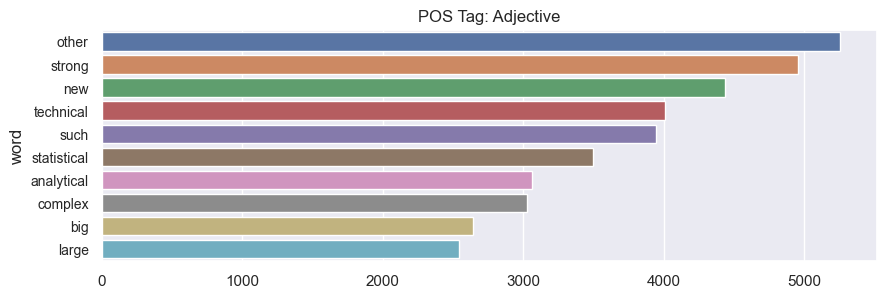

In [13]:
# adjectives
jj_tag = pos_df.loc[pos_df.POS == 'JJ'].groupby('word').count().POS.nlargest(10)
print(jj_tag)
sns.set(rc={'figure.figsize':(10,3)})
jjbar = sns.barplot(y = jj_tag.index, x = jj_tag.values, orient = 'h')
plt.title('POS Tag: Adjective')
jjbar.set_yticklabels(jjbar.get_yticklabels(), fontsize = 10);

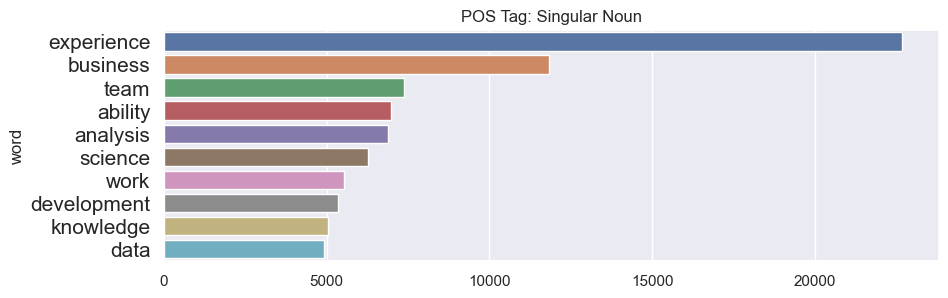

In [14]:
# nouns singular
nn_tag = pos_df.loc[pos_df.POS == 'NN'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
nnbar = sns.barplot(y = nn_tag.index, x = nn_tag.values, orient = 'h')
plt.title('POS Tag: Singular Noun')
nnbar.set_yticklabels(nnbar.get_yticklabels(), fontsize = 15);

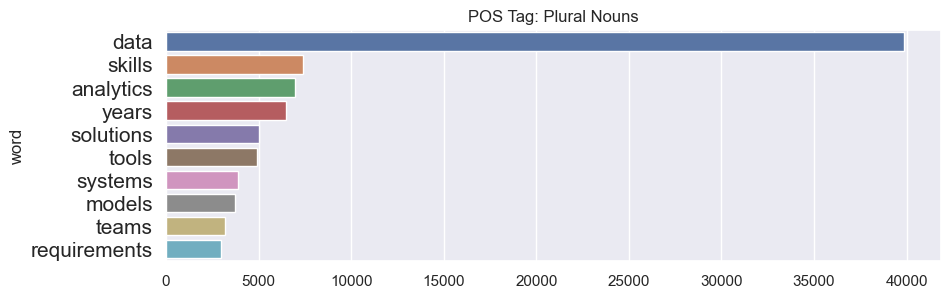

In [15]:
# nouns plural
NNS_tag = pos_df.loc[pos_df.POS == 'NNS'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
NNSbar = sns.barplot(y = NNS_tag.index, x = NNS_tag.values, orient = 'h')
plt.title('POS Tag: Plural Nouns')
NNSbar.set_yticklabels(NNSbar.get_yticklabels(), fontsize = 15);

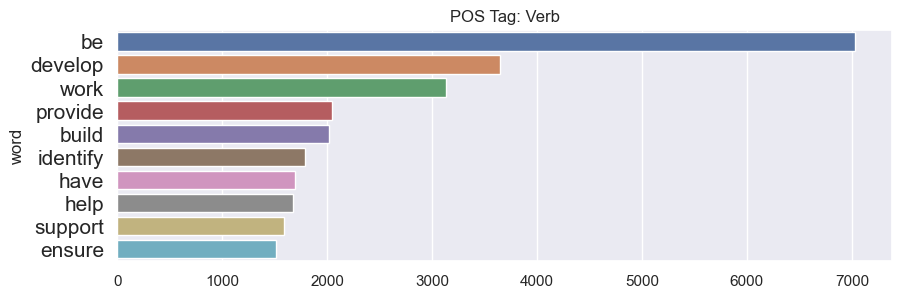

In [16]:
# verb base form 
VB_tag = pos_df.loc[pos_df.POS == 'VB'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
VBbar = sns.barplot(y = VB_tag.index, x = VB_tag.values, orient = 'h')
plt.title('POS Tag: Verb')
VBbar.set_yticklabels(VBbar.get_yticklabels(), fontsize = 15);

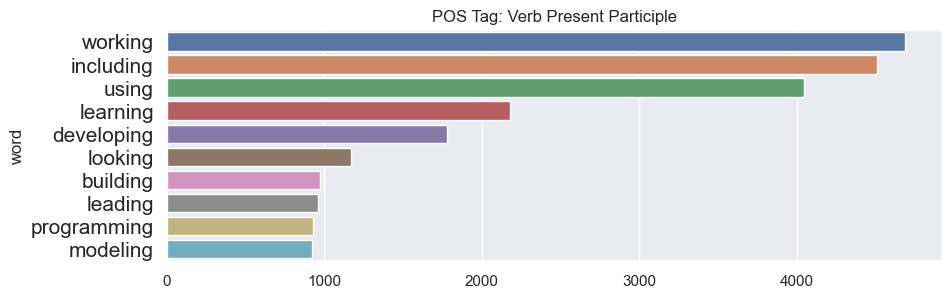

In [17]:
# Verb, present participle
VBG_tag = pos_df.loc[pos_df.POS == 'VBG'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
VBGbar = sns.barplot(y = VBG_tag.index, x = VBG_tag.values, orient = 'h')
plt.title('POS Tag: Verb Present Participle')
VBGbar.set_yticklabels(VBGbar.get_yticklabels(), fontsize = 15);

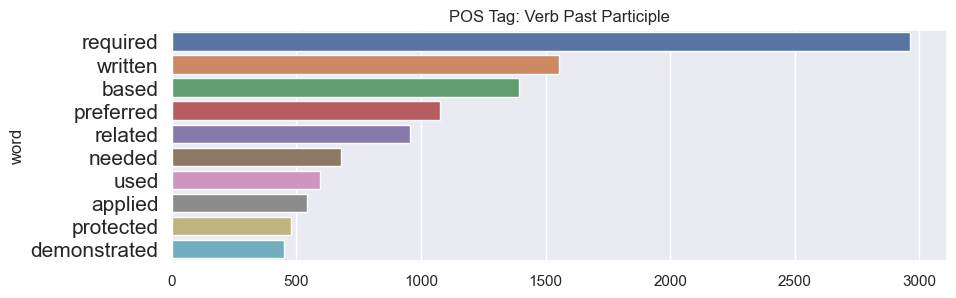

In [18]:
# Verb, past participle
VBN_tag = pos_df.loc[pos_df.POS == 'VBN'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
VBNbar = sns.barplot(y = VBN_tag.index, x = VBN_tag.values, orient = 'h')
plt.title('POS Tag: Verb Past Participle')
VBNbar.set_yticklabels(VBNbar.get_yticklabels(), fontsize = 15);

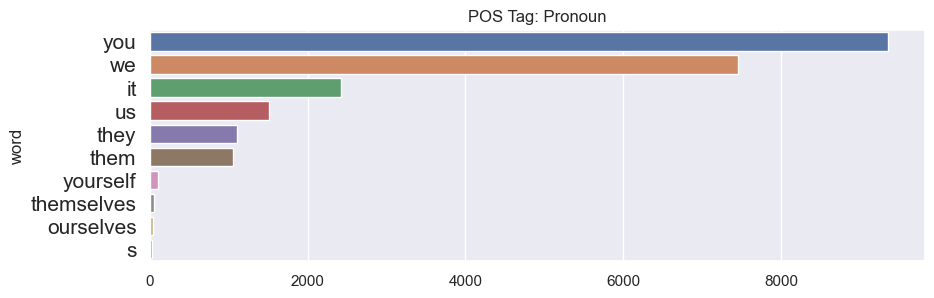

In [19]:
# Personal pronoun
PRP_tag = pos_df.loc[pos_df.POS == 'PRP'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
PRPbar = sns.barplot(y = PRP_tag.index, x = PRP_tag.values, orient = 'h')
plt.title('POS Tag: Pronoun')
PRPbar.set_yticklabels(PRPbar.get_yticklabels(), fontsize = 15);

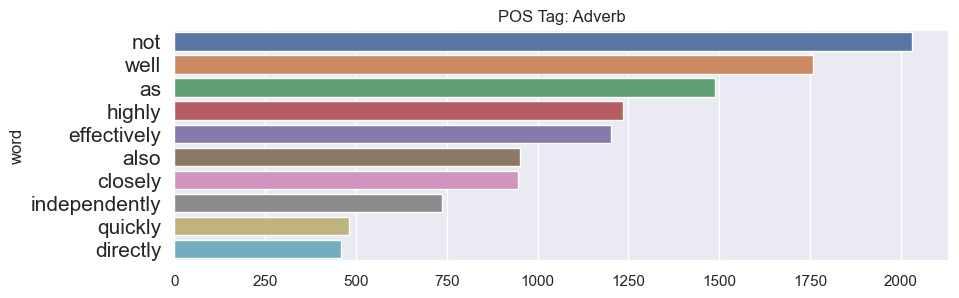

In [20]:
# adverb
RB_tag = pos_df.loc[pos_df.POS == 'RB'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
RBbar = sns.barplot(y = RB_tag.index, x = RB_tag.values, orient = 'h')
plt.title('POS Tag: Adverb')
RBbar.set_yticklabels(RBbar.get_yticklabels(), fontsize = 15);

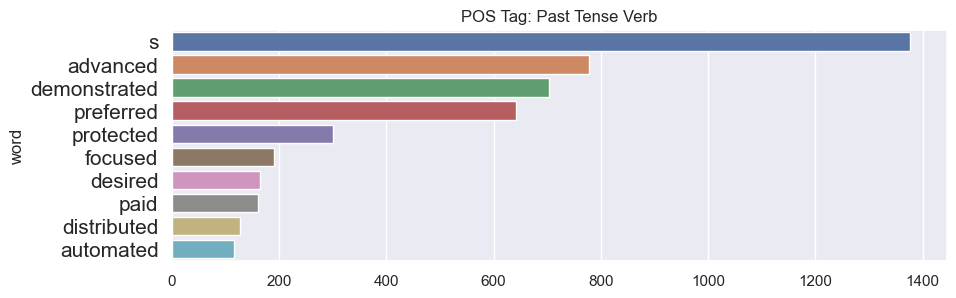

In [21]:
# Verb, past tense
VBD_tag = pos_df.loc[pos_df.POS == 'VBD'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
VBDbar = sns.barplot(y = VBD_tag.index, x = VBD_tag.values, orient = 'h')
plt.title('POS Tag: Past Tense Verb')
VBDbar.set_yticklabels(VBDbar.get_yticklabels(), fontsize = 15);

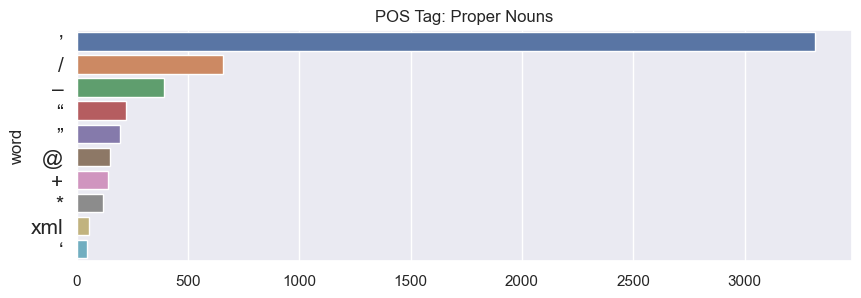

In [22]:
# Proper noun, singular
NNP_tag = pos_df.loc[pos_df.POS == 'NNP'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
NNPbar = sns.barplot(y = NNP_tag.index, x = NNP_tag.values, orient = 'h')
plt.title('POS Tag: Proper Nouns')
NNPbar.set_yticklabels(NNPbar.get_yticklabels(), fontsize = 15);

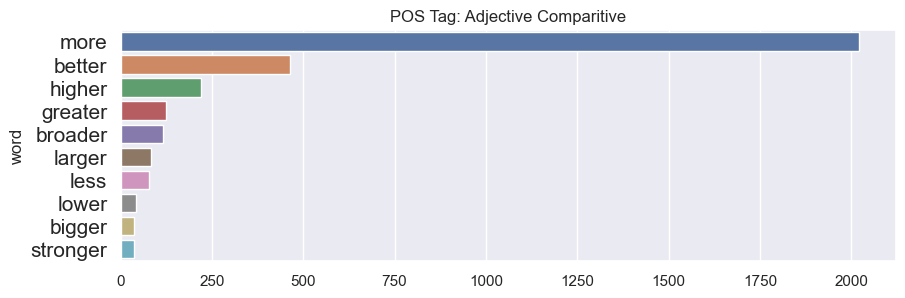

In [23]:
# 	Adjective, comparative
JJR_tag = pos_df.loc[pos_df.POS == 'JJR'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
JJRbar = sns.barplot(y = JJR_tag.index, x = JJR_tag.values, orient = 'h')
plt.title('POS Tag: Adjective Comparitive')
JJRbar.set_yticklabels(JJRbar.get_yticklabels(), fontsize = 15);

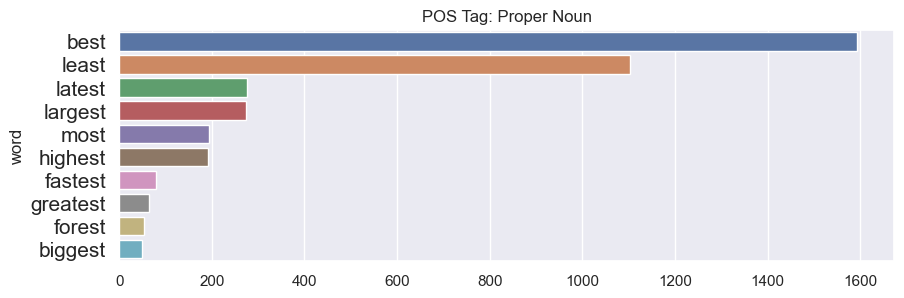

In [24]:
# Proper noun, singular
NNP_tag = pos_df.loc[pos_df.POS == 'JJS'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
NNPbar = sns.barplot(y = NNP_tag.index, x = NNP_tag.values, orient = 'h')
plt.title('POS Tag: Proper Noun')
NNPbar.set_yticklabels(NNPbar.get_yticklabels(), fontsize = 15);

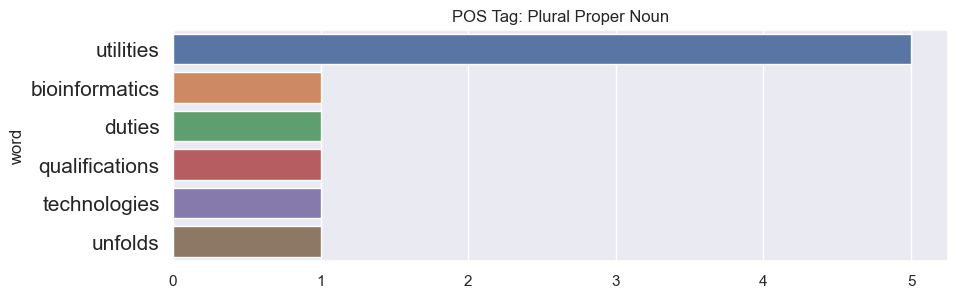

In [25]:
# Proper noun, plural
RB_tag = pos_df.loc[pos_df.POS == 'NNPS'].groupby('word').count().POS.nlargest(10)
sns.set(rc={'figure.figsize':(10,3)})
RBbar = sns.barplot(y = RB_tag.index, x = RB_tag.values, orient = 'h')
plt.title('POS Tag: Plural Proper Noun')
RBbar.set_yticklabels(RBbar.get_yticklabels(), fontsize = 15);